<a href="https://colab.research.google.com/github/putriregina-41236774/putriregina-41236774/blob/main/Model_DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os

# Konfigurasi agar GPU digunakan secara efisien
physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU Terdeteksi: ", physical_devices[0])
else:
    print("Peringatan: GPU tidak terdeteksi. Training akan lambat.")

GPU Terdeteksi:  PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# Create the .kaggle directory if it doesn't exist
!mkdir -p ~/.kaggle

# Move the kaggle.json file to the .kaggle directory
# IMPORTANT: Make sure you have uploaded kaggle.json to your Colab session's /content/ directory first.
# If you uploaded it somewhere else, adjust the source path accordingly.
!mv /content/kaggle.json ~/.kaggle/

# Set read-only permissions for the kaggle.json file for security
!chmod 600 ~/.kaggle/kaggle.json

print("Kaggle API credentials set up successfully!")

mv: cannot stat '/content/kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Kaggle API credentials set up successfully!


In [5]:
# Install kaggle if not already installed
!pip install -q kaggle

# Make sure your Kaggle API credentials (kaggle.json) are set up in ~/.kaggle/
# If you haven't done this, please refer to the previous instructions.

# Download the dataset
!kaggle datasets download -d joosthazelzet/lego-brick-images

# Unzip the downloaded dataset to the specified directory
# The zip file will be downloaded to the current working directory (/content/)
!unzip -q /content/lego-brick-images.zip -d /content/dataset/

# Clean up the zip file after extraction
!rm /content/lego-brick-images.zip

print("Dataset downloaded and extracted to /content/dataset/")

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'
unzip:  cannot find or open /content/lego-brick-images.zip, /content/lego-brick-images.zip.zip or /content/lego-brick-images.zip.ZIP.
rm: cannot remove '/content/lego-brick-images.zip': No such file or directory
Dataset downloaded and extracted to /content/dataset/


In [6]:
# Parameter Konfigurasi
BATCH_SIZE = 64
IMG_HEIGHT = 64  # Menggunakan 64x64 agar detail LEGO cukup terlihat
IMG_WIDTH = 64
CHANNELS = 3     # RGB


# --- OPSI B: Membuat Dataset Loader ---
# Ganti 'path/to/images' dengan path folder dataset Anda
dataset_dir = '/content/dataset/LEGO brick images v1'

# Jika folder kosong/tidak ada, kita buat dummy data agar kode tetap jalan (untuk testing)
if not os.path.exists(dataset_dir) or not os.listdir(dataset_dir):
    print("Dataset tidak ditemukan. Membuat data dummy untuk demonstrasi struktur kode.")
    os.makedirs(dataset_dir, exist_ok=True)
    # Membuat 100 gambar random noise sebagai placeholder
    for i in range(100):
        img = np.random.randint(0, 255, (64, 64, 3), dtype=np.uint8)
        tf.keras.utils.save_img(f"{dataset_dir}/dummy_{i}.png", img)

# Memuat dataset
train_dataset = tf.keras.utils.image_dataset_from_directory(
    dataset_dir,
    label_mode=None, # Kita tidak butuh label untuk GAN
    image_size=(IMG_HEIGHT, IMG_WIDTH),
    batch_size=BATCH_SIZE
)

# Normalisasi ke [-1, 1]
train_dataset = train_dataset.map(lambda x: (x - 127.5) / 127.5)

# Optimasi performa (Caching & Prefetching)
train_dataset = train_dataset.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)

Dataset tidak ditemukan. Membuat data dummy untuk demonstrasi struktur kode.
Found 100 files.


In [7]:
latent_dim = 128

def build_generator():
    model = keras.Sequential(name="generator")

    # Input: Latent Vector
    # Mulai dengan dense layer yang cukup besar untuk di-reshape
    # Kita ingin mulai dari ukuran 8x8 dengan 512 filter
    model.add(layers.Dense(8 * 8 * 512, use_bias=False, input_shape=(latent_dim,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Reshape menjadi tensor 3D
    model.add(layers.Reshape((8, 8, 512)))

    # Upsampling 1: 8x8 -> 16x16
    model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Upsampling 2: 16x16 -> 32x32
    model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Upsampling 3: 32x32 -> 64x64
    model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Output Layer: 64x64 -> 64x64x3 (RGB)
    # Aktivasi TANH penting agar output di range [-1, 1]
    model.add(layers.Conv2D(CHANNELS, (3, 3), padding='same', activation='tanh'))

    return model

def build_discriminator():
    model = keras.Sequential(name="discriminator")

    # Input: Gambar 64x64x3
    # Downsampling 1: 64 -> 32
    model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=(IMG_HEIGHT, IMG_WIDTH, CHANNELS)))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Downsampling 2: 32 -> 16
    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Downsampling 3: 16 -> 8
    model.add(layers.Conv2D(256, (4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Flatten dan Output
    model.add(layers.Flatten())
    model.add(layers.Dense(1)) # Output berupa logit (skor real/fake)

    return model

# Inisialisasi Model
generator = build_generator()
discriminator = build_discriminator()

generator.summary()
# discriminator.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     4,194,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 32768)          │       131,072 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,152 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,288 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,072 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         1,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,081,411 (27.01 MB)

 Trainable params: 7,014,979 (26.76 MB)

 Non-trainable params: 66,432 (259.50 KB)

In [8]:
class DCGAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
        # Metric trackers
        self.d_loss_metric = keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = keras.metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):
        # 1. Sample random points in the latent space
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        # 2. Decode them to fake images
        generated_images = self.generator(random_latent_vectors)

        # 3. Combine them with real images
        combined_images = tf.concat([generated_images, real_images], axis=0)

        # 4. Assemble labels discriminating real from fake images
        # Label 1 untuk fake, 0 untuk real (atau sebaliknya, teknik ini menggunakan label smoothing)
        # Di sini kita pakai standar: 1=Real, 0=Fake.
        # Namun, karena kita concat [Fake, Real], maka labelnya: [0...0, 1...1]
        labels = tf.concat(
            [tf.zeros((batch_size, 1)), tf.ones((batch_size, 1))], axis=0
        )

        # Tambahkan sedikit noise pada label (Label Smoothing) untuk stabilitas
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        # 5. Train the Discriminator
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)

        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )

        # 6. Sample random points in the latent space (lagi, untuk Generator)
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        # 7. Assemble labels that say "all real images" (We want to fool the discriminator)
        misleading_labels = tf.ones((batch_size, 1))

        # 8. Train the Generator
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)

        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(
            zip(grads, self.generator.trainable_weights)
        )

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {
            "d_loss": self.d_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
        }

In [9]:
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_img=3, latent_dim=128):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images *= 127.5
        generated_images += 127.5
        generated_images.numpy()

        fig = plt.figure(figsize=(10, 4))
        for i in range(self.num_img):
            plt.subplot(1, self.num_img, i+1)
            img = keras.utils.array_to_img(generated_images[i])
            plt.imshow(img)
            plt.axis('off')

        plt.suptitle(f"Epoch {epoch+1}")
        plt.show() # Tampilkan inline di Colab

        # Opsional: Simpan ke file
        # plt.savefig(f"generated_lego_epoch_{epoch}.png")
        # plt.close()

Mulai Training...
Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6776 - g_loss: 0.6907  

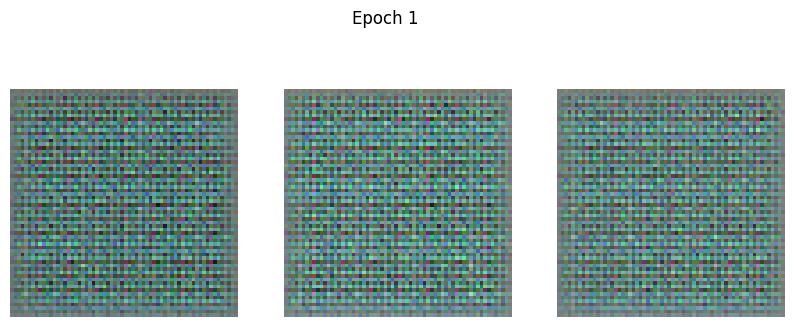

2/2 ━━━━━━━━━━━━━━━━━━━━ 18s 5s/step - d_loss: 0.6729 - g_loss: 0.6904
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.5610 - g_loss: 0.6647

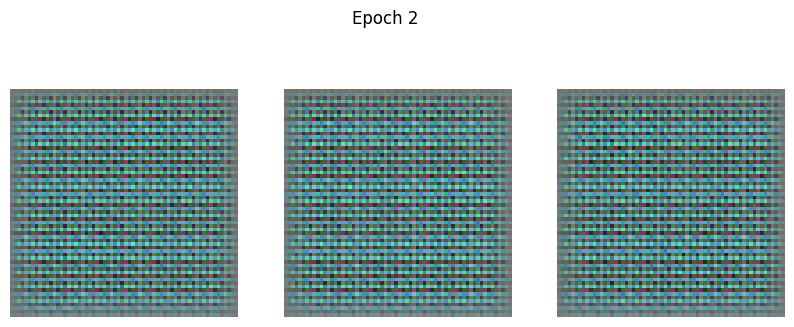

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - d_loss: 0.5572 - g_loss: 0.6618
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.4982 - g_loss: 0.5595

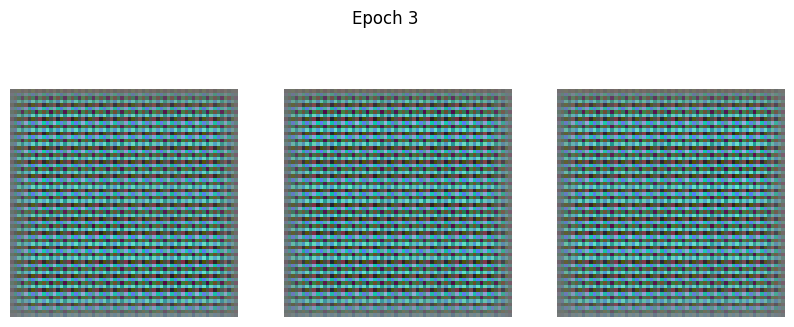

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step - d_loss: 0.5011 - g_loss: 0.5549
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5574 - g_loss: 0.5475 

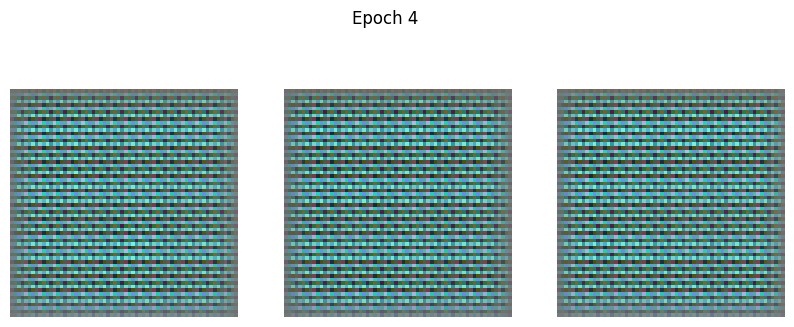

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.5552 - g_loss: 0.5558
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.4081 - g_loss: 0.8182 

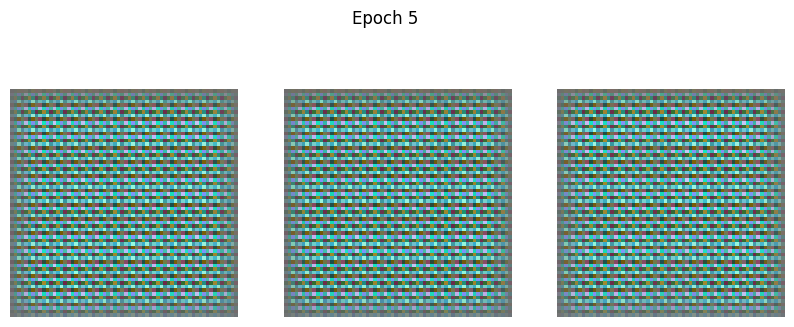

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - d_loss: 0.4005 - g_loss: 0.8312
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.2777 - g_loss: 1.0415 

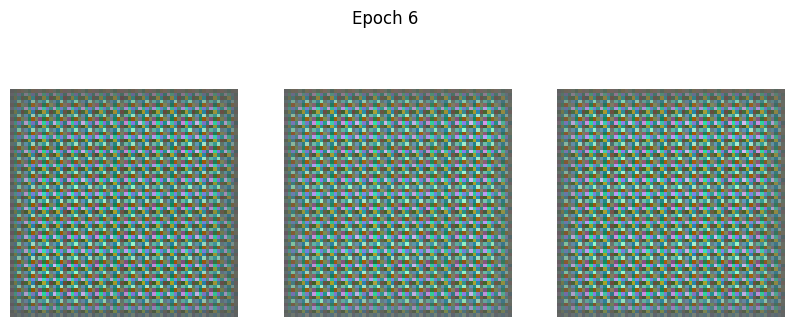

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - d_loss: 0.2747 - g_loss: 1.0437
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.2480 - g_loss: 0.9604

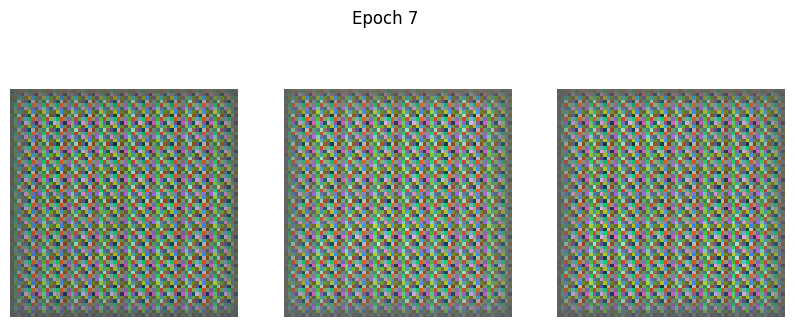

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - d_loss: 0.2492 - g_loss: 0.9511
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.3313 - g_loss: 0.7485 

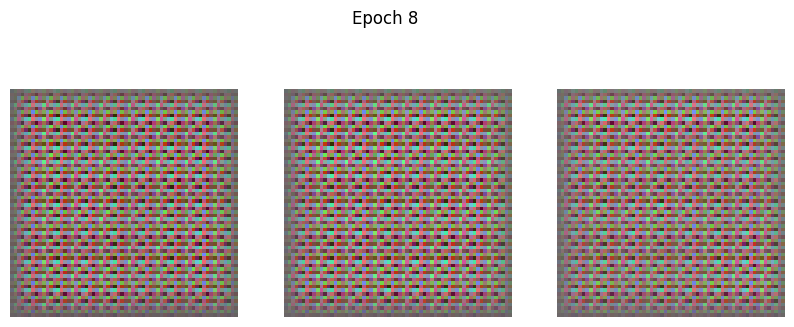

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step - d_loss: 0.3409 - g_loss: 0.7366
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6898 - g_loss: 0.5387 

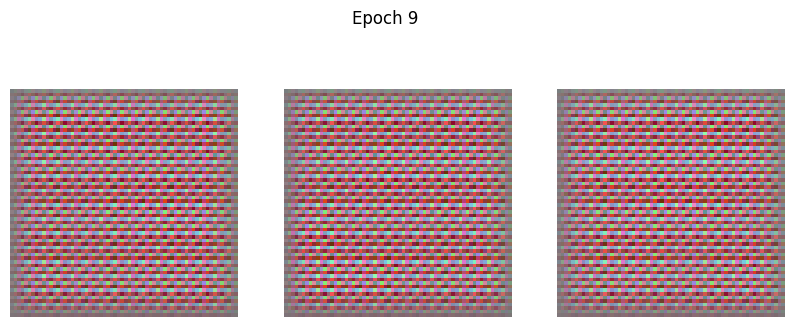

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.7019 - g_loss: 0.5419
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.6792 - g_loss: 0.8791 

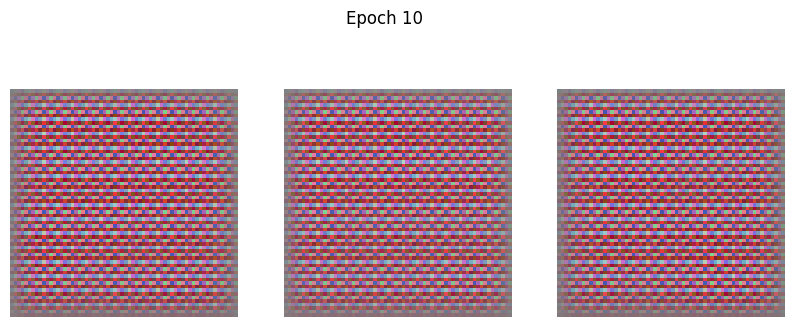

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - d_loss: 0.6671 - g_loss: 0.9026
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.4888 - g_loss: 1.0262 

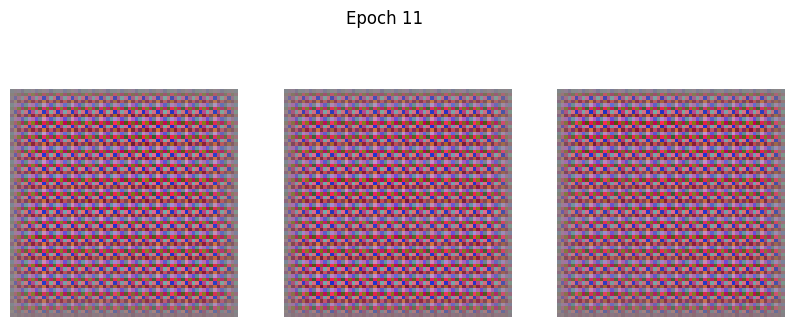

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - d_loss: 0.4820 - g_loss: 1.0175
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.4156 - g_loss: 0.9079

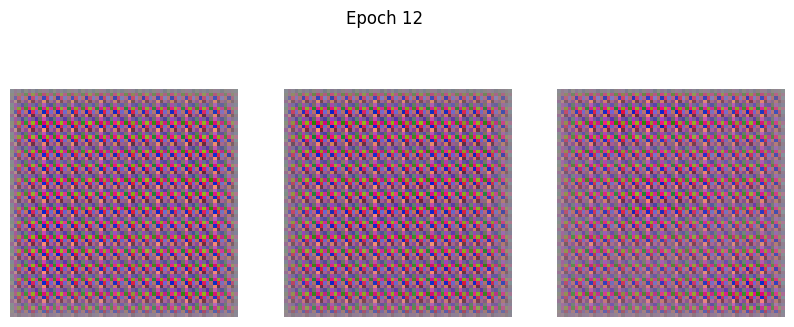

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step - d_loss: 0.4183 - g_loss: 0.9043
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.4766 - g_loss: 0.7526

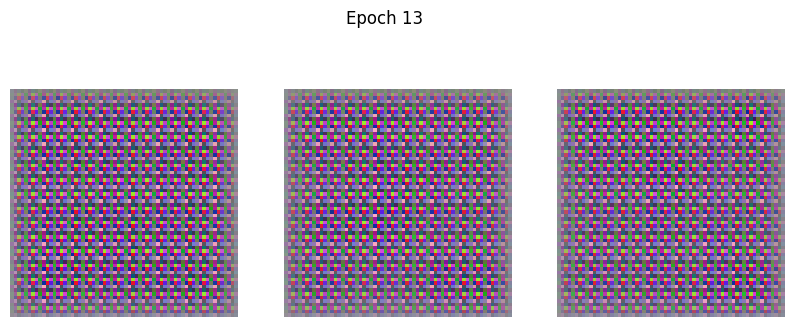

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step - d_loss: 0.4815 - g_loss: 0.7459
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5184 - g_loss: 0.7775 

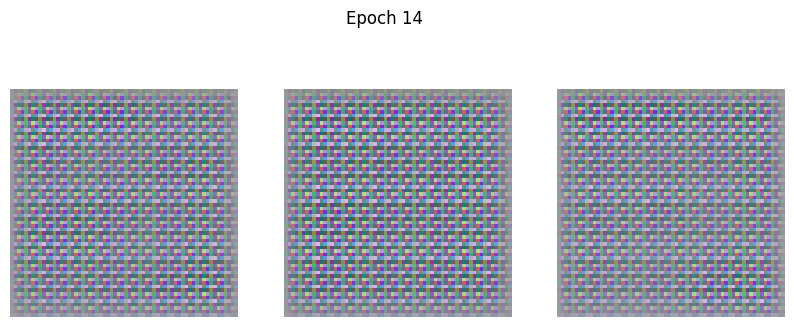

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step - d_loss: 0.5138 - g_loss: 0.7871
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.4020 - g_loss: 0.9399 

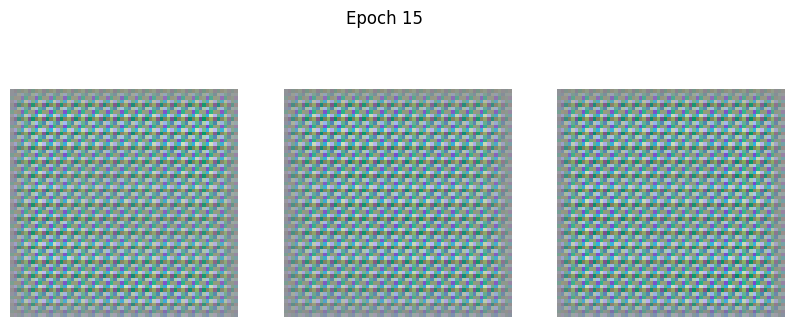

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - d_loss: 0.3984 - g_loss: 0.9397
Epoch 16/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3945 - g_loss: 0.8960 

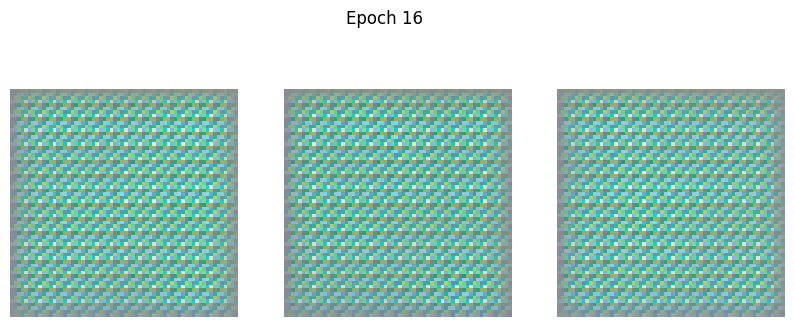

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - d_loss: 0.3960 - g_loss: 0.8937
Epoch 17/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.4053 - g_loss: 0.8337 

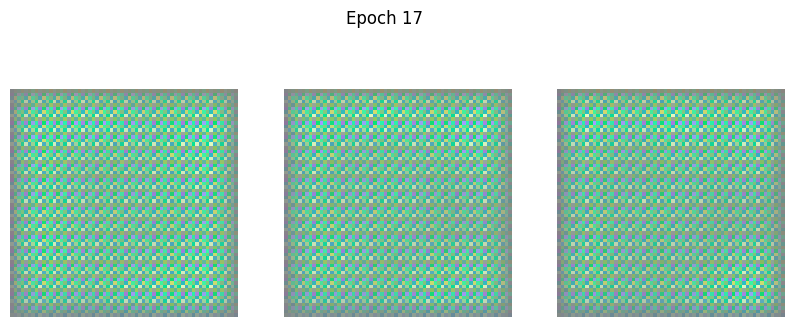

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - d_loss: 0.4041 - g_loss: 0.8324
Epoch 18/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.3852 - g_loss: 0.8616

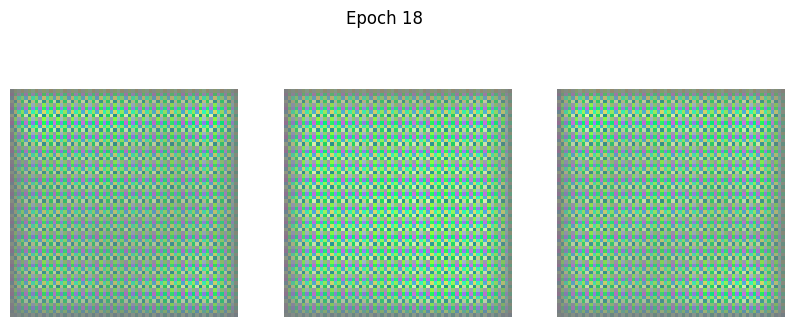

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - d_loss: 0.3811 - g_loss: 0.8681
Epoch 19/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2575 - g_loss: 1.0678

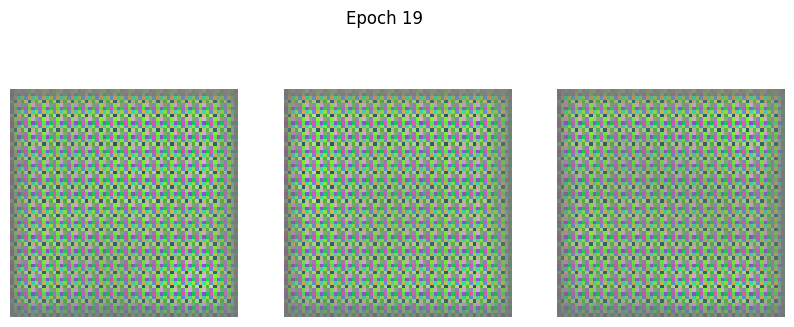

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - d_loss: 0.2536 - g_loss: 1.0753
Epoch 20/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.1891 - g_loss: 1.1524 

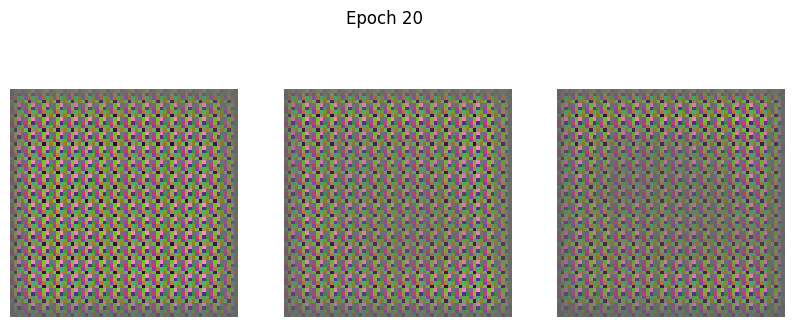

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step - d_loss: 0.1884 - g_loss: 1.1495
Epoch 21/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.2230 - g_loss: 1.0426

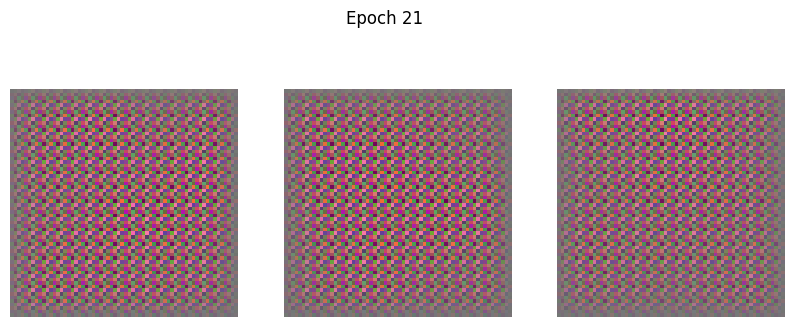

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step - d_loss: 0.2316 - g_loss: 1.0365
Epoch 22/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.5217 - g_loss: 0.9399

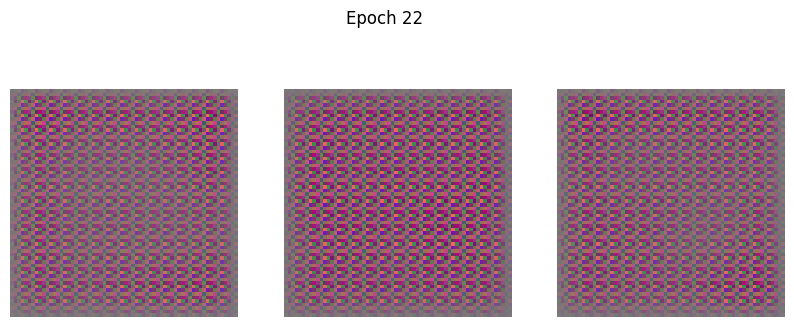

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step - d_loss: 0.5315 - g_loss: 0.9528
Epoch 23/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3955 - g_loss: 1.9269 

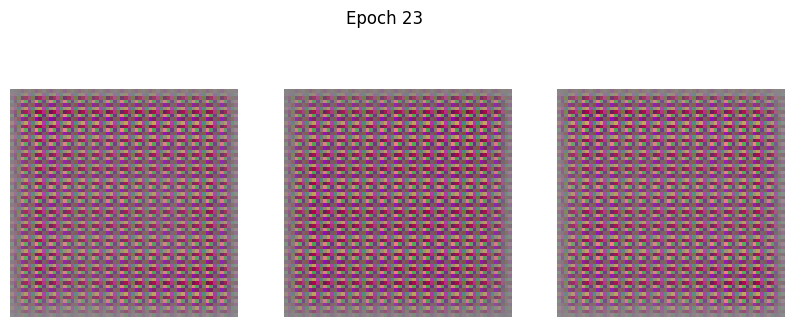

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - d_loss: 0.3769 - g_loss: 1.9523
Epoch 24/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.1189 - g_loss: 1.8184

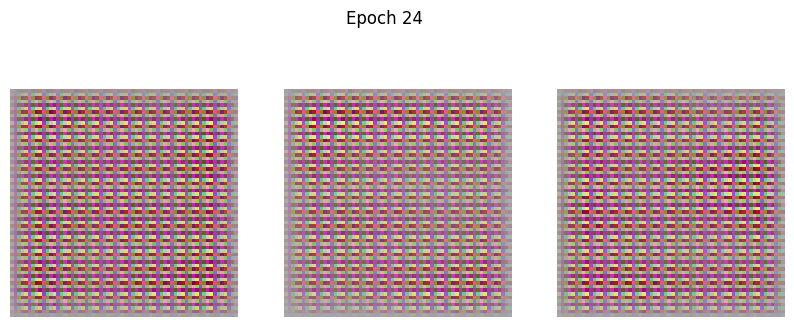

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step - d_loss: 0.1170 - g_loss: 1.8078
Epoch 25/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1199 - g_loss: 1.4961 

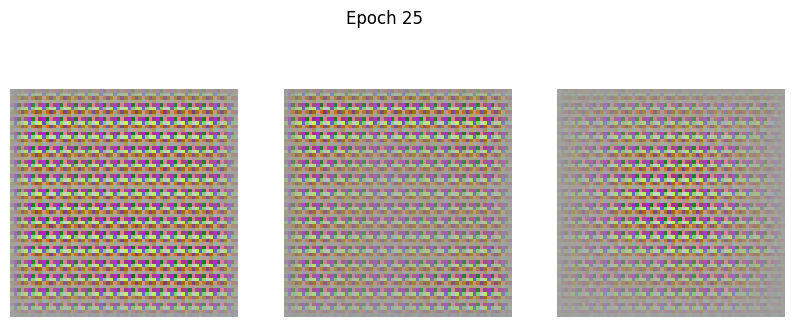

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - d_loss: 0.1191 - g_loss: 1.4826
Epoch 26/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1736 - g_loss: 1.2439

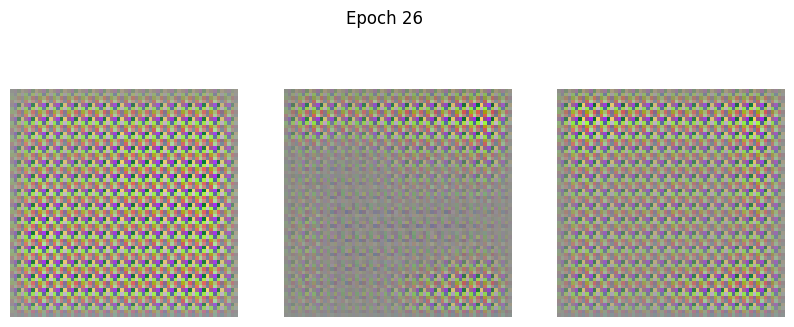

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1817 - g_loss: 1.2363
Epoch 27/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.5675 - g_loss: 1.0934 

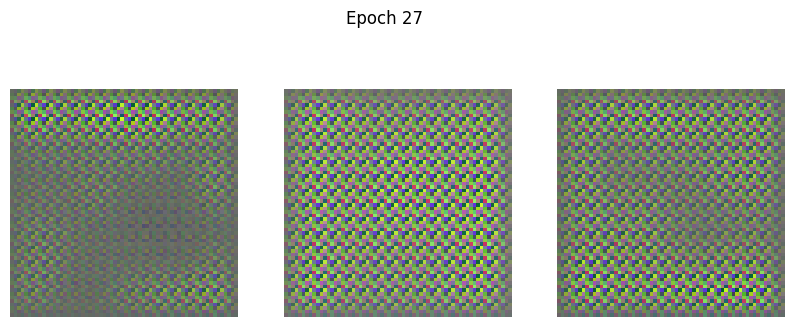

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - d_loss: 0.5865 - g_loss: 1.1261
Epoch 28/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.4980 - g_loss: 2.2123 

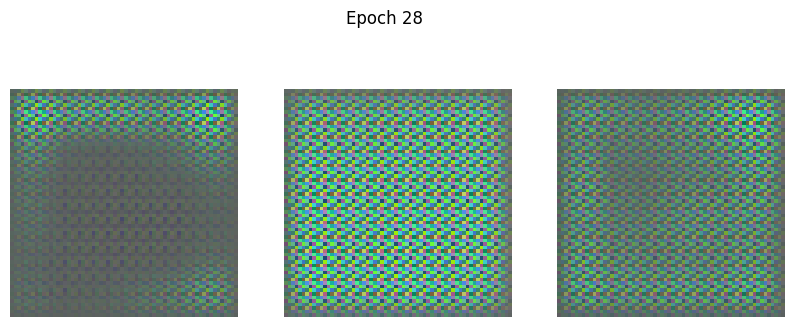

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step - d_loss: 0.4917 - g_loss: 2.1614
Epoch 29/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.5752 - g_loss: 2.0894 

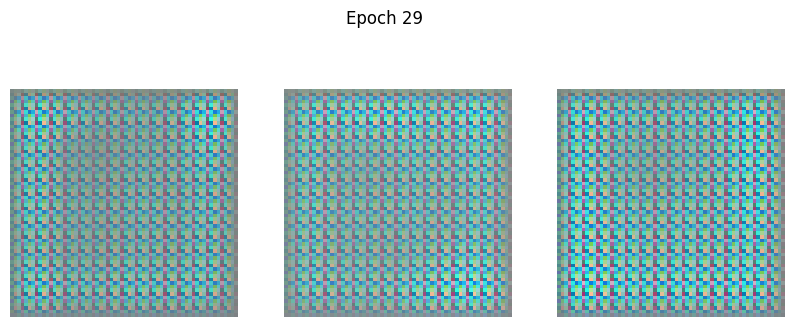

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - d_loss: 0.5955 - g_loss: 2.1483
Epoch 30/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.9252 - g_loss: 1.8029

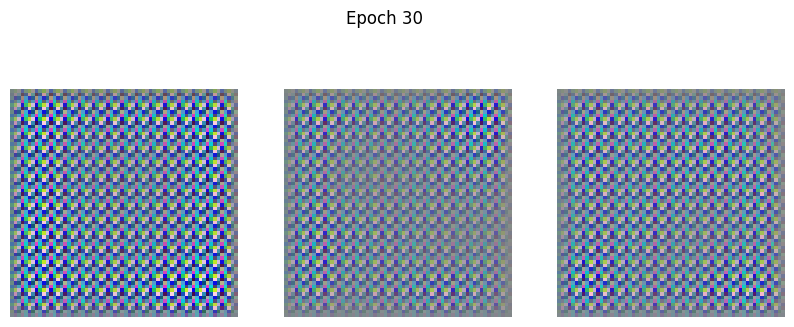

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.9398 - g_loss: 1.7518
Epoch 31/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.8759 - g_loss: 2.3432 

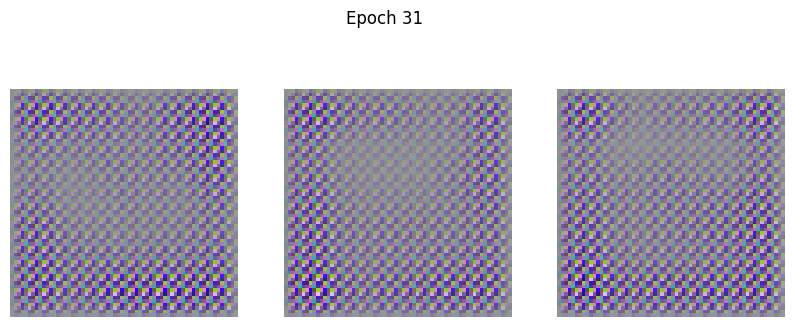

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step - d_loss: 0.8308 - g_loss: 2.3621
Epoch 32/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.3825 - g_loss: 2.1760 

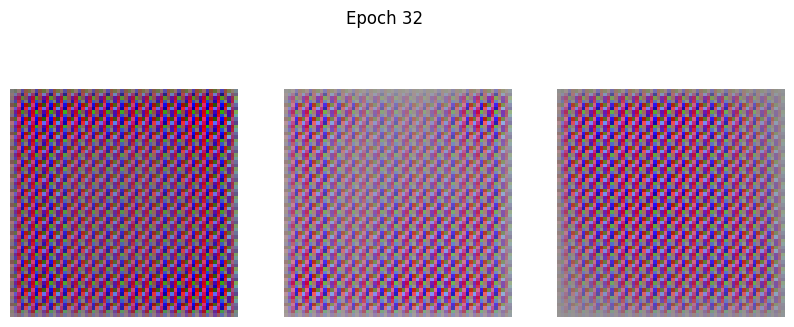

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - d_loss: 0.3845 - g_loss: 2.1896
Epoch 33/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.5780 - g_loss: 3.1572

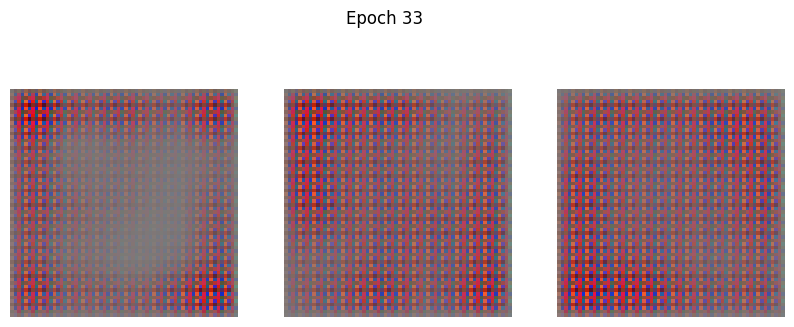

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.5808 - g_loss: 3.0907
Epoch 34/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.4874 - g_loss: 2.1155

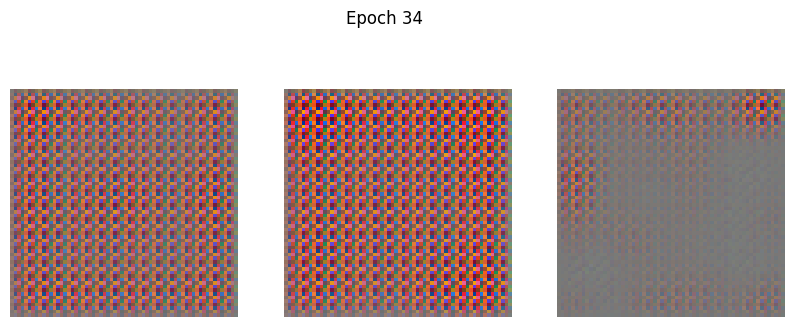

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - d_loss: 0.4798 - g_loss: 2.0936
Epoch 35/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.3239 - g_loss: 1.8390 

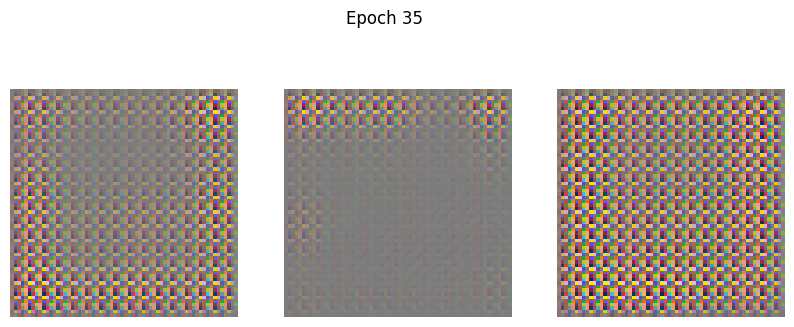

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.3181 - g_loss: 1.8403
Epoch 36/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.2690 - g_loss: 1.6347

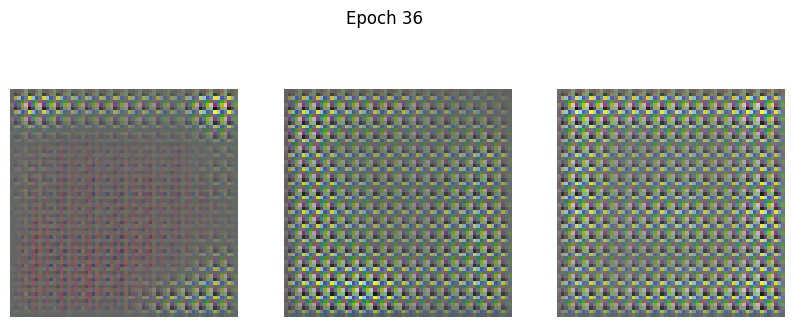

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 229ms/step - d_loss: 0.2725 - g_loss: 1.5986
Epoch 37/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.3535 - g_loss: 1.0314 

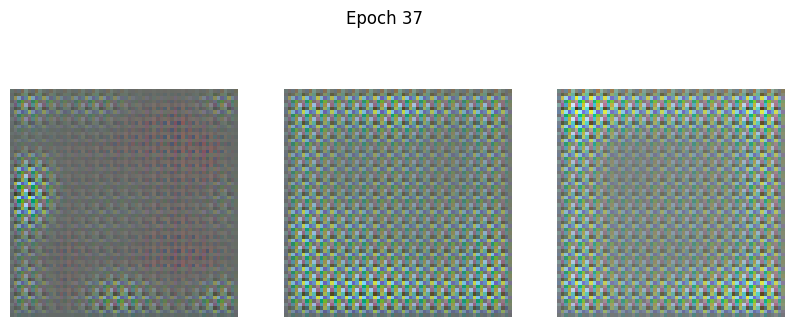

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - d_loss: 0.3623 - g_loss: 1.0308
Epoch 38/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.4482 - g_loss: 1.2418

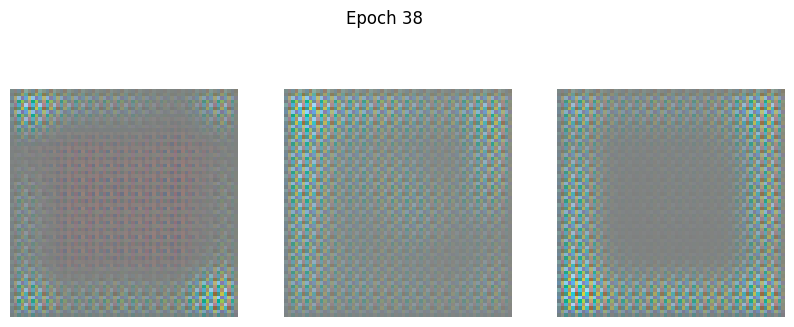

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step - d_loss: 0.4484 - g_loss: 1.2650
Epoch 39/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.3064 - g_loss: 2.0256

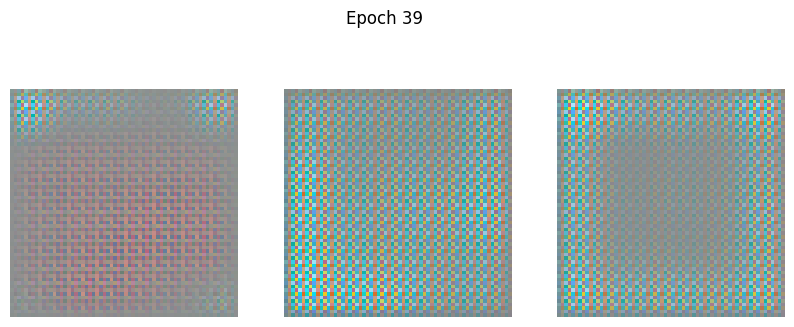

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step - d_loss: 0.2989 - g_loss: 2.0383
Epoch 40/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1381 - g_loss: 2.2948

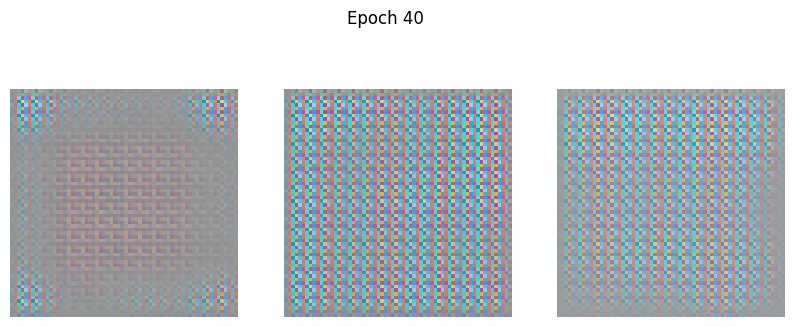

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step - d_loss: 0.1372 - g_loss: 2.3007
Epoch 41/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0980 - g_loss: 2.2743 

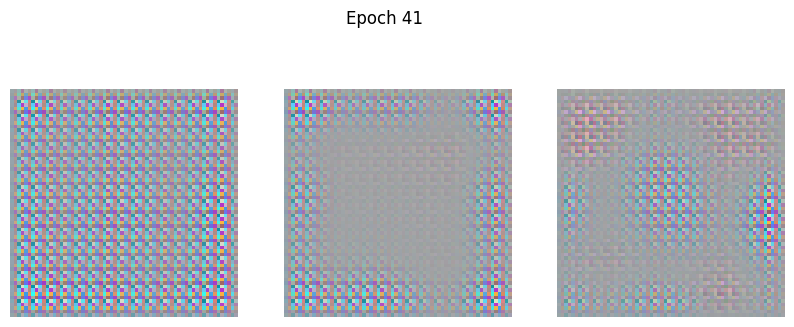

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0978 - g_loss: 2.2949
Epoch 42/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0842 - g_loss: 2.4595

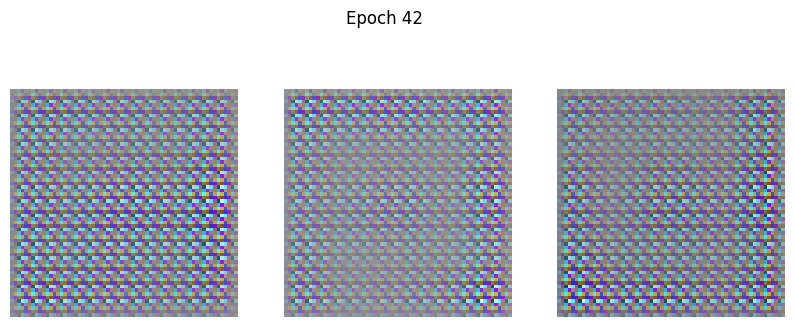

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 247ms/step - d_loss: 0.0855 - g_loss: 2.4550
Epoch 43/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0846 - g_loss: 2.2436

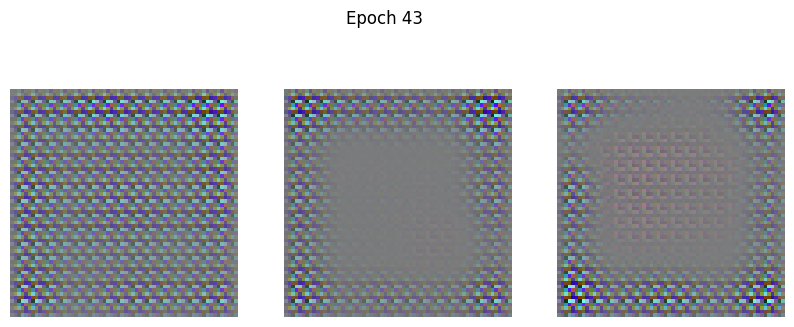

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 218ms/step - d_loss: 0.0873 - g_loss: 2.2386
Epoch 44/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.1187 - g_loss: 2.4234

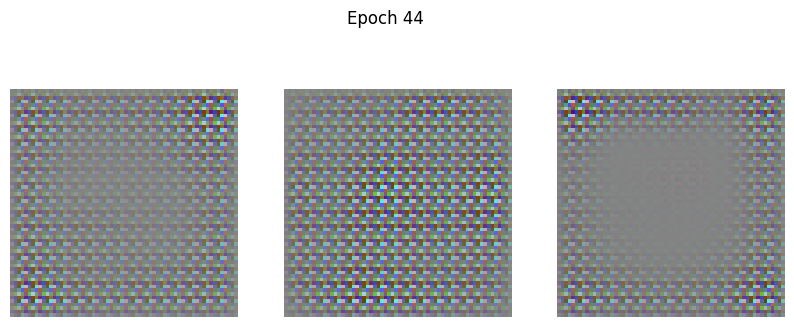

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step - d_loss: 0.1200 - g_loss: 2.4416
Epoch 45/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0966 - g_loss: 2.5384

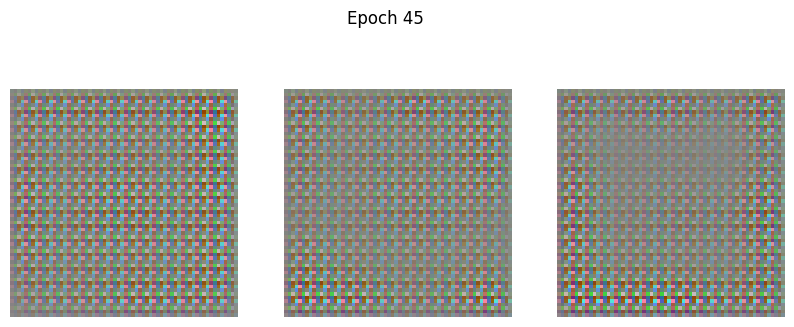

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - d_loss: 0.0972 - g_loss: 2.5177
Epoch 46/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1172 - g_loss: 2.3100

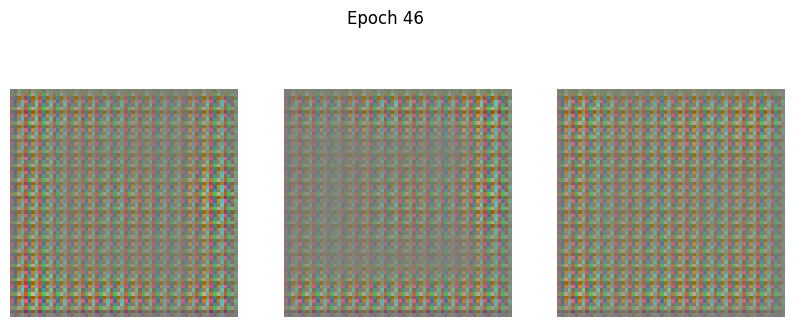

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step - d_loss: 0.1173 - g_loss: 2.3079
Epoch 47/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1770 - g_loss: 2.5767 

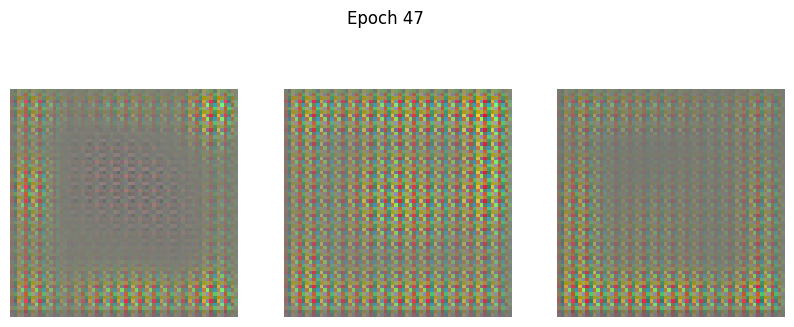

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1754 - g_loss: 2.5946
Epoch 48/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.1490 - g_loss: 2.6855

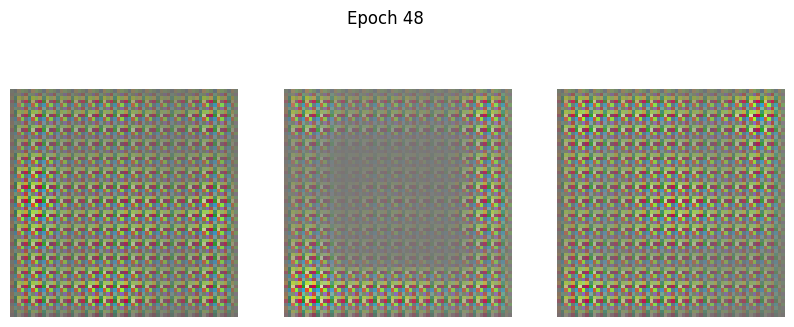

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step - d_loss: 0.1515 - g_loss: 2.6639
Epoch 49/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.2723 - g_loss: 2.3385

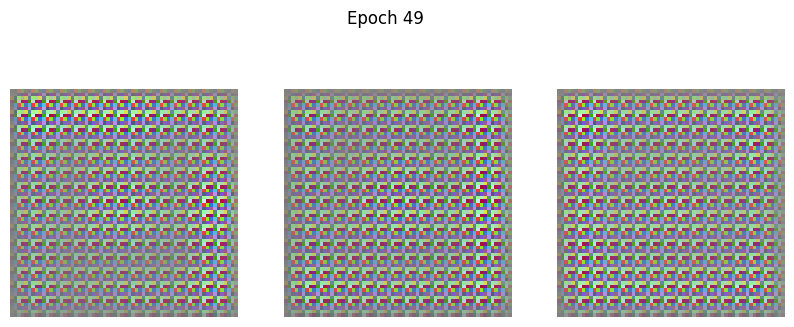

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.2824 - g_loss: 2.3437
Epoch 50/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.3428 - g_loss: 2.6554 

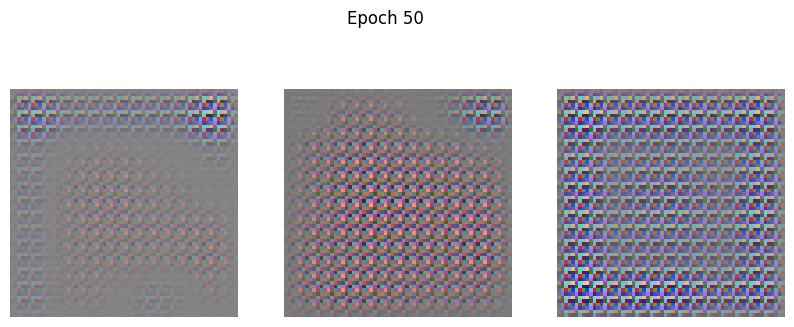

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.3393 - g_loss: 2.6730
Epoch 51/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.2493 - g_loss: 3.7243

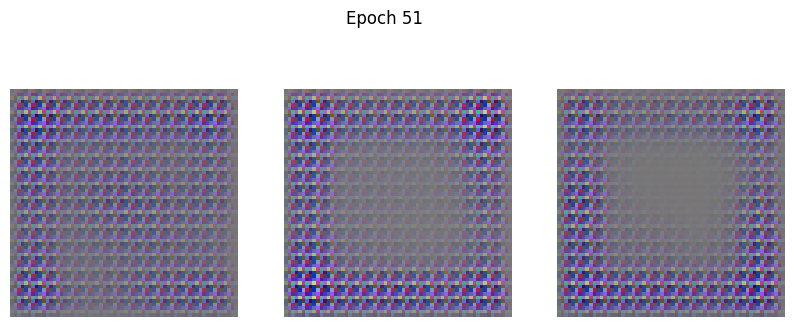

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.2415 - g_loss: 3.6678
Epoch 52/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2024 - g_loss: 3.3554 

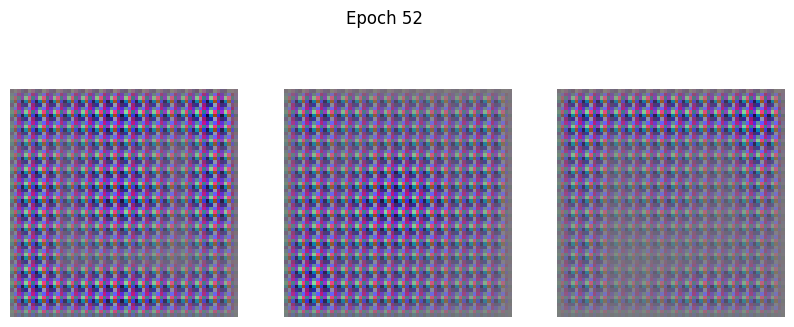

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.2304 - g_loss: 3.6531
Epoch 53/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1808 - g_loss: 4.2804 

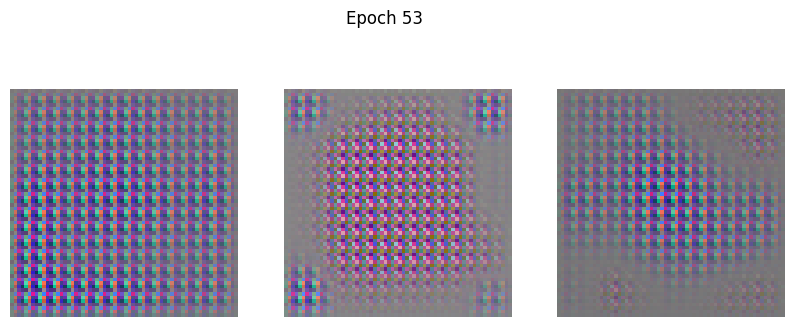

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1758 - g_loss: 4.1159
Epoch 54/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.2697 - g_loss: 3.7658

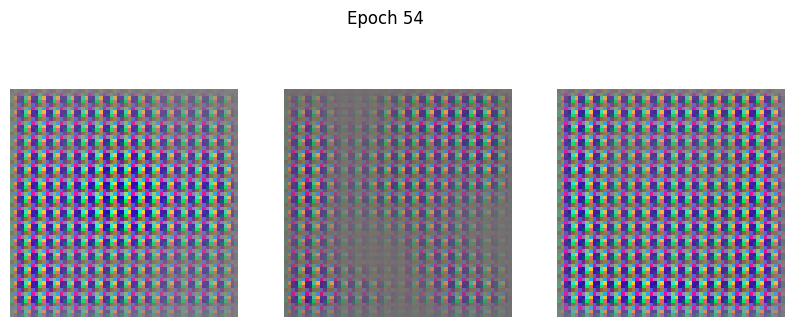

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.2656 - g_loss: 3.7977
Epoch 55/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.2202 - g_loss: 2.7361

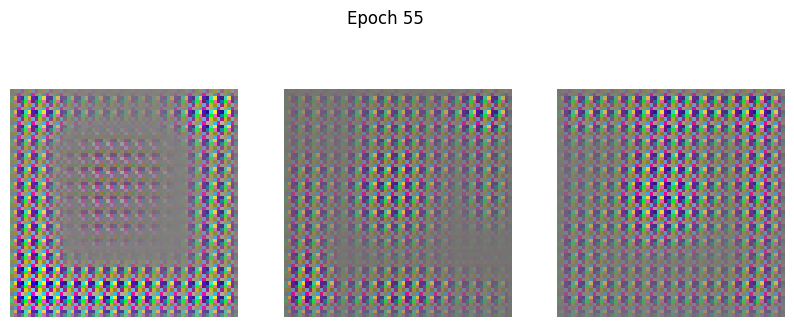

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.2251 - g_loss: 2.7615
Epoch 56/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.2630 - g_loss: 3.3696

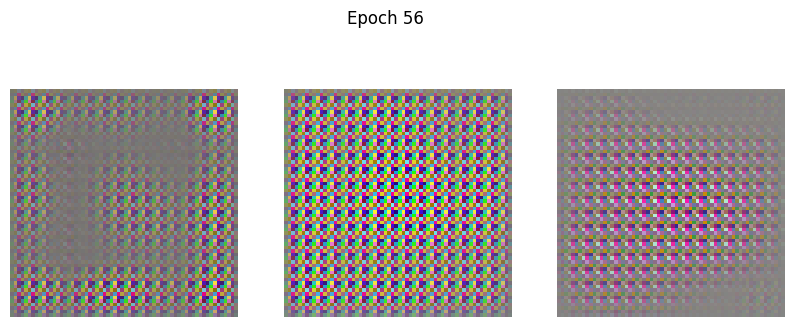

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.2563 - g_loss: 3.3326
Epoch 57/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1938 - g_loss: 3.2015 

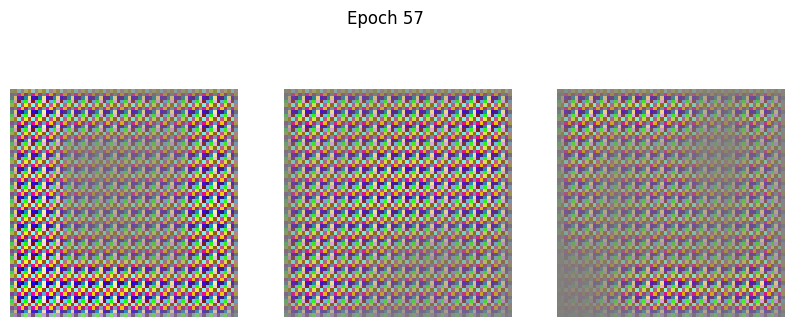

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.2093 - g_loss: 3.3041
Epoch 58/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.2190 - g_loss: 3.3013

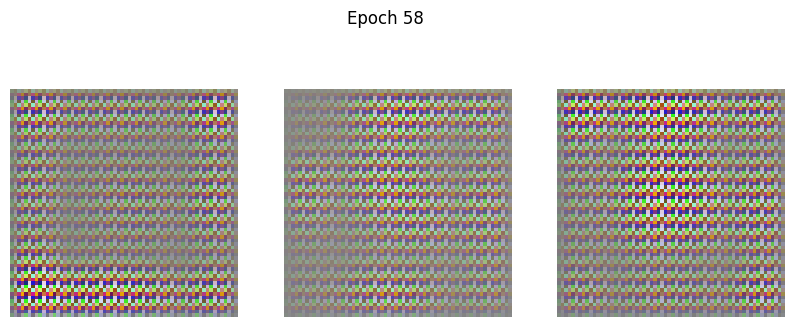

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.2213 - g_loss: 3.2291
Epoch 59/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.2211 - g_loss: 3.3857

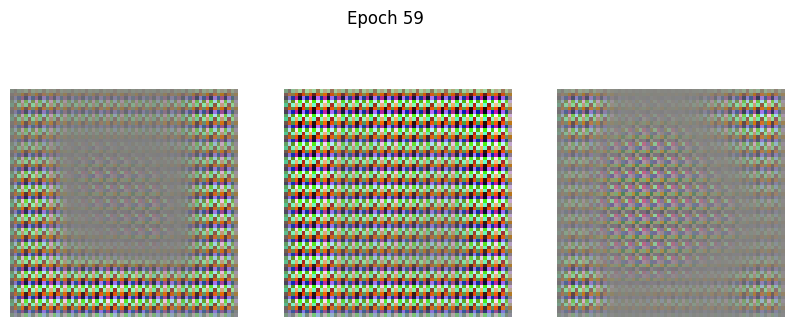

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.2239 - g_loss: 3.3884
Epoch 60/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.2898 - g_loss: 3.9791

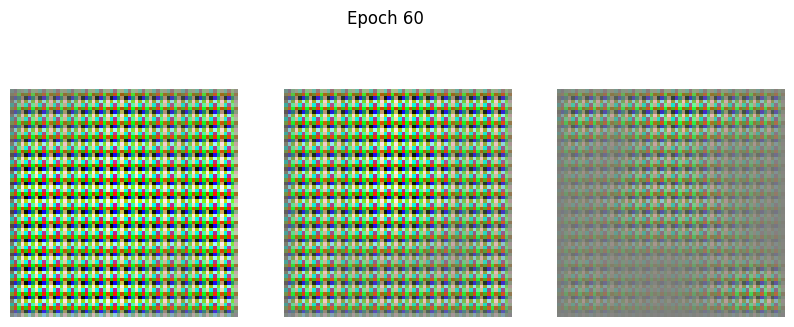

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.2908 - g_loss: 3.8992
Epoch 61/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2326 - g_loss: 3.9257 

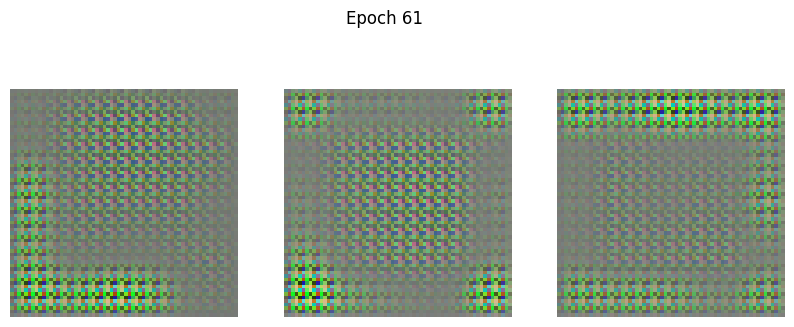

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.2231 - g_loss: 4.0703
Epoch 62/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0927 - g_loss: 4.2125

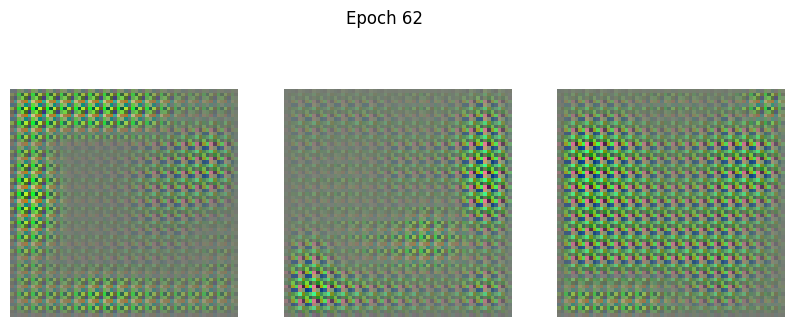

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.0912 - g_loss: 4.0952
Epoch 63/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1703 - g_loss: 4.3845

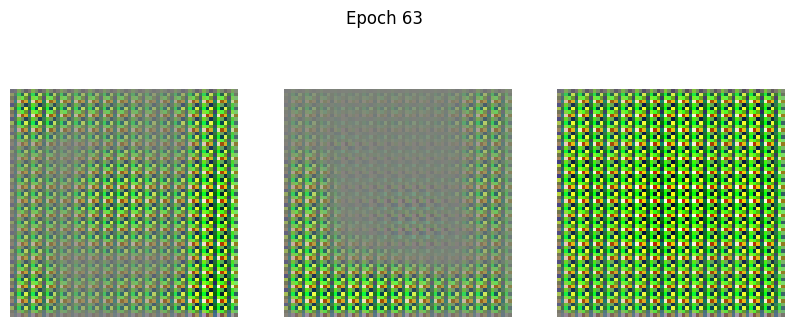

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1655 - g_loss: 4.4323
Epoch 64/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1468 - g_loss: 5.2004

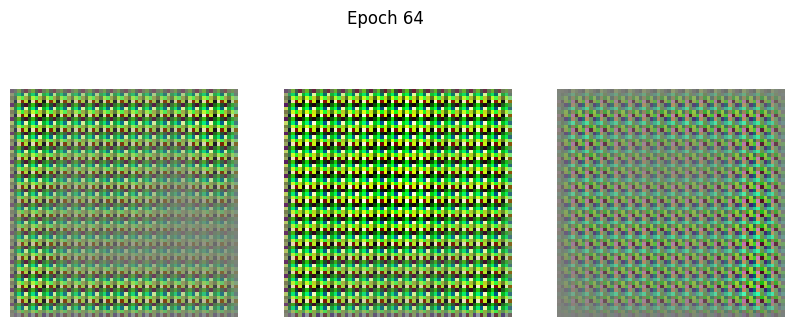

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1554 - g_loss: 5.2849
Epoch 65/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1276 - g_loss: 4.9637

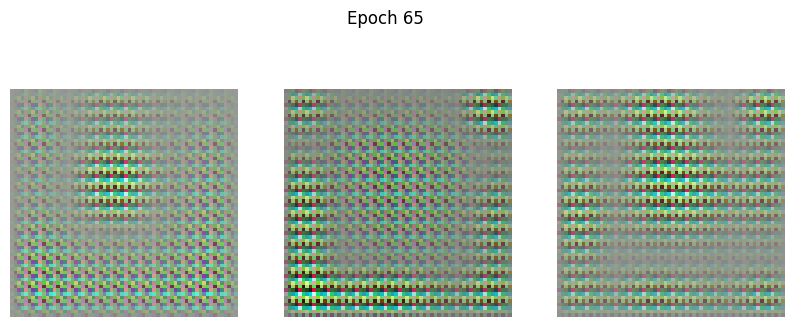

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.1332 - g_loss: 4.9930
Epoch 66/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.3305 - g_loss: 5.8494

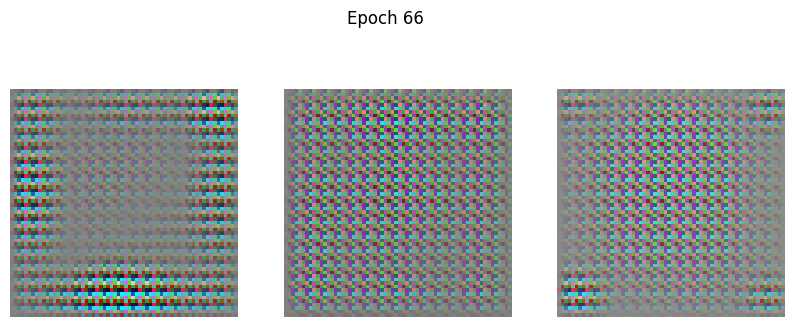

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.3160 - g_loss: 5.8489
Epoch 67/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2162 - g_loss: 6.2196 

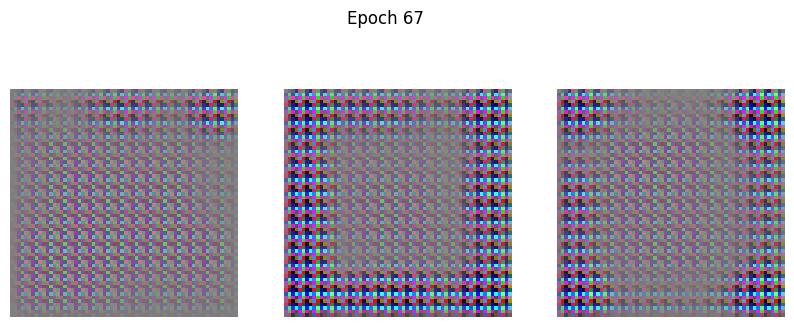

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.2198 - g_loss: 6.4096
Epoch 68/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2181 - g_loss: 5.4399 

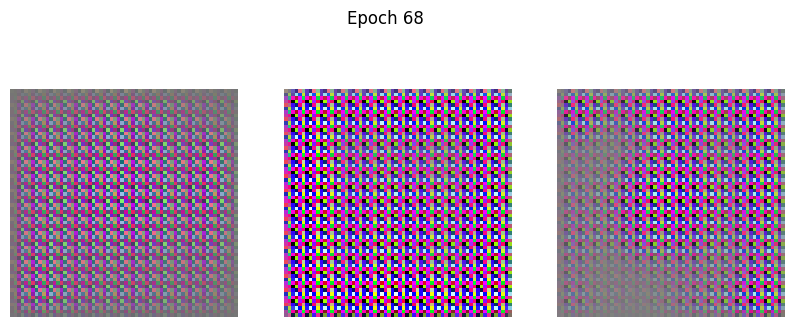

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.2076 - g_loss: 5.4267
Epoch 69/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2880 - g_loss: 9.1386  

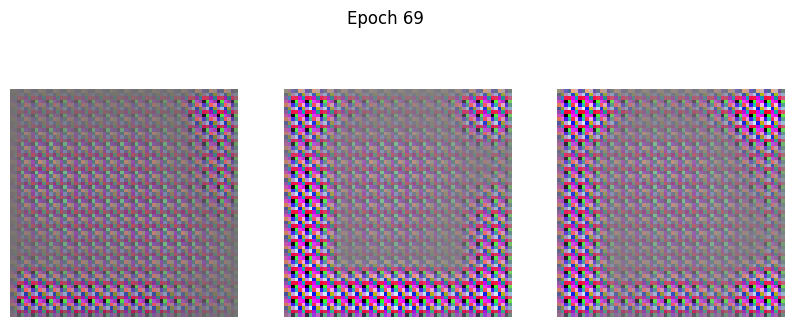

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.2878 - g_loss: 8.8237
Epoch 70/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1893 - g_loss: 6.3850 

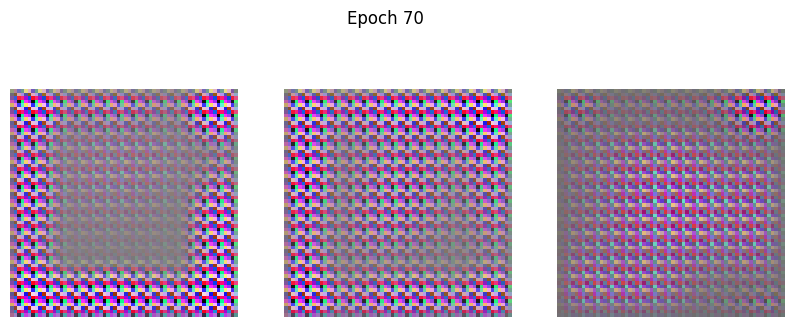

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1767 - g_loss: 6.2573
Epoch 71/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1118 - g_loss: 5.3468 

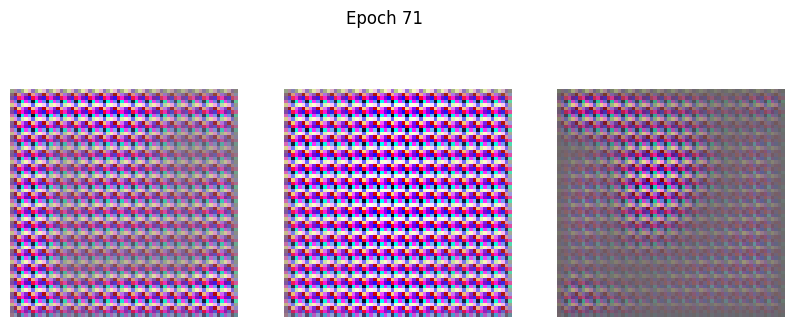

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1108 - g_loss: 5.3614
Epoch 72/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1348 - g_loss: 4.6669 

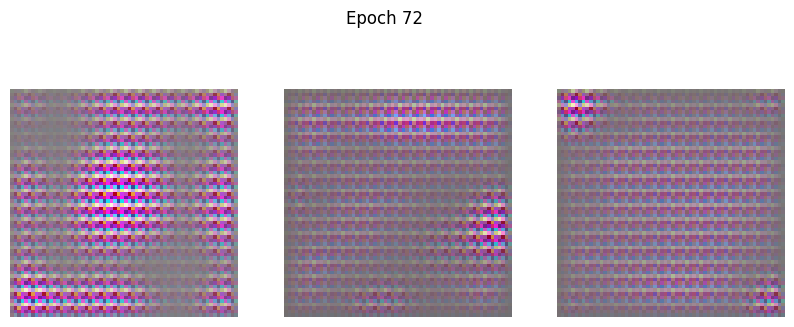

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.1340 - g_loss: 4.6568
Epoch 73/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1266 - g_loss: 4.3431

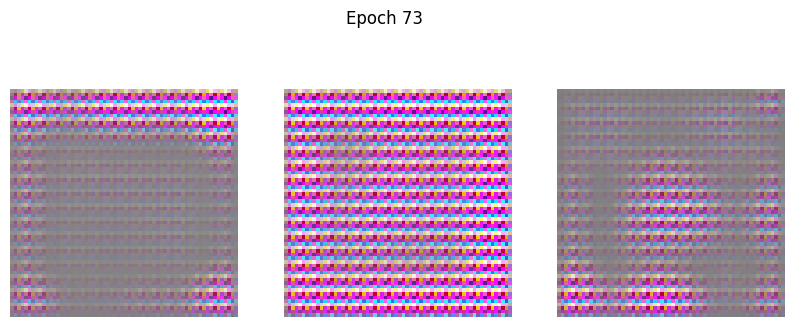

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1271 - g_loss: 4.3224
Epoch 74/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0974 - g_loss: 4.1903 

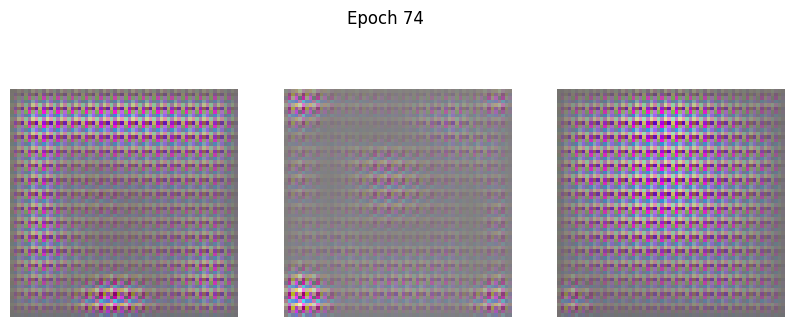

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.0972 - g_loss: 4.2731
Epoch 75/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0952 - g_loss: 4.4606

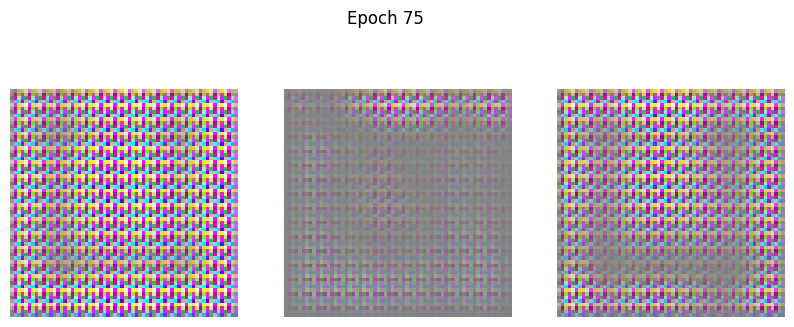

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0959 - g_loss: 4.4540
Epoch 76/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1374 - g_loss: 5.0241

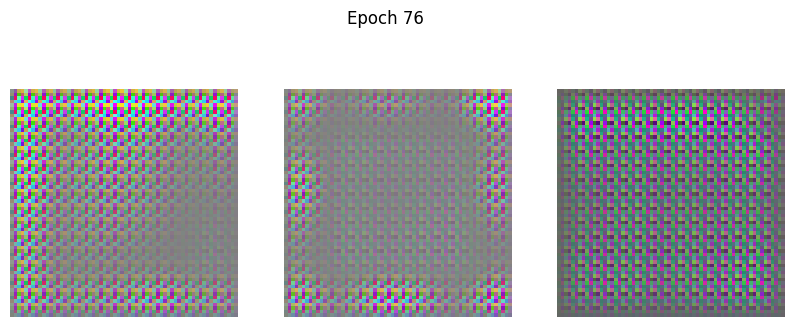

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - d_loss: 0.1353 - g_loss: 4.9507
Epoch 77/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1190 - g_loss: 4.0734

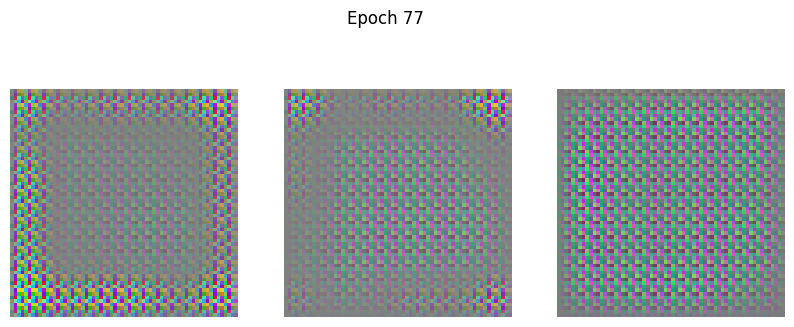

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 292ms/step - d_loss: 0.1280 - g_loss: 4.2052
Epoch 78/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1228 - g_loss: 5.0794 

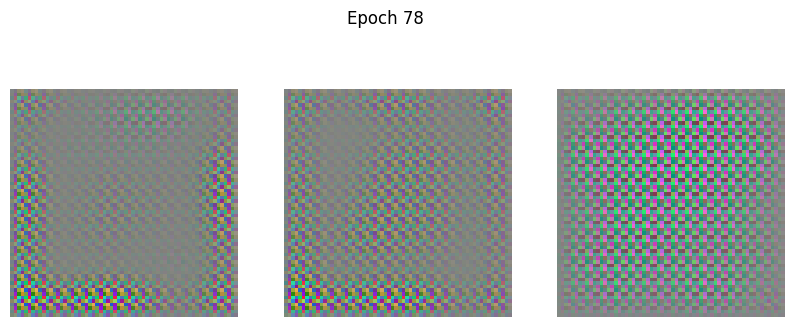

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1213 - g_loss: 5.0304
Epoch 79/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1594 - g_loss: 4.2366 

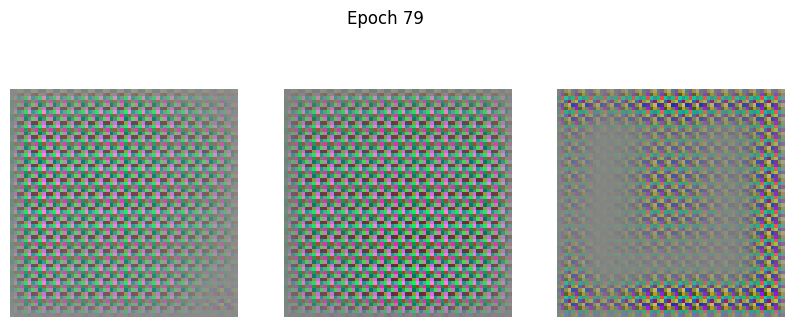

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.1511 - g_loss: 4.2159
Epoch 80/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1166 - g_loss: 3.9716

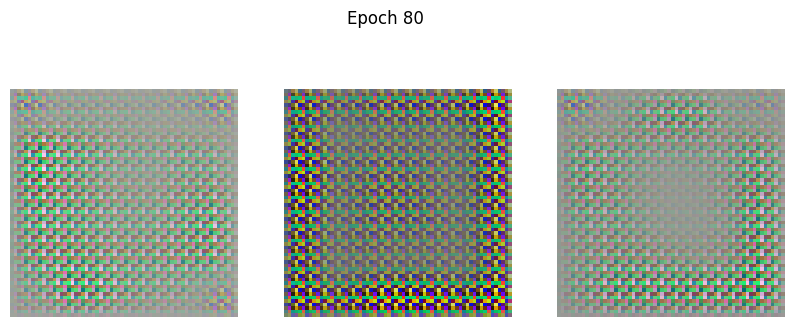

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - d_loss: 0.1169 - g_loss: 3.9684
Epoch 81/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0883 - g_loss: 4.1001 

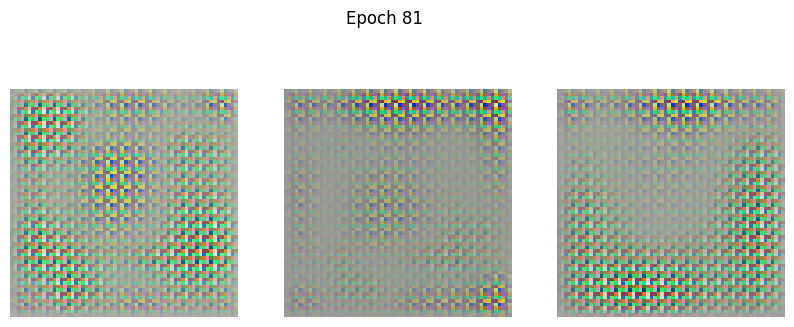

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0858 - g_loss: 4.1257
Epoch 82/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0547 - g_loss: 4.5534

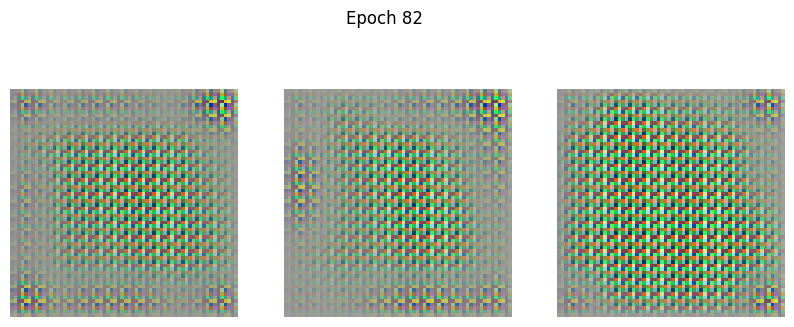

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step - d_loss: 0.0560 - g_loss: 4.5576
Epoch 83/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0491 - g_loss: 4.5115

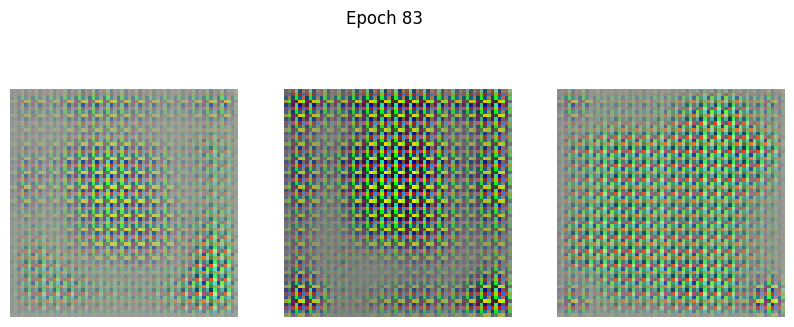

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 280ms/step - d_loss: 0.0558 - g_loss: 4.6550
Epoch 84/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0477 - g_loss: 5.1010

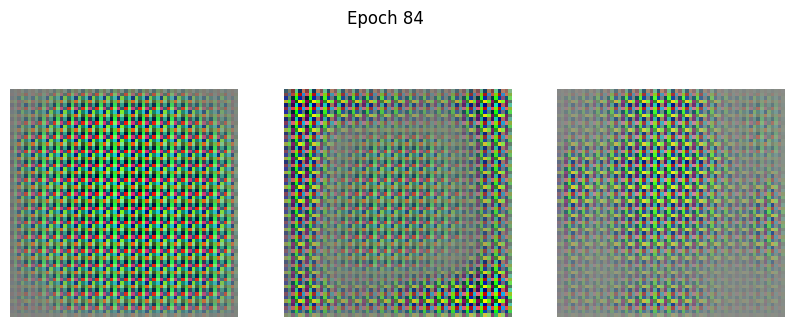

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step - d_loss: 0.0486 - g_loss: 5.0452
Epoch 85/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1208 - g_loss: 7.0512

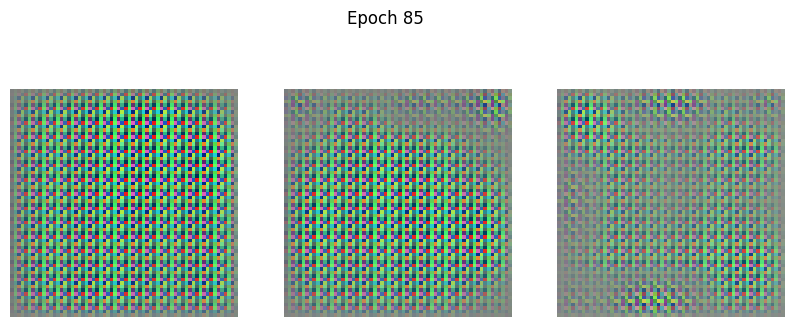

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step - d_loss: 0.1151 - g_loss: 6.9096
Epoch 86/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0768 - g_loss: 5.1041

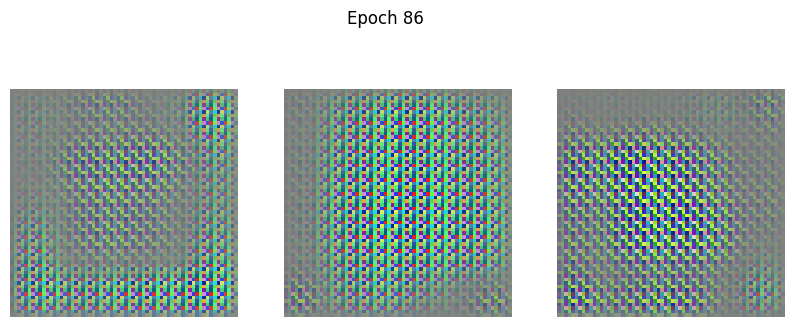

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - d_loss: 0.0809 - g_loss: 5.1688
Epoch 87/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0599 - g_loss: 5.5293

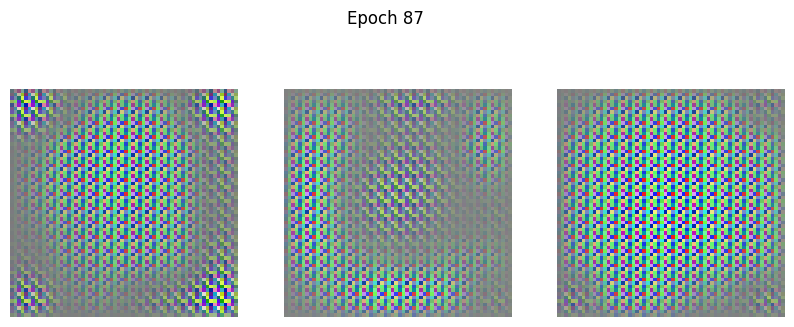

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 217ms/step - d_loss: 0.0605 - g_loss: 5.4206
Epoch 88/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1355 - g_loss: 7.8503

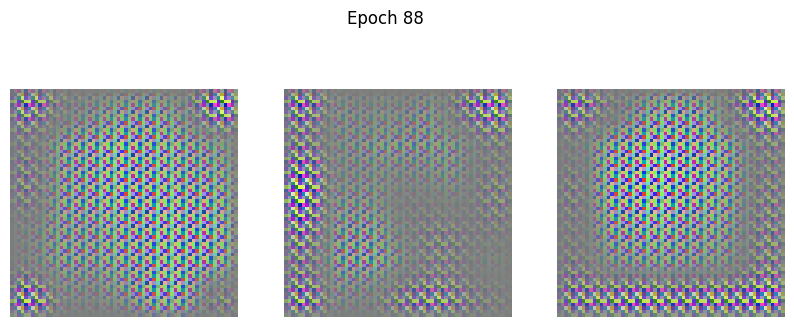

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1342 - g_loss: 7.7037
Epoch 89/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0624 - g_loss: 5.2077 

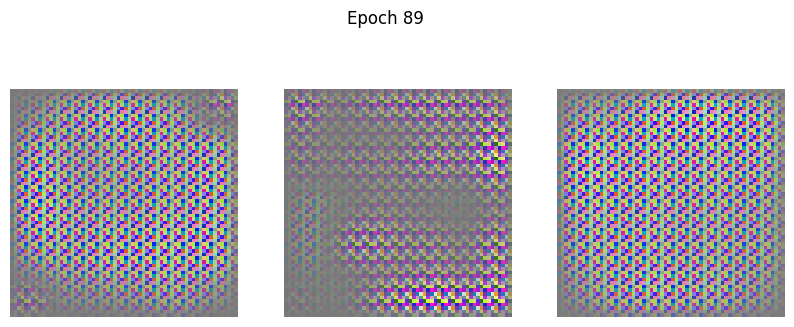

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0687 - g_loss: 5.3430
Epoch 90/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0441 - g_loss: 6.1541 

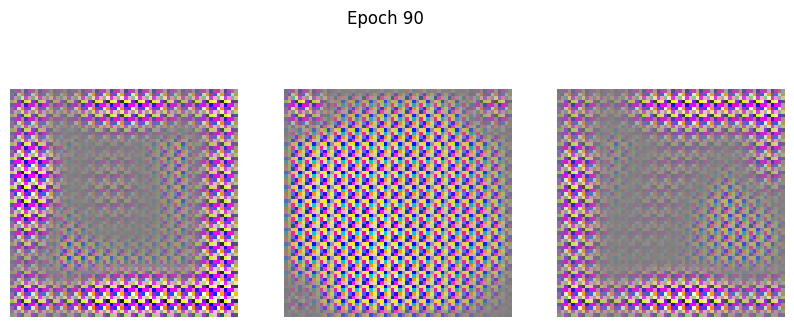

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0435 - g_loss: 6.0059
Epoch 91/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.2380 - g_loss: 8.2030

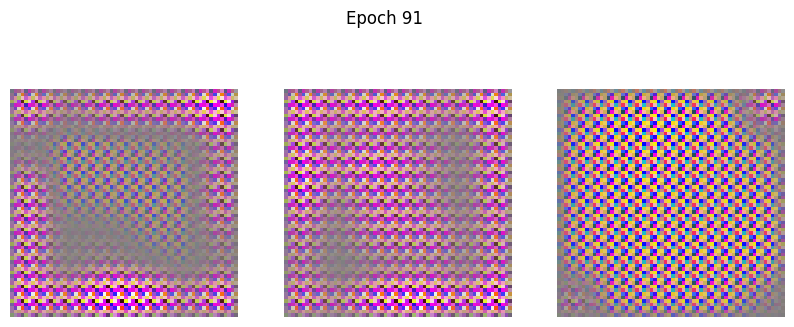

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.2480 - g_loss: 7.7809
Epoch 92/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1796 - g_loss: 7.3270 

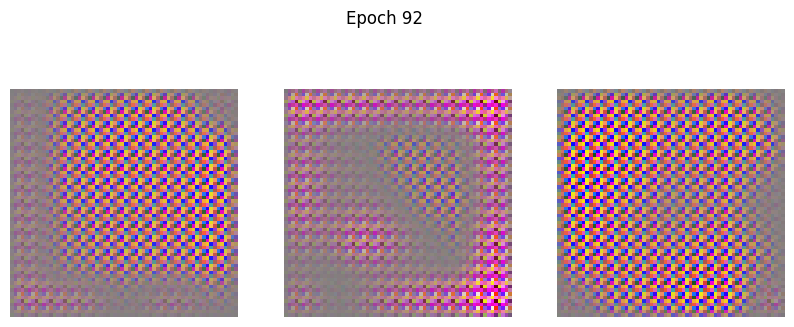

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1680 - g_loss: 7.5687
Epoch 93/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0427 - g_loss: 6.6505

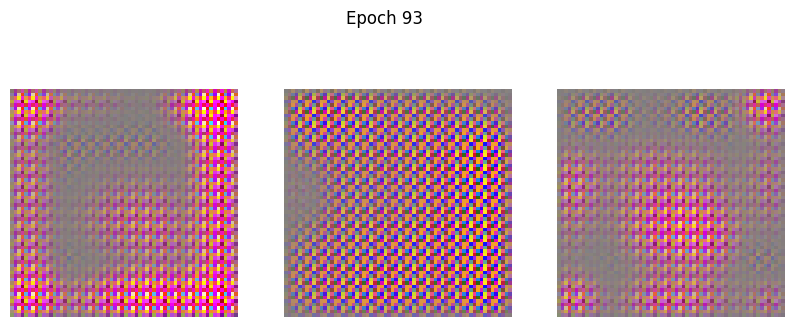

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0445 - g_loss: 6.4910
Epoch 94/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.2033 - g_loss: 7.0665 

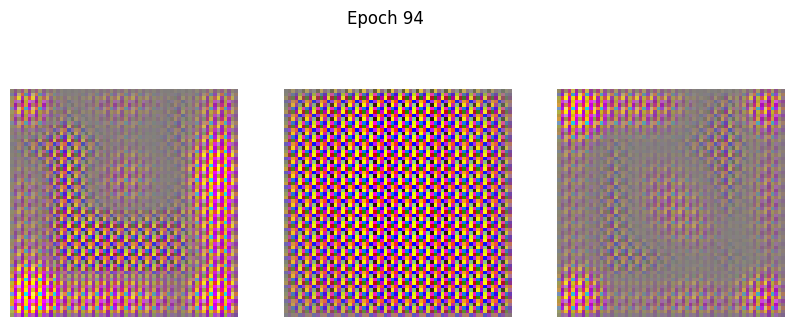

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.2060 - g_loss: 7.0230
Epoch 95/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2112 - g_loss: 6.0259 

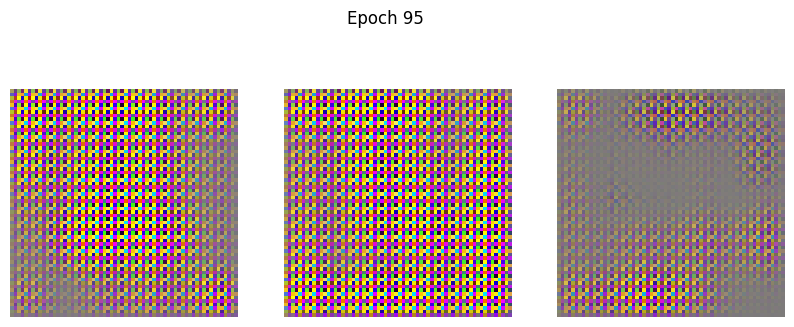

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.2537 - g_loss: 6.7422
Epoch 96/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.2388 - g_loss: 7.7519

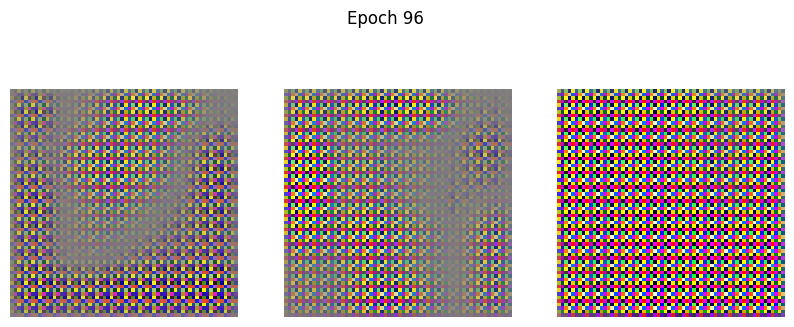

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.2257 - g_loss: 7.7286
Epoch 97/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0578 - g_loss: 5.9239

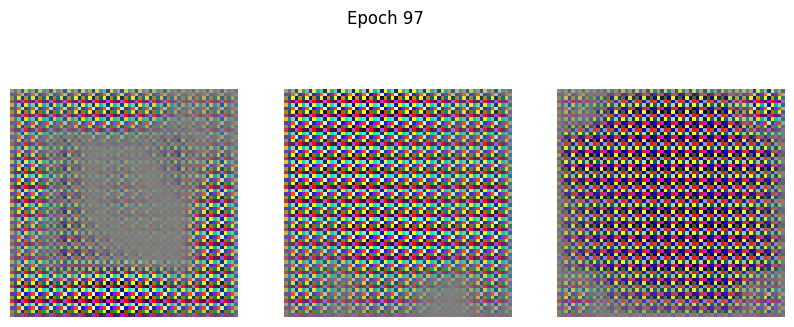

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.0639 - g_loss: 6.1578
Epoch 98/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1496 - g_loss: 7.2518

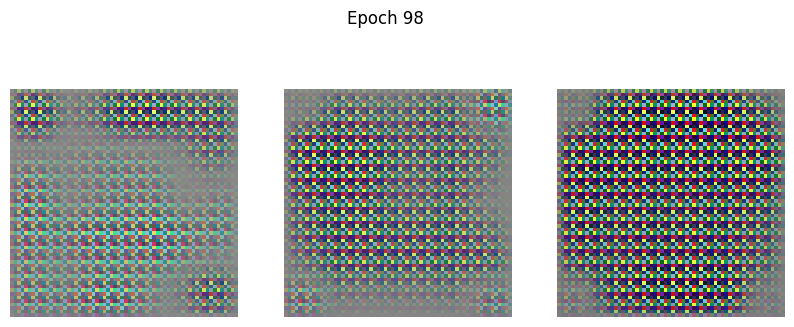

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1690 - g_loss: 7.3044
Epoch 99/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.2398 - g_loss: 5.5109

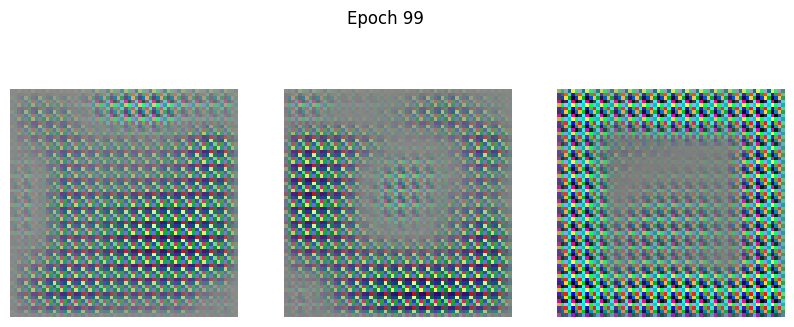

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.2469 - g_loss: 5.6579
Epoch 100/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.2536 - g_loss: 7.1324

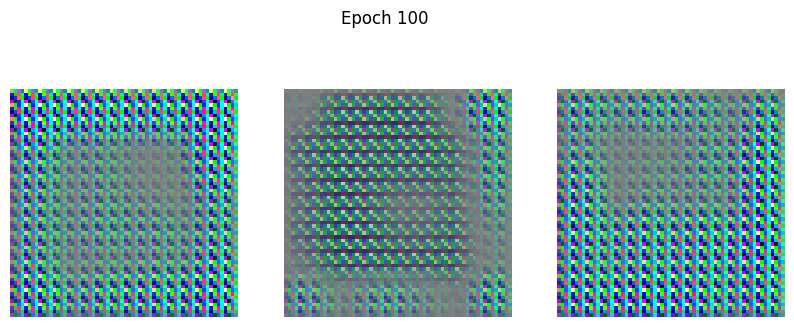

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.2687 - g_loss: 6.6788
Epoch 101/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.7358 - g_loss: 7.8659

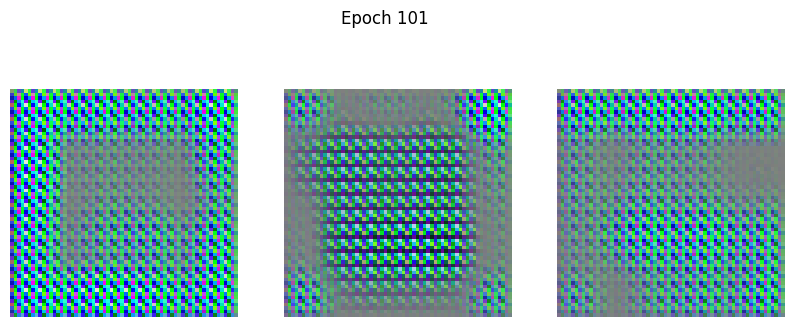

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.6721 - g_loss: 7.7981
Epoch 102/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1089 - g_loss: 4.6735

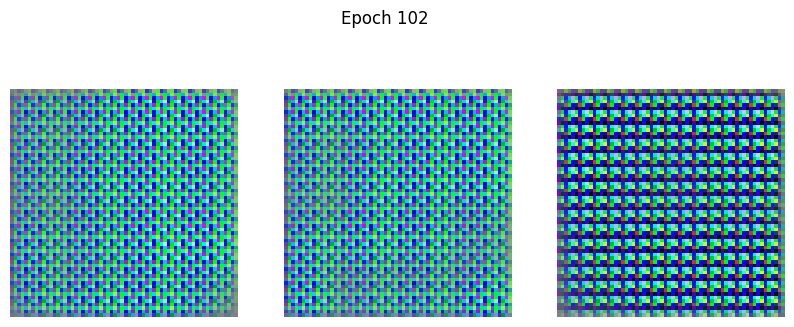

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1127 - g_loss: 4.7476
Epoch 103/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0730 - g_loss: 5.3546 

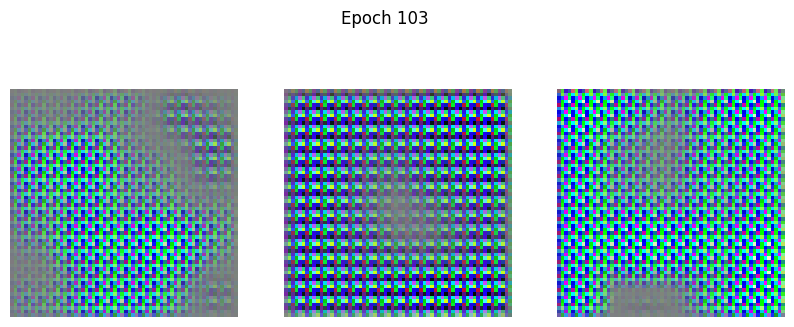

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step - d_loss: 0.0709 - g_loss: 5.2935
Epoch 104/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0759 - g_loss: 5.8164

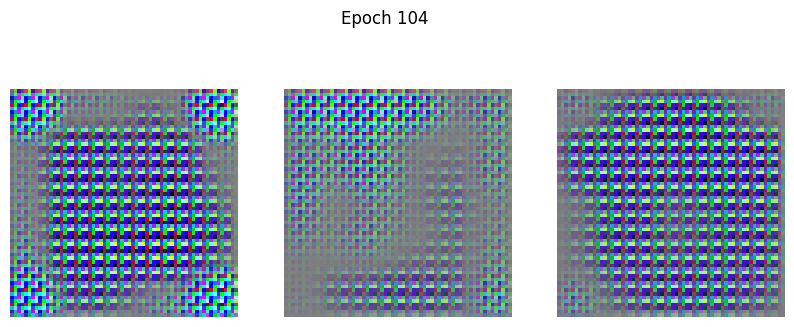

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 223ms/step - d_loss: 0.0776 - g_loss: 5.9208
Epoch 105/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1777 - g_loss: 6.6248 

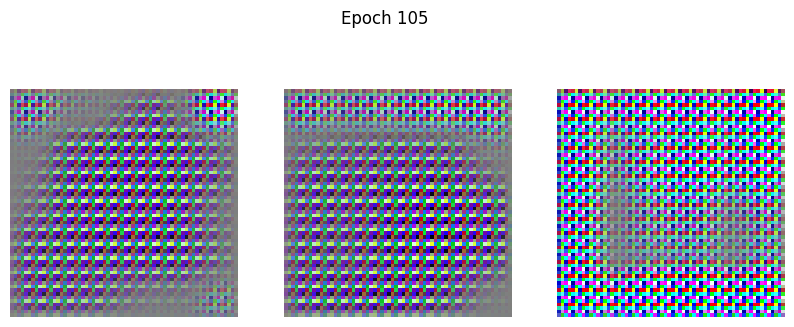

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.2078 - g_loss: 7.2178
Epoch 106/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.4228 - g_loss: 5.2318

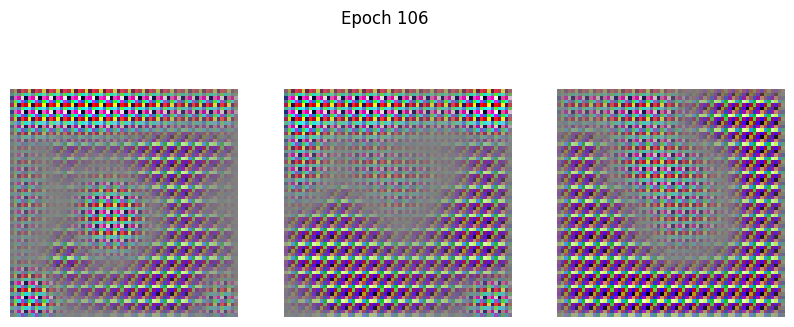

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.3966 - g_loss: 5.1980
Epoch 107/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0562 - g_loss: 5.5476 

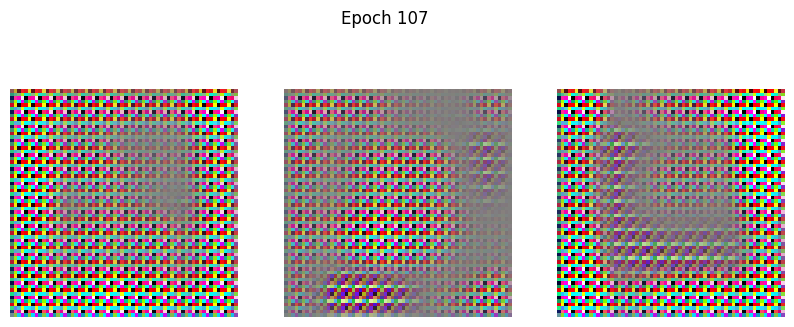

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0535 - g_loss: 5.5411
Epoch 108/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0510 - g_loss: 5.3602 

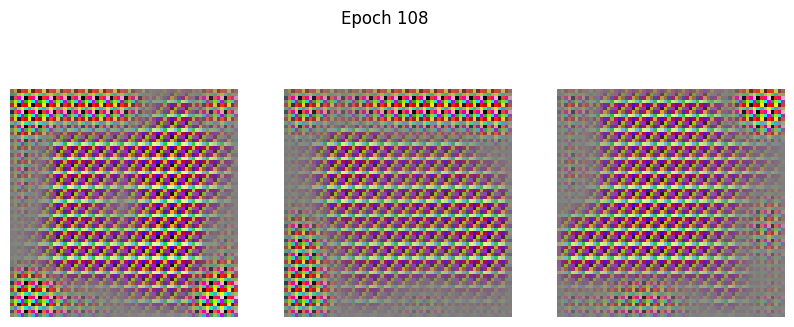

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - d_loss: 0.0494 - g_loss: 5.3057
Epoch 109/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0483 - g_loss: 4.1808 

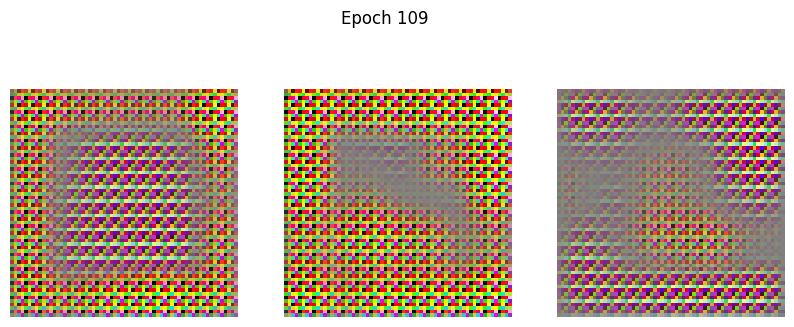

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0507 - g_loss: 4.2333
Epoch 110/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0628 - g_loss: 4.7673 

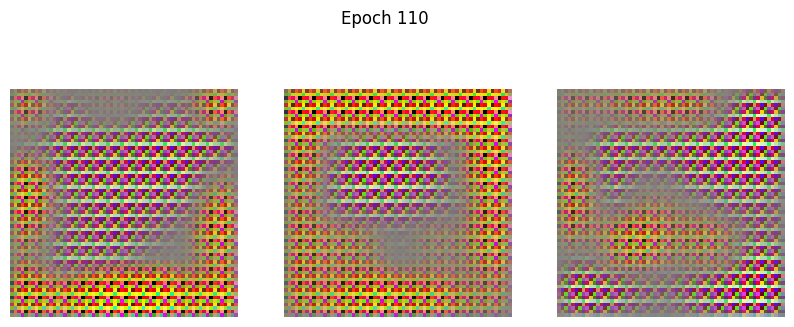

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.0619 - g_loss: 4.7320
Epoch 111/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0905 - g_loss: 5.1366

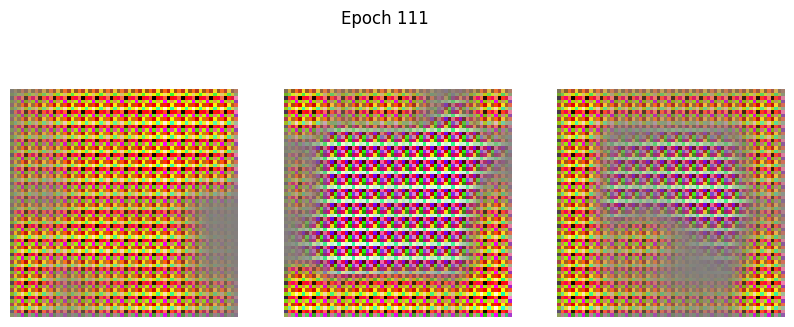

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.0901 - g_loss: 5.0562
Epoch 112/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1033 - g_loss: 4.8557

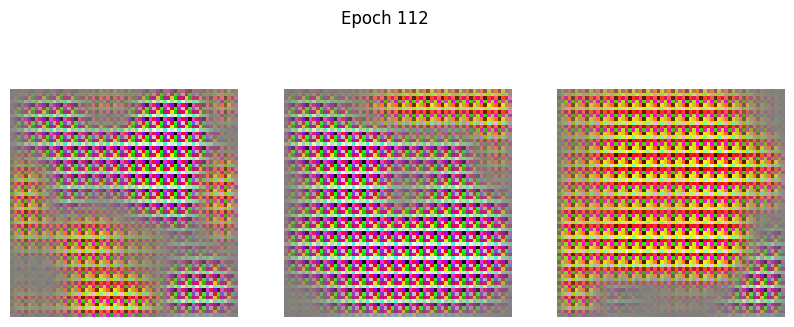

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0997 - g_loss: 4.8204
Epoch 113/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1109 - g_loss: 5.4917 

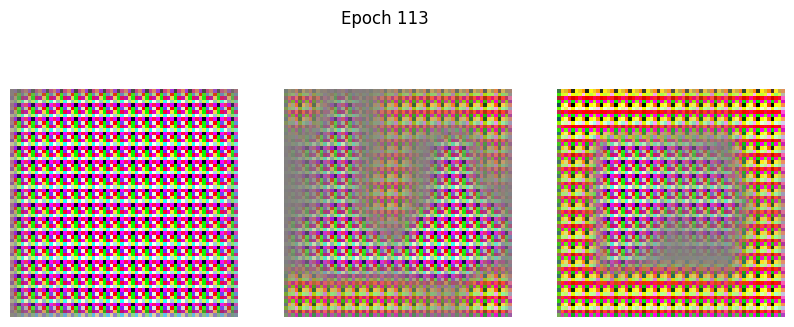

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.1048 - g_loss: 5.3924
Epoch 114/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1068 - g_loss: 6.2579 

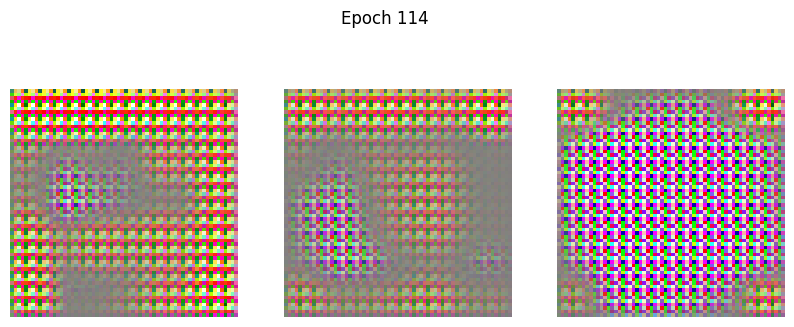

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1045 - g_loss: 6.1899
Epoch 115/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1696 - g_loss: 6.5174 

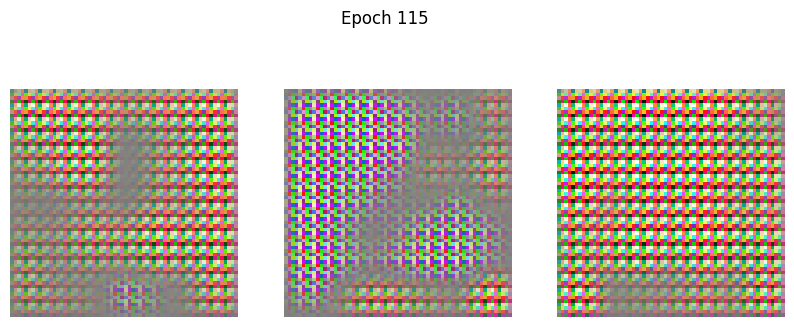

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1642 - g_loss: 6.3452
Epoch 116/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.2337 - g_loss: 8.0187

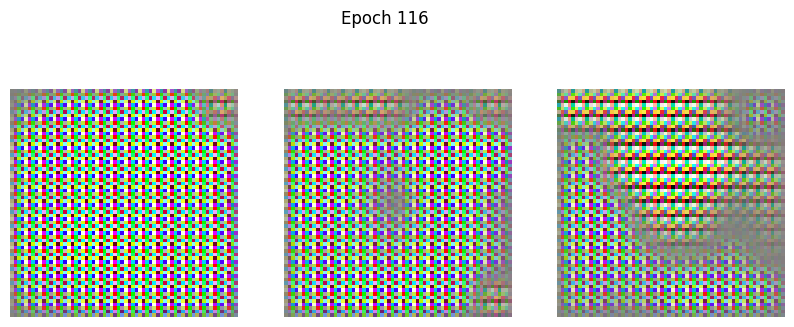

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.2417 - g_loss: 7.5946
Epoch 117/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2828 - g_loss: 11.4617 

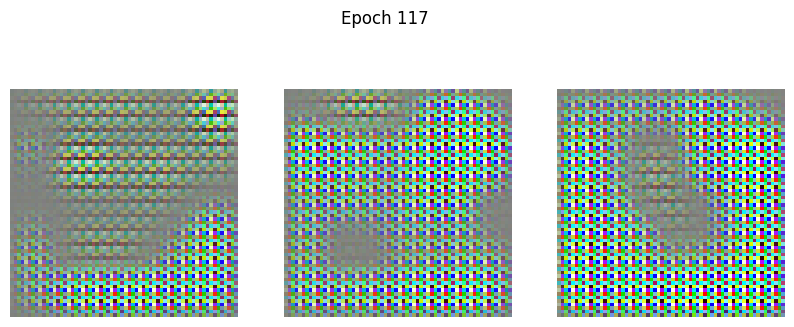

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.2673 - g_loss: 11.4330
Epoch 118/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1769 - g_loss: 6.9924 

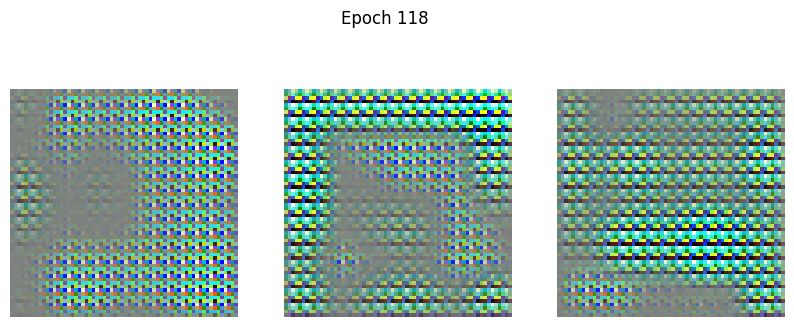

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.1889 - g_loss: 6.9895
Epoch 119/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1173 - g_loss: 5.9821 

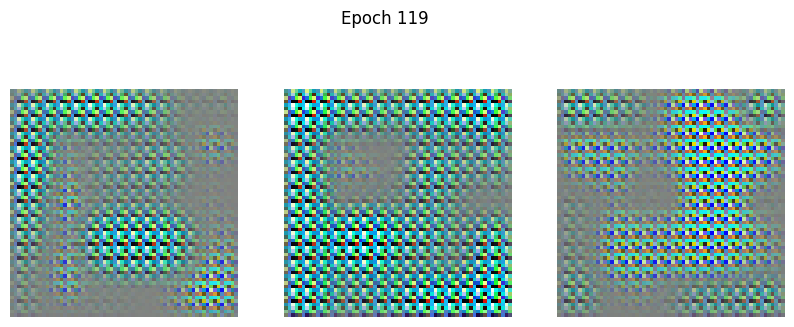

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1231 - g_loss: 6.0086
Epoch 120/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1750 - g_loss: 5.0719

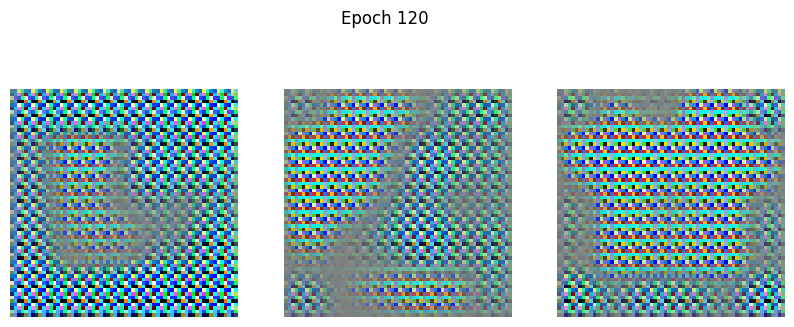

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 262ms/step - d_loss: 0.1813 - g_loss: 5.2590
Epoch 121/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1593 - g_loss: 5.3869

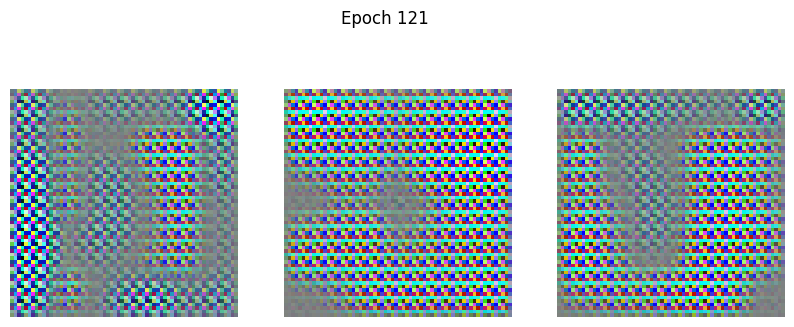

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 295ms/step - d_loss: 0.1713 - g_loss: 5.5980
Epoch 122/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.2240 - g_loss: 5.1125 

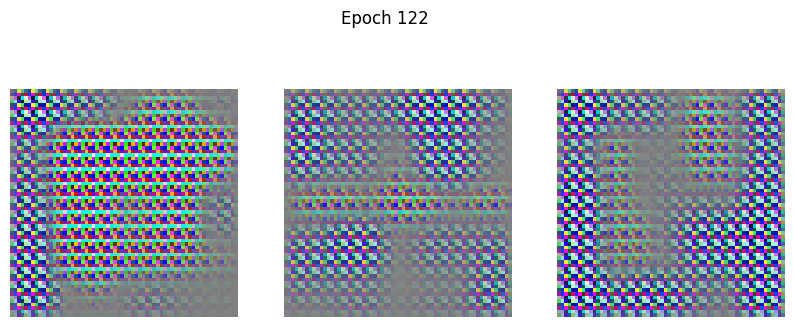

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.2294 - g_loss: 5.4710
Epoch 123/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1538 - g_loss: 5.3768

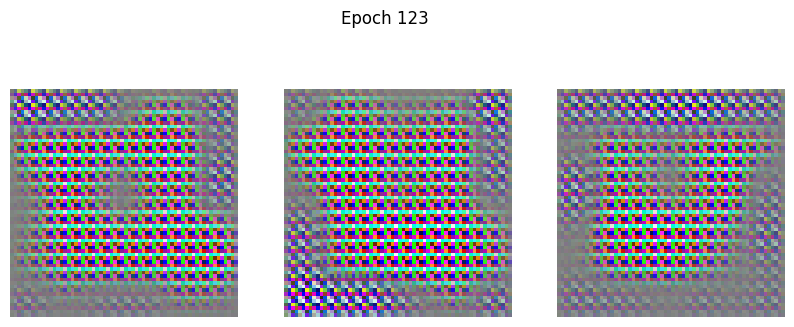

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1531 - g_loss: 5.2397
Epoch 124/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1523 - g_loss: 6.4883

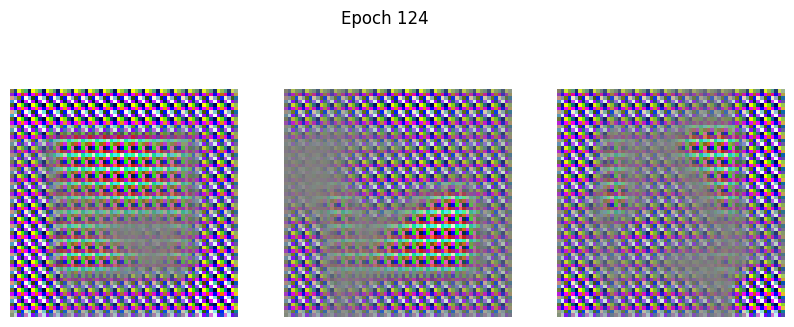

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step - d_loss: 0.1531 - g_loss: 6.3095
Epoch 125/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1188 - g_loss: 5.2656

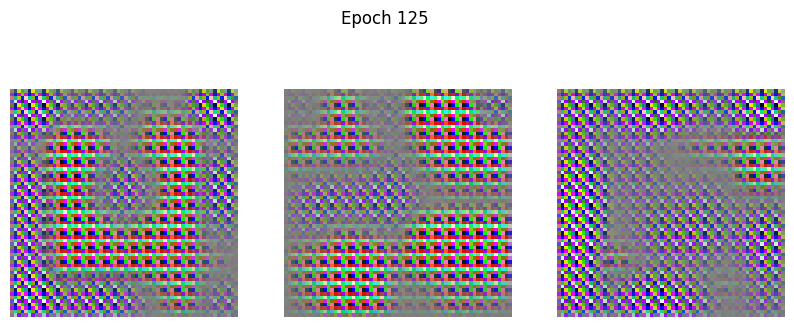

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step - d_loss: 0.1268 - g_loss: 5.4816
Epoch 126/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1552 - g_loss: 4.4871 

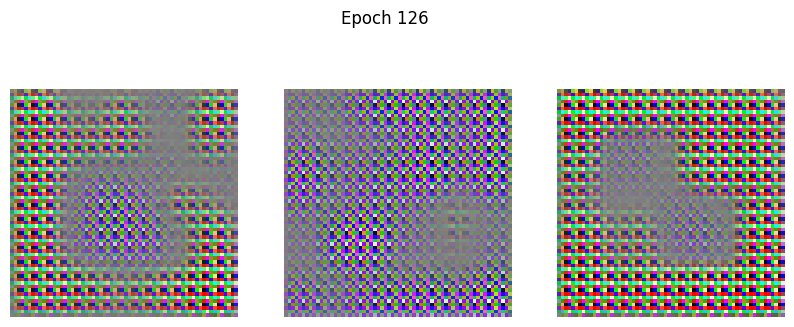

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step - d_loss: 0.1494 - g_loss: 4.4999
Epoch 127/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1079 - g_loss: 5.4963 

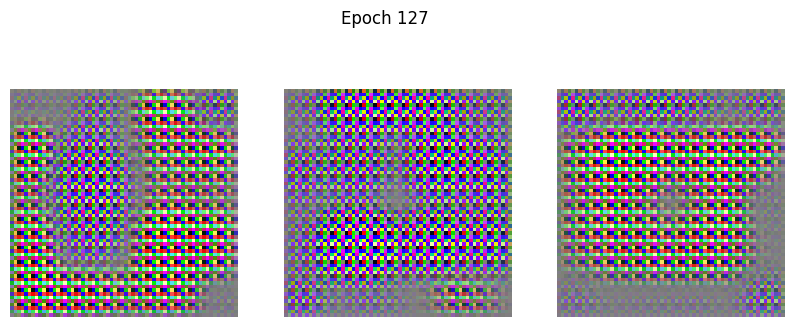

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.1072 - g_loss: 5.4597
Epoch 128/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1114 - g_loss: 5.0734

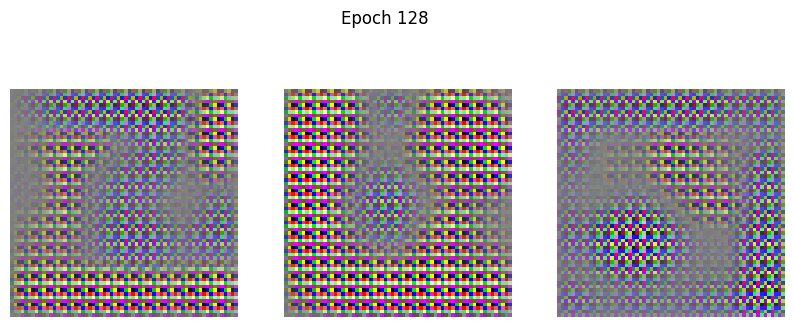

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step - d_loss: 0.1143 - g_loss: 5.1320
Epoch 129/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1048 - g_loss: 4.8888 

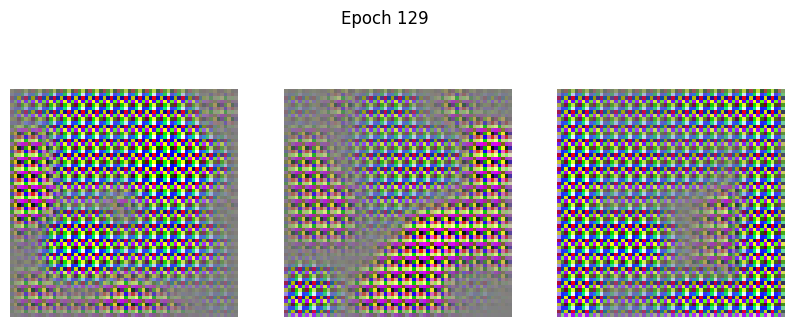

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 173ms/step - d_loss: 0.1044 - g_loss: 4.9931
Epoch 130/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0808 - g_loss: 4.5956 

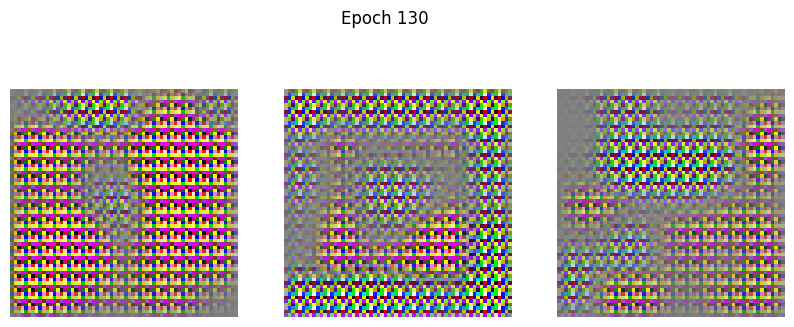

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0801 - g_loss: 4.6330
Epoch 131/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0540 - g_loss: 4.9407

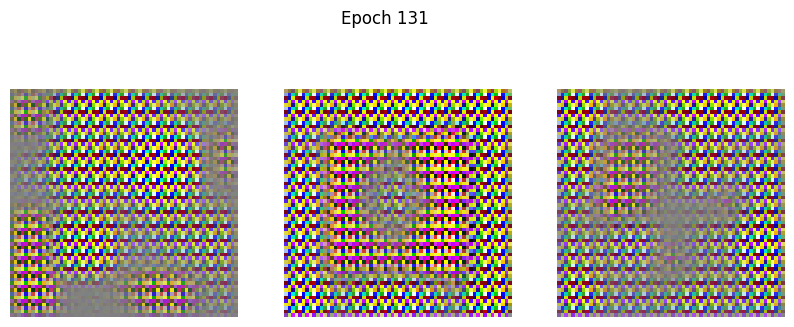

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0541 - g_loss: 4.8822
Epoch 132/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0535 - g_loss: 4.6134

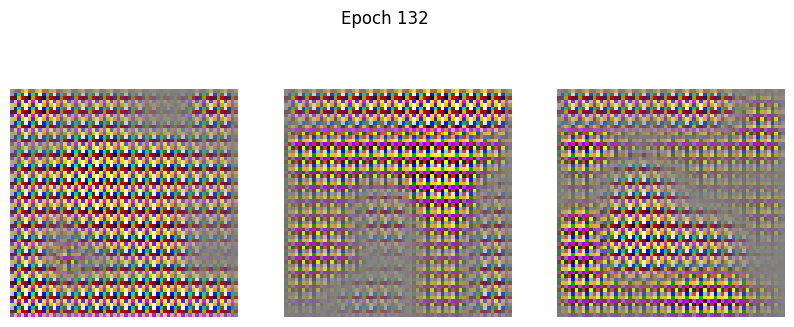

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.0550 - g_loss: 4.6828
Epoch 133/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0609 - g_loss: 5.2236

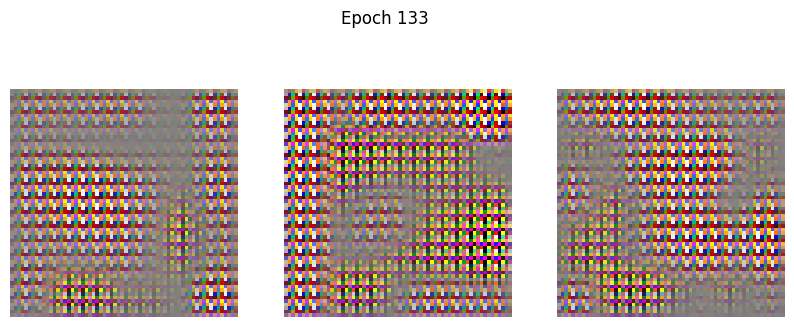

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - d_loss: 0.0640 - g_loss: 5.2671
Epoch 134/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1155 - g_loss: 5.8963 

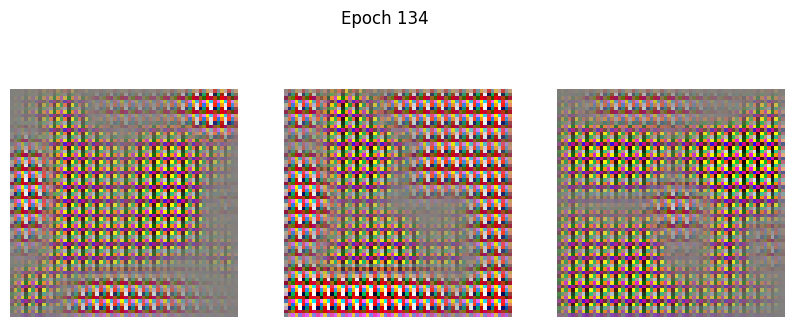

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - d_loss: 0.1208 - g_loss: 6.0770
Epoch 135/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2883 - g_loss: 5.1269 

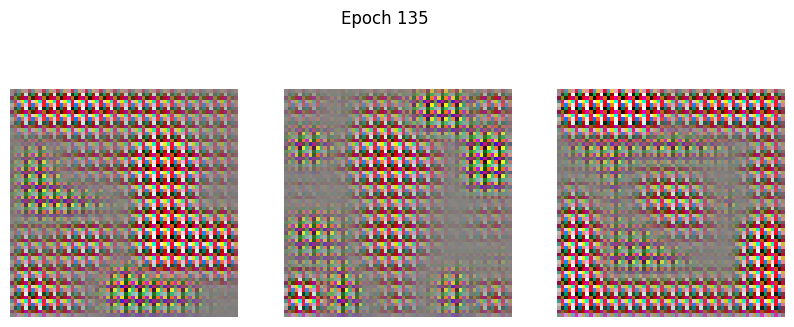

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.3066 - g_loss: 5.8165
Epoch 136/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1763 - g_loss: 8.4721

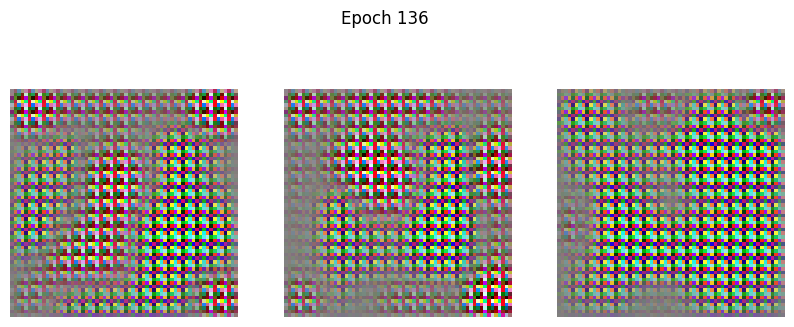

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1671 - g_loss: 8.0492
Epoch 137/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1380 - g_loss: 6.7308 

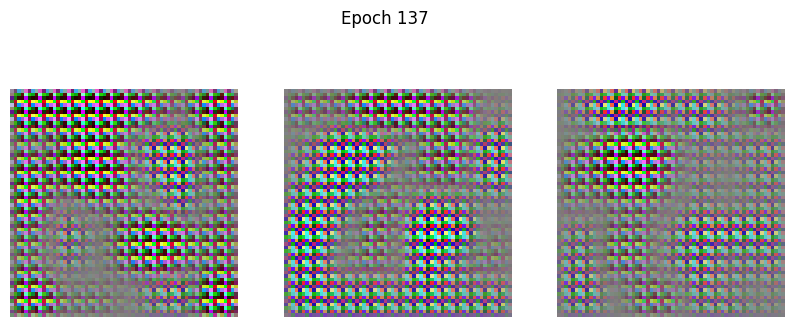

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step - d_loss: 0.1259 - g_loss: 6.6590
Epoch 138/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1135 - g_loss: 6.2832

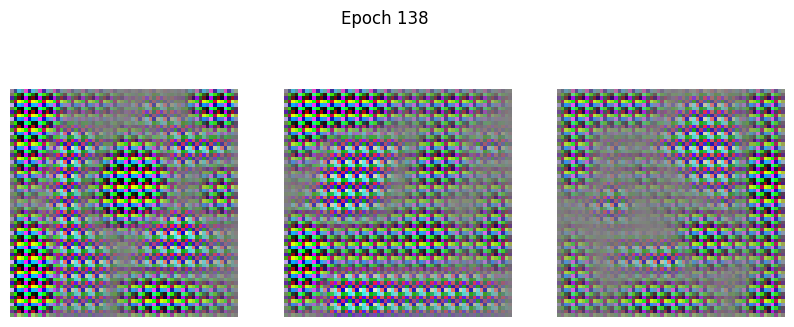

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1177 - g_loss: 6.2005
Epoch 139/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1115 - g_loss: 6.1954 

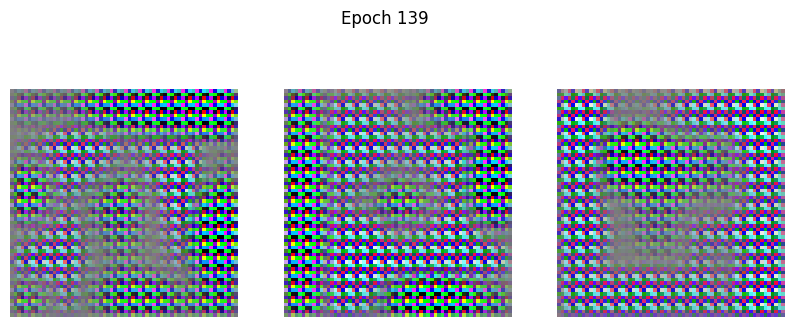

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1101 - g_loss: 6.4749
Epoch 140/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1105 - g_loss: 5.9624

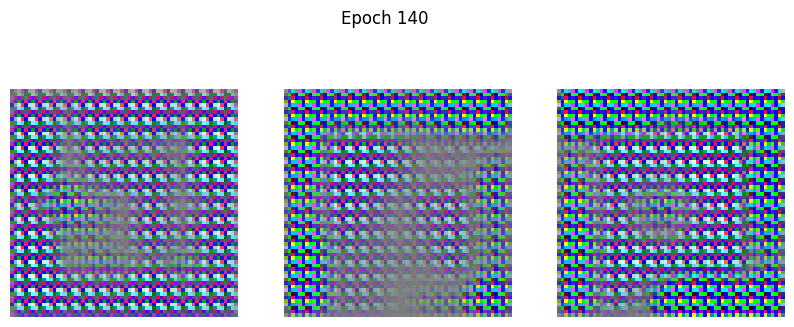

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1156 - g_loss: 6.1268
Epoch 141/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1380 - g_loss: 7.4853

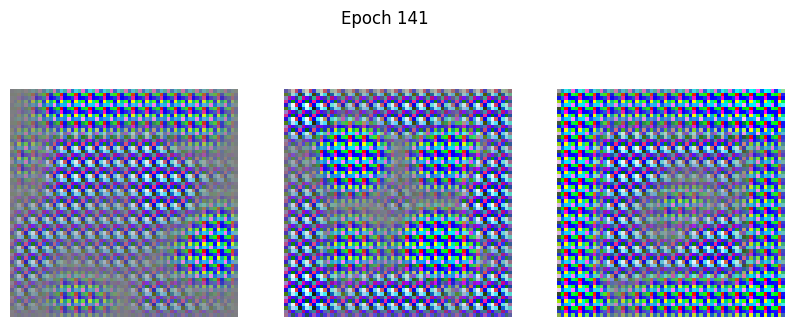

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1499 - g_loss: 7.9613
Epoch 142/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.2688 - g_loss: 6.6830

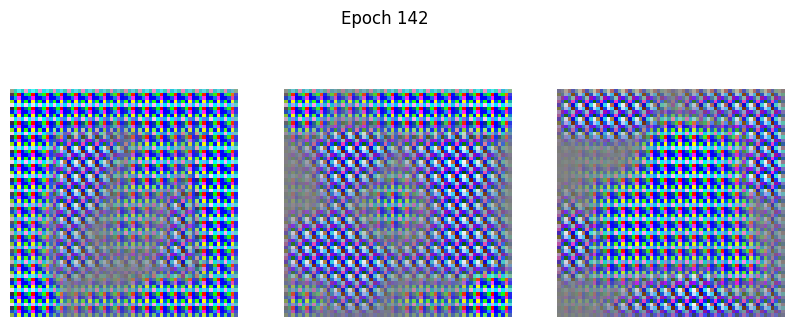

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.2590 - g_loss: 7.3437
Epoch 143/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0862 - g_loss: 10.7742 

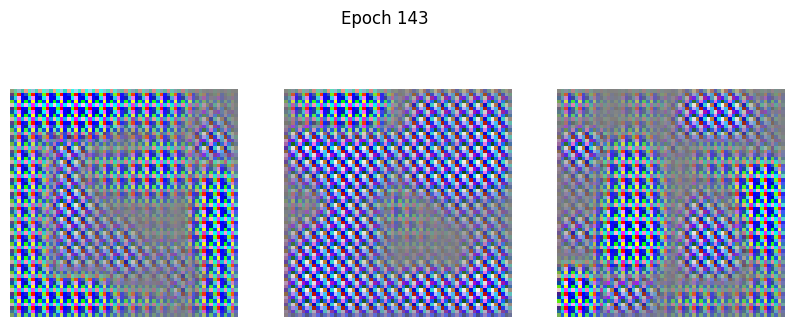

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.0835 - g_loss: 10.4128
Epoch 144/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0789 - g_loss: 5.8918

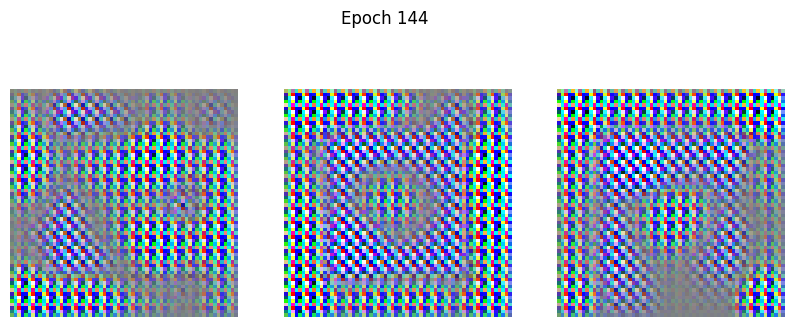

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.1001 - g_loss: 6.7509
Epoch 145/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1868 - g_loss: 9.7689

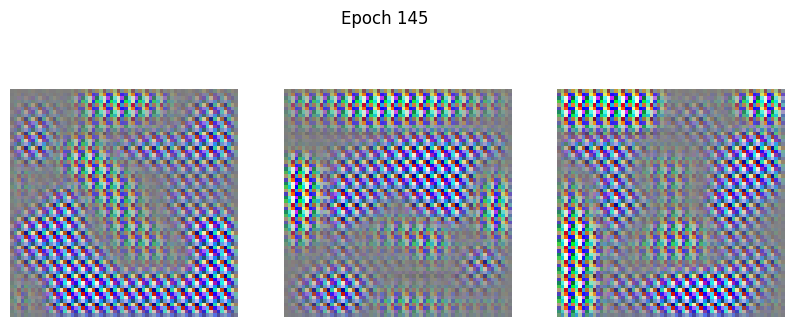

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1822 - g_loss: 9.2625
Epoch 146/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0713 - g_loss: 4.9053

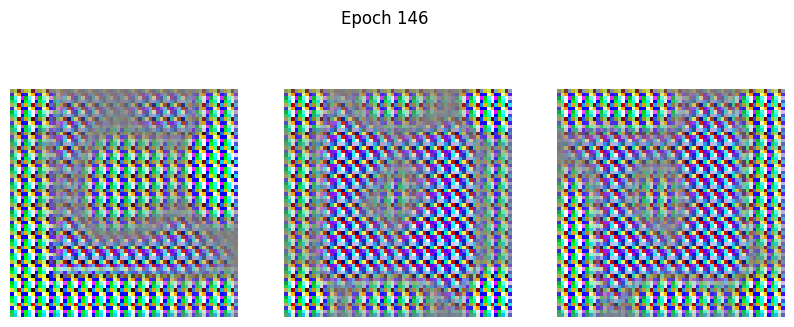

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.0732 - g_loss: 5.0560
Epoch 147/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0329 - g_loss: 5.1281

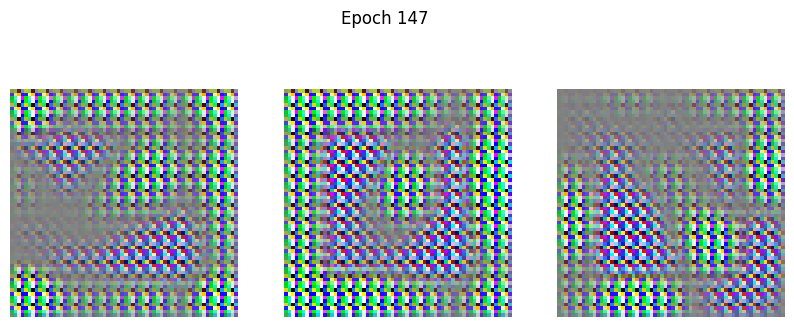

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.0352 - g_loss: 5.0047
Epoch 148/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1530 - g_loss: 6.1218

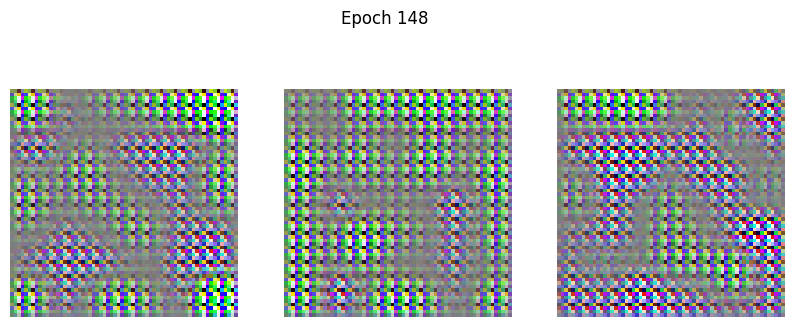

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1529 - g_loss: 5.9077
Epoch 149/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1079 - g_loss: 4.6417

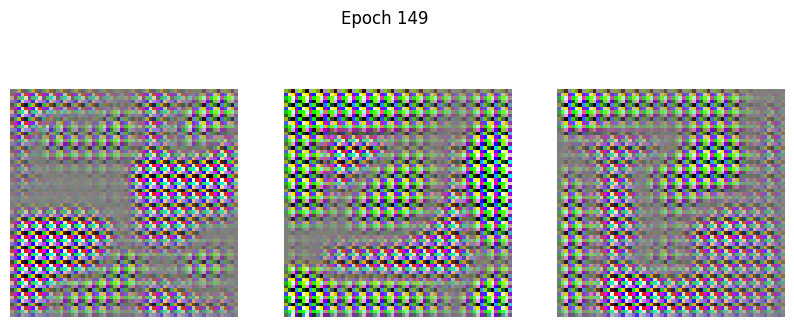

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1057 - g_loss: 4.6871
Epoch 150/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0858 - g_loss: 4.9565 

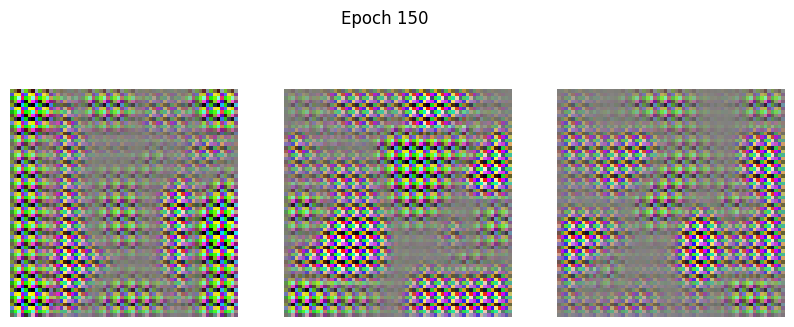

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0874 - g_loss: 5.0569
Epoch 151/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1197 - g_loss: 5.8855 

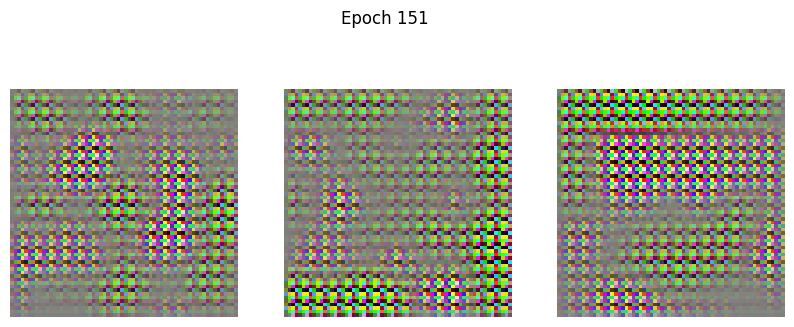

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step - d_loss: 0.1236 - g_loss: 6.1009
Epoch 152/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1556 - g_loss: 5.2932 

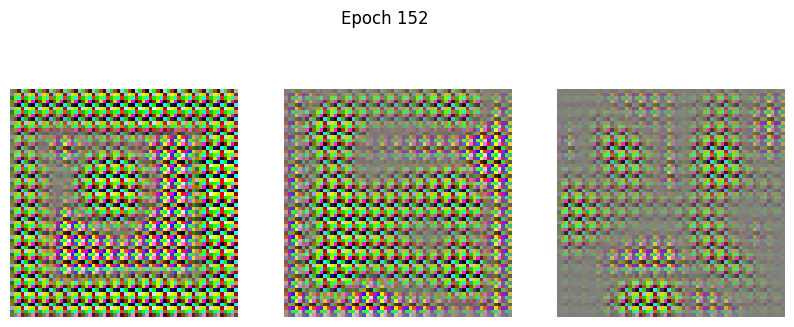

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 171ms/step - d_loss: 0.1500 - g_loss: 5.4275
Epoch 153/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0494 - g_loss: 5.5222 

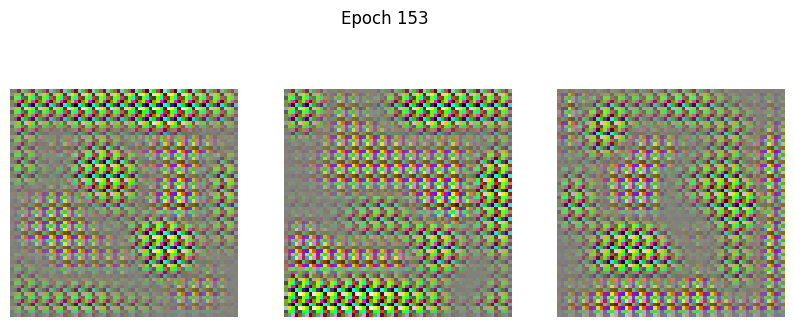

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.0504 - g_loss: 5.5180
Epoch 154/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0957 - g_loss: 6.5974 

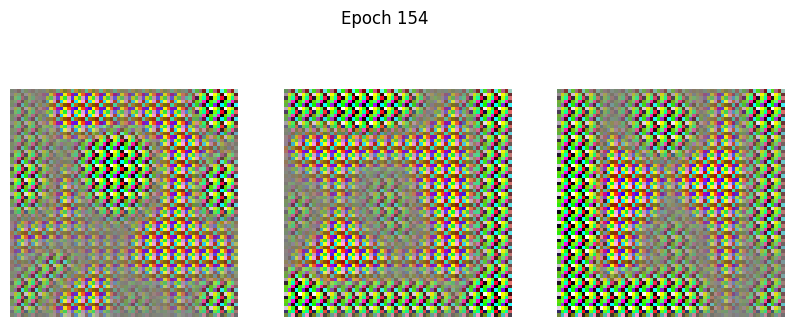

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0943 - g_loss: 6.4886
Epoch 155/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1206 - g_loss: 4.8819

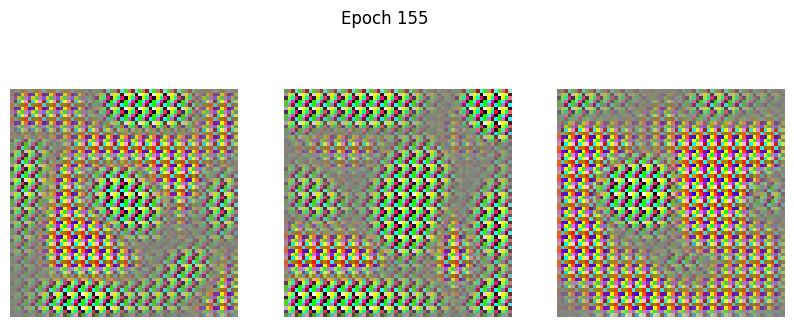

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.1273 - g_loss: 5.0956
Epoch 156/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1555 - g_loss: 4.8525 

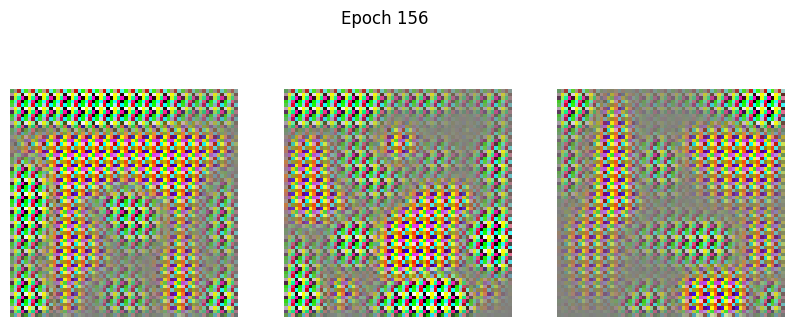

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1543 - g_loss: 5.1249
Epoch 157/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0615 - g_loss: 5.8128 

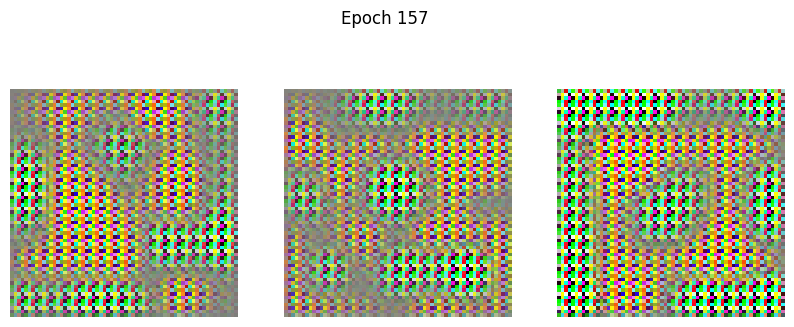

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.0589 - g_loss: 5.6439
Epoch 158/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0479 - g_loss: 4.9735

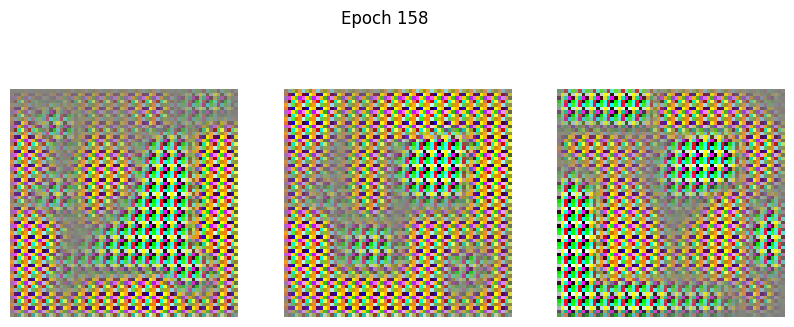

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 646ms/step - d_loss: 0.0469 - g_loss: 4.9707
Epoch 159/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0440 - g_loss: 5.3219

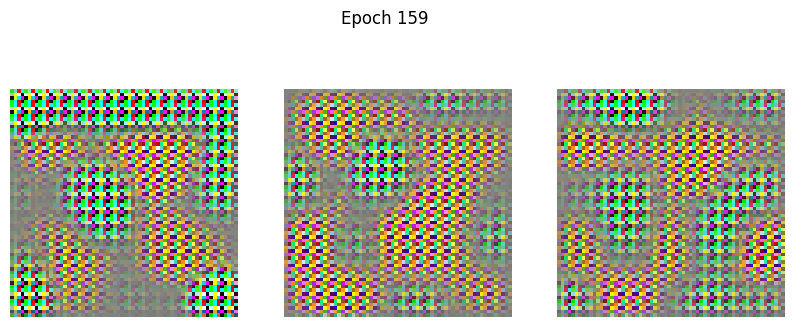

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 277ms/step - d_loss: 0.0448 - g_loss: 5.2559
Epoch 160/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0680 - g_loss: 5.2939 

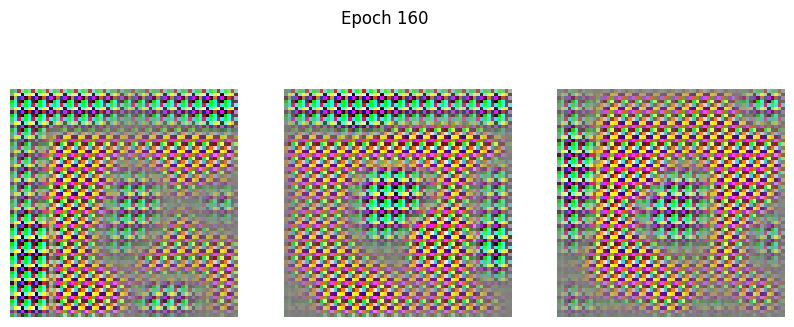

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - d_loss: 0.0660 - g_loss: 5.2884
Epoch 161/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0534 - g_loss: 5.0539

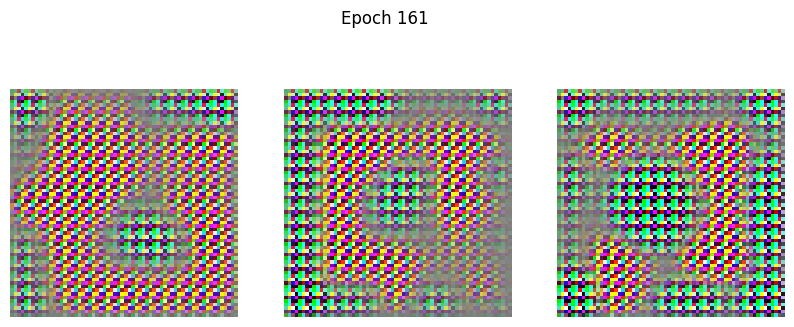

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 308ms/step - d_loss: 0.0556 - g_loss: 5.0138
Epoch 162/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0511 - g_loss: 5.2335

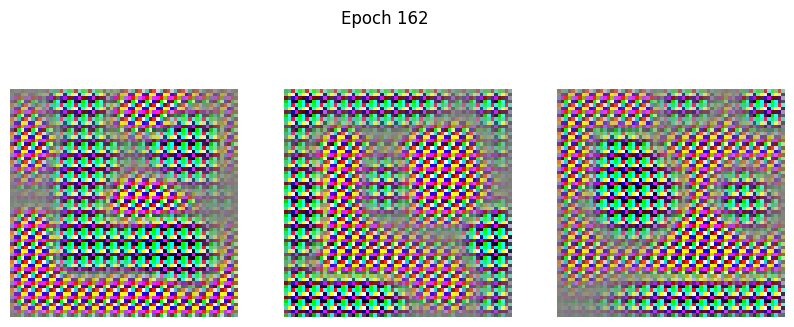

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 306ms/step - d_loss: 0.0517 - g_loss: 5.2662
Epoch 163/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0373 - g_loss: 5.2935

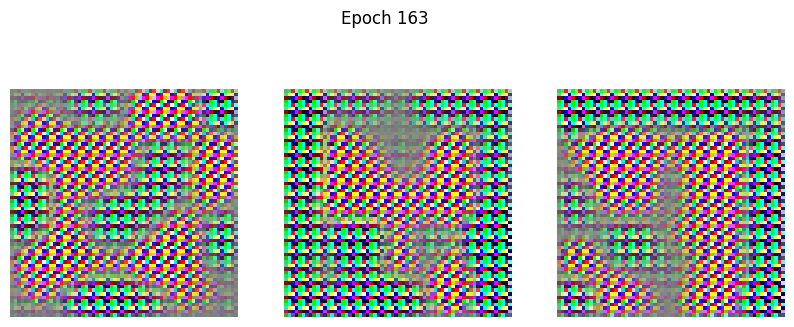

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step - d_loss: 0.0387 - g_loss: 5.3365
Epoch 164/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.0430 - g_loss: 5.5324 

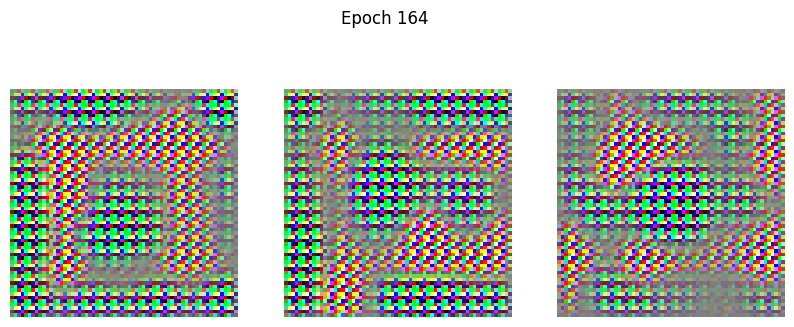

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step - d_loss: 0.0429 - g_loss: 5.5798
Epoch 165/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0520 - g_loss: 5.6344 

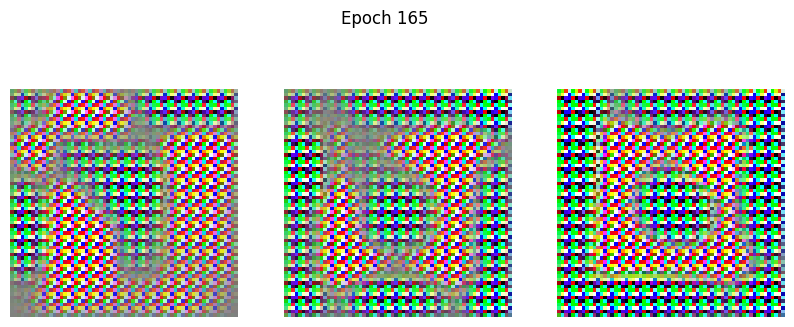

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.0515 - g_loss: 5.6238
Epoch 166/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0774 - g_loss: 5.9159

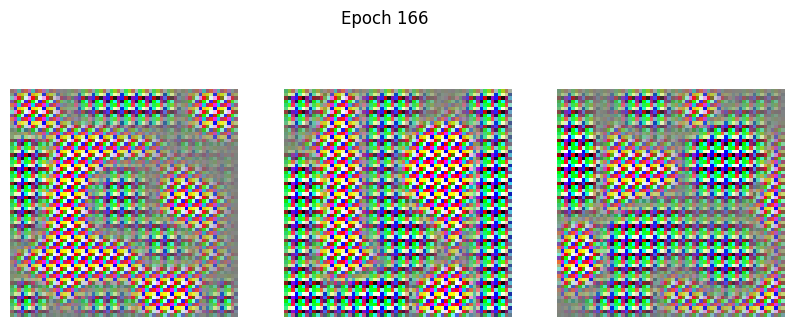

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step - d_loss: 0.0797 - g_loss: 5.6195
Epoch 167/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.2198 - g_loss: 11.9459

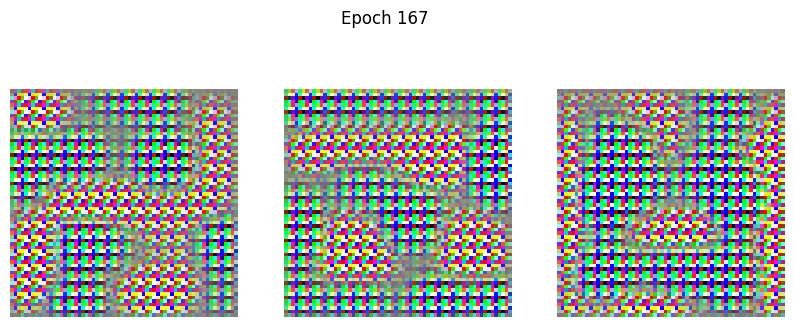

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - d_loss: 0.2468 - g_loss: 11.1876
Epoch 168/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1045 - g_loss: 8.0053 

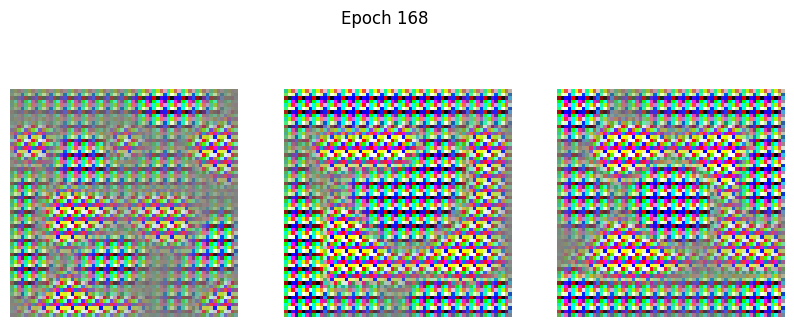

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 290ms/step - d_loss: 0.1480 - g_loss: 9.9683
Epoch 169/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.3518 - g_loss: 30.4458 

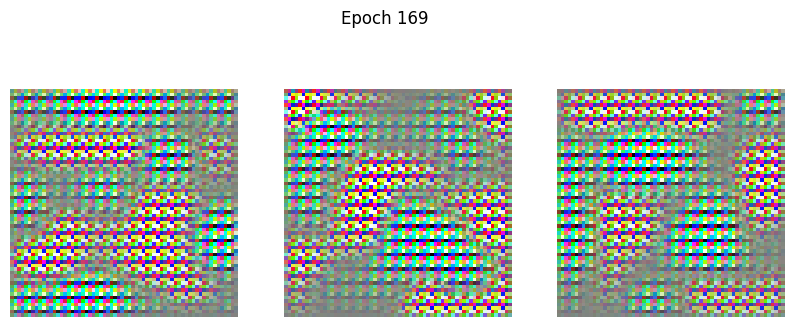

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - d_loss: 0.3655 - g_loss: 29.8160
Epoch 170/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1785 - g_loss: 15.0035

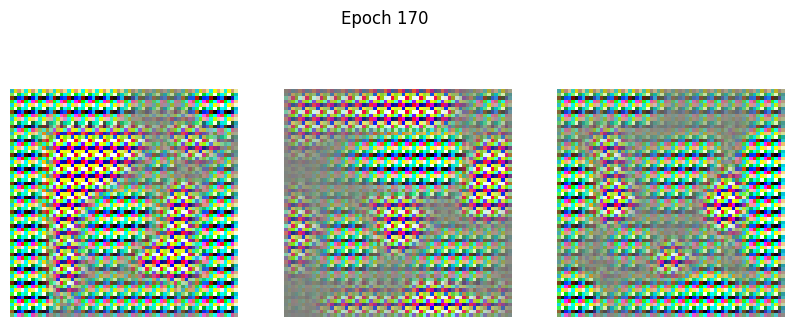

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step - d_loss: 0.1674 - g_loss: 14.4260
Epoch 171/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0129 - g_loss: 4.7984 

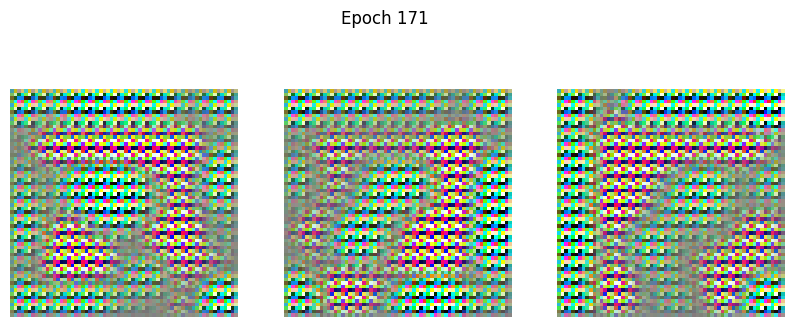

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - d_loss: 0.0254 - g_loss: 4.9468
Epoch 172/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: -0.0020 - g_loss: 6.1948

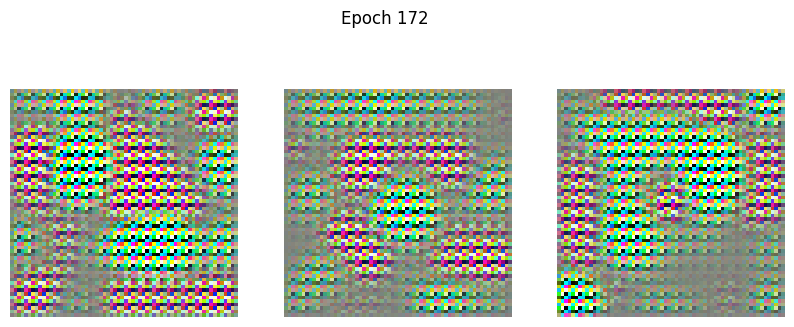

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step - d_loss: 7.9923e-04 - g_loss: 6.1171
Epoch 173/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0615 - g_loss: 6.8740

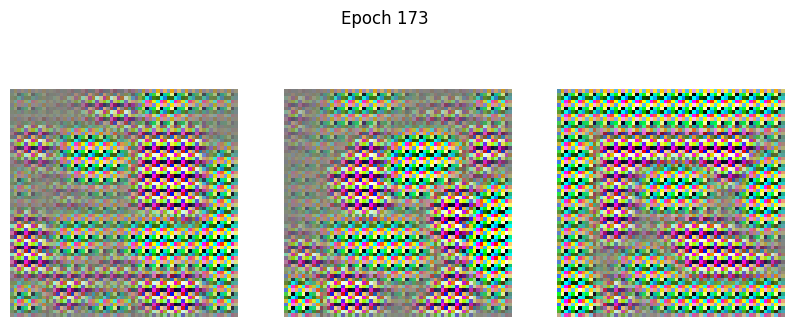

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step - d_loss: 0.0601 - g_loss: 6.7623
Epoch 174/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0955 - g_loss: 6.4568

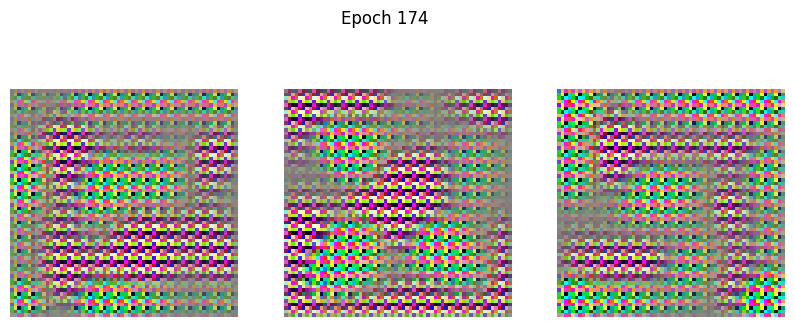

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 287ms/step - d_loss: 0.1026 - g_loss: 6.6083
Epoch 175/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.2237 - g_loss: 6.3203 

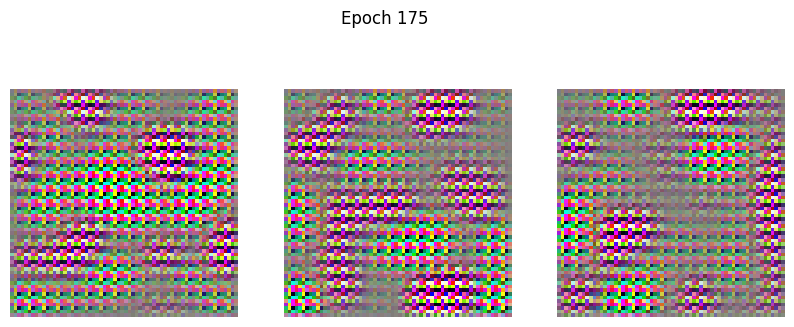

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.2388 - g_loss: 7.1387
Epoch 176/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3581 - g_loss: 6.3992 

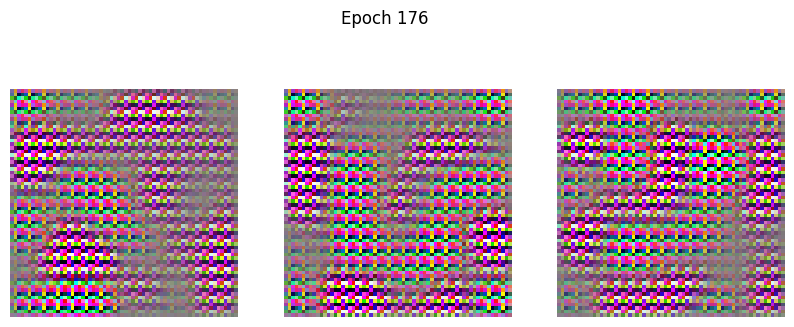

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step - d_loss: 0.3181 - g_loss: 6.0366
Epoch 177/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.4313 - g_loss: 17.9936

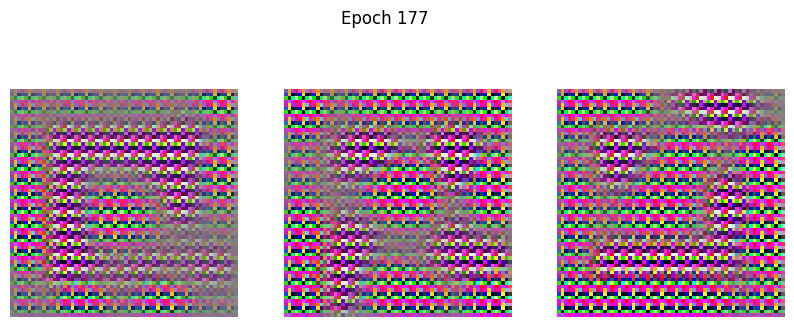

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.4062 - g_loss: 18.1998
Epoch 178/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.2296 - g_loss: 9.5565

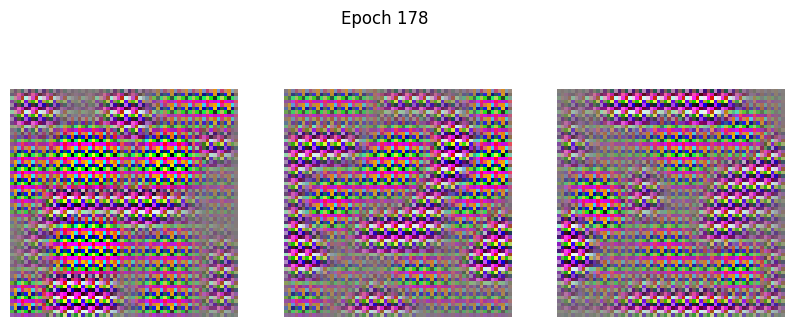

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.2103 - g_loss: 8.8990
Epoch 179/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.8263 - g_loss: 15.0641 

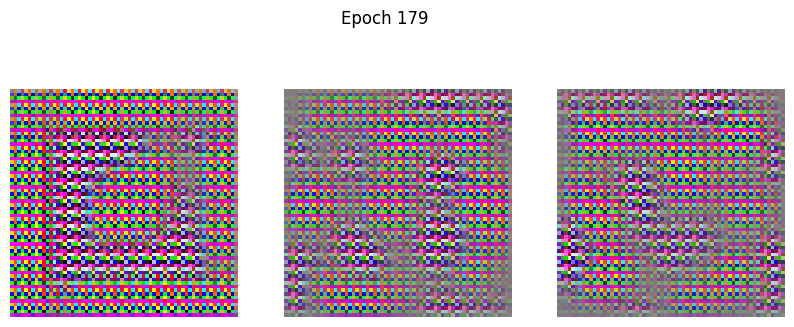

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.7877 - g_loss: 14.7451
Epoch 180/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0868 - g_loss: 5.7154

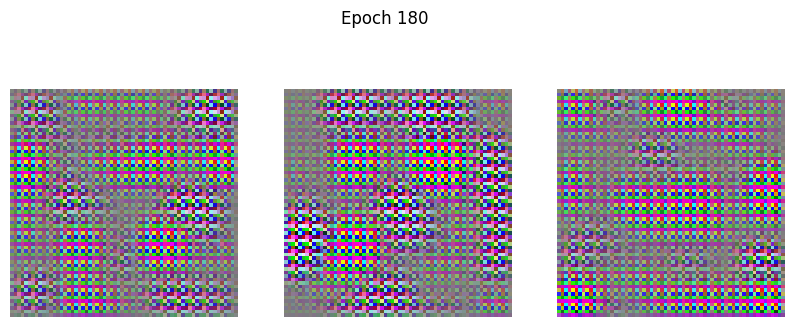

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0832 - g_loss: 5.5780
Epoch 181/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1268 - g_loss: 9.1698

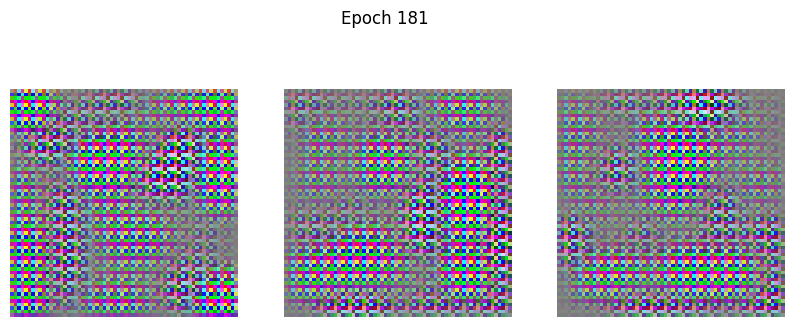

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1199 - g_loss: 9.1307
Epoch 182/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1243 - g_loss: 6.1437 

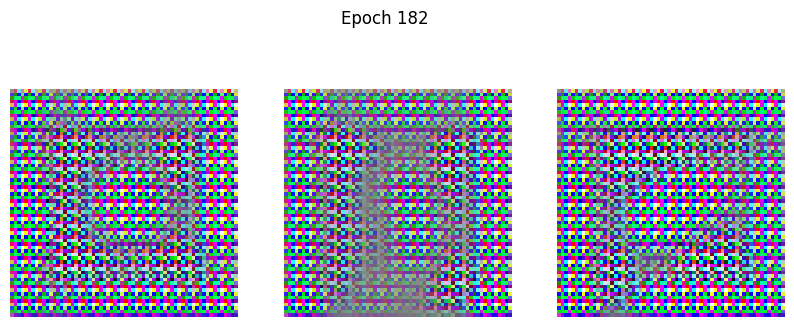

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1473 - g_loss: 6.7206
Epoch 183/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1934 - g_loss: 7.4399

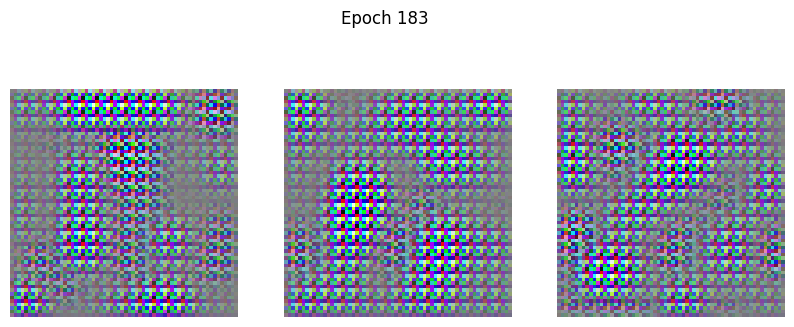

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.1834 - g_loss: 7.0157
Epoch 184/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.3661 - g_loss: 11.9154 

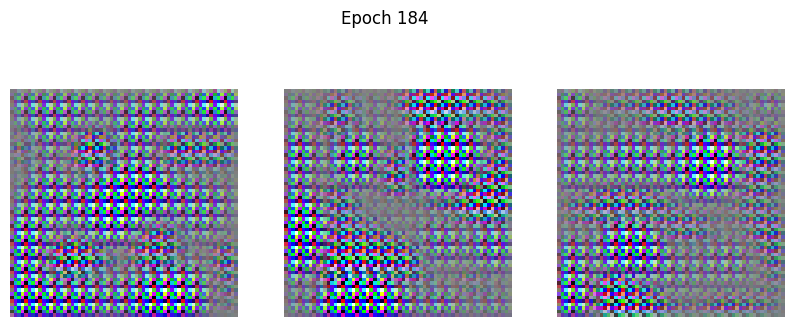

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.3471 - g_loss: 11.8912
Epoch 185/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1131 - g_loss: 5.6238

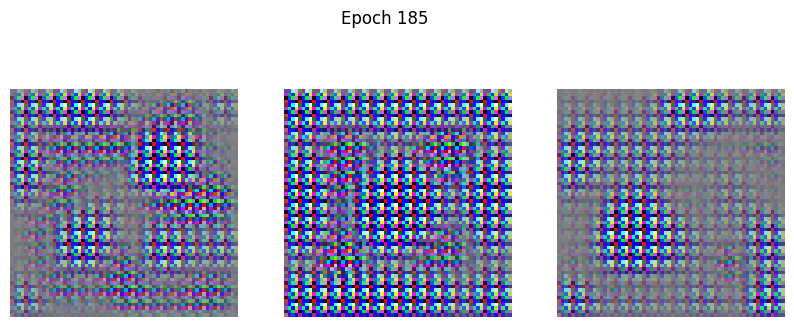

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1082 - g_loss: 5.3377
Epoch 186/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.5239 - g_loss: 9.1951

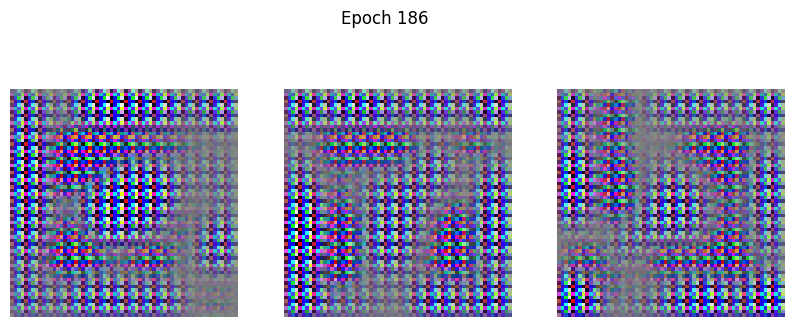

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.5188 - g_loss: 8.8316
Epoch 187/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1901 - g_loss: 5.1898 

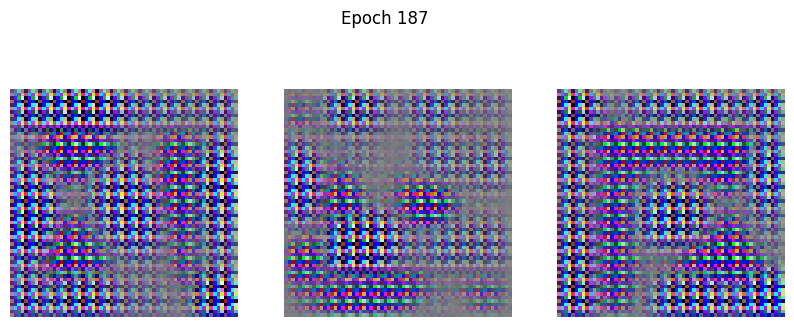

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.2197 - g_loss: 5.7578
Epoch 188/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.2084 - g_loss: 7.1705 

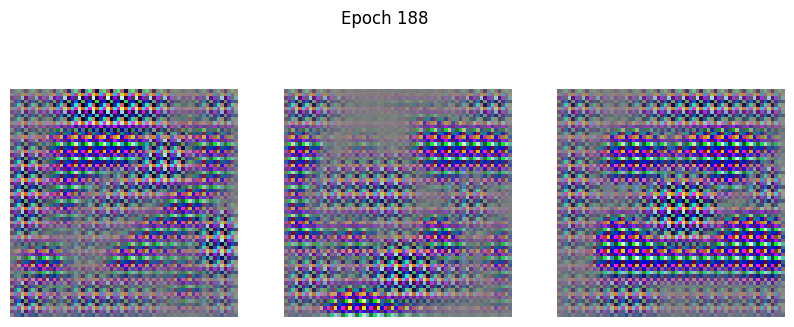

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step - d_loss: 0.1958 - g_loss: 6.8182
Epoch 189/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1183 - g_loss: 4.6802

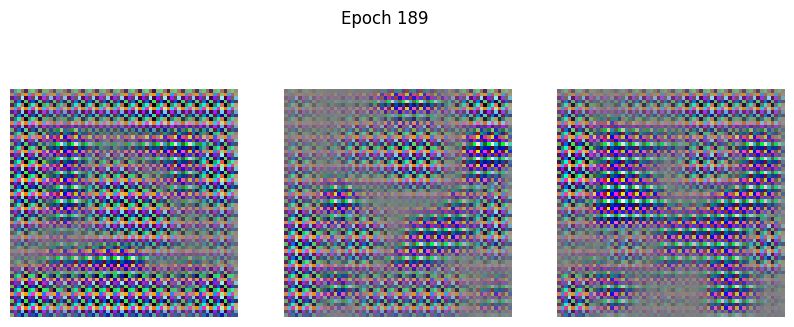

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step - d_loss: 0.1178 - g_loss: 4.7763
Epoch 190/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1057 - g_loss: 5.0233 

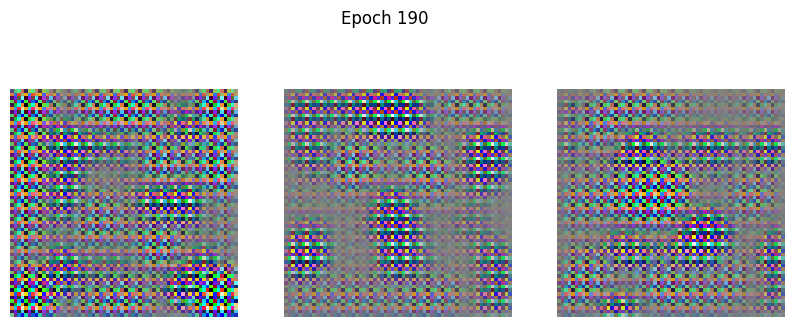

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step - d_loss: 0.1073 - g_loss: 5.0842
Epoch 191/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1259 - g_loss: 5.4413 

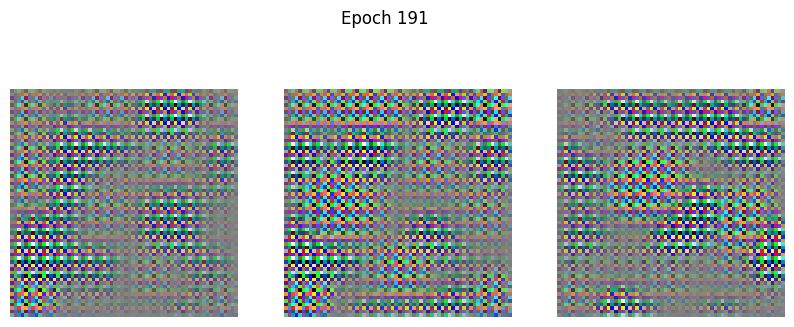

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1229 - g_loss: 5.4329
Epoch 192/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1086 - g_loss: 5.4078

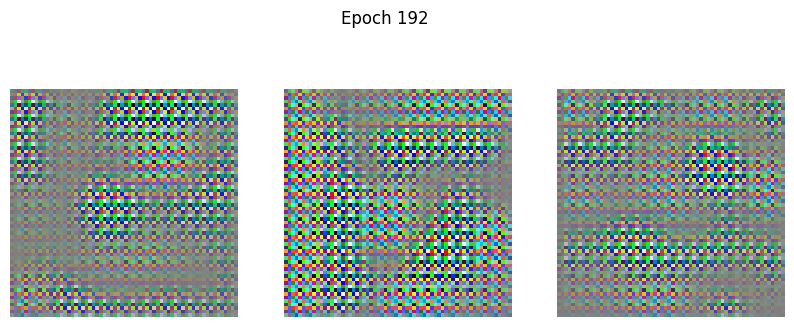

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1131 - g_loss: 5.4786
Epoch 193/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1351 - g_loss: 6.0771

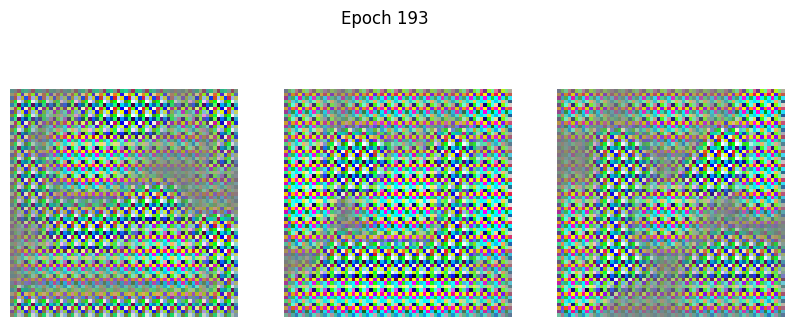

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step - d_loss: 0.1401 - g_loss: 6.1172
Epoch 194/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1965 - g_loss: 7.2401 

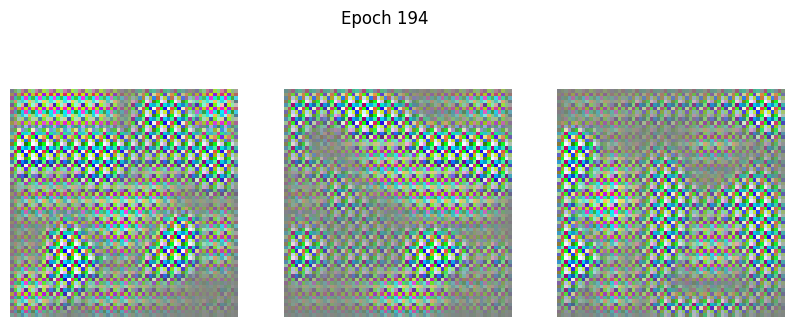

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - d_loss: 0.1942 - g_loss: 7.2208
Epoch 195/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - d_loss: 0.2699 - g_loss: 6.9238 

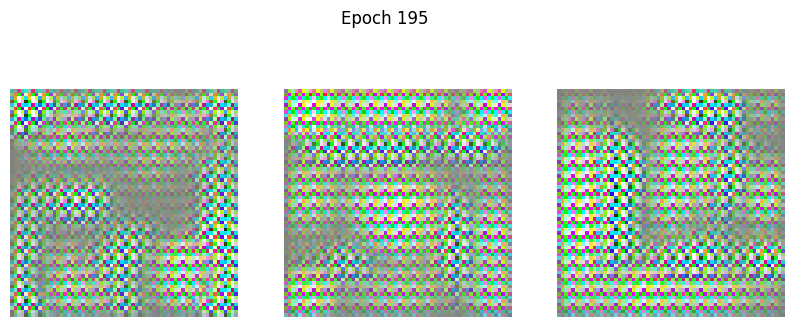

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step - d_loss: 0.2906 - g_loss: 7.6527
Epoch 196/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.4489 - g_loss: 5.9902

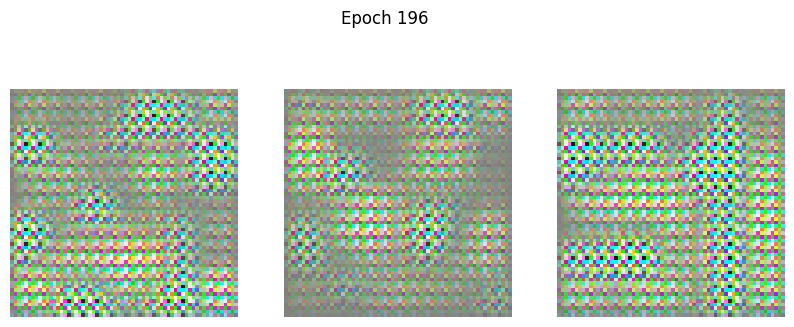

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.4072 - g_loss: 5.7408
Epoch 197/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1384 - g_loss: 8.9223 

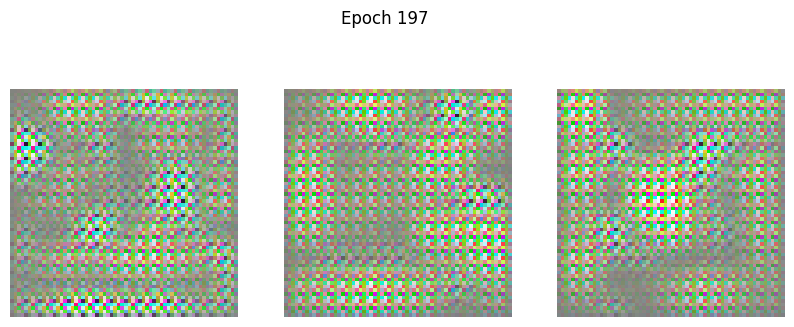

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.1270 - g_loss: 8.9378
Epoch 198/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0511 - g_loss: 5.4664 

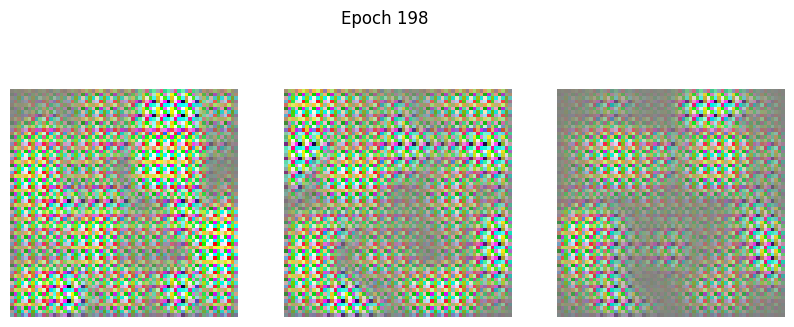

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 228ms/step - d_loss: 0.0511 - g_loss: 5.4156
Epoch 199/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0730 - g_loss: 6.5460 

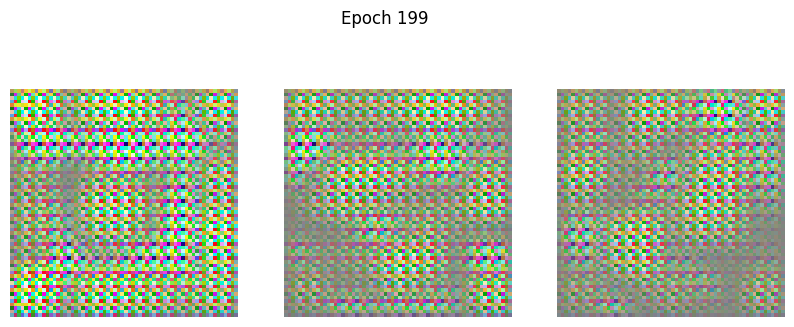

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 233ms/step - d_loss: 0.0706 - g_loss: 6.4608
Epoch 200/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0474 - g_loss: 4.4653

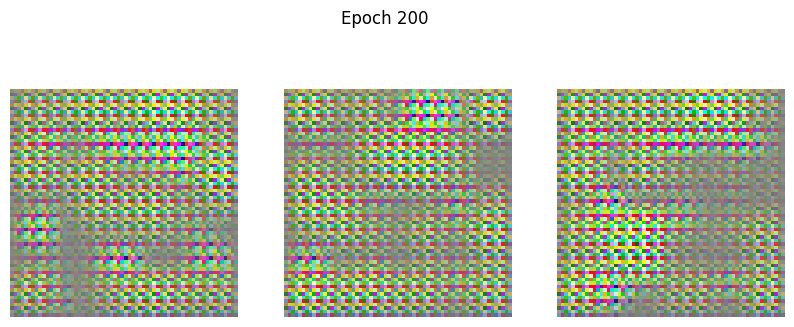

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 293ms/step - d_loss: 0.0509 - g_loss: 4.5797
Epoch 201/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0495 - g_loss: 4.5924 

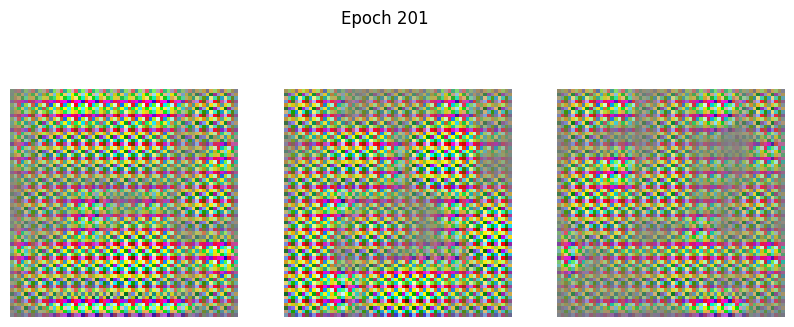

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.0487 - g_loss: 4.5563
Epoch 202/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0715 - g_loss: 5.7077 

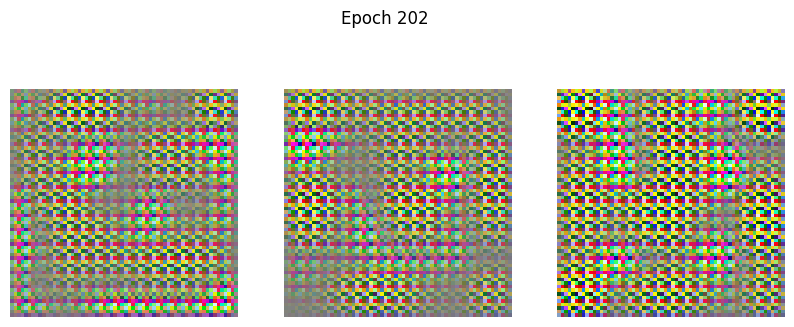

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0682 - g_loss: 5.6288
Epoch 203/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1184 - g_loss: 5.9683

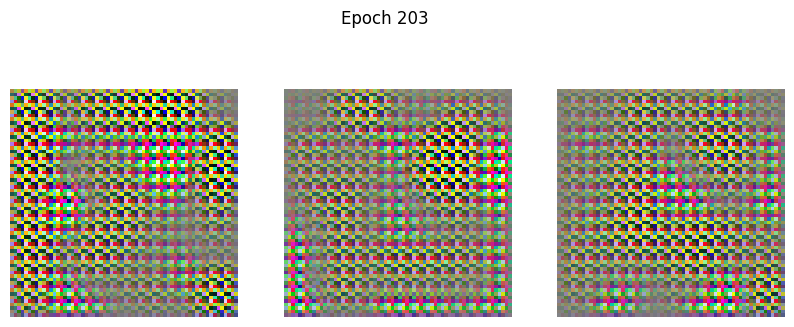

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 266ms/step - d_loss: 0.1211 - g_loss: 6.0384
Epoch 204/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1286 - g_loss: 6.2291

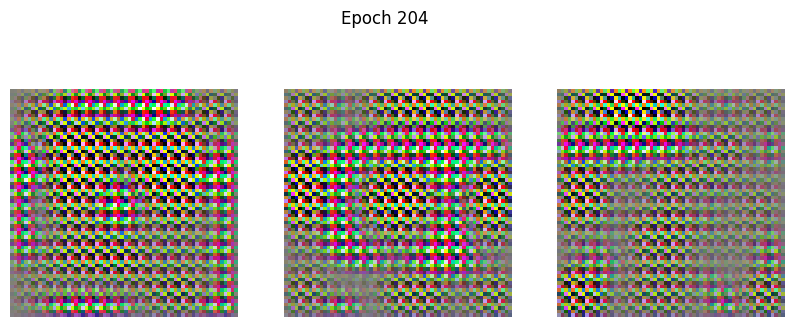

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1331 - g_loss: 6.1904
Epoch 205/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0874 - g_loss: 6.3446

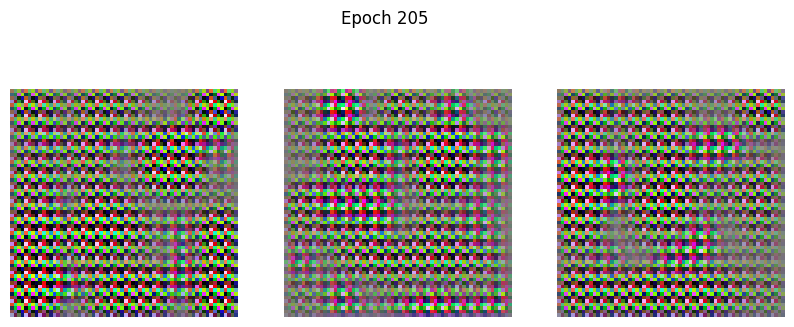

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - d_loss: 0.0878 - g_loss: 6.3051
Epoch 206/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0802 - g_loss: 7.2287 

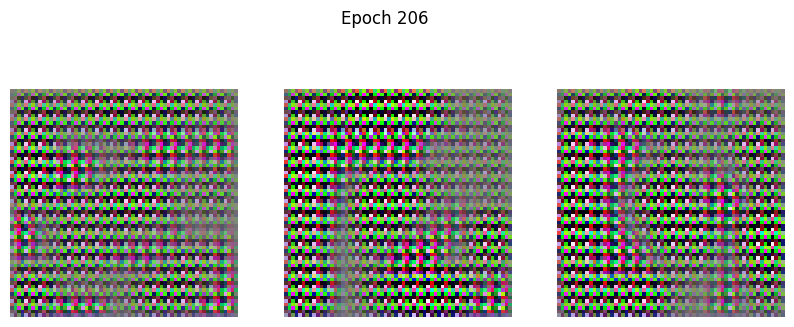

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 174ms/step - d_loss: 0.0765 - g_loss: 7.1237
Epoch 207/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0472 - g_loss: 6.0475

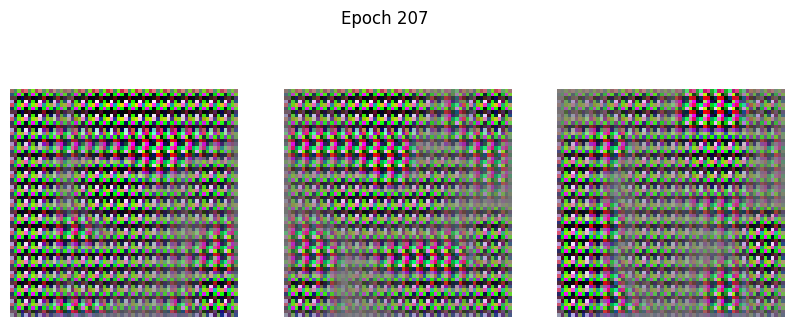

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0498 - g_loss: 6.2332
Epoch 208/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0284 - g_loss: 6.4326

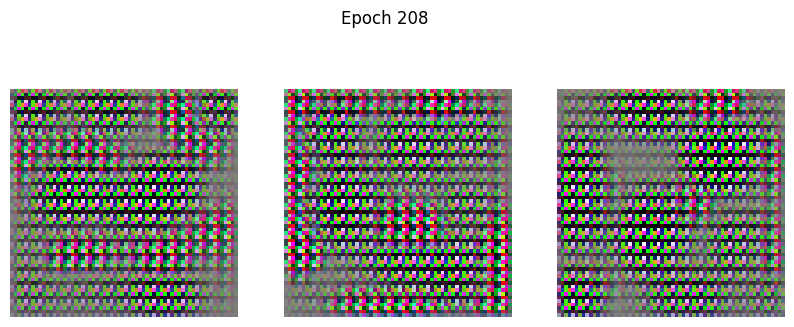

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.0291 - g_loss: 6.2826
Epoch 209/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0459 - g_loss: 7.0521

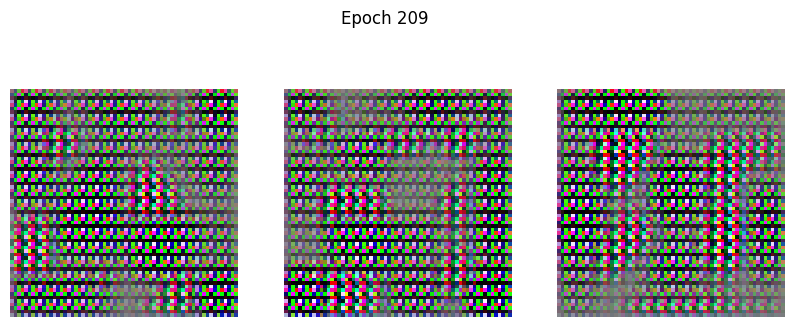

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step - d_loss: 0.0456 - g_loss: 6.9851
Epoch 210/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.0302 - g_loss: 4.5919 

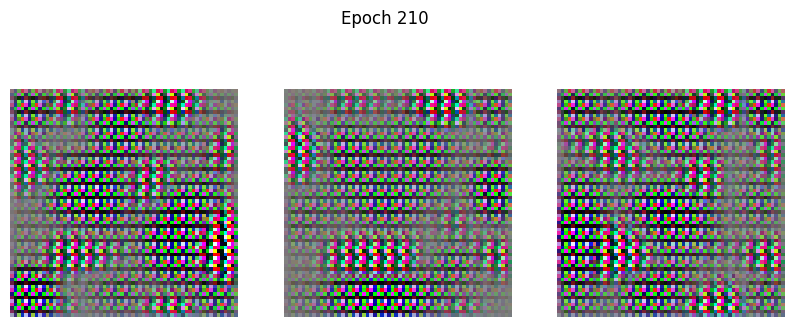

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 422ms/step - d_loss: 0.0318 - g_loss: 4.6835
Epoch 211/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - d_loss: 0.0274 - g_loss: 5.6501 

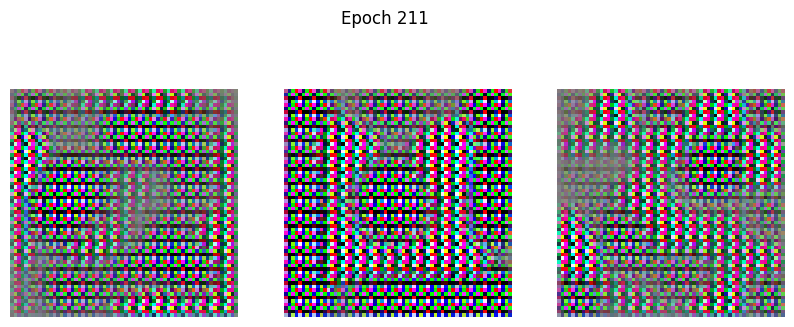

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 443ms/step - d_loss: 0.0271 - g_loss: 5.5717
Epoch 212/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - d_loss: 0.0421 - g_loss: 5.9985 

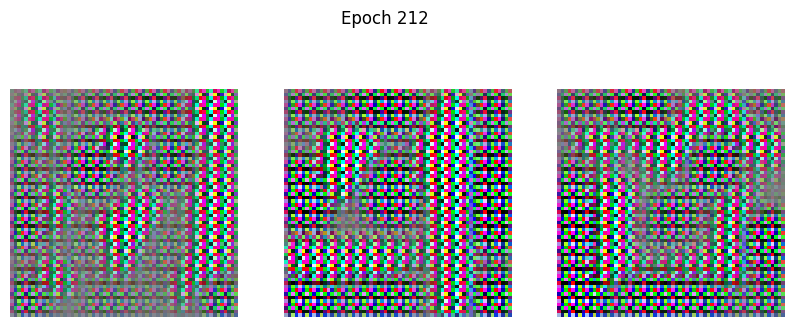

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - d_loss: 0.0395 - g_loss: 5.9732  
Epoch 213/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0404 - g_loss: 5.4849 

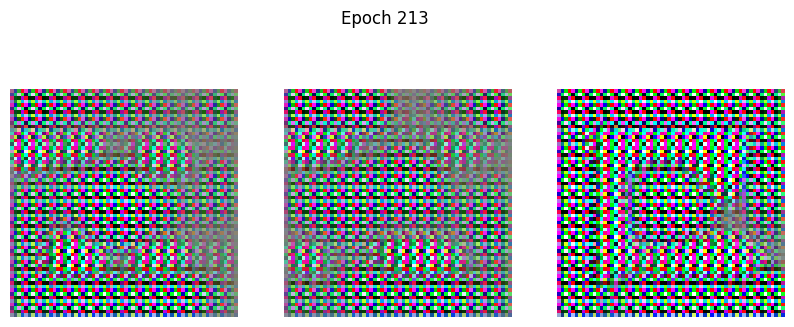

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.0404 - g_loss: 5.5427
Epoch 214/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0666 - g_loss: 5.5221 

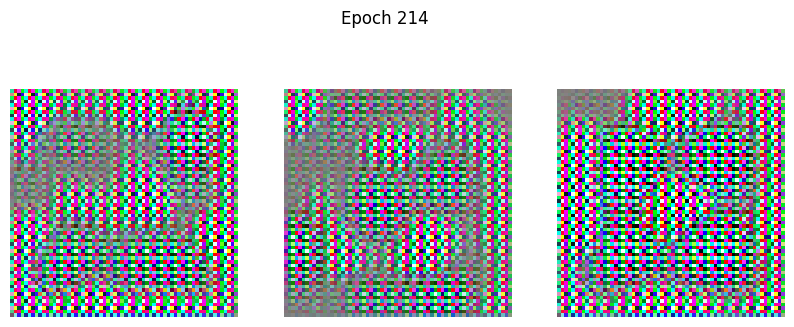

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.0658 - g_loss: 5.5190
Epoch 215/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0734 - g_loss: 5.2515 

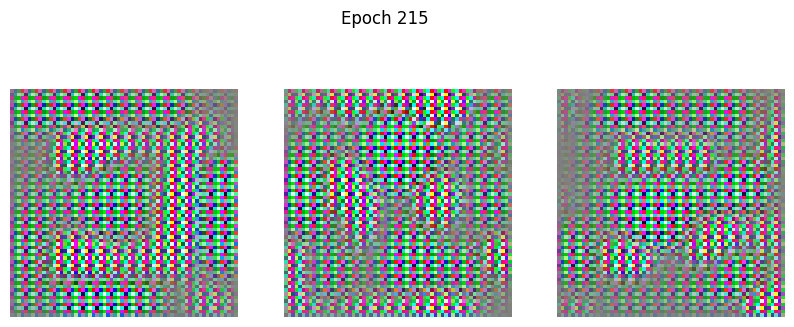

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - d_loss: 0.0738 - g_loss: 5.3586
Epoch 216/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0802 - g_loss: 5.7531

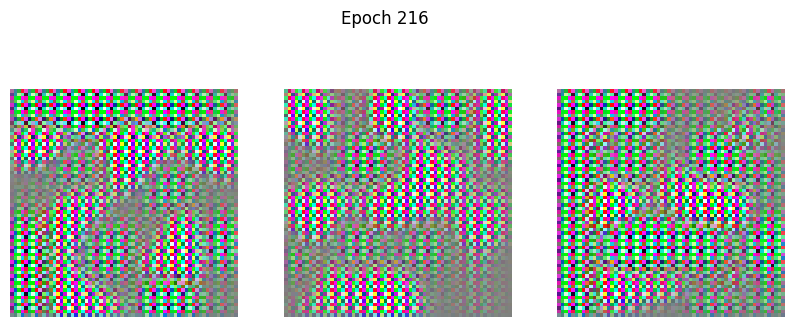

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0821 - g_loss: 5.6559
Epoch 217/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1060 - g_loss: 7.3127 

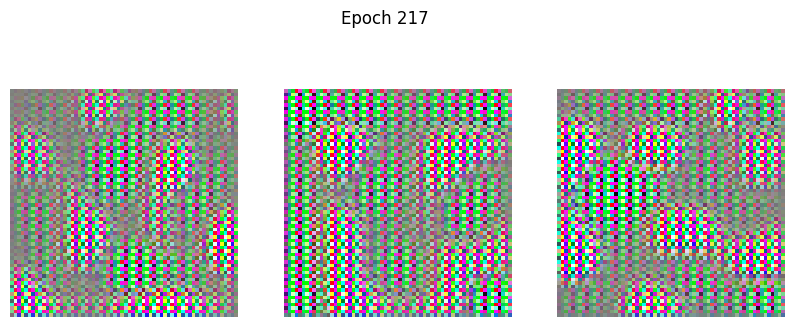

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.1012 - g_loss: 7.1667
Epoch 218/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1027 - g_loss: 6.0186 

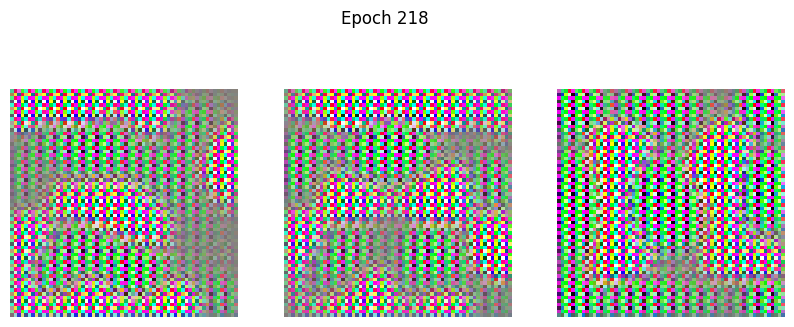

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.1061 - g_loss: 6.4114
Epoch 219/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.3084 - g_loss: 6.9976 

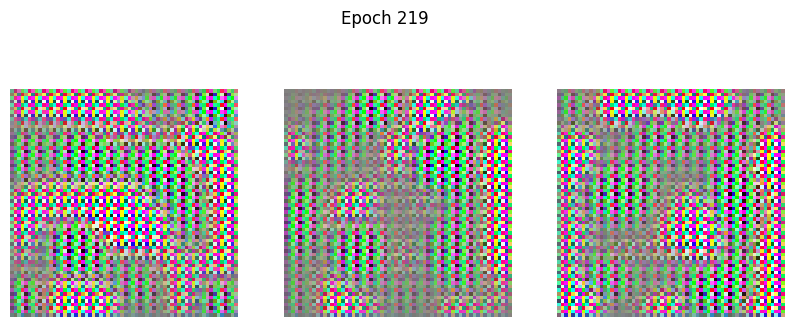

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.3308 - g_loss: 8.1471
Epoch 220/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.6684 - g_loss: 6.5788 

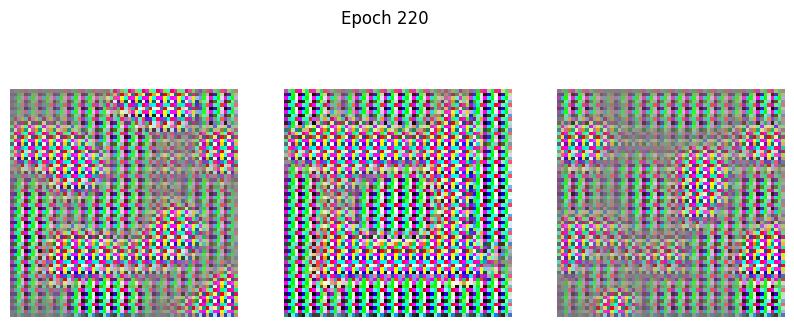

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.5958 - g_loss: 6.2565
Epoch 221/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.2160 - g_loss: 13.7438

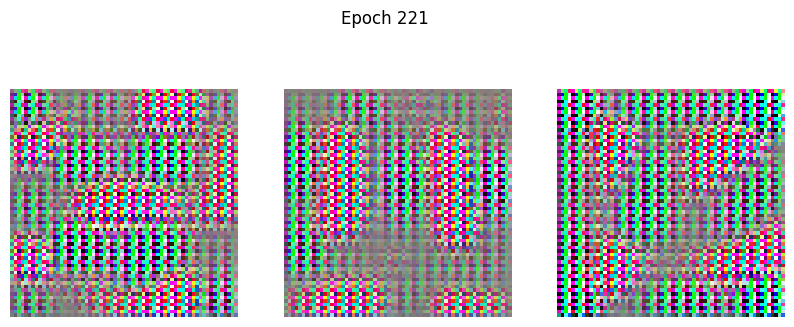

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1970 - g_loss: 13.8407
Epoch 222/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0298 - g_loss: 8.1037

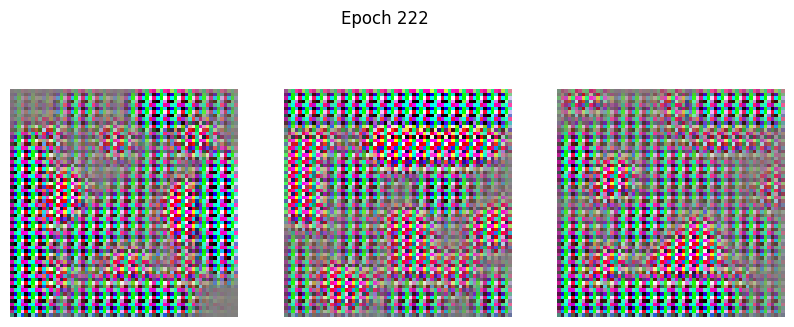

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0270 - g_loss: 7.6922
Epoch 223/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.2303 - g_loss: 11.0420 

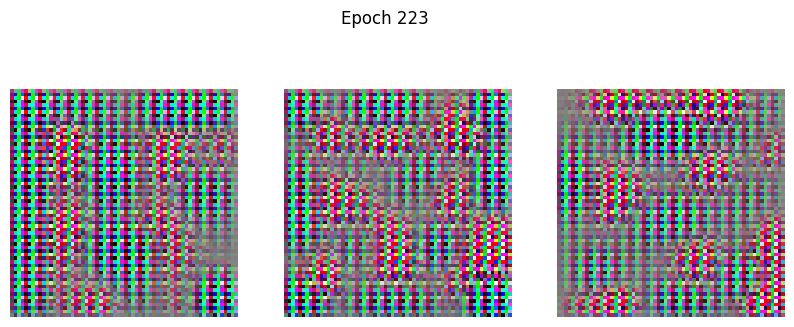

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.2186 - g_loss: 11.0261
Epoch 224/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1293 - g_loss: 5.3967

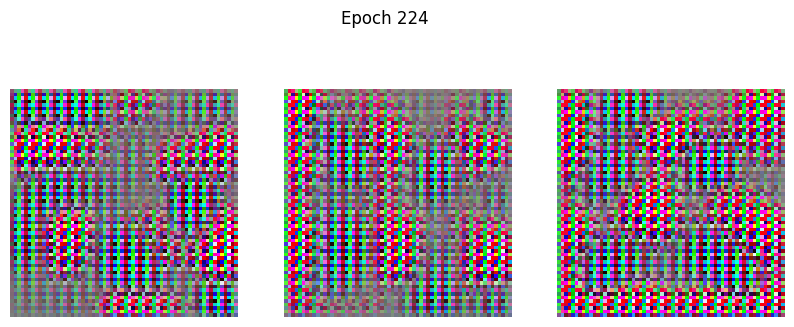

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1222 - g_loss: 5.1183
Epoch 225/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3946 - g_loss: 13.0234 

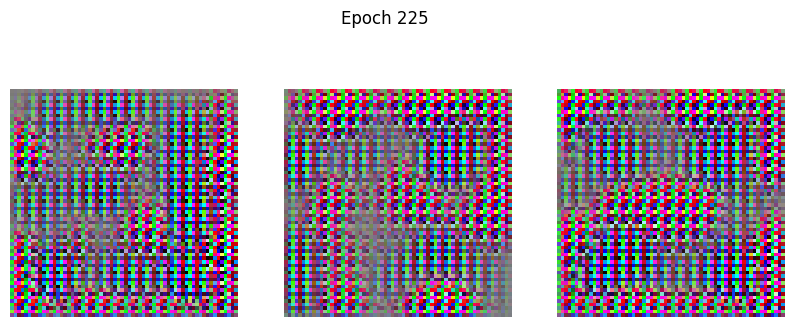

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.3911 - g_loss: 12.7687
Epoch 226/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1195 - g_loss: 5.8308

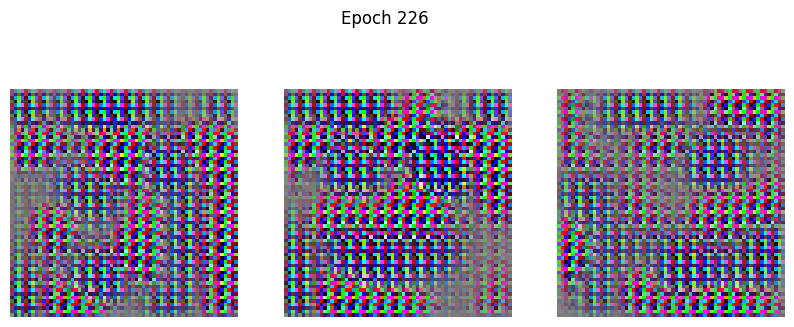

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - d_loss: 0.1224 - g_loss: 5.9482
Epoch 227/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0513 - g_loss: 6.8576 

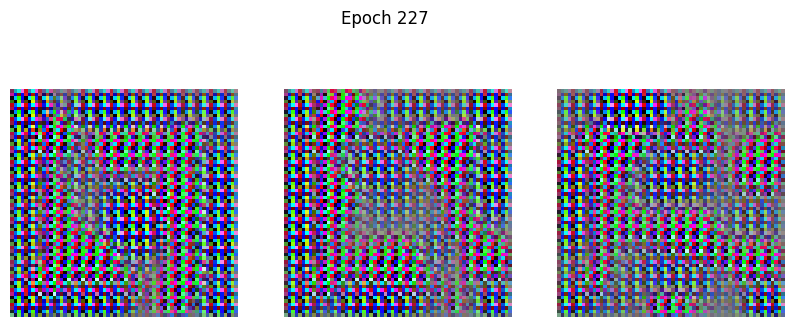

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0505 - g_loss: 6.7234
Epoch 228/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1088 - g_loss: 7.6005

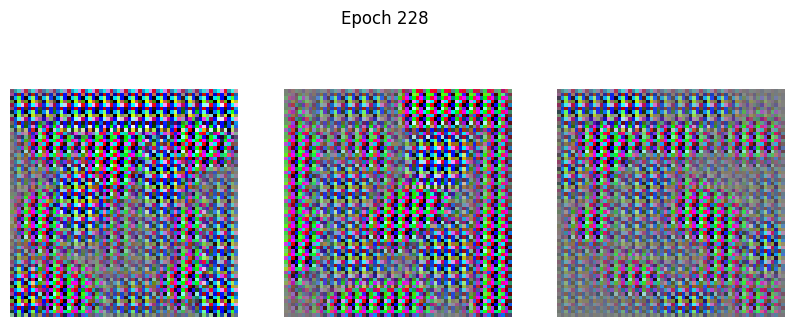

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1094 - g_loss: 7.4070
Epoch 229/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1266 - g_loss: 7.1967 

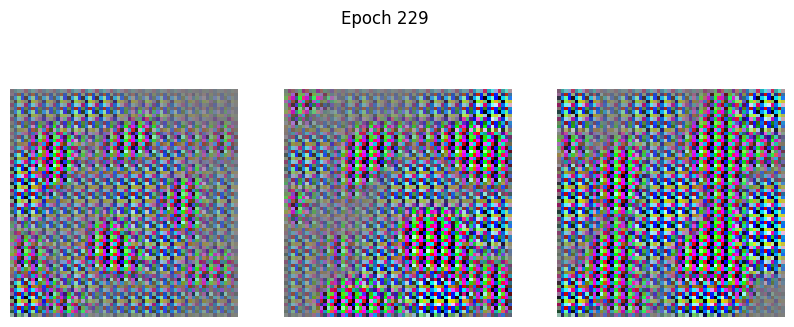

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1243 - g_loss: 7.2862
Epoch 230/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1768 - g_loss: 7.6241 

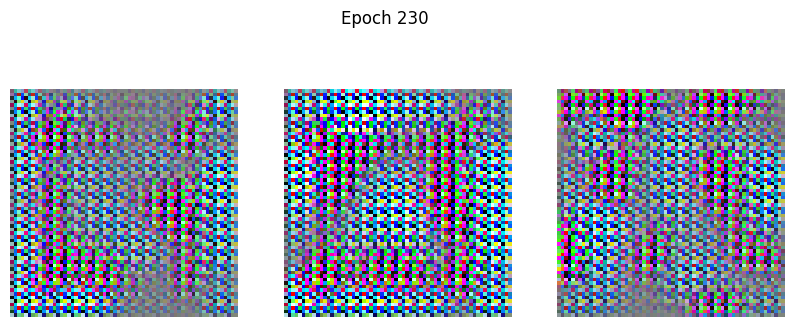

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1911 - g_loss: 8.6123
Epoch 231/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.4149 - g_loss: 8.2428

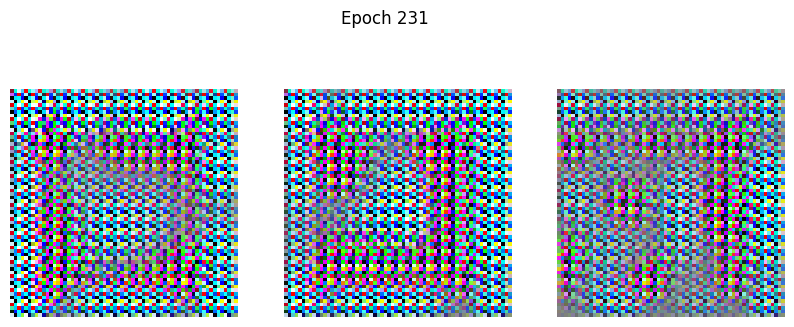

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 265ms/step - d_loss: 0.3736 - g_loss: 7.7335
Epoch 232/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.2964 - g_loss: 14.2212 

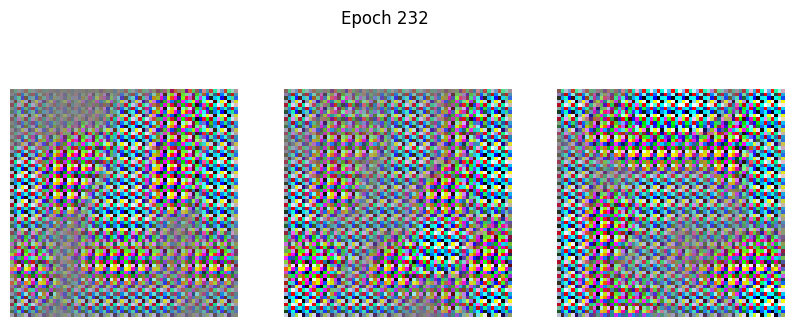

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 222ms/step - d_loss: 0.2775 - g_loss: 14.2450
Epoch 233/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1507 - g_loss: 6.8383 

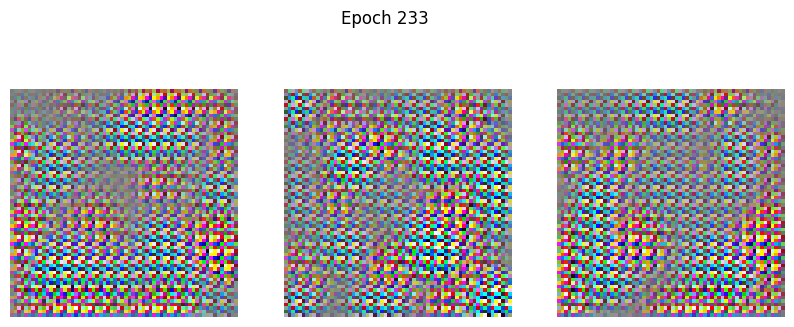

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - d_loss: 0.1395 - g_loss: 6.4186
Epoch 234/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.4054 - g_loss: 10.0000 

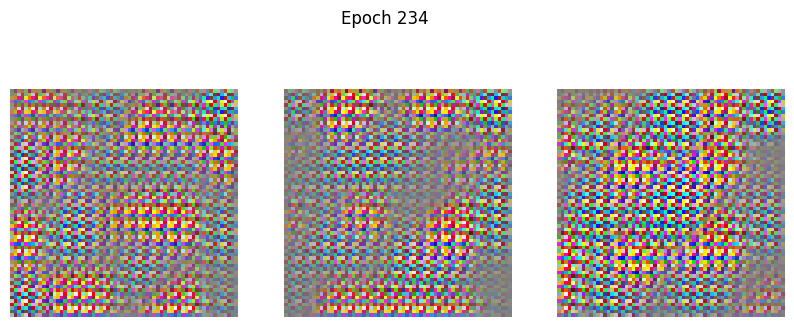

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step - d_loss: 0.3849 - g_loss: 9.8900
Epoch 235/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1118 - g_loss: 4.6086

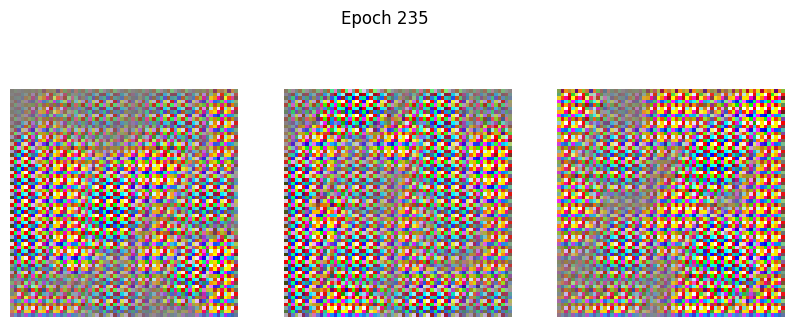

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step - d_loss: 0.1062 - g_loss: 4.4293
Epoch 236/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1331 - g_loss: 7.4566 

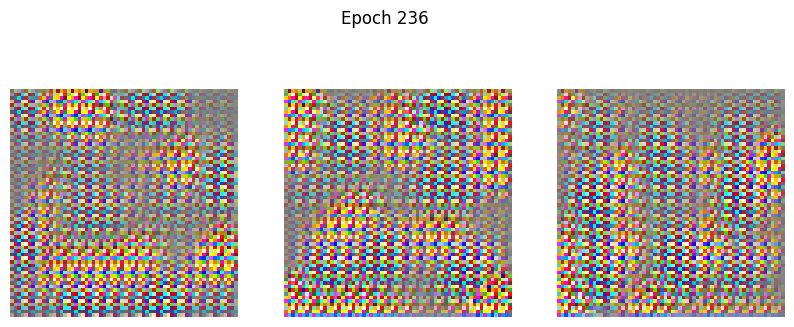

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1228 - g_loss: 7.4903
Epoch 237/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0497 - g_loss: 5.0604 

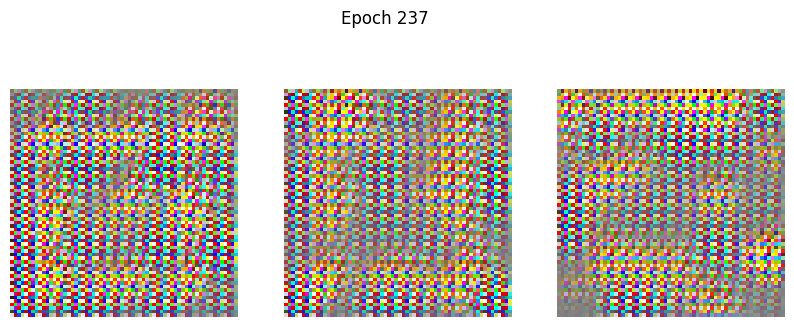

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - d_loss: 0.0450 - g_loss: 4.8790
Epoch 238/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0906 - g_loss: 6.2679 

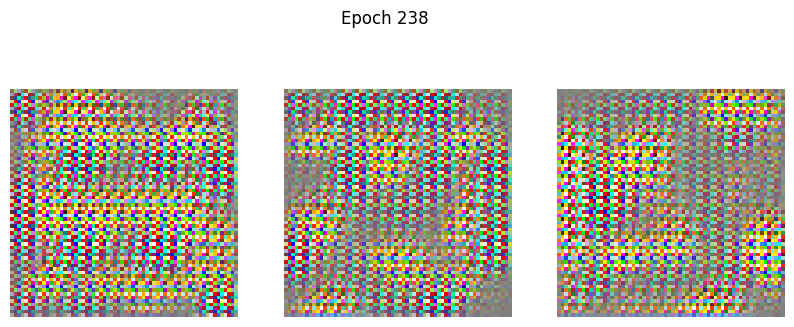

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0842 - g_loss: 6.2335
Epoch 239/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0501 - g_loss: 4.7513

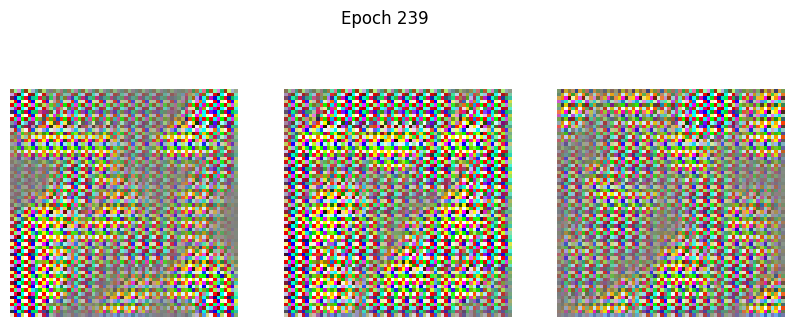

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 250ms/step - d_loss: 0.0563 - g_loss: 4.8749
Epoch 240/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0771 - g_loss: 5.7722

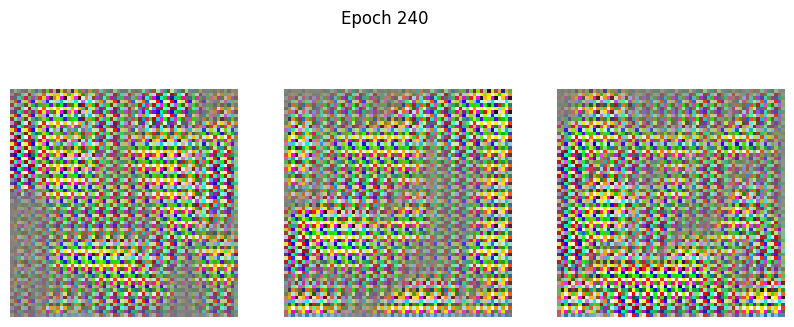

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - d_loss: 0.0827 - g_loss: 5.7643
Epoch 241/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1520 - g_loss: 7.0115

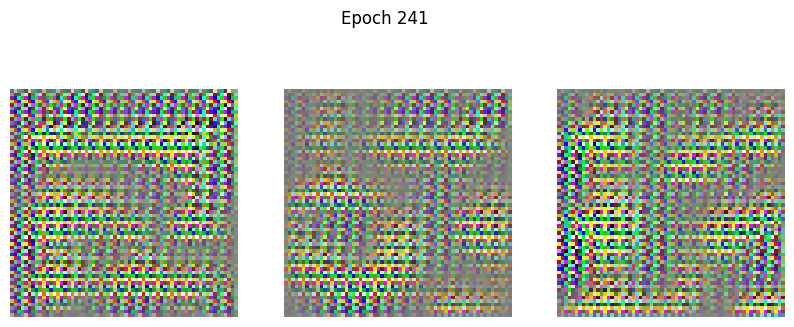

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1575 - g_loss: 6.6341
Epoch 242/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3662 - g_loss: 13.1841 

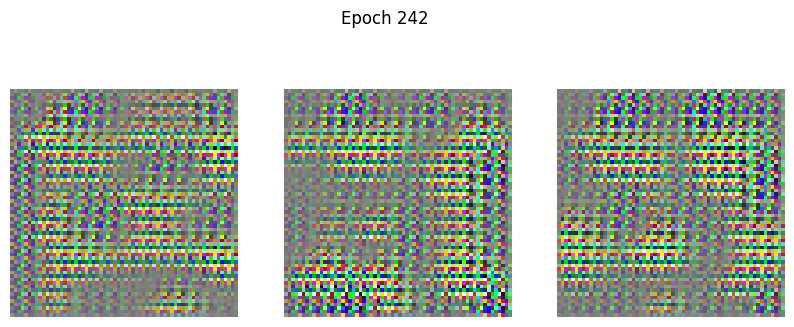

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.3572 - g_loss: 12.9340
Epoch 243/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - d_loss: 0.1527 - g_loss: 5.7971 

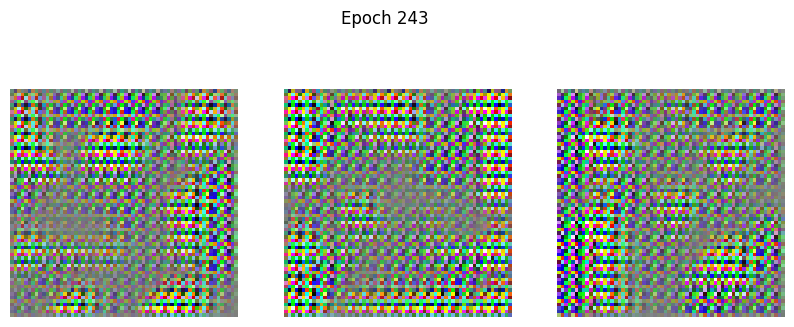

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.1638 - g_loss: 6.1924
Epoch 244/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0710 - g_loss: 7.3925 

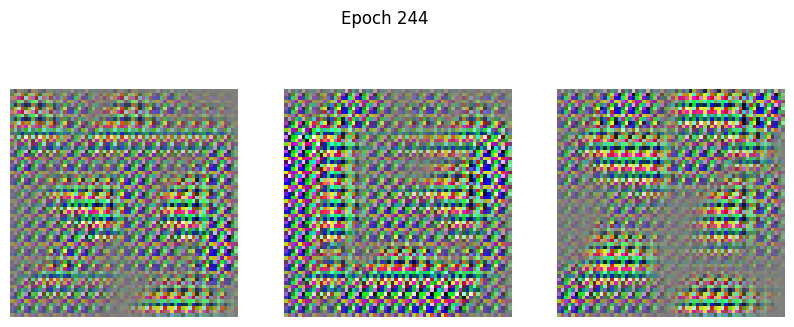

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0692 - g_loss: 7.1939
Epoch 245/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2057 - g_loss: 7.5721 

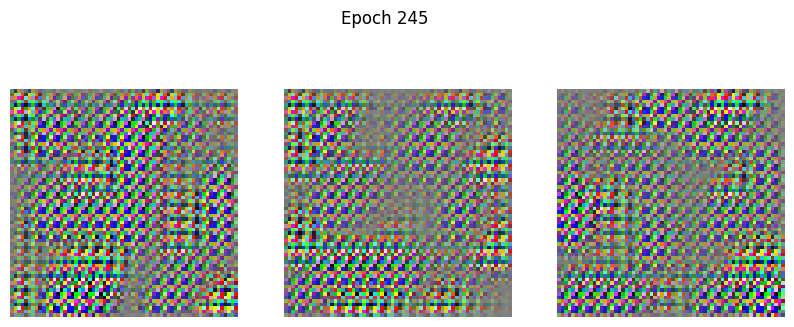

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1952 - g_loss: 7.4149
Epoch 246/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.2146 - g_loss: 6.5106 

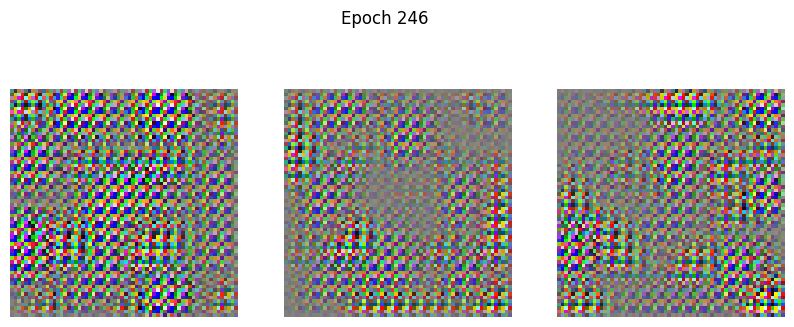

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.2100 - g_loss: 6.6213
Epoch 247/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.2492 - g_loss: 6.0611 

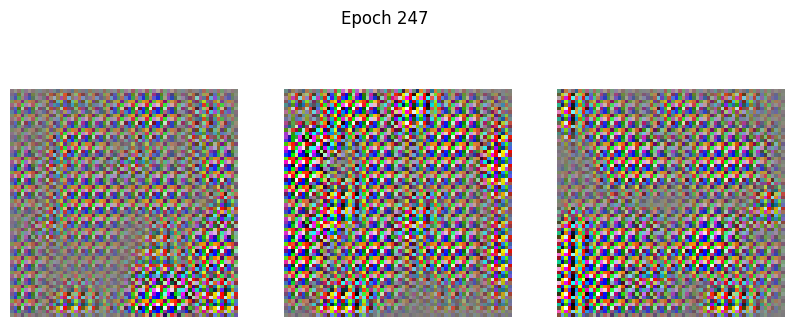

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.2564 - g_loss: 6.4946
Epoch 248/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3364 - g_loss: 5.1261 

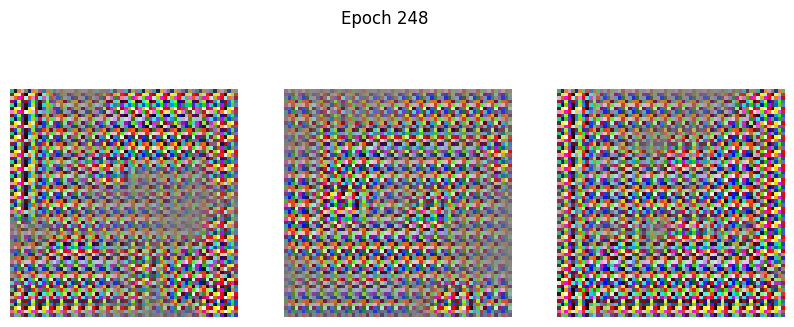

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.3205 - g_loss: 5.2688
Epoch 249/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0894 - g_loss: 6.3537

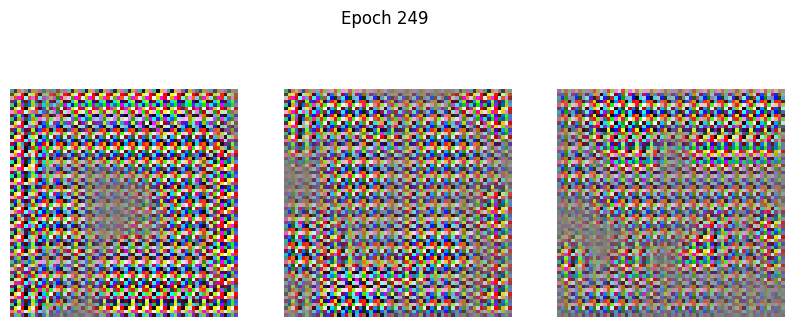

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.0930 - g_loss: 6.2639
Epoch 250/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1111 - g_loss: 5.6360 

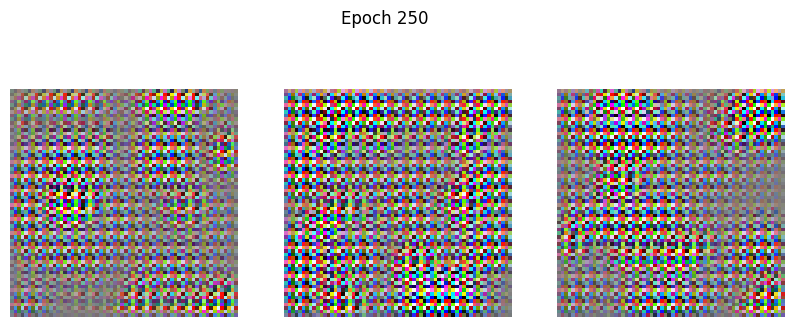

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.1089 - g_loss: 5.6917
Epoch 251/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0823 - g_loss: 5.1023

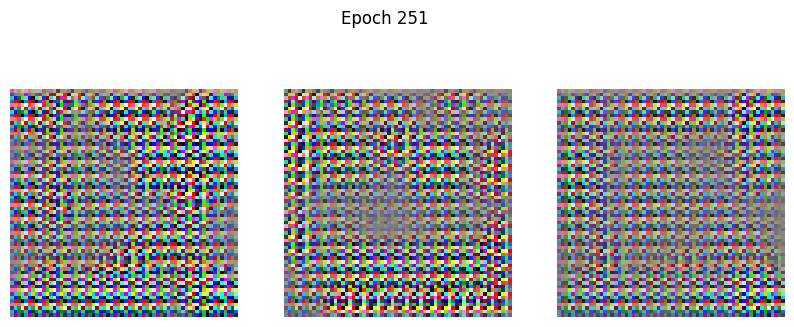

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0844 - g_loss: 5.0217
Epoch 252/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1214 - g_loss: 7.1460

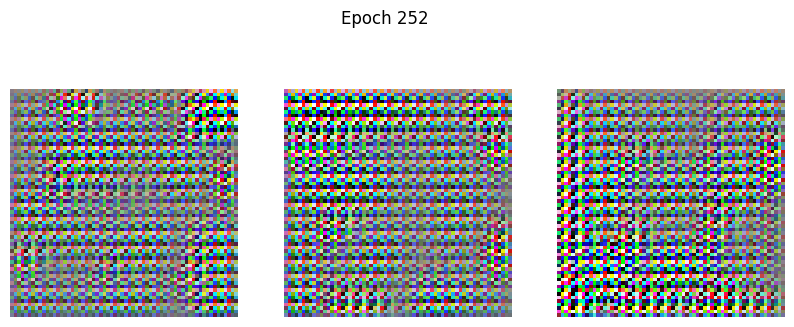

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1215 - g_loss: 6.9487
Epoch 253/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0792 - g_loss: 6.0443

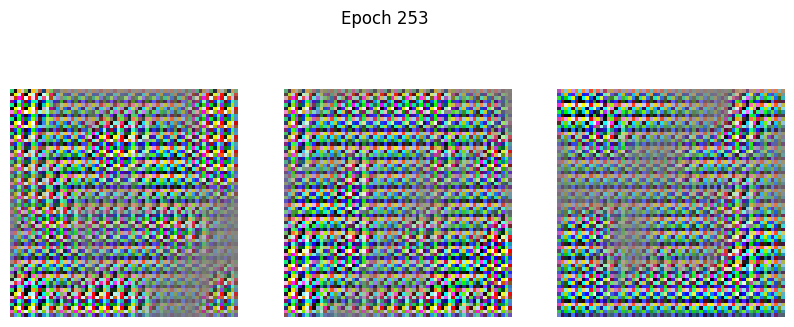

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step - d_loss: 0.0794 - g_loss: 6.0281
Epoch 254/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0922 - g_loss: 6.9049

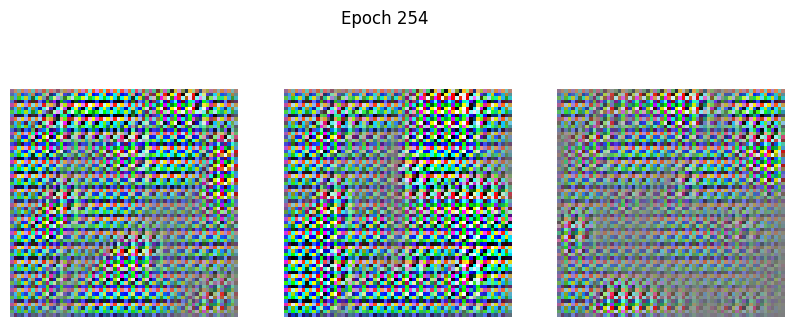

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 227ms/step - d_loss: 0.0942 - g_loss: 6.7084
Epoch 255/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1239 - g_loss: 6.9089

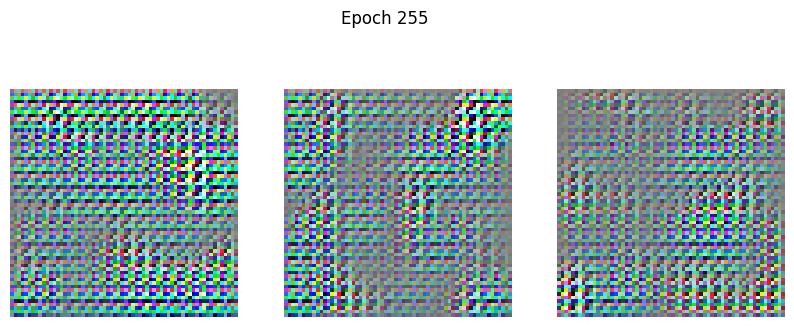

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.1240 - g_loss: 6.6823
Epoch 256/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0915 - g_loss: 5.7596

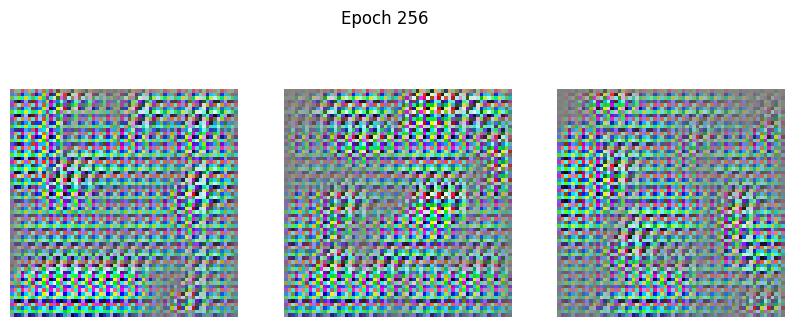

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.0914 - g_loss: 5.7399
Epoch 257/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0859 - g_loss: 5.3282 

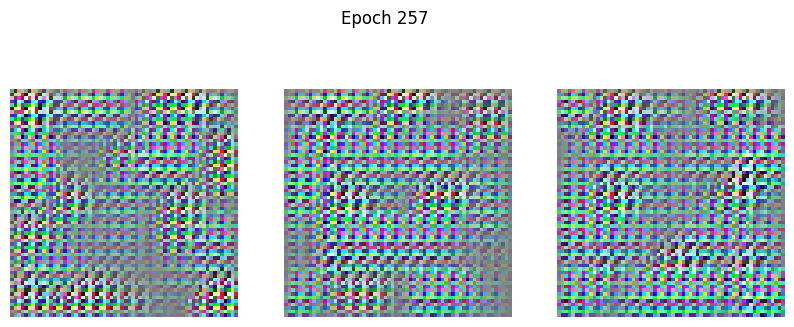

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.0855 - g_loss: 5.4352
Epoch 258/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1009 - g_loss: 5.8651 

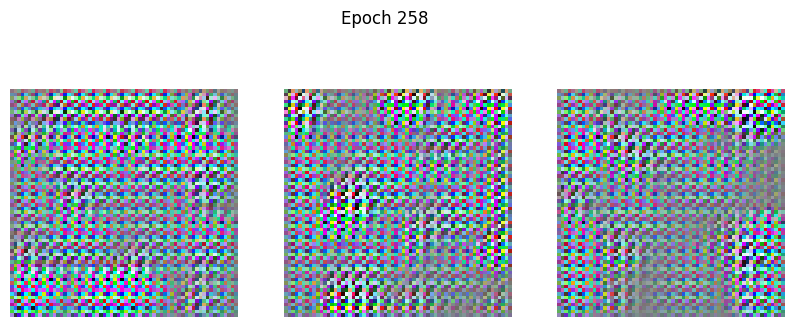

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1045 - g_loss: 6.1862
Epoch 259/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1245 - g_loss: 5.7353 

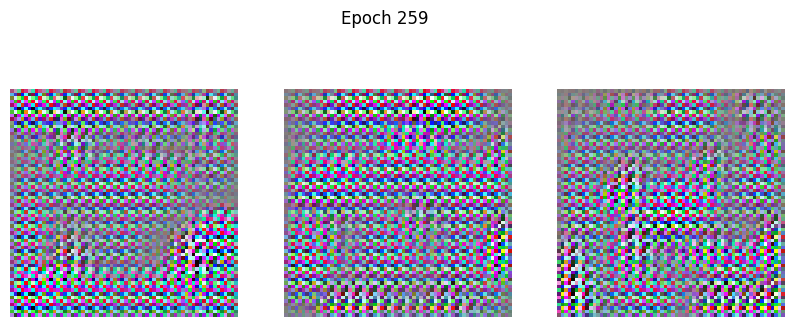

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - d_loss: 0.1225 - g_loss: 5.7781
Epoch 260/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1073 - g_loss: 6.7502

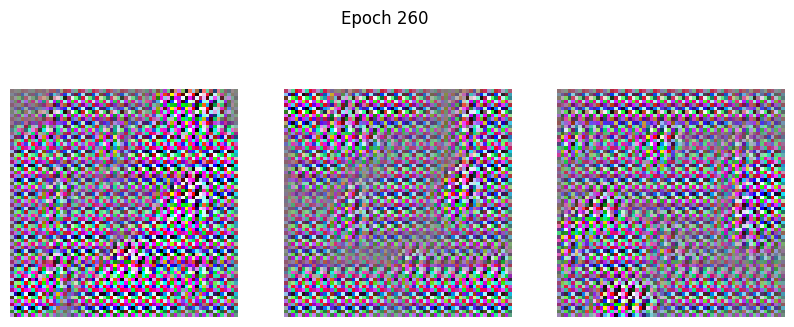

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1100 - g_loss: 6.5192
Epoch 261/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1064 - g_loss: 6.4076

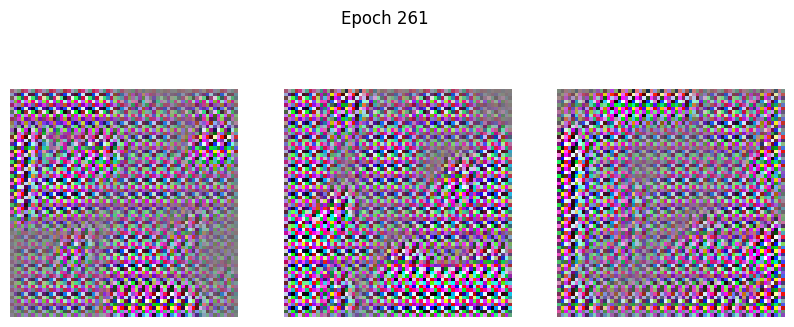

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1052 - g_loss: 6.2674
Epoch 262/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0639 - g_loss: 5.2876

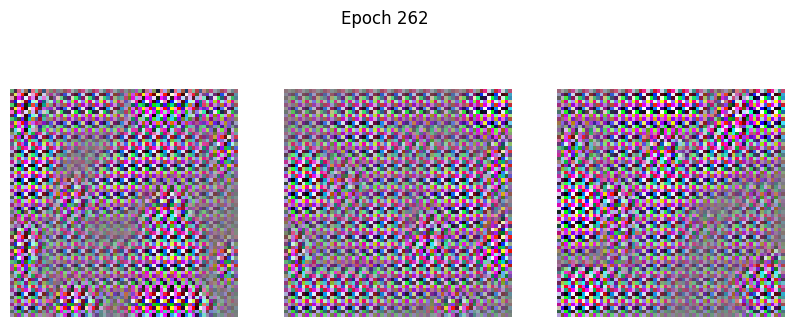

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0647 - g_loss: 5.3386
Epoch 263/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0844 - g_loss: 5.9739 

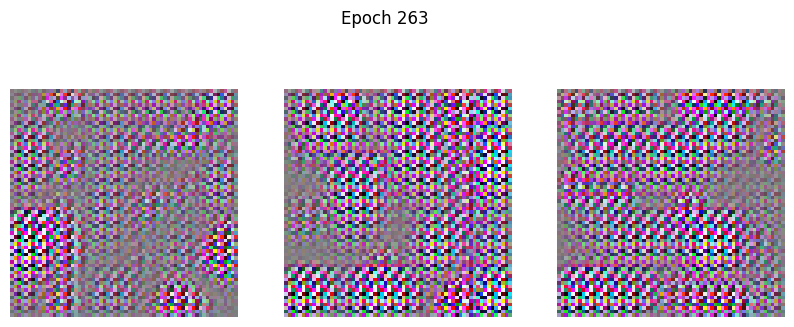

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.0833 - g_loss: 6.0229
Epoch 264/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1108 - g_loss: 5.6062 

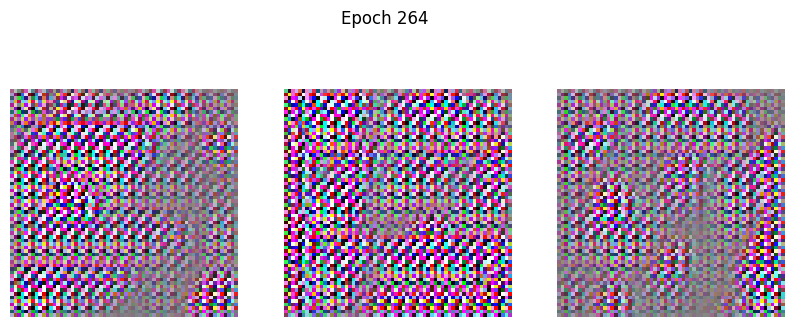

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1139 - g_loss: 5.9189
Epoch 265/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1691 - g_loss: 5.2540 

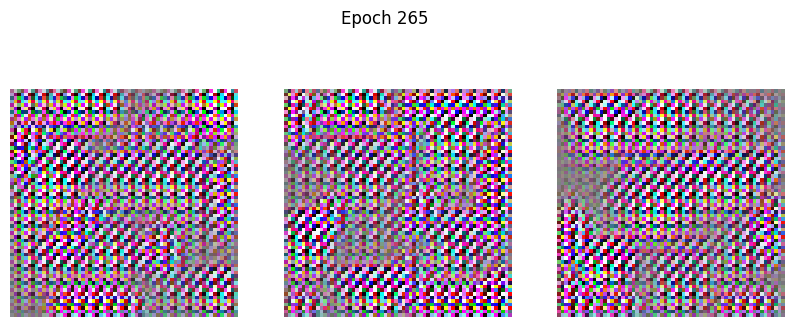

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.1685 - g_loss: 5.4938
Epoch 266/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0915 - g_loss: 5.4271

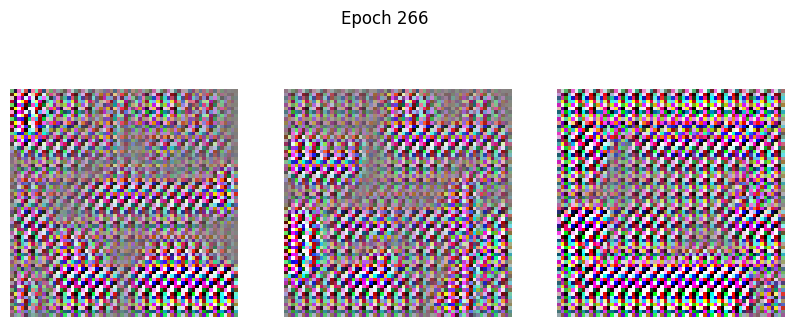

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step - d_loss: 0.0943 - g_loss: 5.3100
Epoch 267/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1642 - g_loss: 7.5385 

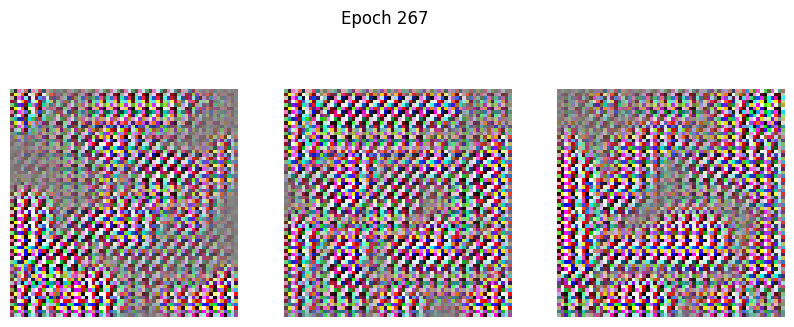

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 187ms/step - d_loss: 0.1594 - g_loss: 7.3424
Epoch 268/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1338 - g_loss: 4.8994 

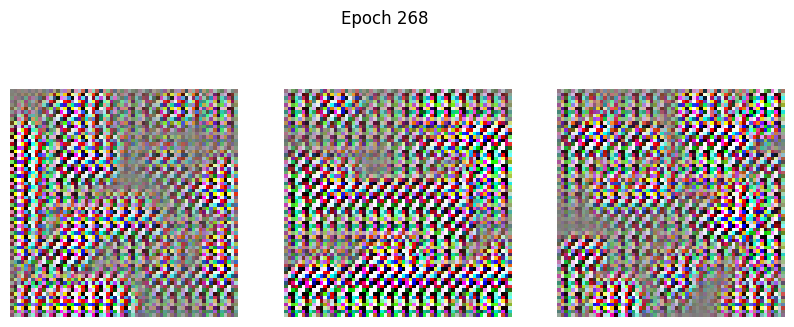

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 252ms/step - d_loss: 0.1387 - g_loss: 5.2044
Epoch 269/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1572 - g_loss: 4.6516 

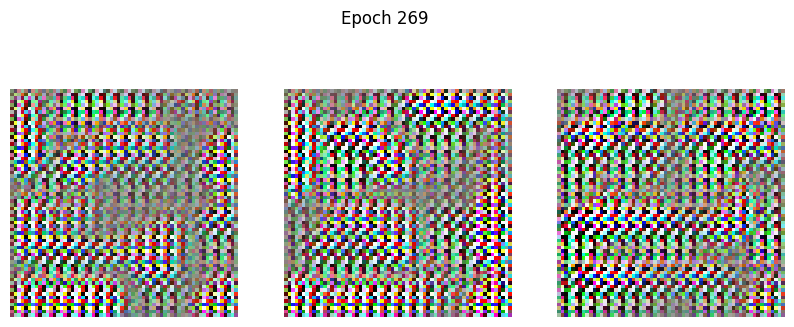

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1499 - g_loss: 4.6810
Epoch 270/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0895 - g_loss: 5.4176 

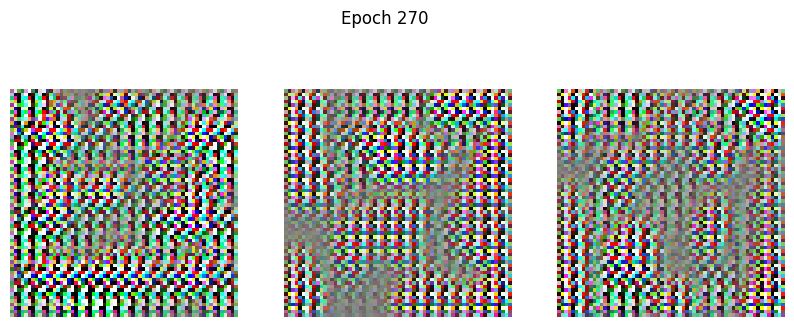

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0859 - g_loss: 5.3349
Epoch 271/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.1095 - g_loss: 5.5306

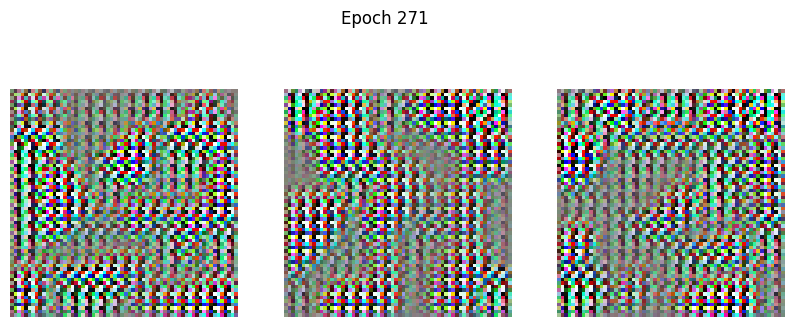

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - d_loss: 0.1121 - g_loss: 5.3771
Epoch 272/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1670 - g_loss: 7.2517 

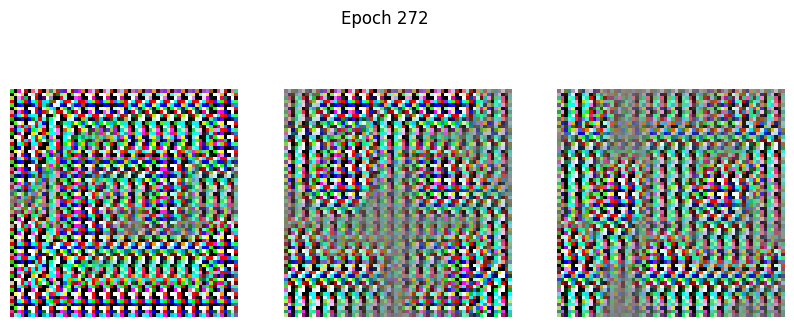

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.1616 - g_loss: 7.0500
Epoch 273/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1050 - g_loss: 5.4796

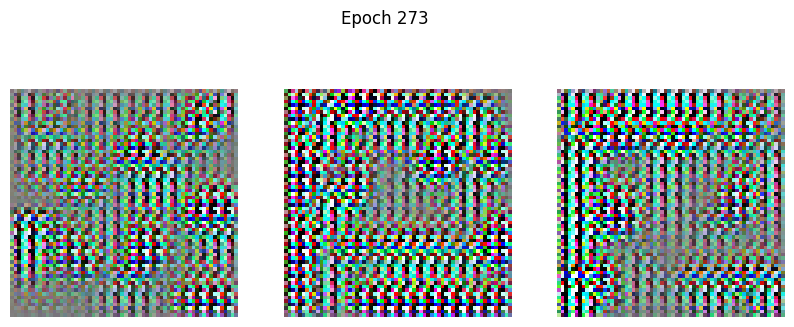

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step - d_loss: 0.1110 - g_loss: 5.7065
Epoch 274/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.1555 - g_loss: 6.0933

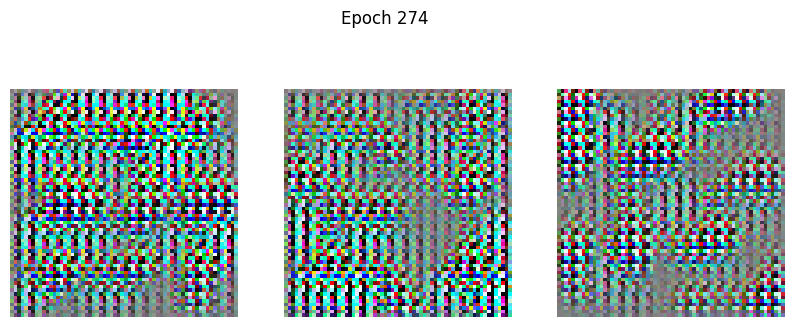

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - d_loss: 0.1708 - g_loss: 6.6222
Epoch 275/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.3558 - g_loss: 6.4865

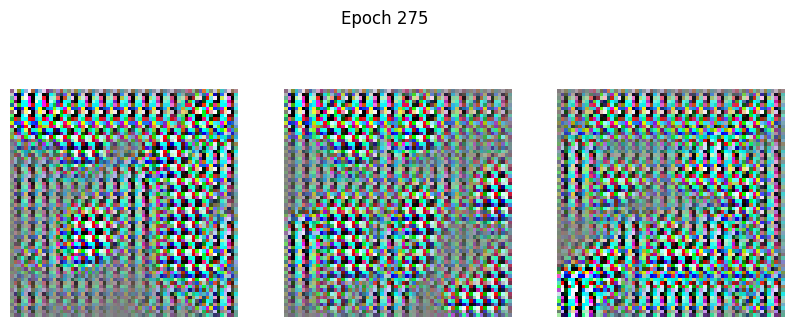

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step - d_loss: 0.3722 - g_loss: 7.3593
Epoch 276/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.3545 - g_loss: 7.4566

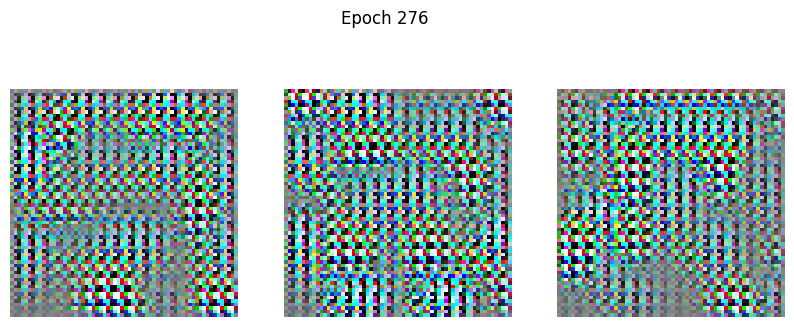

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 283ms/step - d_loss: 0.3221 - g_loss: 7.0071
Epoch 277/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1594 - g_loss: 9.6454 

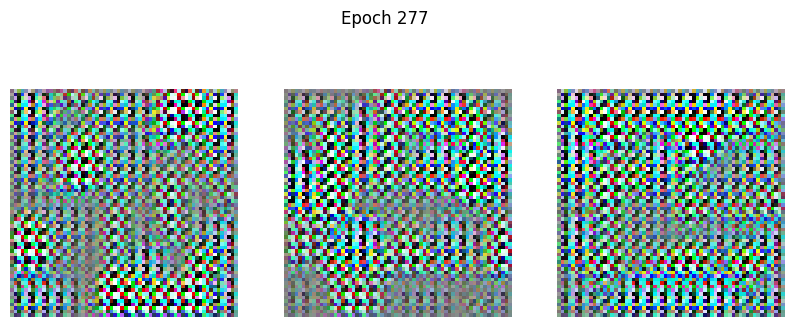

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1452 - g_loss: 9.6877
Epoch 278/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0344 - g_loss: 5.9229

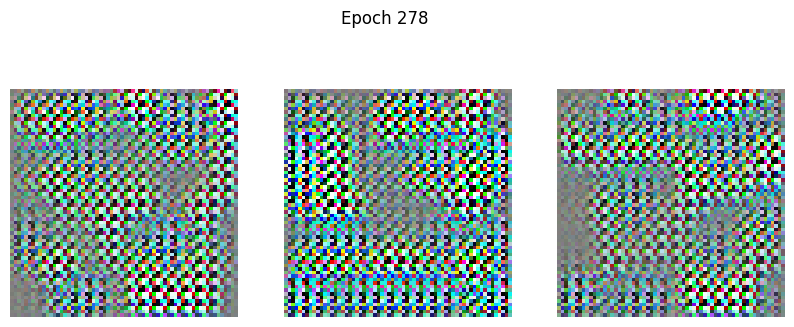

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step - d_loss: 0.0361 - g_loss: 5.7001
Epoch 279/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1750 - g_loss: 10.6506 

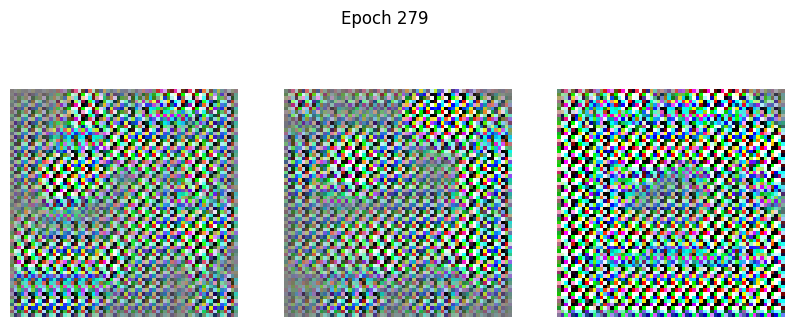

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.1652 - g_loss: 10.6288
Epoch 280/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1275 - g_loss: 5.3056 

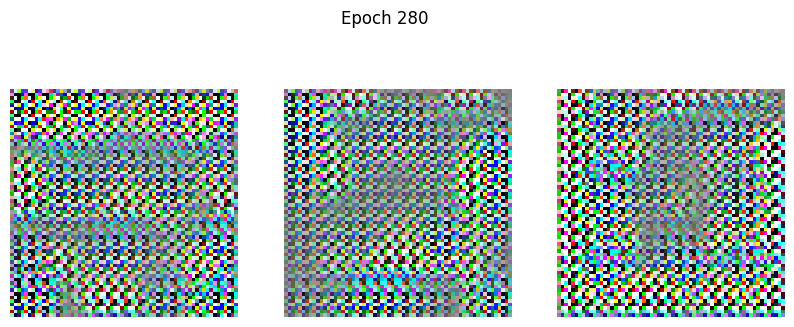

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 173ms/step - d_loss: 0.1184 - g_loss: 5.1126
Epoch 281/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1288 - g_loss: 9.8183

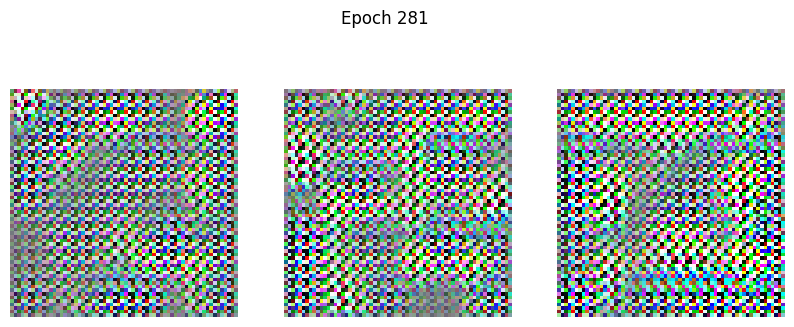

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.1254 - g_loss: 9.8194
Epoch 282/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0601 - g_loss: 6.0802

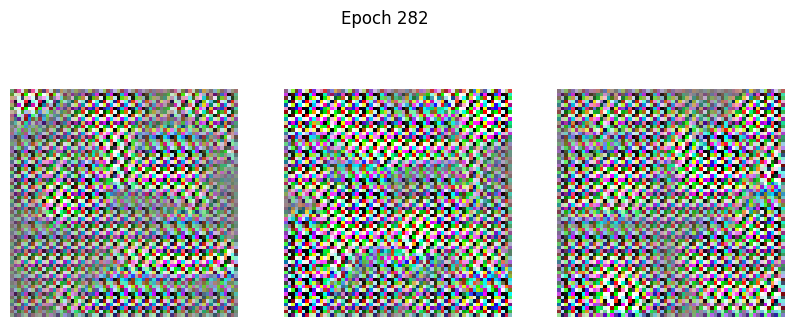

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.0591 - g_loss: 5.8134
Epoch 283/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1902 - g_loss: 12.9510 

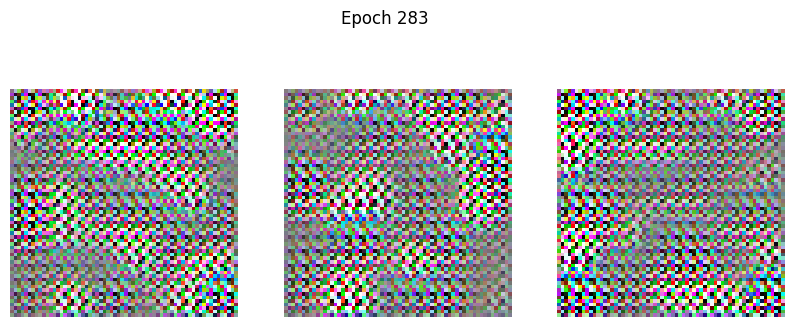

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1802 - g_loss: 12.9950
Epoch 284/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1208 - g_loss: 6.5486 

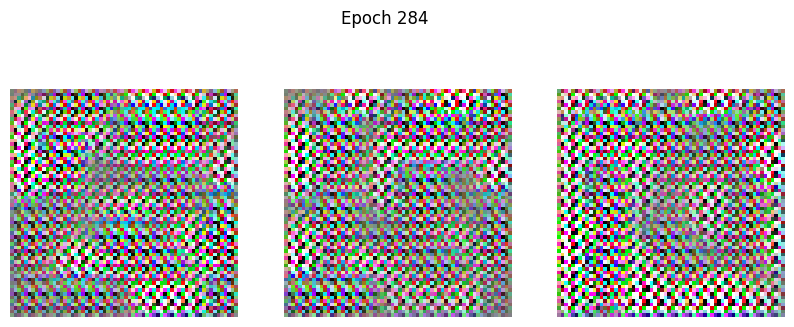

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - d_loss: 0.1094 - g_loss: 6.1323
Epoch 285/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.4042 - g_loss: 12.5031 

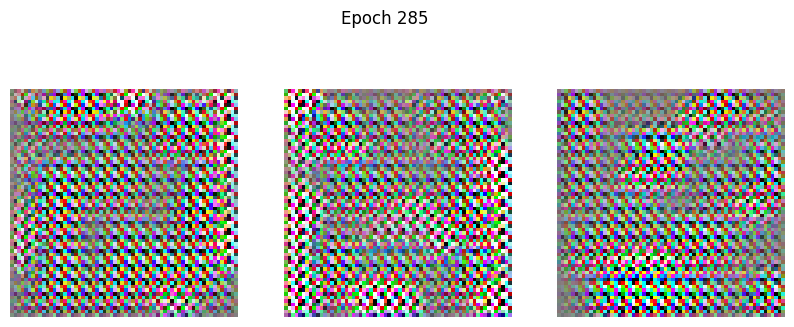

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 173ms/step - d_loss: 0.3796 - g_loss: 12.4551
Epoch 286/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1866 - g_loss: 4.9458 

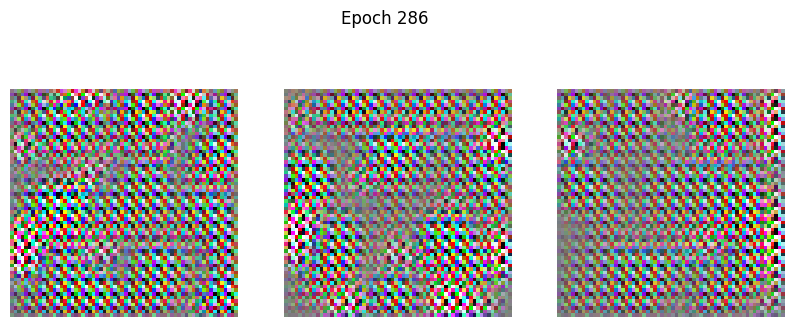

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1741 - g_loss: 4.8737
Epoch 287/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1005 - g_loss: 7.7768 

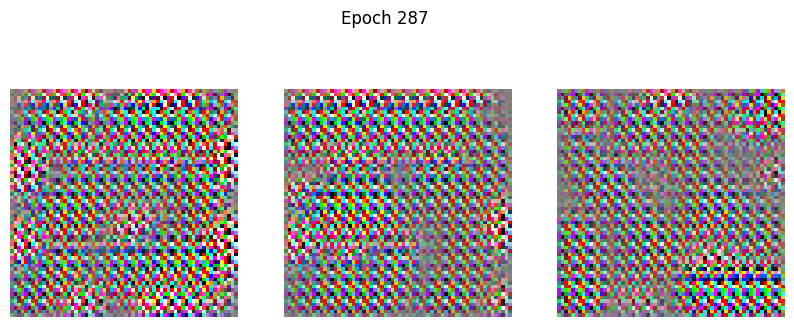

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.0957 - g_loss: 7.6857
Epoch 288/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1026 - g_loss: 5.4775

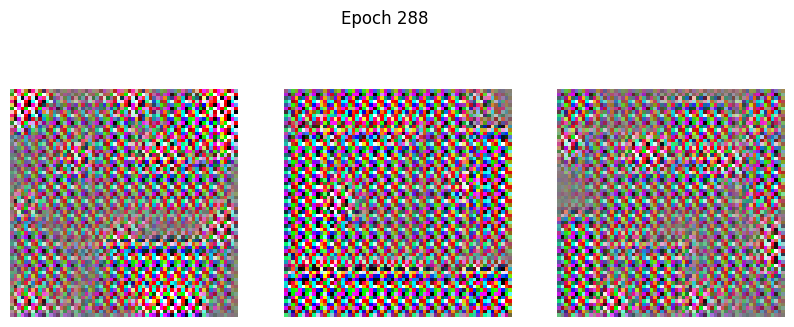

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1199 - g_loss: 5.9113
Epoch 289/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.3768 - g_loss: 6.1137 

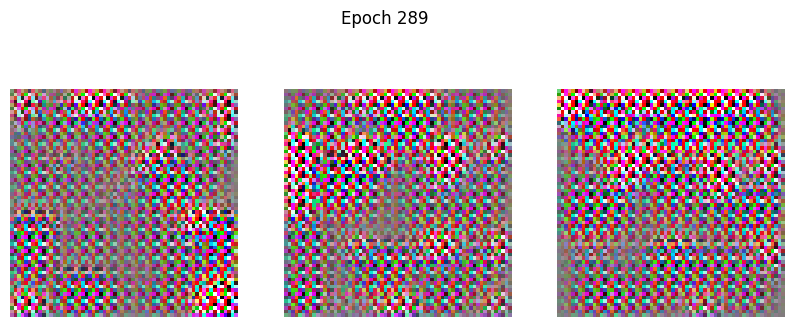

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.4013 - g_loss: 6.8065
Epoch 290/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.6836 - g_loss: 5.5132 

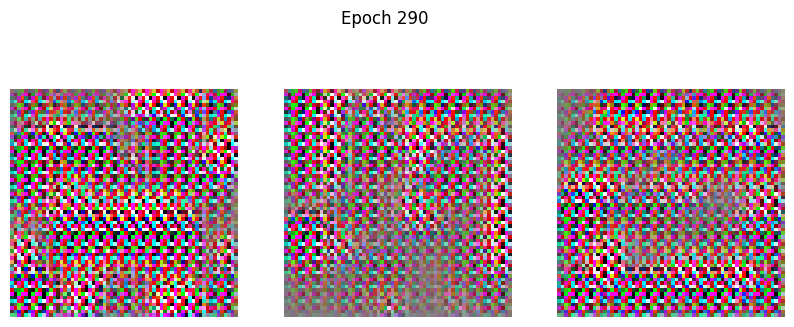

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - d_loss: 0.6658 - g_loss: 6.0325
Epoch 291/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1019 - g_loss: 9.2247

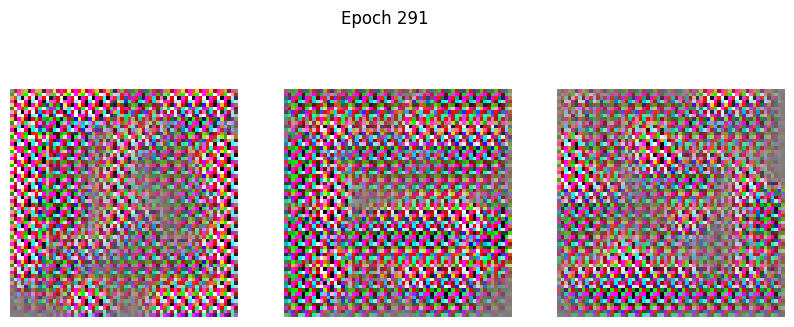

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1055 - g_loss: 8.9083
Epoch 292/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.0924 - g_loss: 4.6233

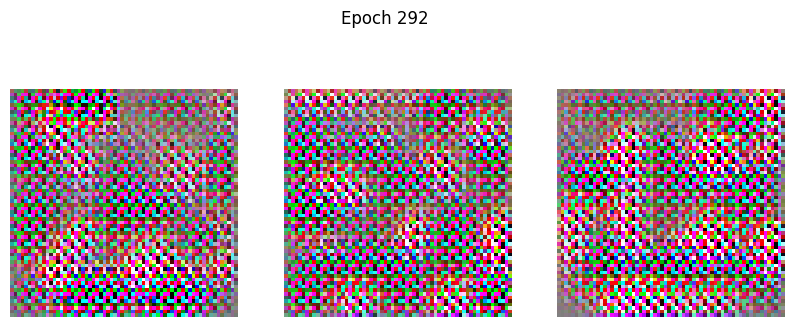

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1046 - g_loss: 4.9428
Epoch 293/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0761 - g_loss: 6.1103

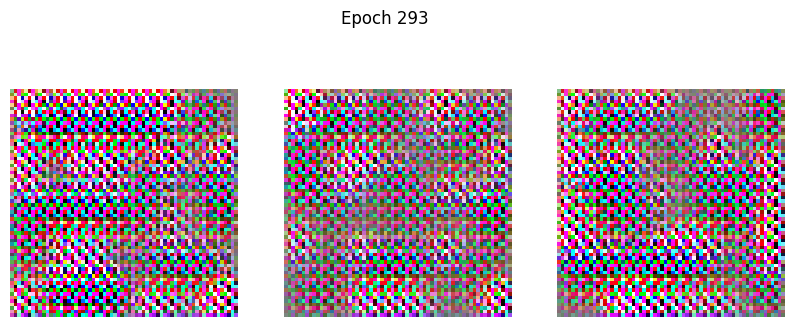

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.0803 - g_loss: 5.8446
Epoch 294/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - d_loss: 0.2544 - g_loss: 7.4588

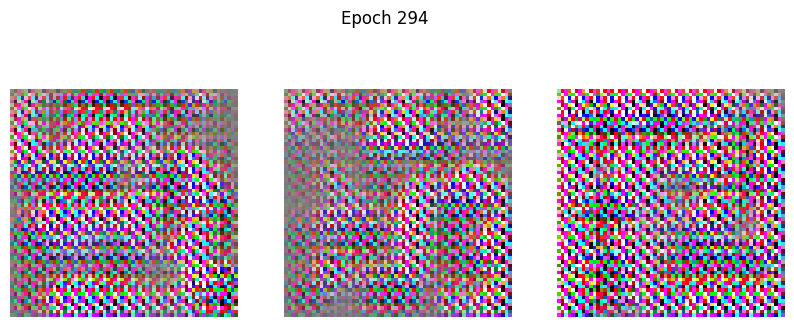

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step - d_loss: 0.2557 - g_loss: 7.1668
Epoch 295/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2069 - g_loss: 6.4221 

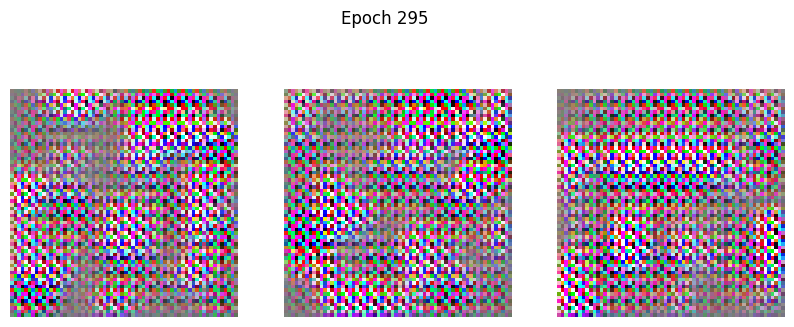

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1973 - g_loss: 6.4031
Epoch 296/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1527 - g_loss: 5.2371

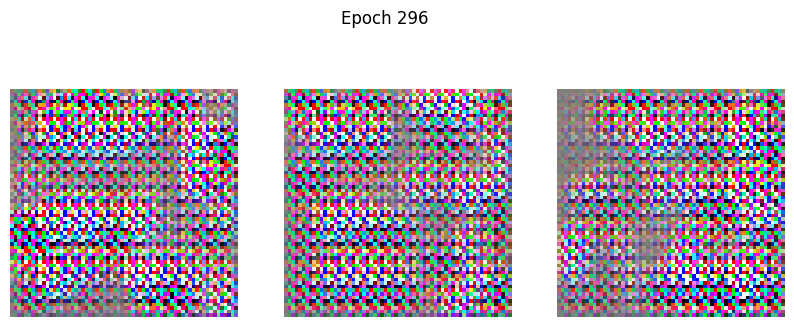

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.1565 - g_loss: 5.1936
Epoch 297/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1369 - g_loss: 6.2502 

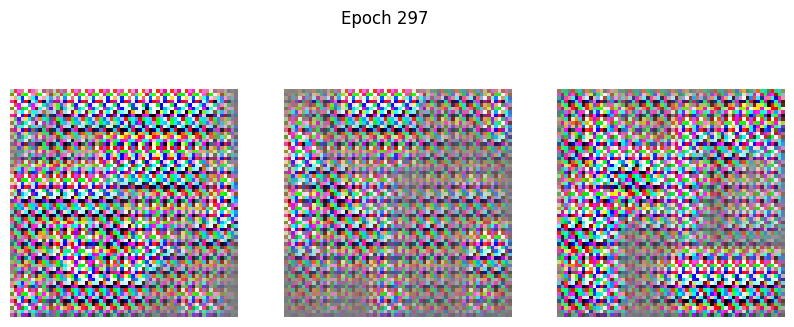

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1302 - g_loss: 6.1795
Epoch 298/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1191 - g_loss: 6.4294 

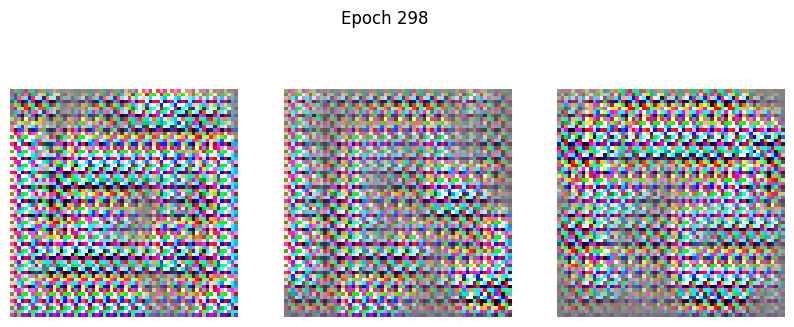

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1163 - g_loss: 6.4720
Epoch 299/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1528 - g_loss: 6.4819 

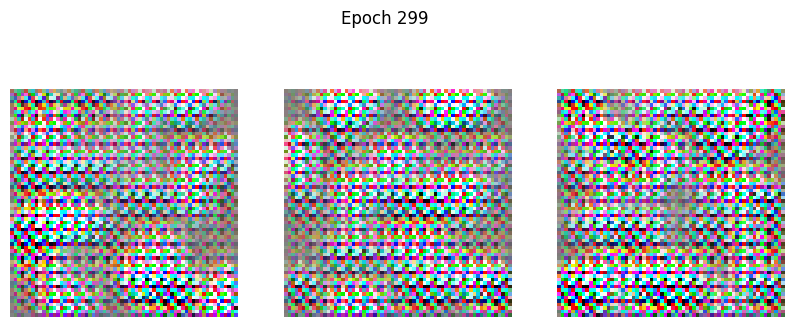

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.1515 - g_loss: 6.8300
Epoch 300/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1358 - g_loss: 5.5653

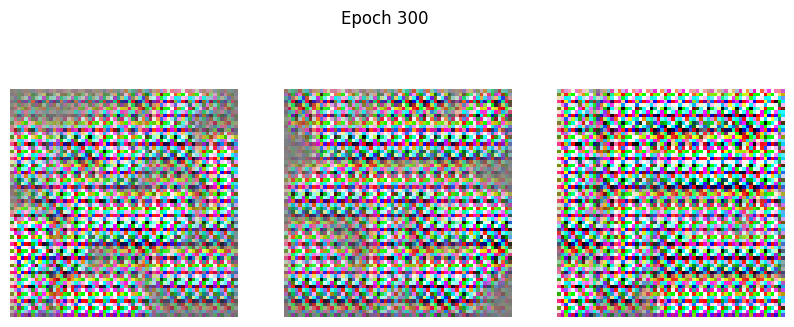

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1334 - g_loss: 5.4296
Epoch 301/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1478 - g_loss: 11.0606

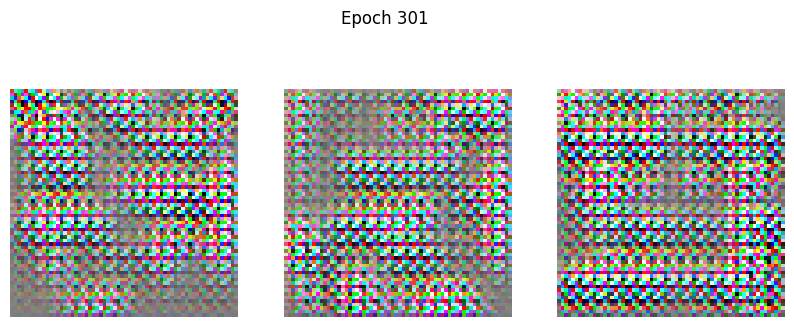

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.1547 - g_loss: 10.7943
Epoch 302/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1391 - g_loss: 7.3171 

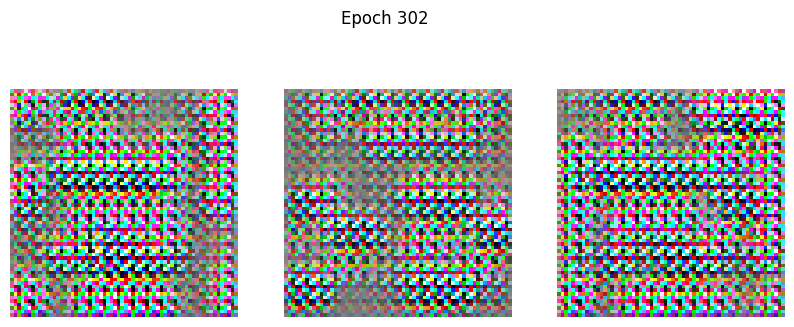

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1631 - g_loss: 8.6761
Epoch 303/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.3601 - g_loss: 13.5972

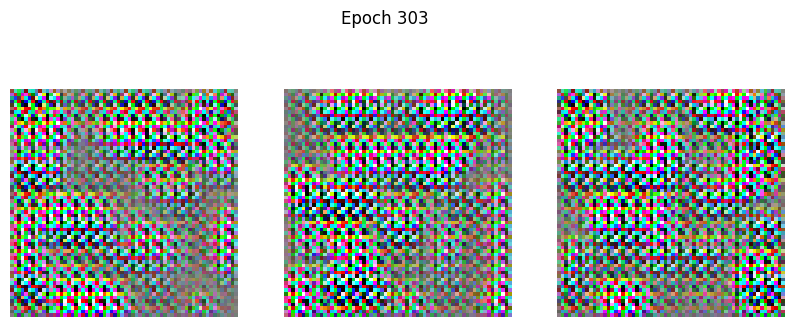

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.3437 - g_loss: 12.7675
Epoch 304/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1358 - g_loss: 6.9982

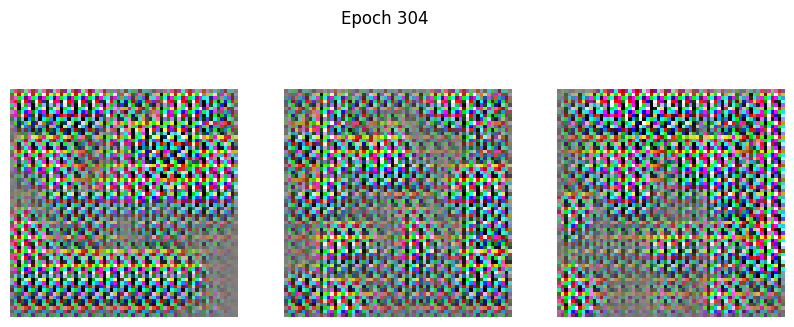

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1282 - g_loss: 7.0101
Epoch 305/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0875 - g_loss: 6.0243 

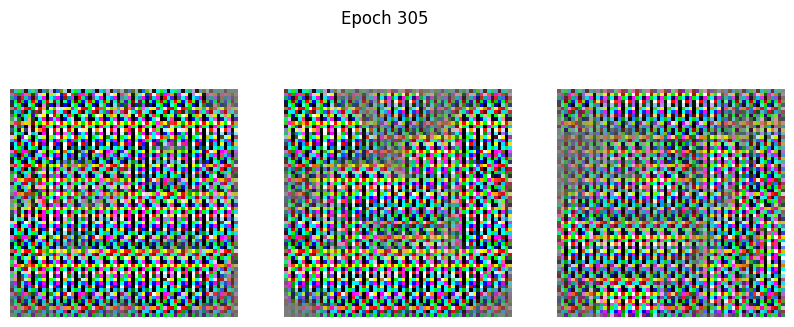

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0877 - g_loss: 6.1163
Epoch 306/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0987 - g_loss: 5.2363

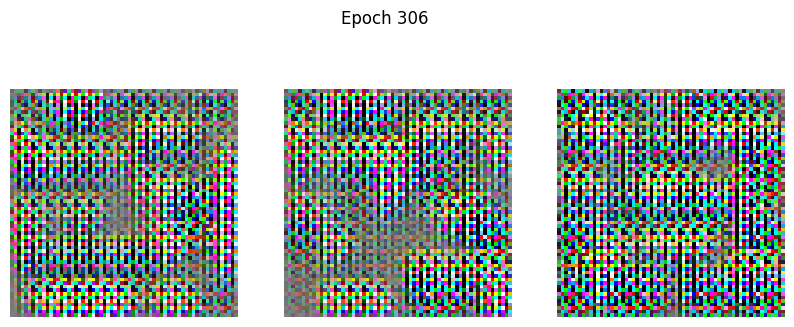

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1024 - g_loss: 5.2083
Epoch 307/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.0973 - g_loss: 5.4221 

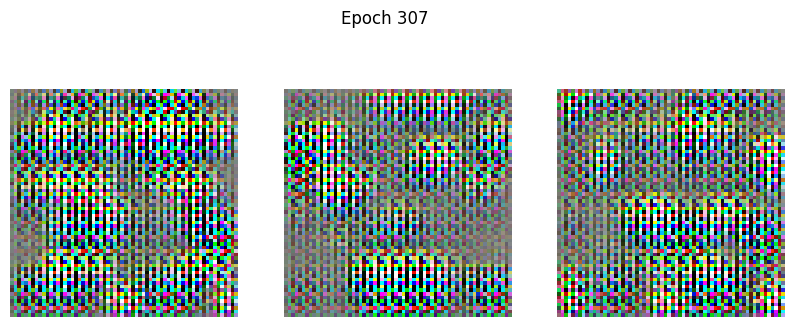

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.0923 - g_loss: 5.4308
Epoch 308/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.0850 - g_loss: 6.2997

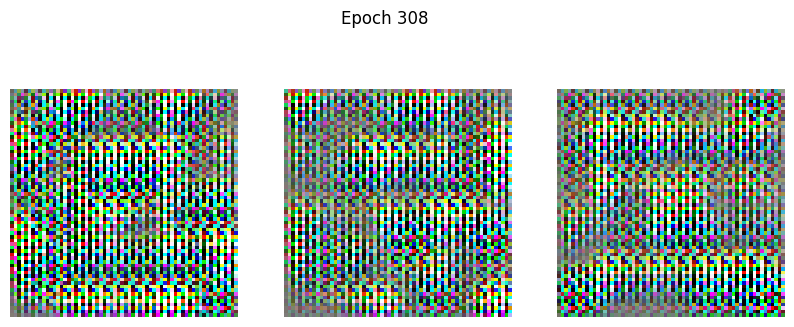

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step - d_loss: 0.0871 - g_loss: 6.2256
Epoch 309/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - d_loss: 0.1268 - g_loss: 7.1898 

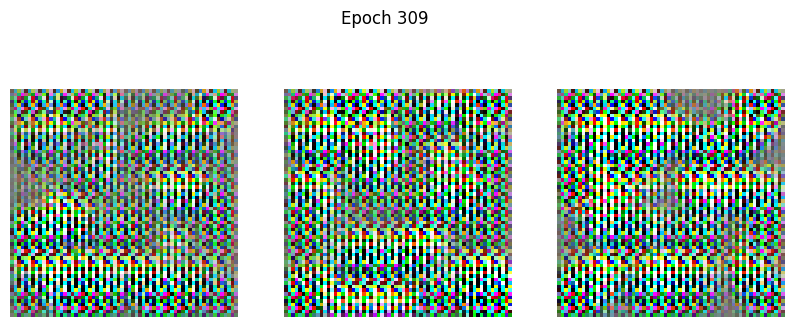

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 176ms/step - d_loss: 0.1216 - g_loss: 7.1522
Epoch 310/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1069 - g_loss: 6.6578

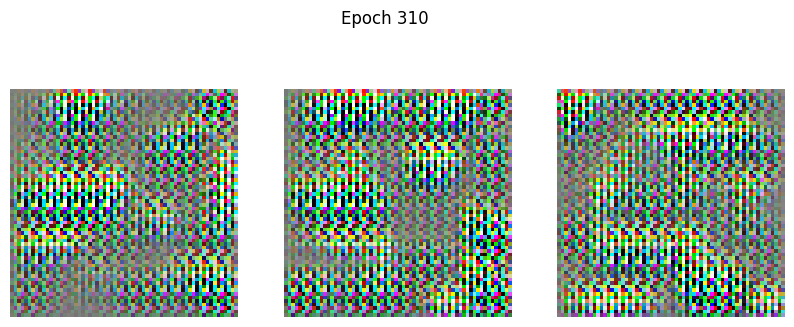

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.1131 - g_loss: 6.7116
Epoch 311/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.1049 - g_loss: 6.8752

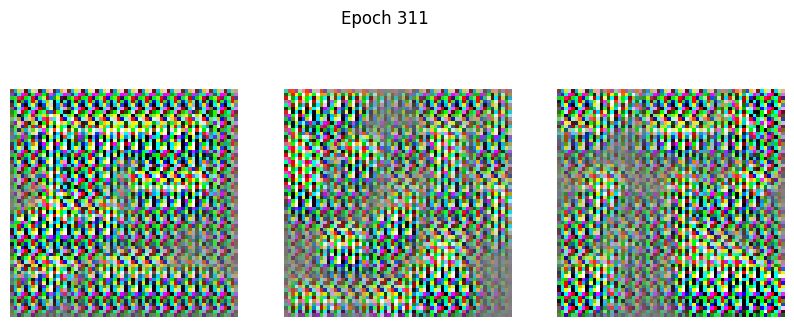

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step - d_loss: 0.1104 - g_loss: 6.8649
Epoch 312/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1229 - g_loss: 6.5764 

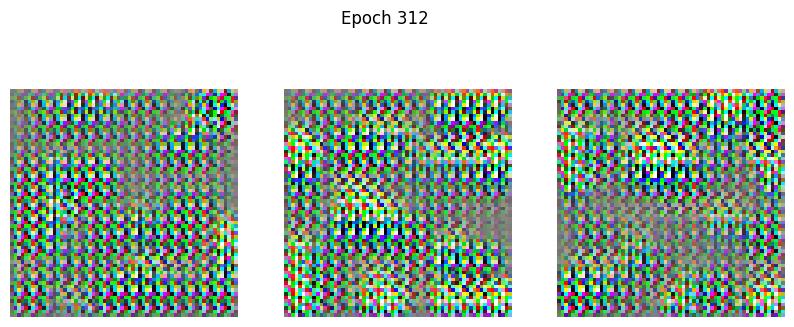

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 213ms/step - d_loss: 0.1202 - g_loss: 6.6372
Epoch 313/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - d_loss: 0.1004 - g_loss: 5.5074 

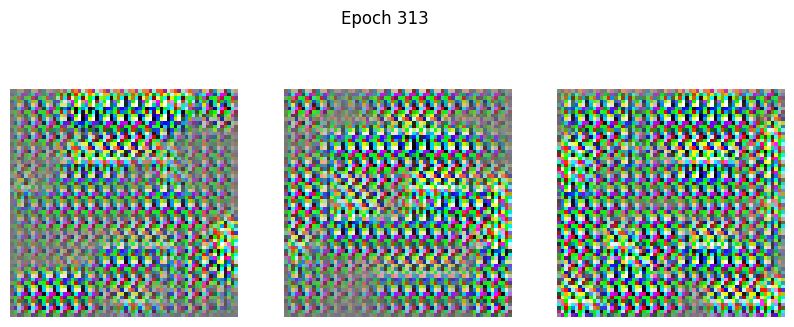

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 224ms/step - d_loss: 0.1014 - g_loss: 5.6608
Epoch 314/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0757 - g_loss: 5.3765 

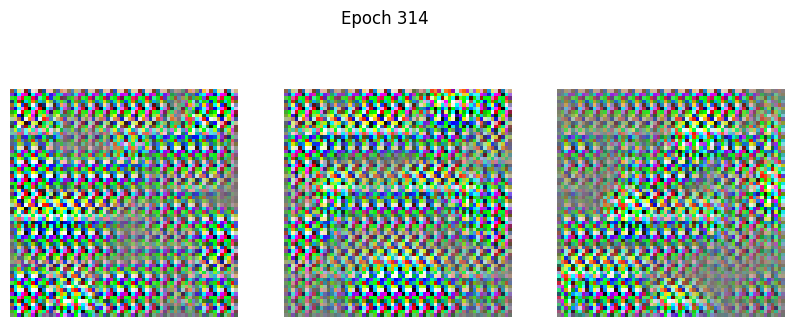

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - d_loss: 0.0744 - g_loss: 5.4128
Epoch 315/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.0939 - g_loss: 6.8389

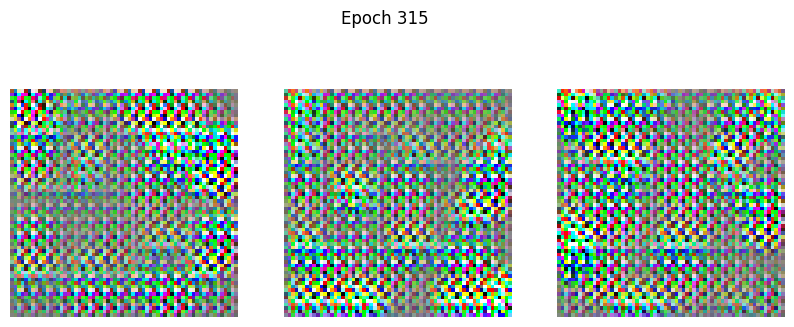

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step - d_loss: 0.0964 - g_loss: 6.6916
Epoch 316/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1721 - g_loss: 7.1608

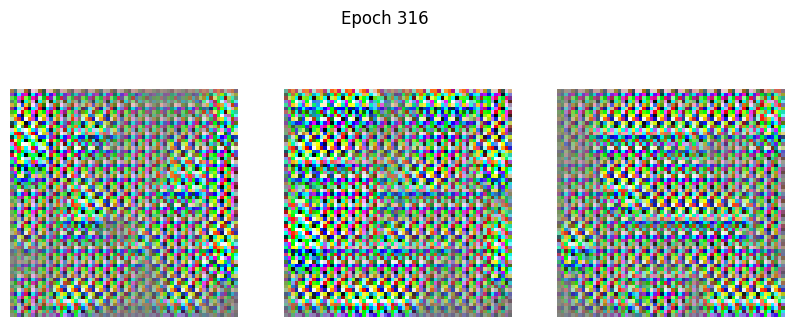

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step - d_loss: 0.1765 - g_loss: 7.0643
Epoch 317/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.2370 - g_loss: 8.7408

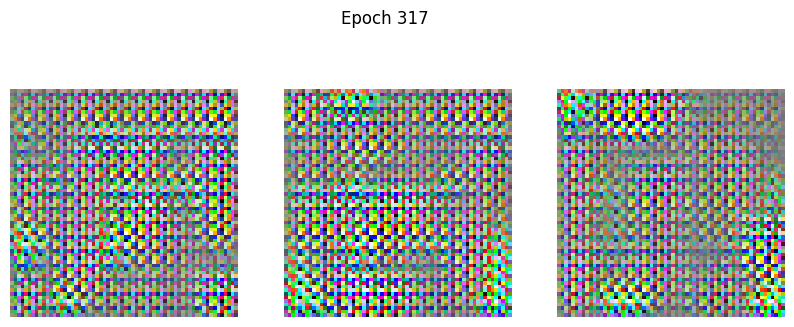

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 286ms/step - d_loss: 0.2406 - g_loss: 8.3330
Epoch 318/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - d_loss: 0.4114 - g_loss: 13.2559 

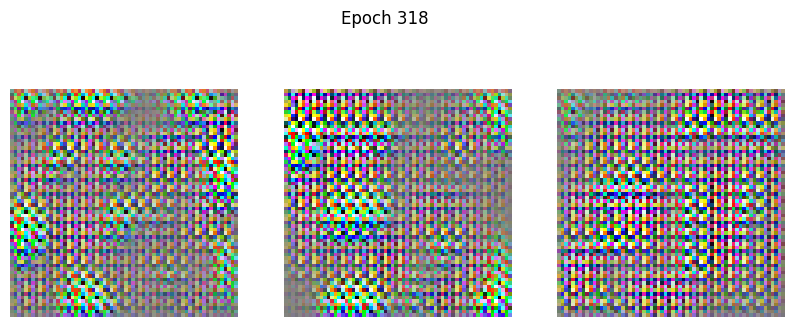

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 223ms/step - d_loss: 0.3907 - g_loss: 12.8327
Epoch 319/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.2858 - g_loss: 9.5793 

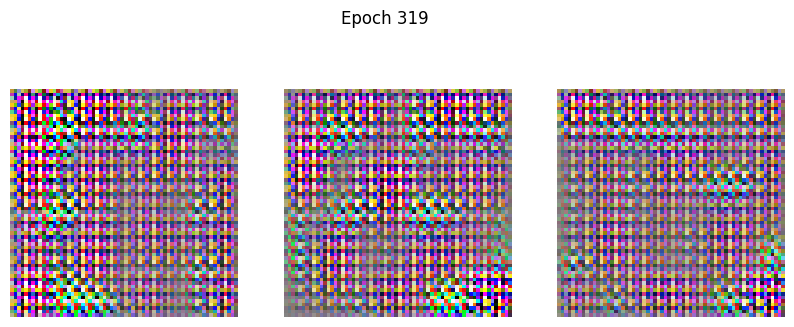

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 203ms/step - d_loss: 0.3143 - g_loss: 10.5904
Epoch 320/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.8885 - g_loss: 6.7950 

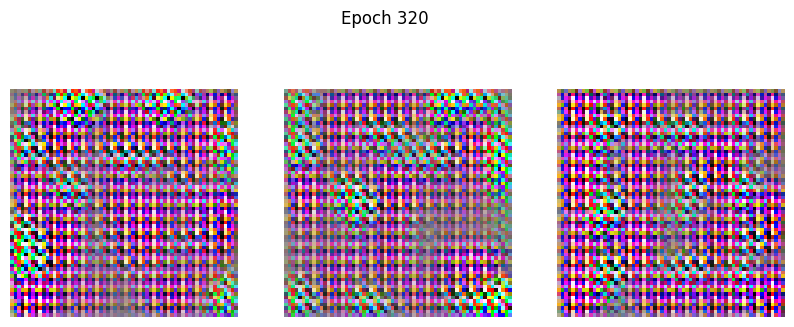

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step - d_loss: 0.7914 - g_loss: 6.3454
Epoch 321/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.5638 - g_loss: 22.6524

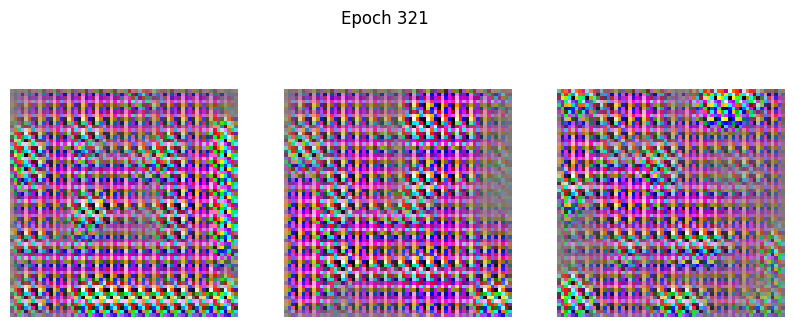

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step - d_loss: 0.5184 - g_loss: 22.7757
Epoch 322/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.2095 - g_loss: 10.4059

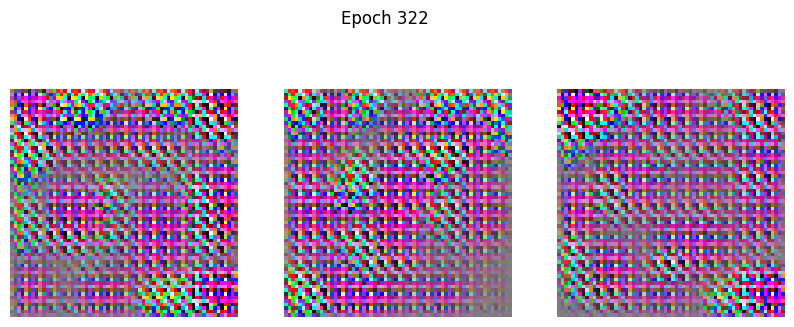

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 228ms/step - d_loss: 0.1985 - g_loss: 9.6197 
Epoch 323/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - d_loss: 0.3567 - g_loss: 11.2768 

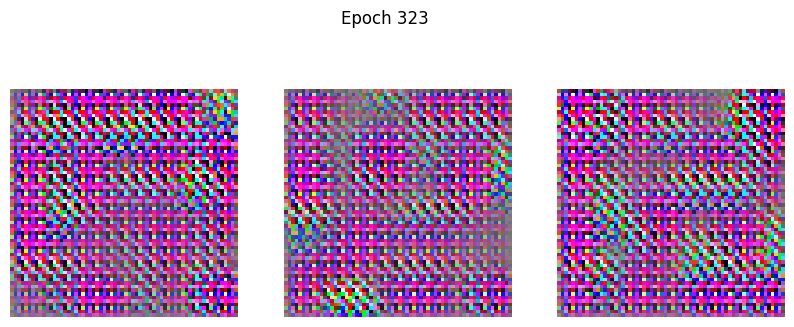

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.3316 - g_loss: 11.3820
Epoch 324/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - d_loss: 0.1425 - g_loss: 7.5756 

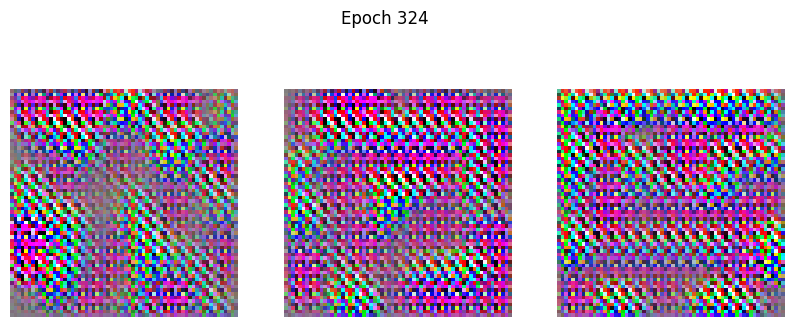

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step - d_loss: 0.1331 - g_loss: 7.2438
Epoch 325/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - d_loss: 0.0956 - g_loss: 5.4356

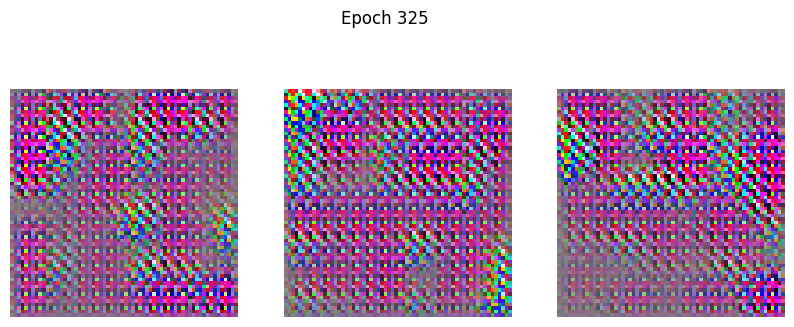

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 236ms/step - d_loss: 0.0907 - g_loss: 5.4531
Epoch 326/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0503 - g_loss: 4.6146

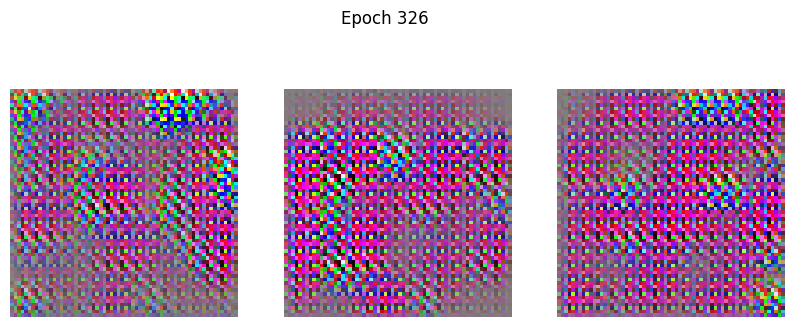

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.0527 - g_loss: 4.6068
Epoch 327/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0663 - g_loss: 4.8435

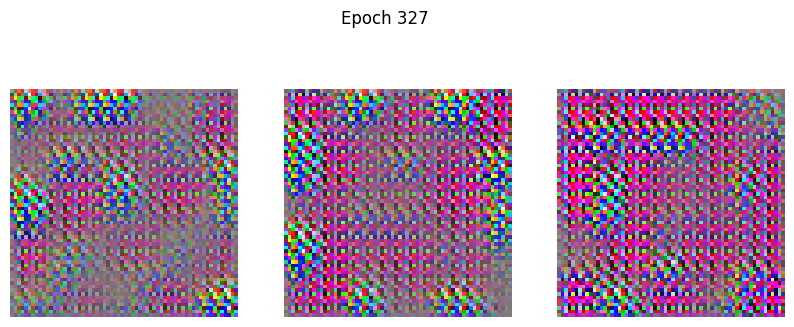

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0682 - g_loss: 4.8642
Epoch 328/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0817 - g_loss: 5.3267

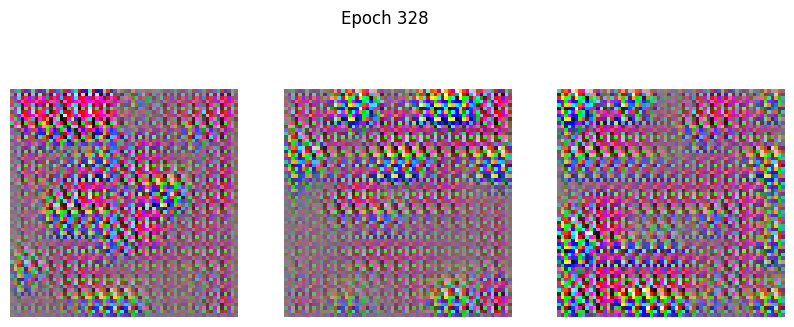

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0835 - g_loss: 5.2535
Epoch 329/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.0986 - g_loss: 5.2737

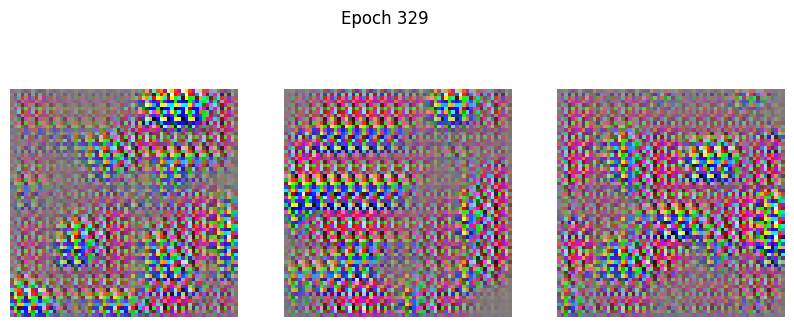

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - d_loss: 0.1001 - g_loss: 5.2439
Epoch 330/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1200 - g_loss: 5.5475

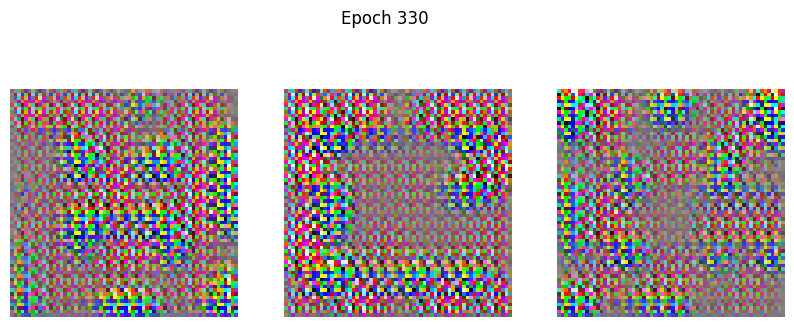

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1249 - g_loss: 5.5226
Epoch 331/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.1459 - g_loss: 5.2017

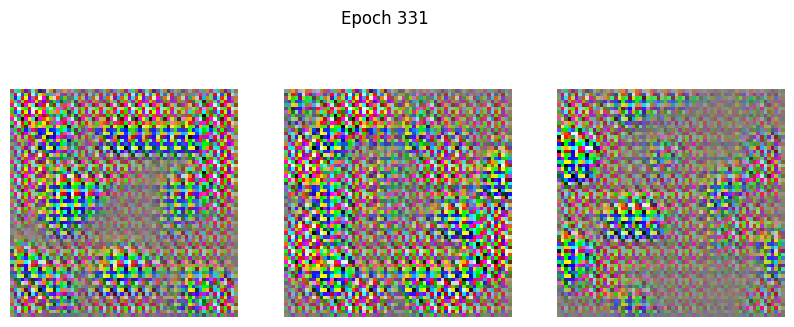

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1517 - g_loss: 5.1280
Epoch 332/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1522 - g_loss: 5.1547

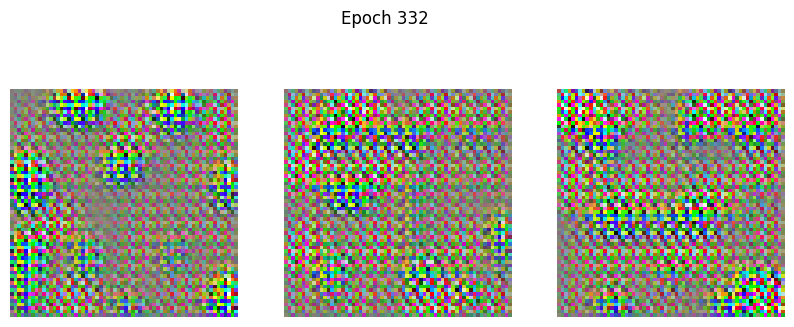

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1550 - g_loss: 5.0399
Epoch 333/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1815 - g_loss: 5.2927 

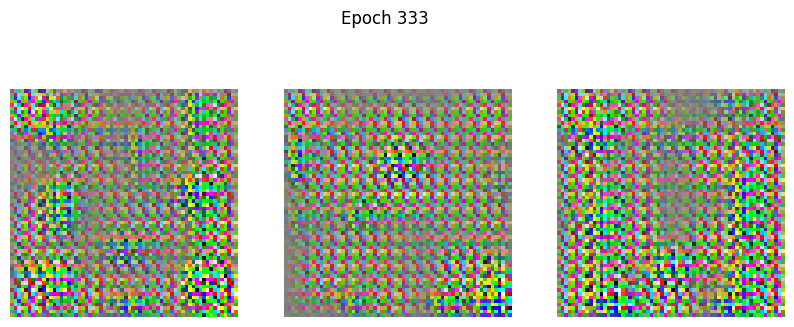

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1739 - g_loss: 5.2959
Epoch 334/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - d_loss: 0.1785 - g_loss: 4.6584

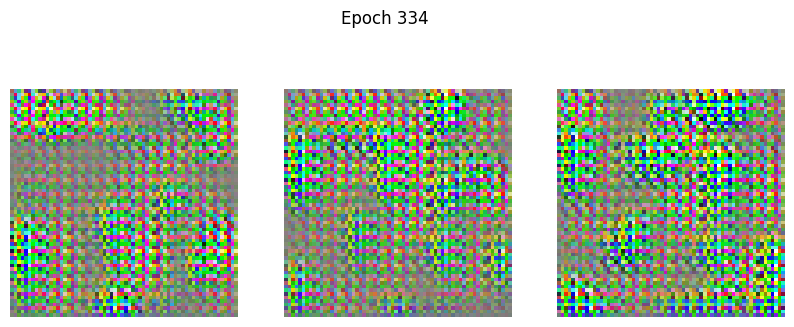

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1884 - g_loss: 4.5540
Epoch 335/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.2171 - g_loss: 5.1706

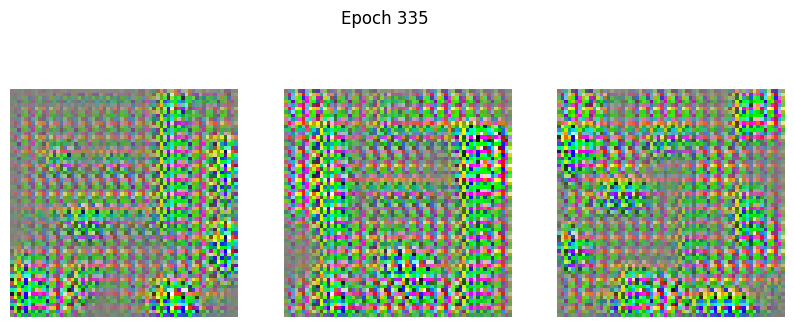

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.2203 - g_loss: 4.9769
Epoch 336/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1850 - g_loss: 5.6343 

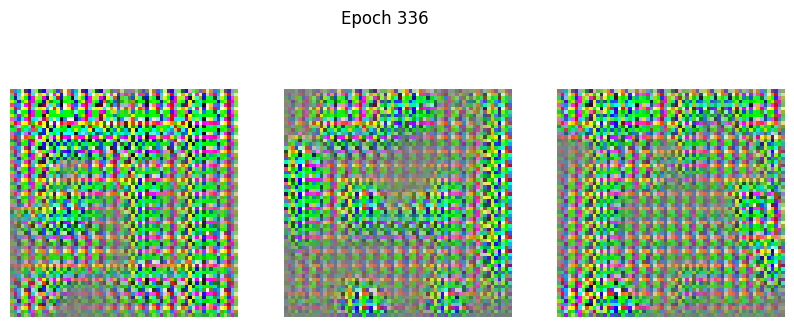

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1728 - g_loss: 5.6380
Epoch 337/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.1112 - g_loss: 4.6010

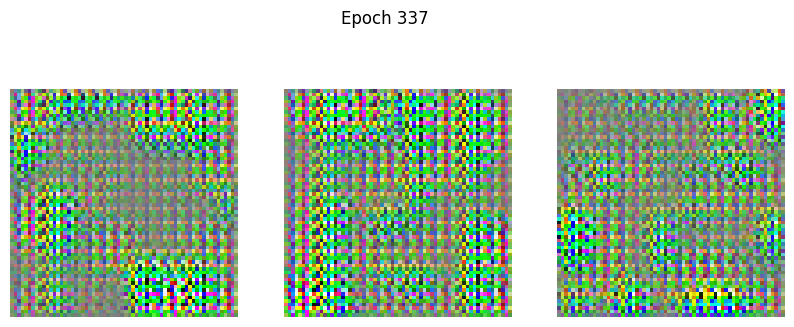

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.1178 - g_loss: 4.6294
Epoch 338/500
1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - d_loss: 0.1512 - g_loss: 5.2140

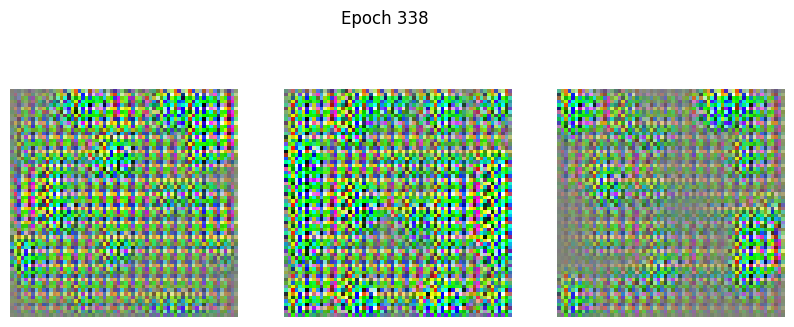

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step - d_loss: 0.1316 - g_loss: 5.1942
Epoch 339/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1122 - g_loss: 4.7212 

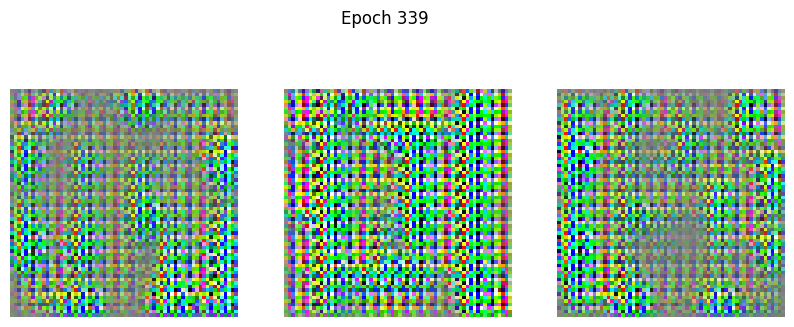

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - d_loss: 0.1091 - g_loss: 4.7985
Epoch 340/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0888 - g_loss: 5.2423 

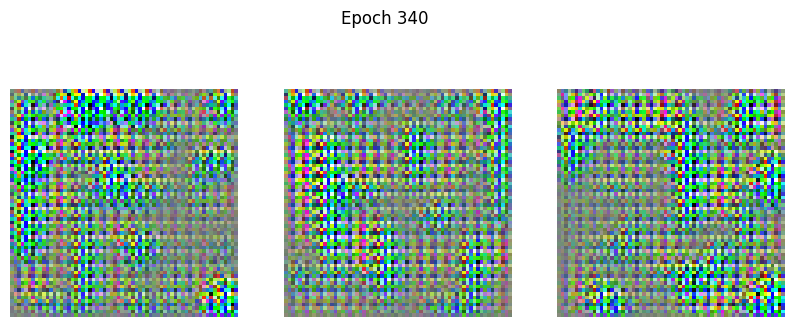

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - d_loss: 0.0903 - g_loss: 5.3869
Epoch 341/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.0812 - g_loss: 5.2639

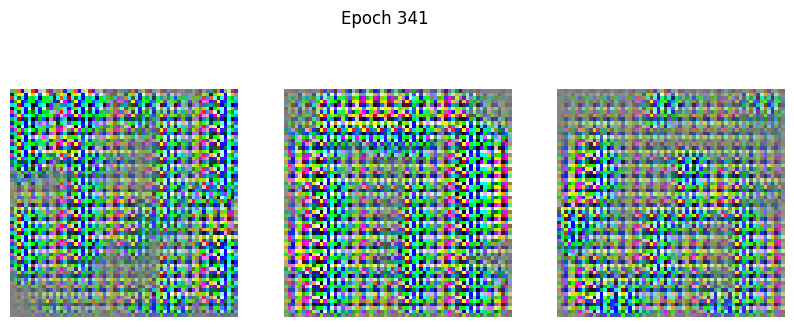

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0852 - g_loss: 5.1976
Epoch 342/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1408 - g_loss: 6.2253 

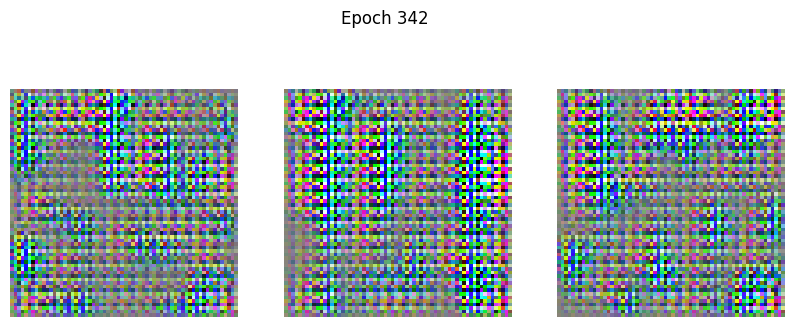

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1342 - g_loss: 6.1016
Epoch 343/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1339 - g_loss: 5.5893

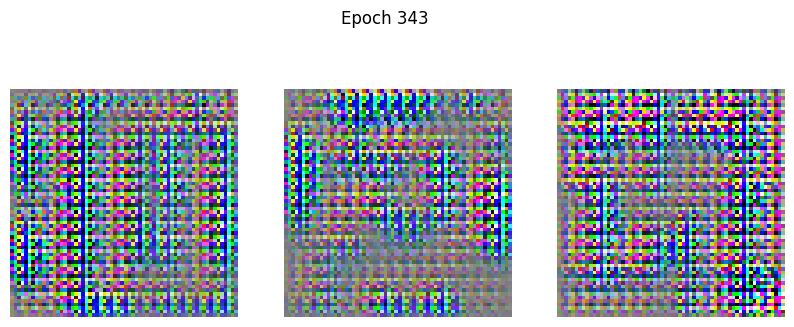

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1360 - g_loss: 5.5009
Epoch 344/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - d_loss: 0.1220 - g_loss: 5.7382

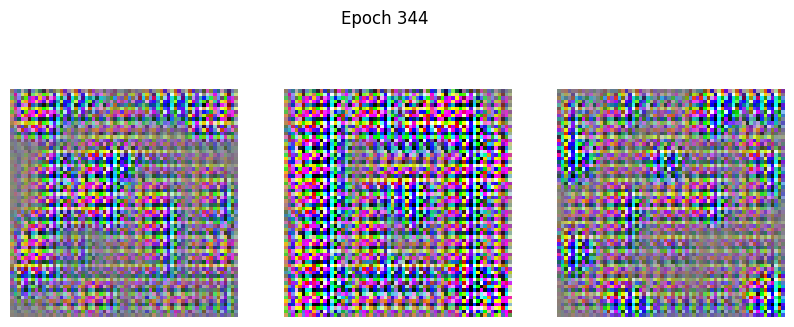

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.1231 - g_loss: 5.6408
Epoch 345/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.0997 - g_loss: 5.9291 

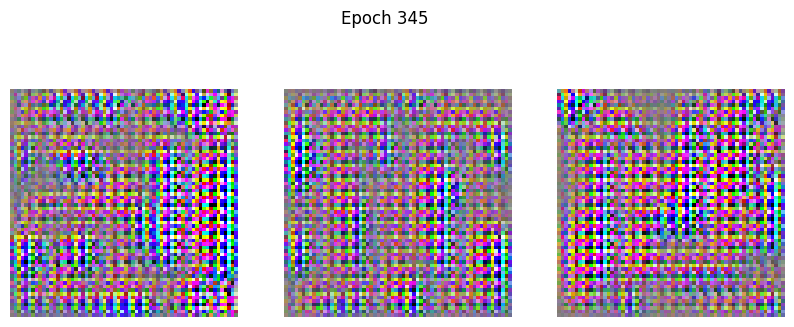

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.0937 - g_loss: 5.8766
Epoch 346/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.0700 - g_loss: 5.2140

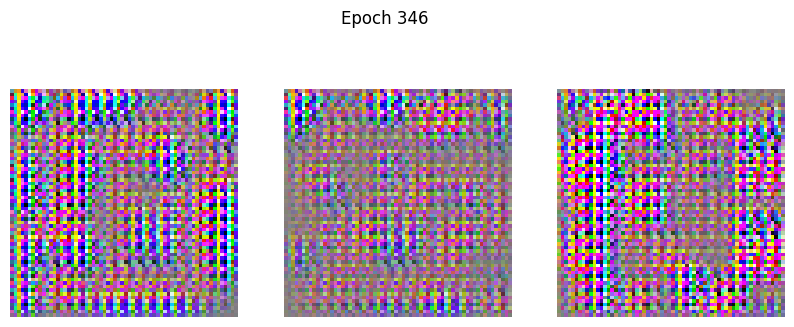

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - d_loss: 0.0731 - g_loss: 5.2714
Epoch 347/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0782 - g_loss: 5.0843

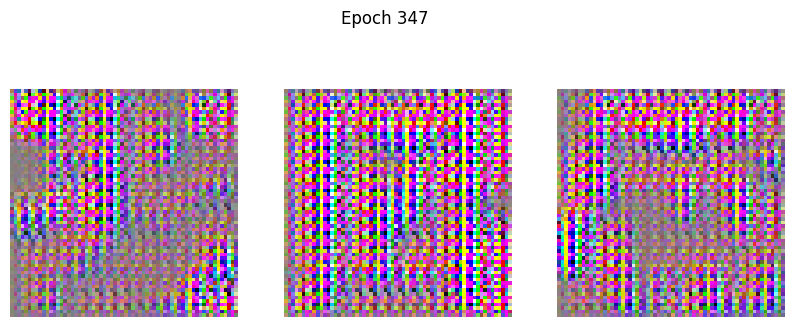

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 277ms/step - d_loss: 0.0825 - g_loss: 5.0839
Epoch 348/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1010 - g_loss: 5.0837 

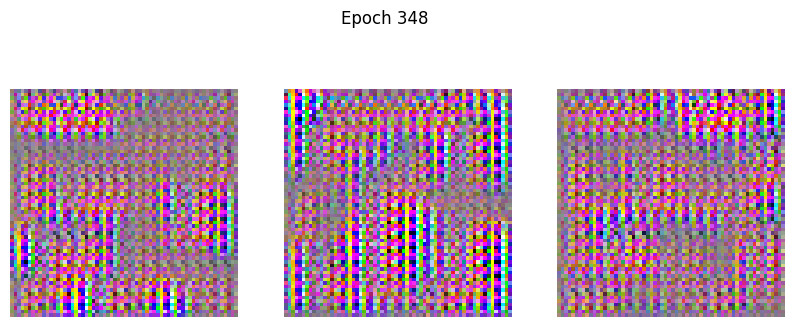

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.0970 - g_loss: 5.0662
Epoch 349/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0529 - g_loss: 4.5224

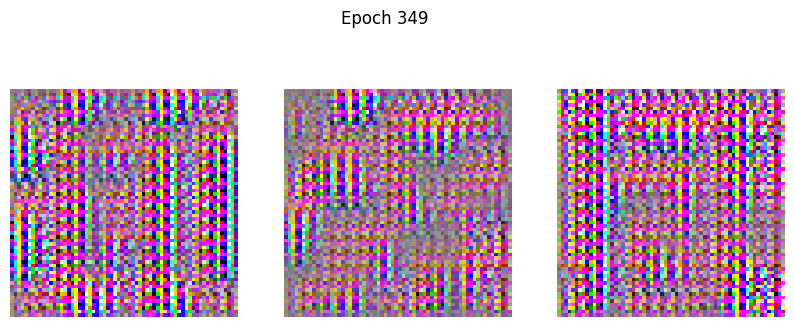

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - d_loss: 0.0558 - g_loss: 4.5364
Epoch 350/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0679 - g_loss: 4.8911 

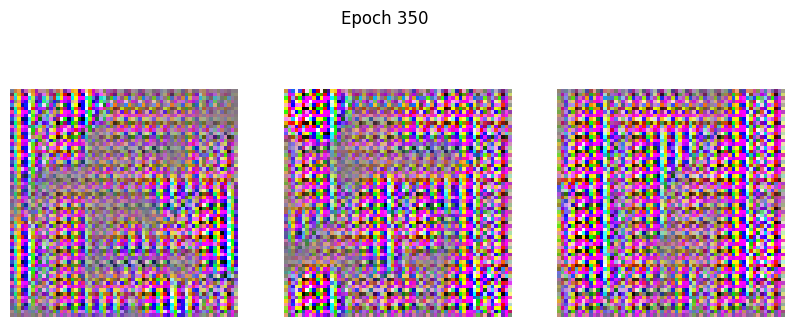

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 218ms/step - d_loss: 0.0669 - g_loss: 4.9538
Epoch 351/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0736 - g_loss: 4.8281 

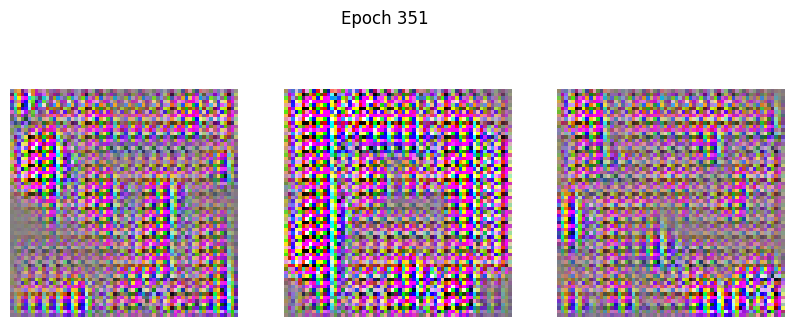

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0733 - g_loss: 4.9083
Epoch 352/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.0810 - g_loss: 5.2071 

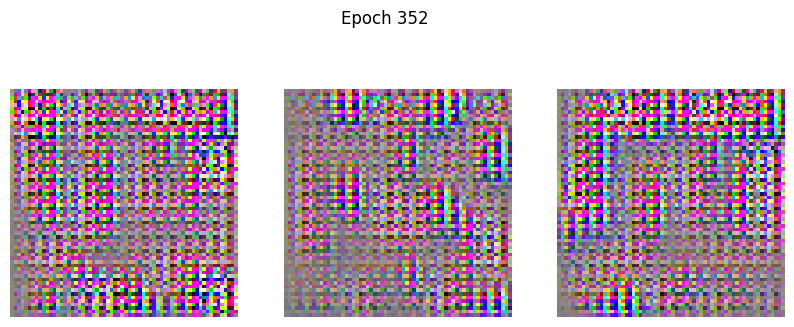

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.0817 - g_loss: 5.3484
Epoch 353/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1045 - g_loss: 5.3904 

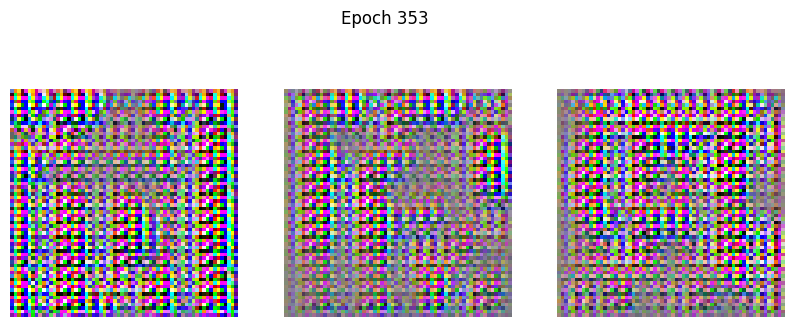

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 204ms/step - d_loss: 0.1044 - g_loss: 5.5875
Epoch 354/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1017 - g_loss: 5.4323 

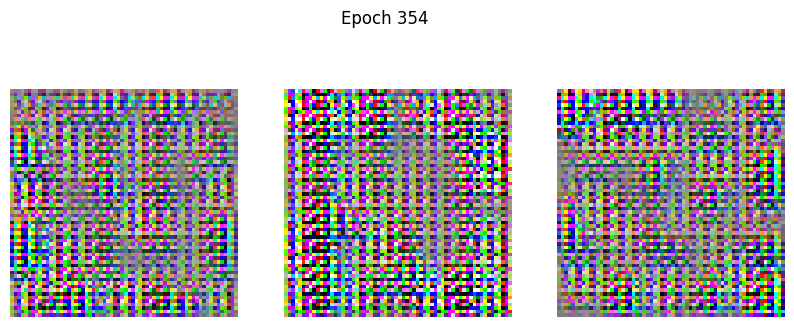

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - d_loss: 0.1017 - g_loss: 5.5725
Epoch 355/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.0916 - g_loss: 5.8136 

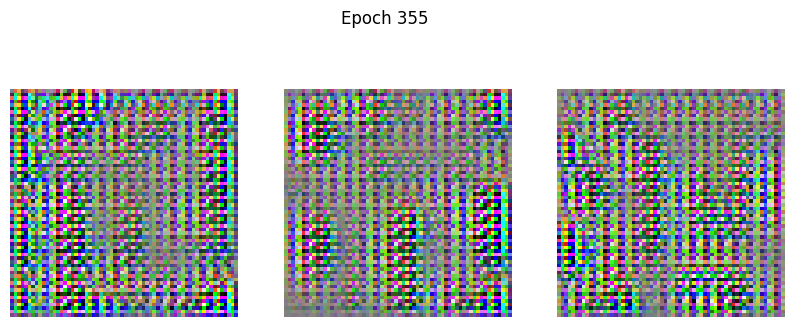

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.0905 - g_loss: 5.8707
Epoch 356/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.0804 - g_loss: 6.0145

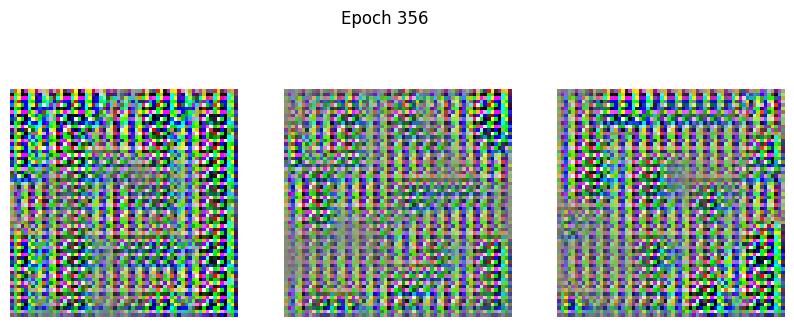

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.0865 - g_loss: 6.1854
Epoch 357/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.1417 - g_loss: 6.8846 

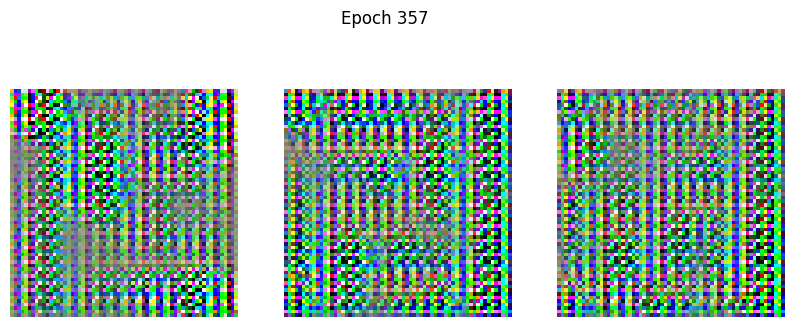

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.1495 - g_loss: 7.5133
Epoch 358/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.2209 - g_loss: 6.9012

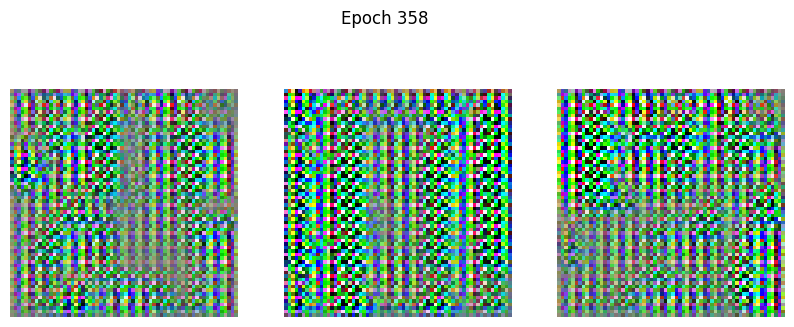

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.2080 - g_loss: 6.7746
Epoch 359/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.1484 - g_loss: 9.8414

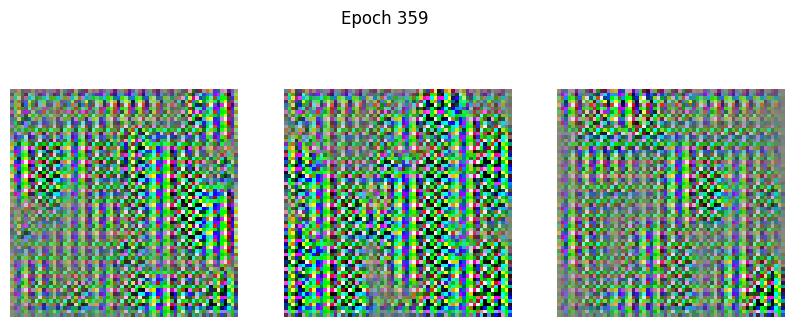

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.1503 - g_loss: 9.4949
Epoch 360/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - d_loss: 0.1145 - g_loss: 7.0811 

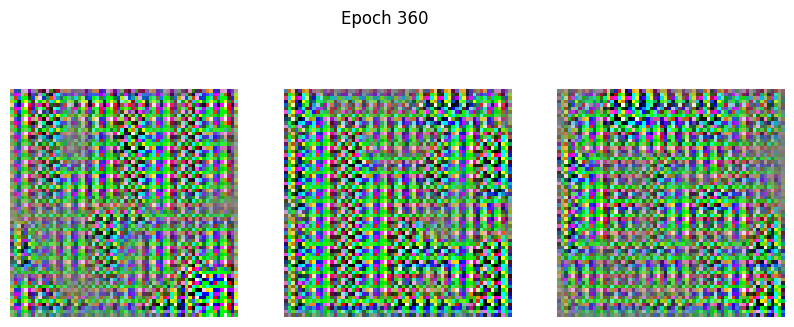

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - d_loss: 0.1256 - g_loss: 7.7801
Epoch 361/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.2801 - g_loss: 6.7043 

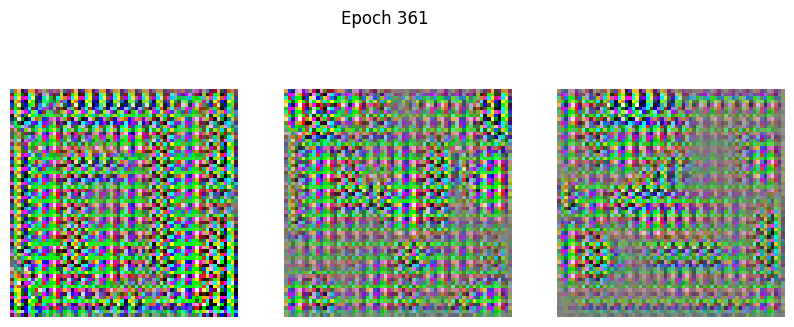

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.2532 - g_loss: 6.4198
Epoch 362/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.3031 - g_loss: 17.1720 

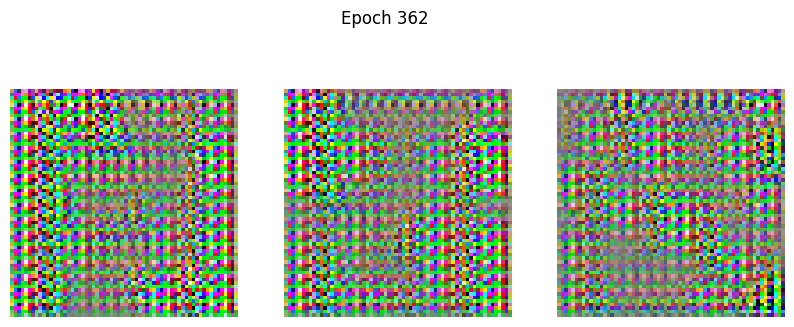

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.2942 - g_loss: 17.2033
Epoch 363/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.1755 - g_loss: 8.3186

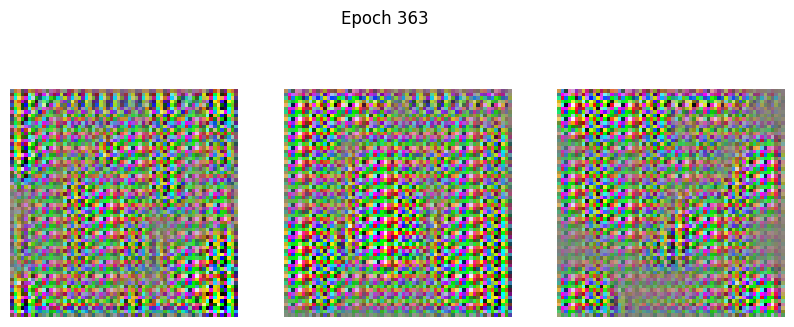

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.1604 - g_loss: 7.7357
Epoch 364/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.3939 - g_loss: 14.4831 

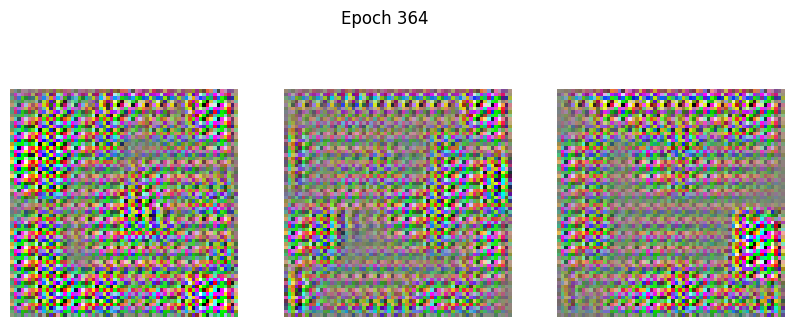

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.3692 - g_loss: 14.4861
Epoch 365/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1686 - g_loss: 6.1111 

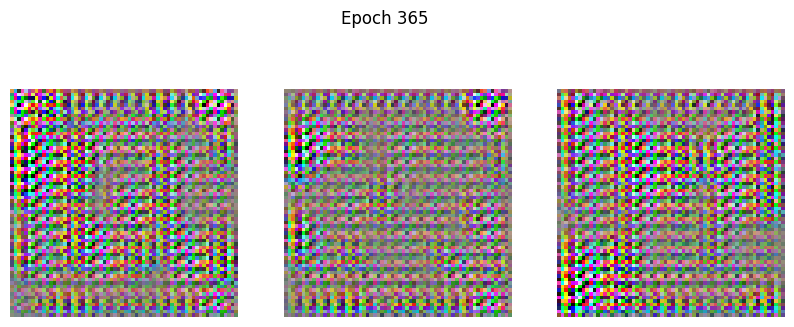

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1573 - g_loss: 5.8790
Epoch 366/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.2458 - g_loss: 10.5789 

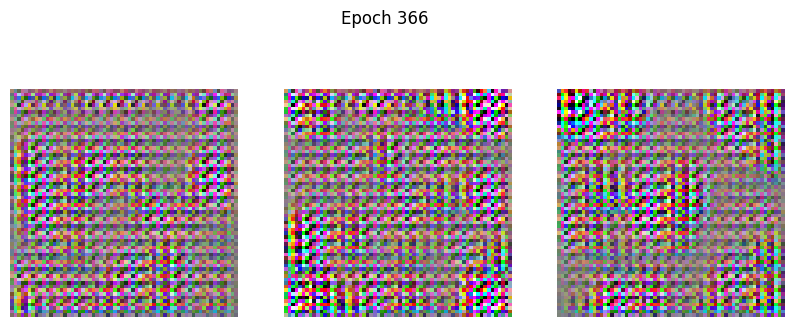

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.2310 - g_loss: 10.4223
Epoch 367/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1558 - g_loss: 5.2626

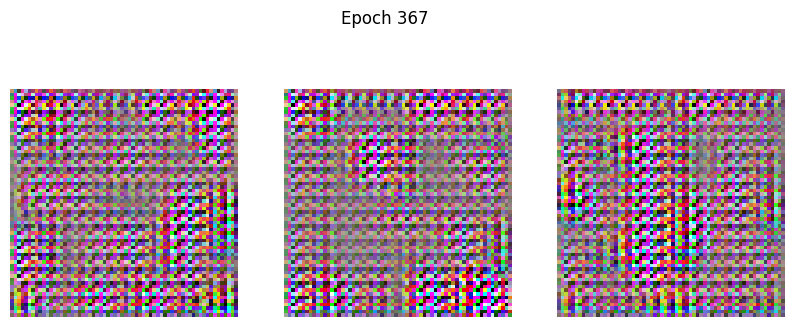

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.1730 - g_loss: 5.6626
Epoch 368/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - d_loss: 0.1366 - g_loss: 6.1749

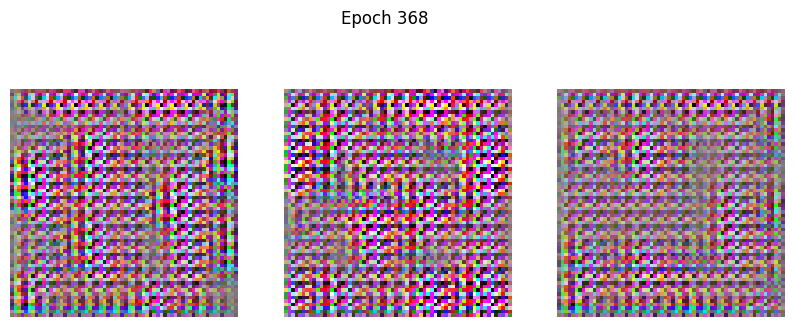

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.1336 - g_loss: 5.8605
Epoch 369/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.2383 - g_loss: 10.6448

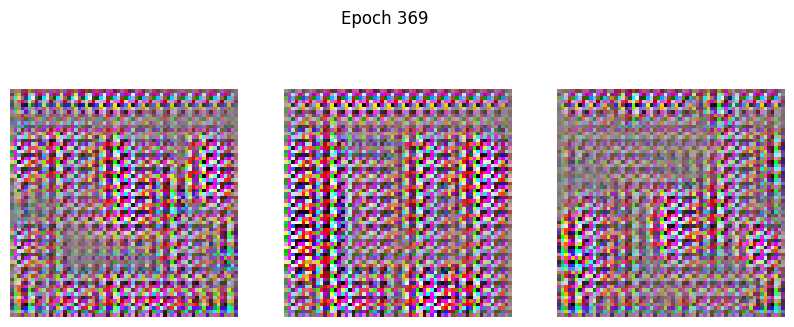

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.2332 - g_loss: 10.5417
Epoch 370/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - d_loss: 0.0646 - g_loss: 5.0702

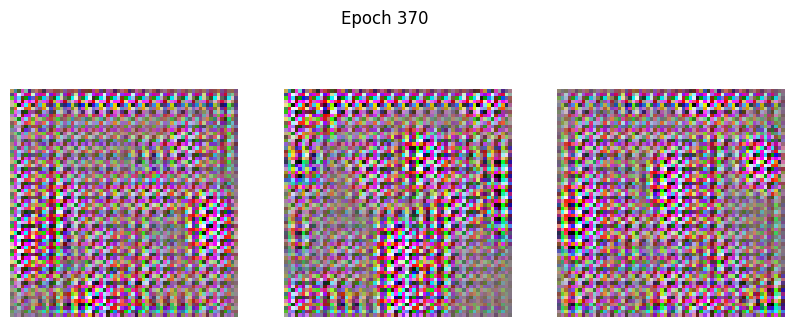

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.0657 - g_loss: 4.9755
Epoch 371/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.1745 - g_loss: 7.8686

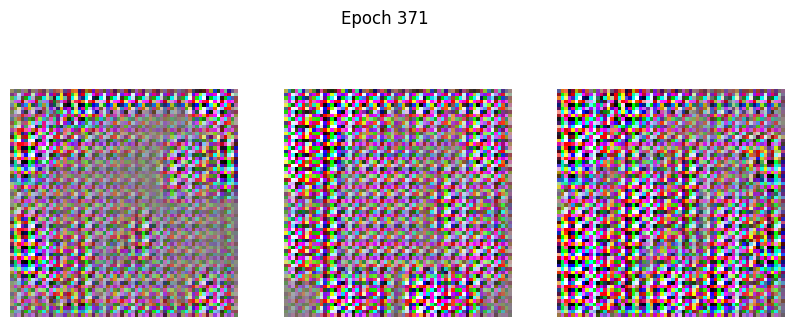

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1726 - g_loss: 7.6622
Epoch 372/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1607 - g_loss: 5.6348 

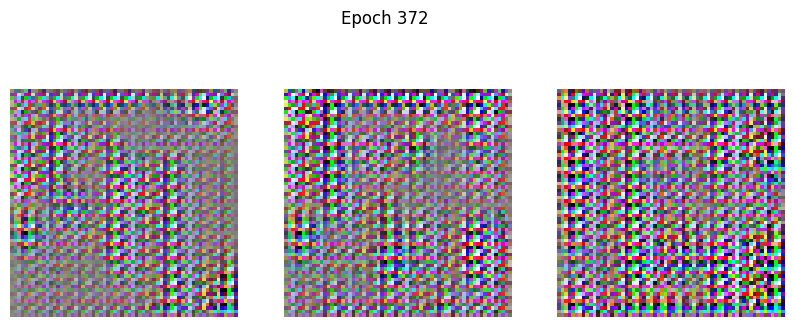

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1713 - g_loss: 6.0407
Epoch 373/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.1709 - g_loss: 5.4537

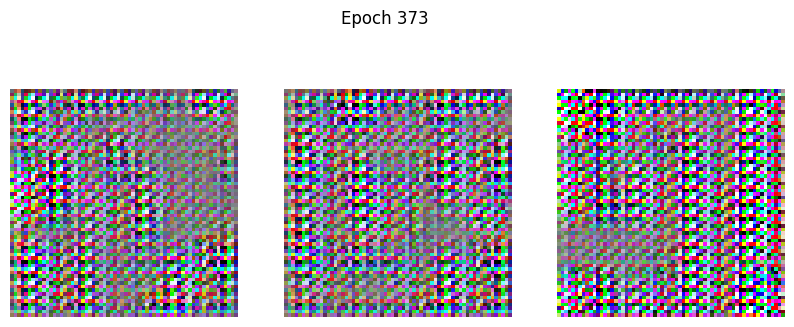

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step - d_loss: 0.1652 - g_loss: 5.1892
Epoch 374/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.2337 - g_loss: 9.6846 

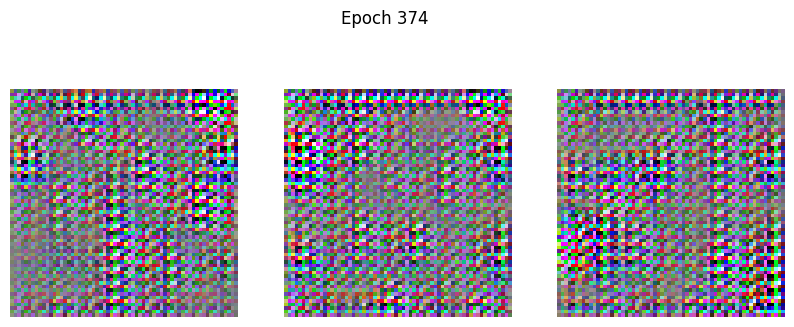

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step - d_loss: 0.2192 - g_loss: 9.6146
Epoch 375/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.0729 - g_loss: 4.6218

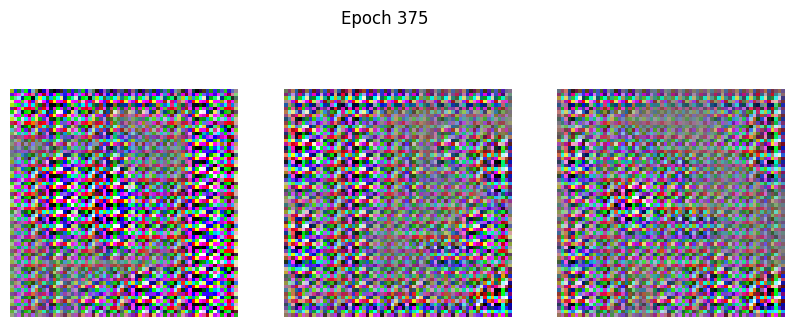

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 242ms/step - d_loss: 0.0750 - g_loss: 4.5265
Epoch 376/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.1261 - g_loss: 6.4574 

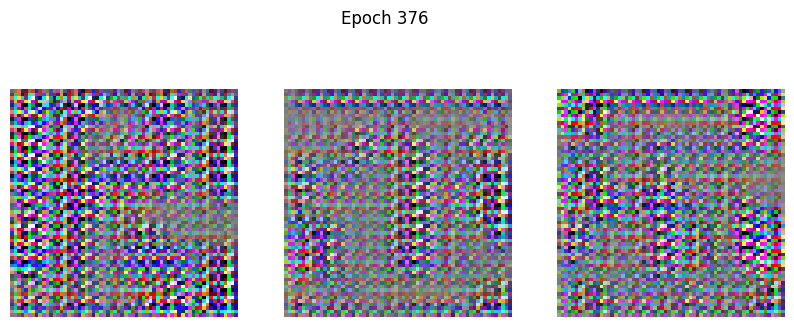

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.1180 - g_loss: 6.4003
Epoch 377/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1188 - g_loss: 4.8699 

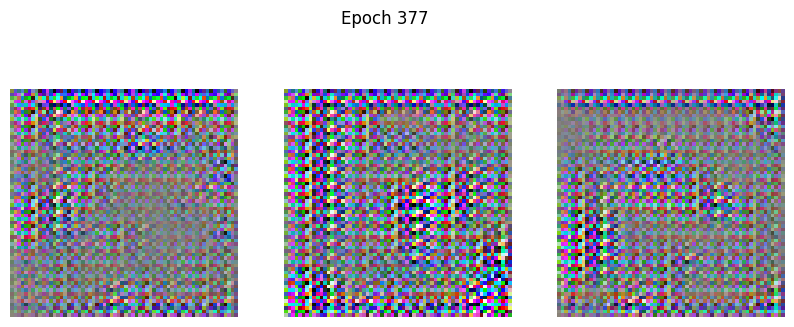

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1263 - g_loss: 5.1825
Epoch 378/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1519 - g_loss: 5.0707 

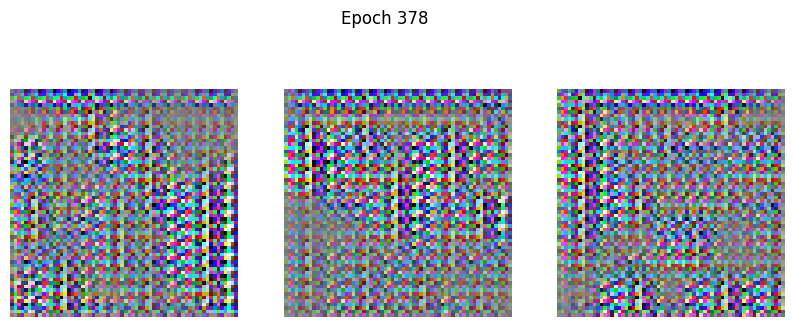

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 176ms/step - d_loss: 0.1462 - g_loss: 5.0102
Epoch 379/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1312 - g_loss: 6.1637 

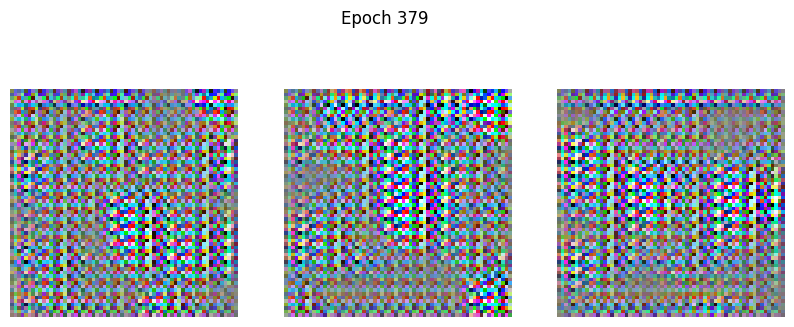

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1249 - g_loss: 6.0571
Epoch 380/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.0853 - g_loss: 4.9566

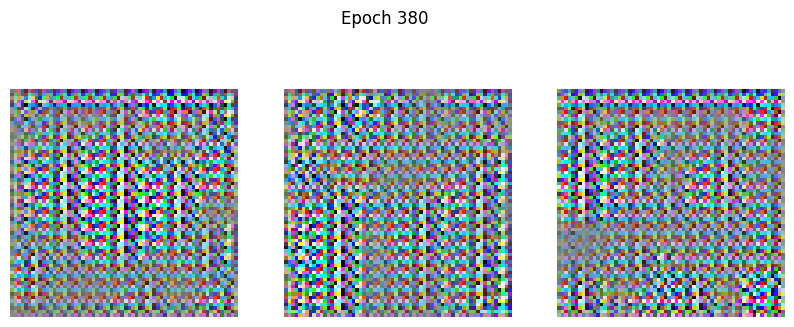

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.0904 - g_loss: 4.9733
Epoch 381/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1054 - g_loss: 5.5534 

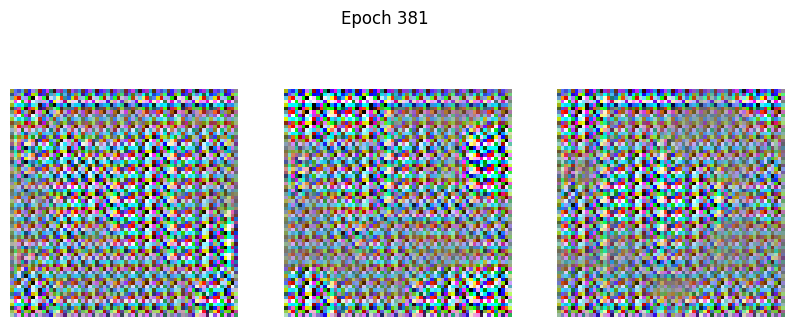

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1023 - g_loss: 5.7332
Epoch 382/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.0700 - g_loss: 5.4105

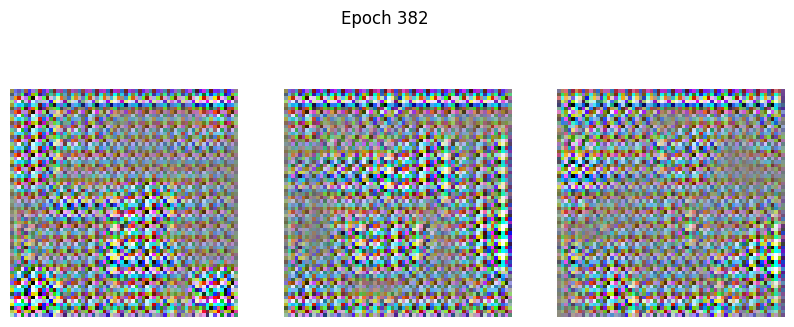

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0749 - g_loss: 5.4192
Epoch 383/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0655 - g_loss: 6.0568

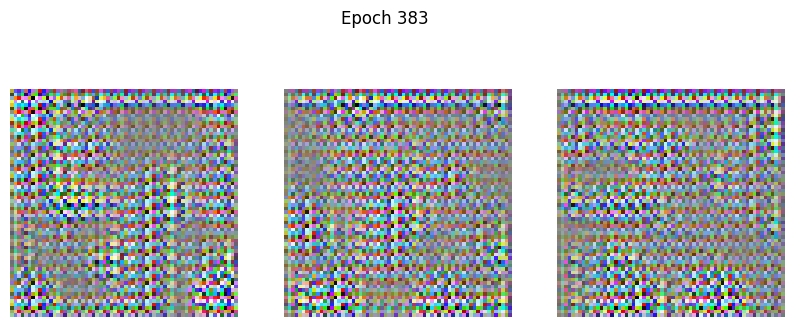

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - d_loss: 0.0690 - g_loss: 5.9033
Epoch 384/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1544 - g_loss: 9.5525  

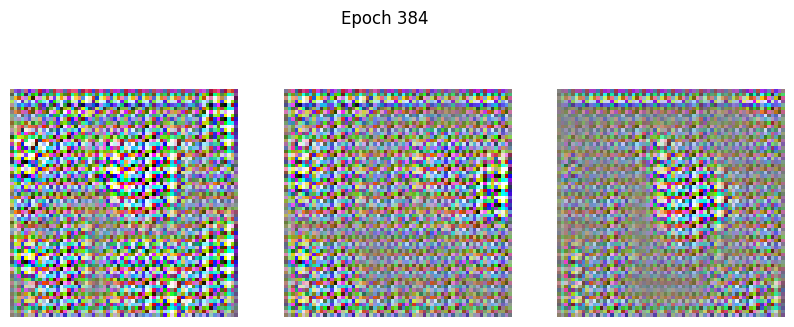

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 220ms/step - d_loss: 0.1494 - g_loss: 9.3185
Epoch 385/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1659 - g_loss: 6.7198 

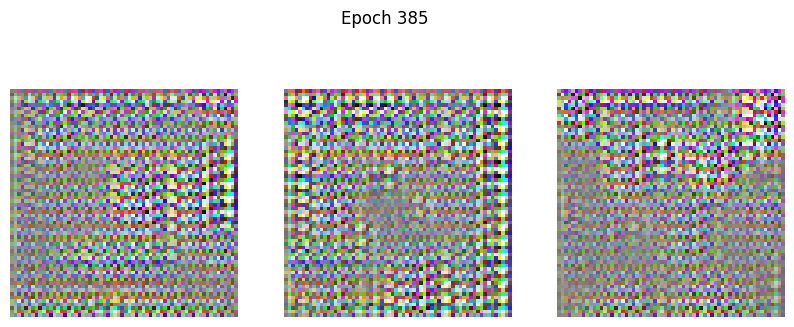

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 227ms/step - d_loss: 0.1866 - g_loss: 7.7087
Epoch 386/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.3897 - g_loss: 7.8828 

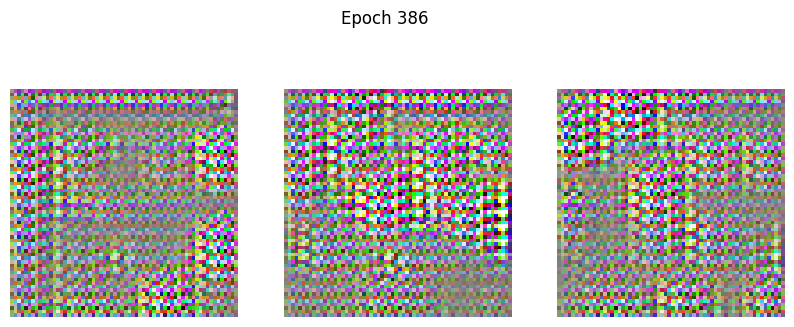

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step - d_loss: 0.3474 - g_loss: 7.3810
Epoch 387/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.2544 - g_loss: 12.1616 

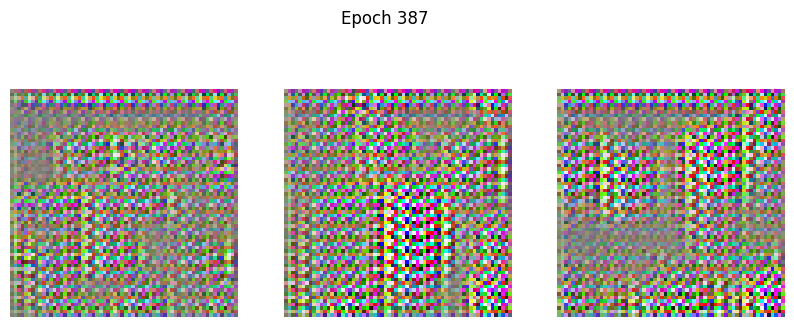

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 234ms/step - d_loss: 0.2302 - g_loss: 12.1728
Epoch 388/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0605 - g_loss: 6.7162 

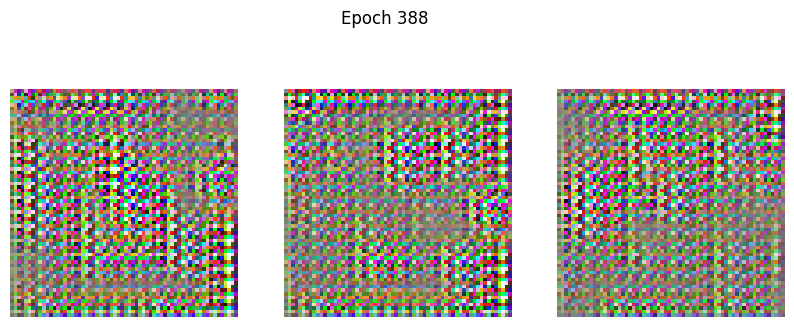

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 219ms/step - d_loss: 0.0573 - g_loss: 6.3773
Epoch 389/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.2842 - g_loss: 9.6428

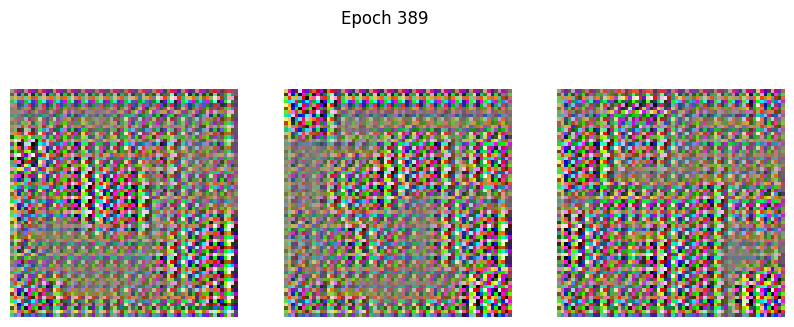

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - d_loss: 0.2741 - g_loss: 9.4729
Epoch 390/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1086 - g_loss: 4.7872 

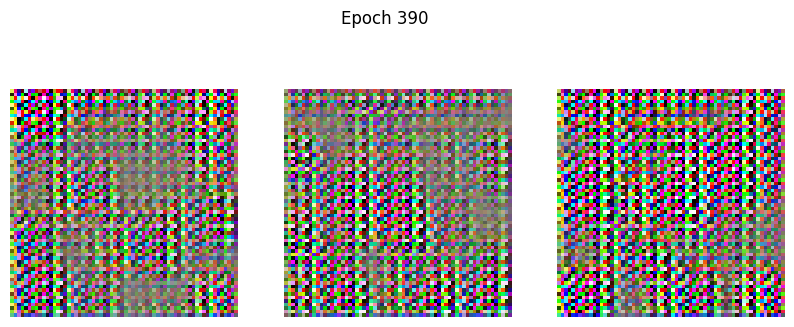

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - d_loss: 0.1152 - g_loss: 4.9660
Epoch 391/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.0640 - g_loss: 6.1635

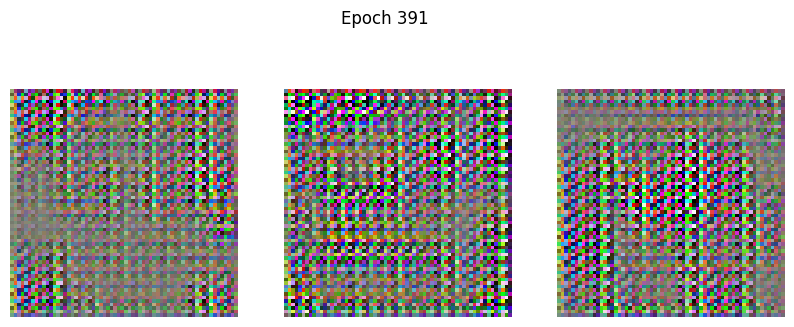

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - d_loss: 0.0662 - g_loss: 6.0178
Epoch 392/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - d_loss: 0.0985 - g_loss: 5.7565

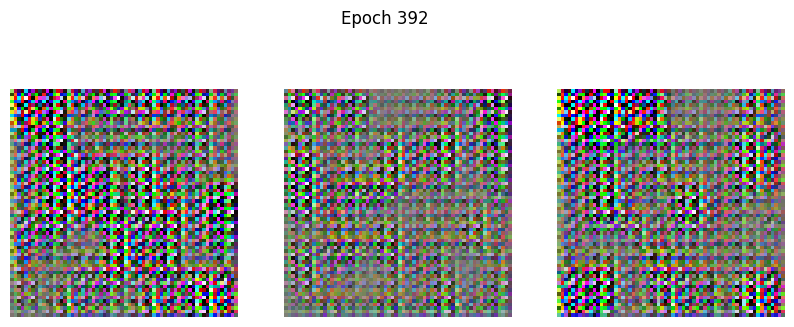

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step - d_loss: 0.0974 - g_loss: 5.7384
Epoch 393/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - d_loss: 0.0816 - g_loss: 5.3314 

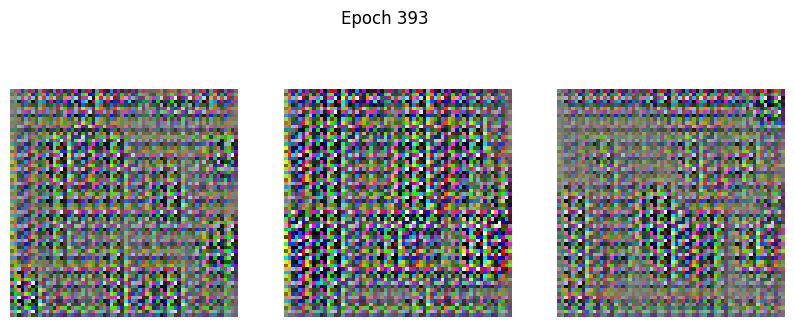

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - d_loss: 0.0817 - g_loss: 5.4477
Epoch 394/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0723 - g_loss: 5.9785 

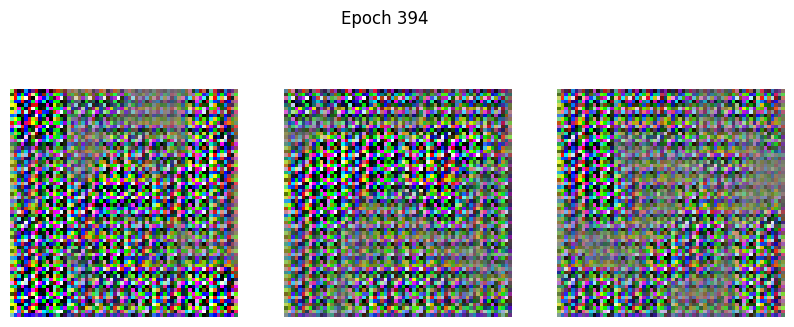

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.0737 - g_loss: 6.0718
Epoch 395/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0910 - g_loss: 6.2706

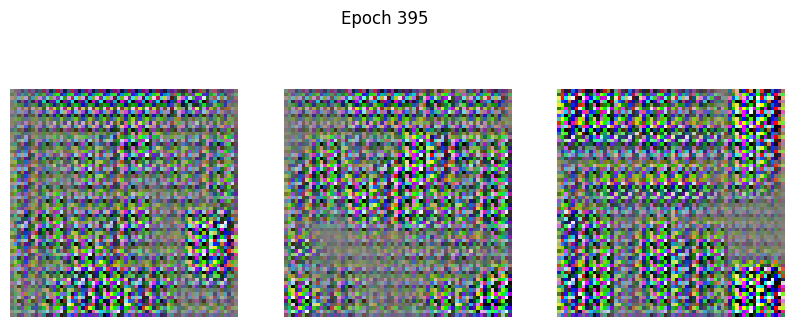

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.0948 - g_loss: 6.2279
Epoch 396/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - d_loss: 0.1090 - g_loss: 6.1438

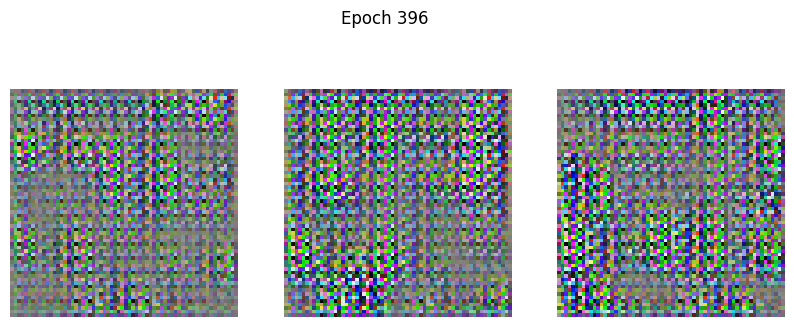

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1105 - g_loss: 5.9823
Epoch 397/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1571 - g_loss: 8.0239 

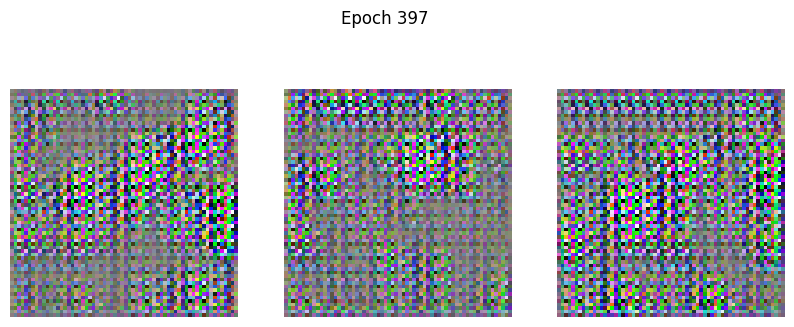

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.1493 - g_loss: 7.8189
Epoch 398/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1456 - g_loss: 6.6907 

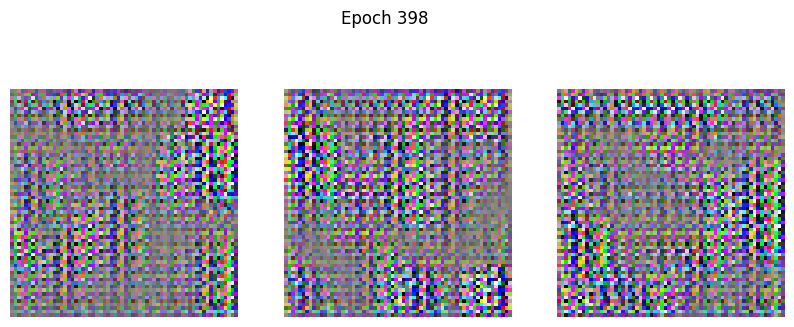

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1430 - g_loss: 6.7758
Epoch 399/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.1770 - g_loss: 6.3029

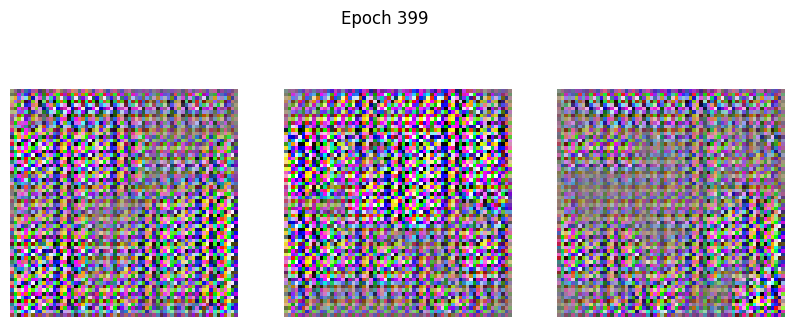

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1868 - g_loss: 6.4102
Epoch 400/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1481 - g_loss: 5.7206

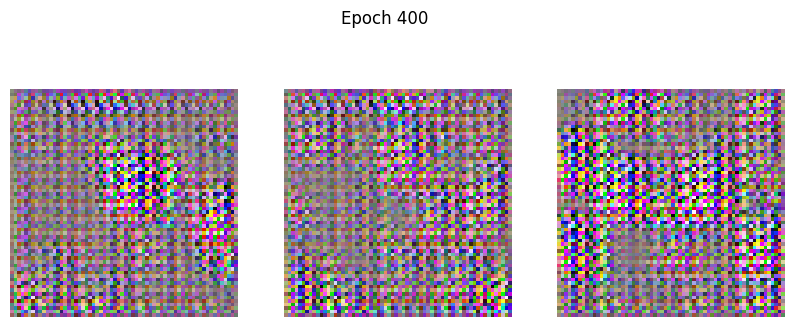

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1500 - g_loss: 5.7385
Epoch 401/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.0886 - g_loss: 6.0597

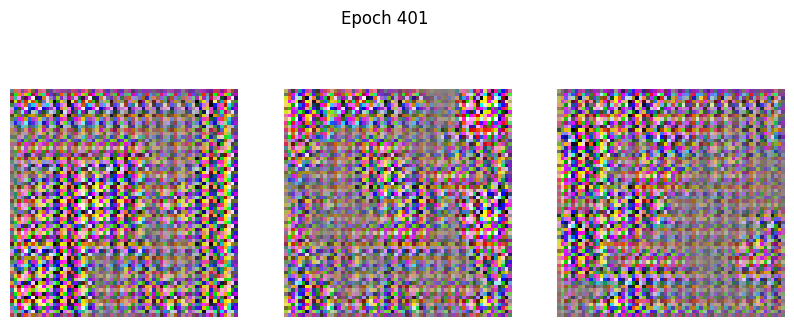

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0905 - g_loss: 5.9609
Epoch 402/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1415 - g_loss: 6.9209 

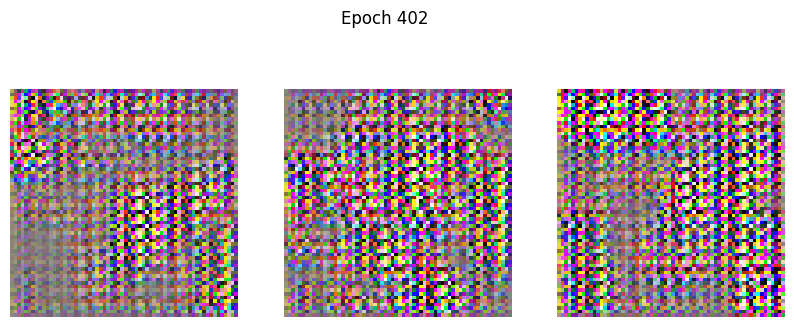

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.1368 - g_loss: 6.7151
Epoch 403/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1654 - g_loss: 5.8252

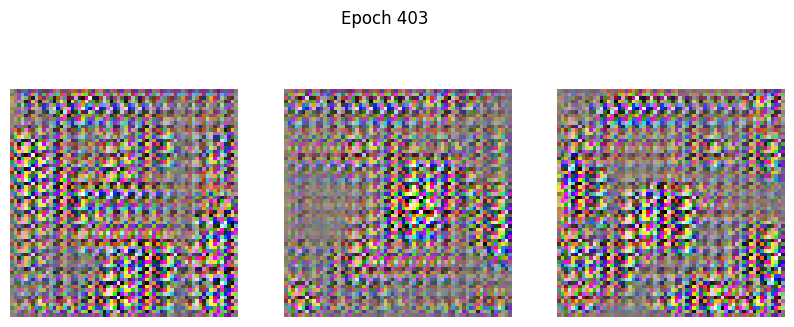

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1661 - g_loss: 5.6747
Epoch 404/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1907 - g_loss: 6.4154

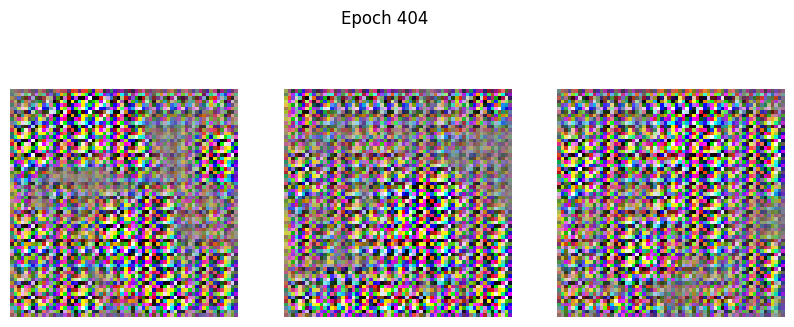

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.1922 - g_loss: 6.1322
Epoch 405/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1795 - g_loss: 6.6777

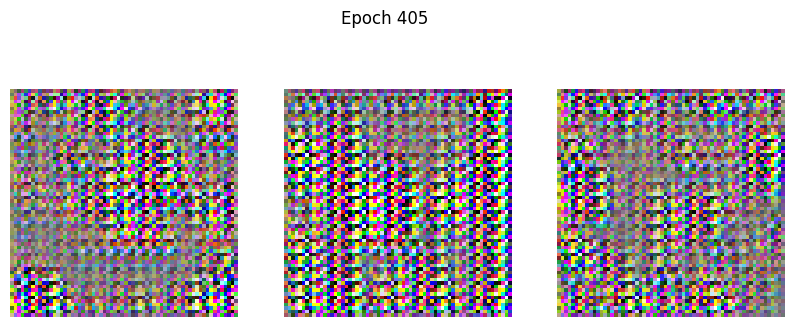

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1753 - g_loss: 6.4967
Epoch 406/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1178 - g_loss: 4.9129

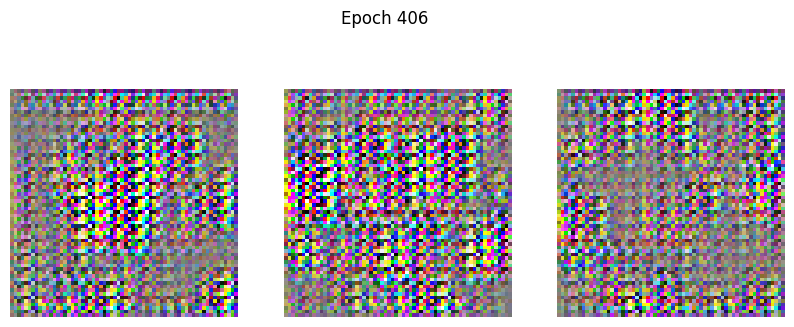

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1183 - g_loss: 4.8957
Epoch 407/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.1551 - g_loss: 4.7507

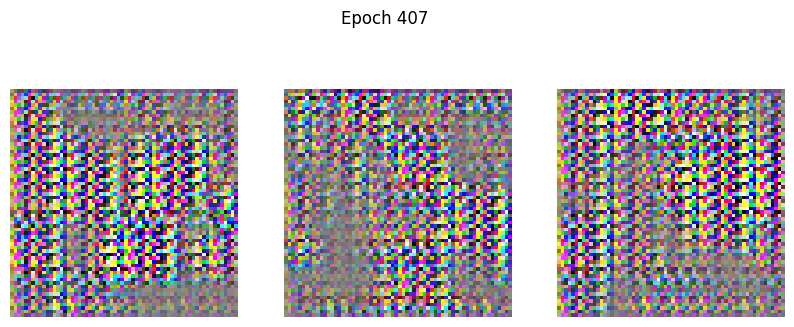

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1609 - g_loss: 4.5880
Epoch 408/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.2352 - g_loss: 5.4331 

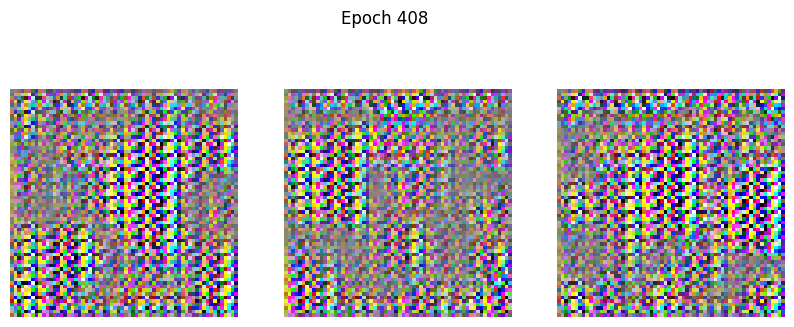

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.2275 - g_loss: 5.2718
Epoch 409/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1741 - g_loss: 4.2427 

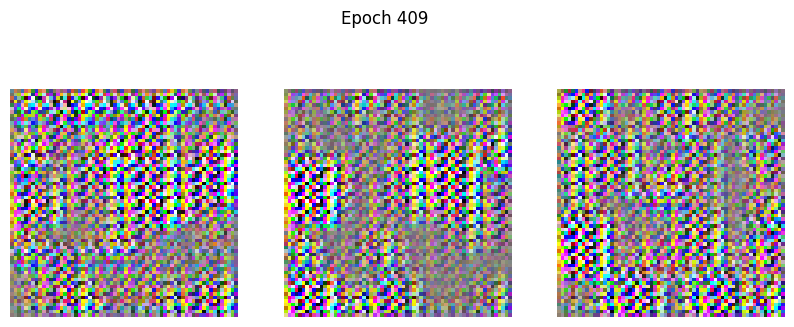

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1678 - g_loss: 4.3125
Epoch 410/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1198 - g_loss: 4.0238

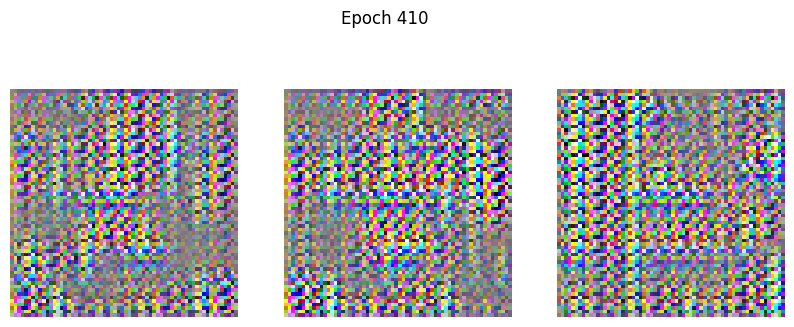

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1231 - g_loss: 3.9360
Epoch 411/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1556 - g_loss: 5.8461 

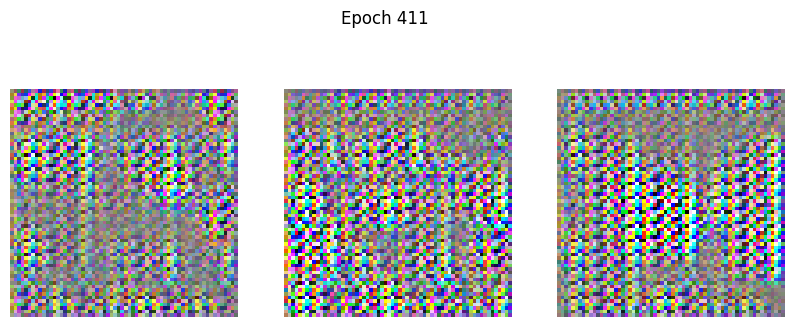

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1479 - g_loss: 5.7877
Epoch 412/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1311 - g_loss: 3.9895 

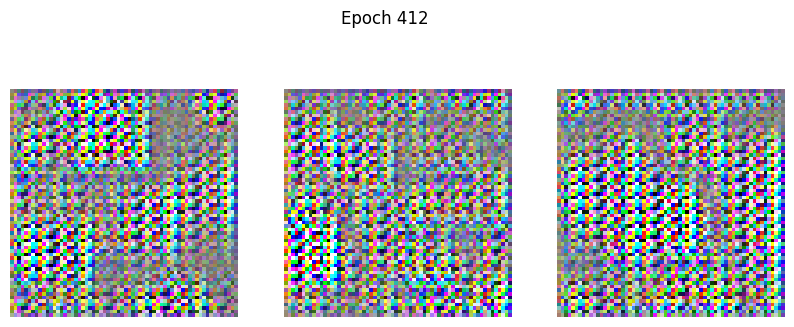

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1360 - g_loss: 4.3152
Epoch 413/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0958 - g_loss: 5.4190

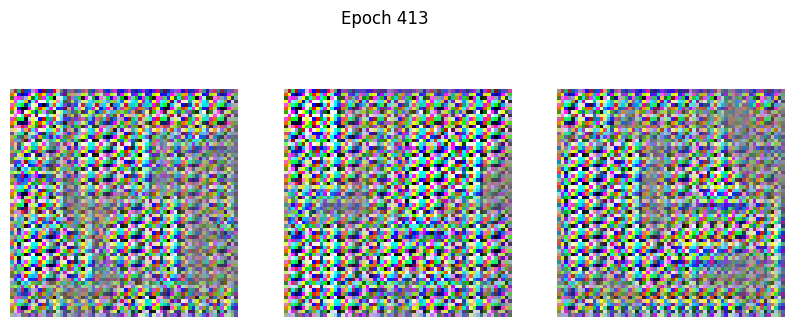

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0986 - g_loss: 5.1541
Epoch 414/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.2223 - g_loss: 9.2256 

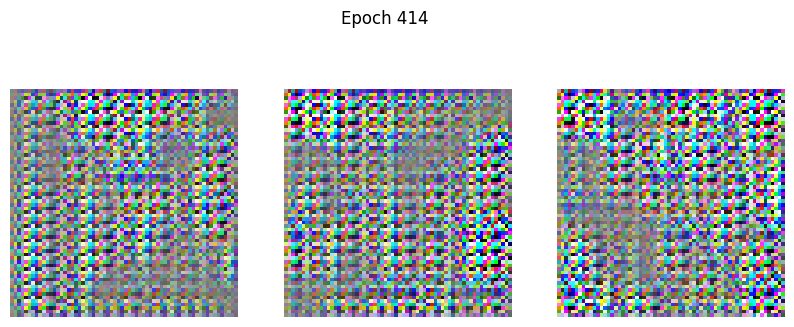

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.2111 - g_loss: 9.1325
Epoch 415/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.0978 - g_loss: 4.4304

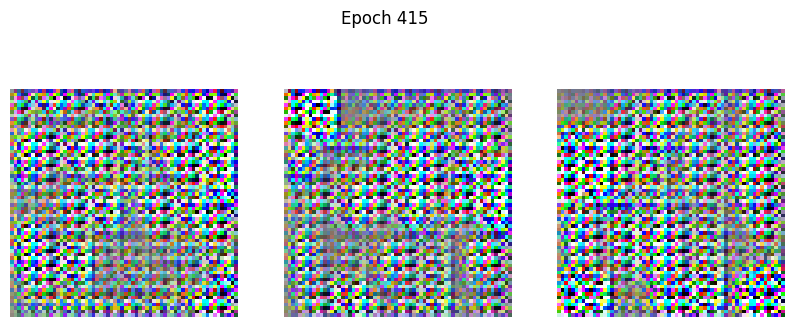

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.0973 - g_loss: 4.4043
Epoch 416/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1237 - g_loss: 7.0313

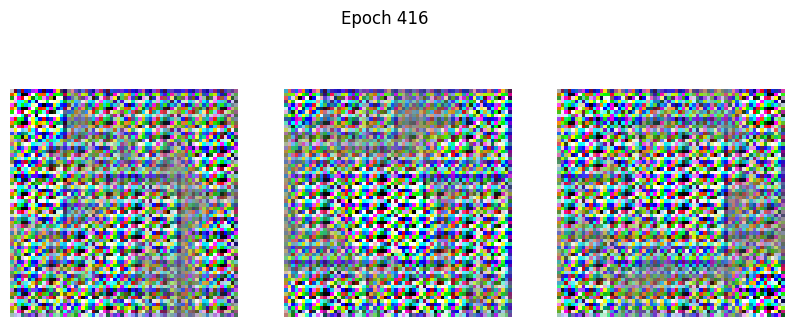

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.1269 - g_loss: 6.7732
Epoch 417/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1021 - g_loss: 5.5574 

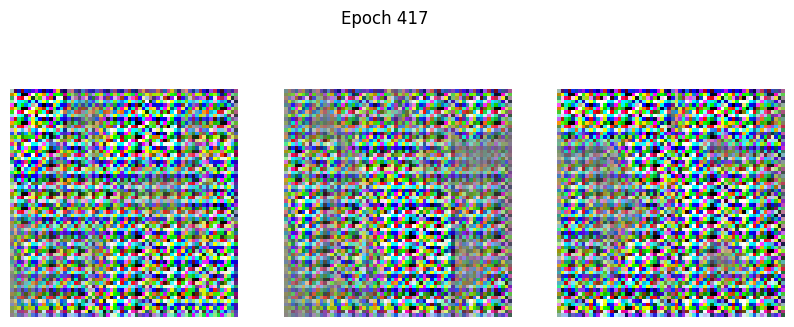

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0972 - g_loss: 5.6362
Epoch 418/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.0915 - g_loss: 5.0966 

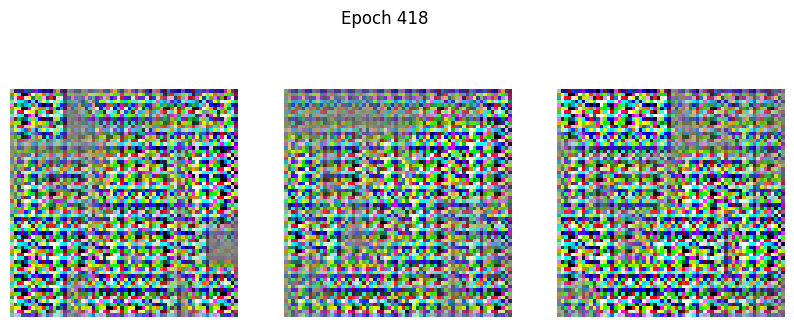

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step - d_loss: 0.0934 - g_loss: 5.3656
Epoch 419/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1122 - g_loss: 5.2457 

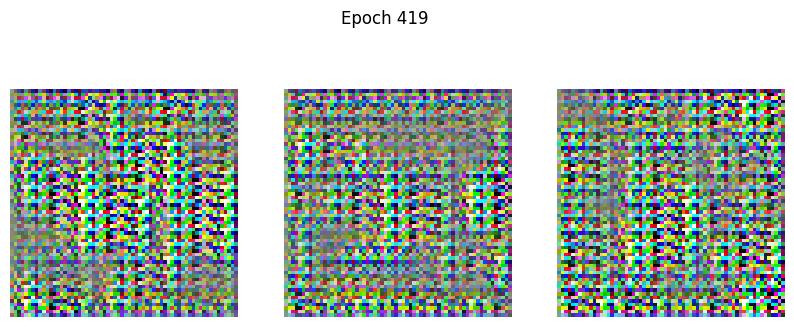

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1096 - g_loss: 5.4219
Epoch 420/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.0956 - g_loss: 5.4682 

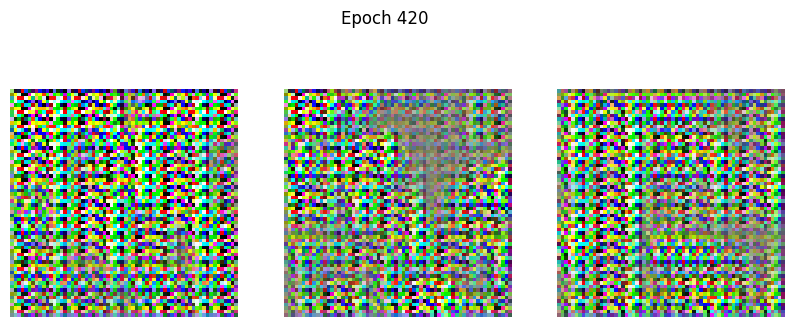

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.0962 - g_loss: 5.6585
Epoch 421/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.0821 - g_loss: 5.3585

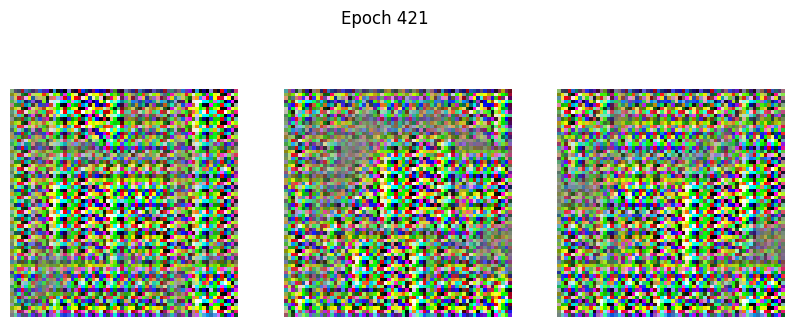

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.0905 - g_loss: 5.2958
Epoch 422/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.2063 - g_loss: 6.8020

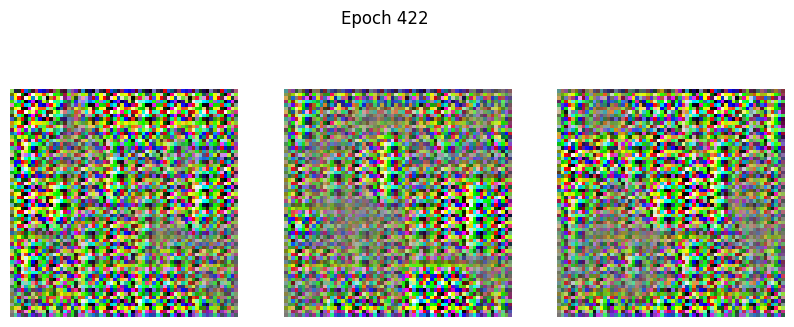

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.2234 - g_loss: 6.2113
Epoch 423/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.8483 - g_loss: 16.5027 

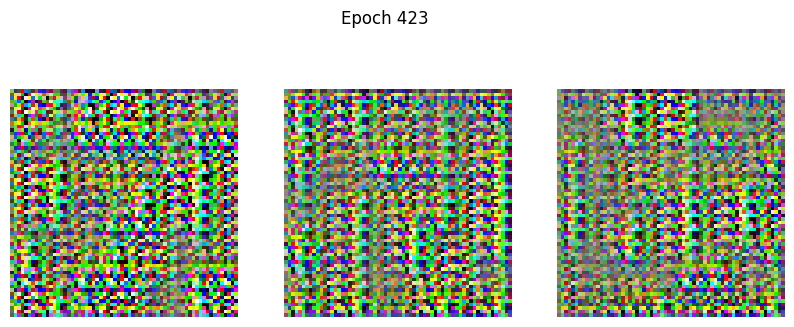

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step - d_loss: 0.8391 - g_loss: 15.9692
Epoch 424/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0687 - g_loss: 5.0961 

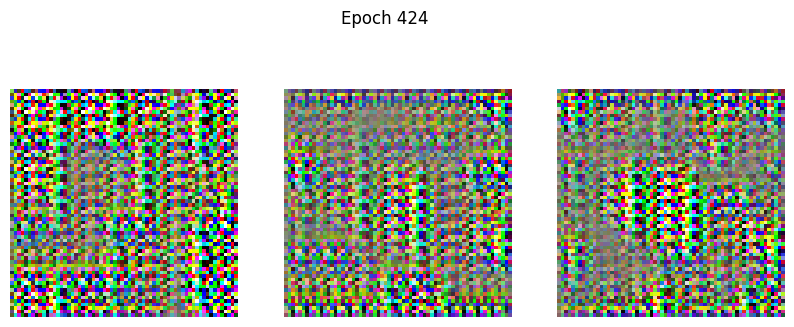

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.0672 - g_loss: 5.0173
Epoch 425/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0826 - g_loss: 7.3654

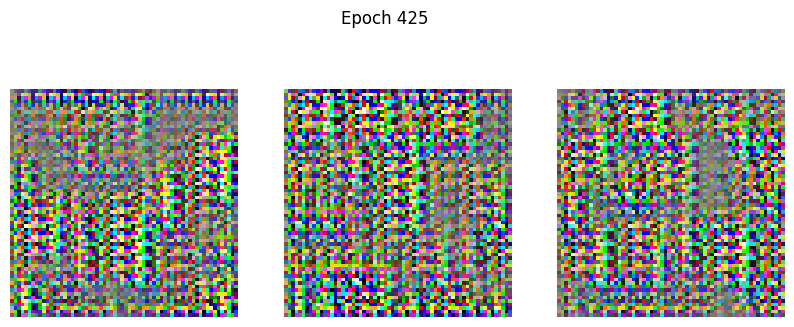

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0761 - g_loss: 7.2992
Epoch 426/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0559 - g_loss: 5.1274

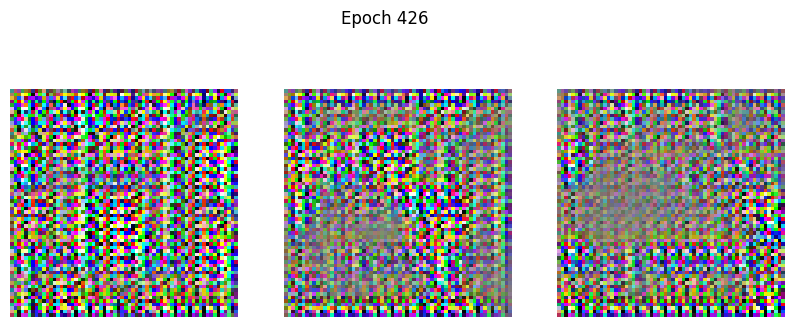

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.0662 - g_loss: 5.2539
Epoch 427/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1765 - g_loss: 4.8316 

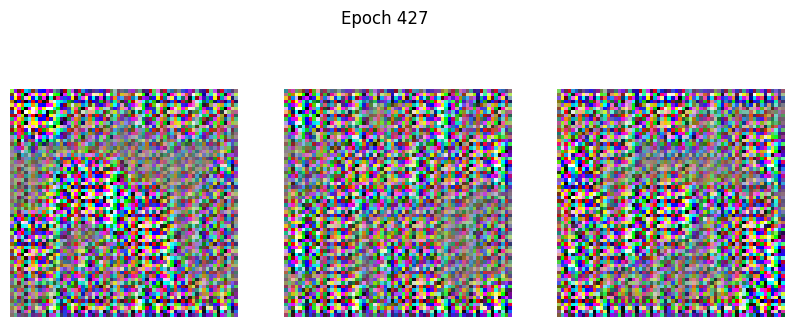

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - d_loss: 0.1819 - g_loss: 5.0731
Epoch 428/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.2721 - g_loss: 4.6516

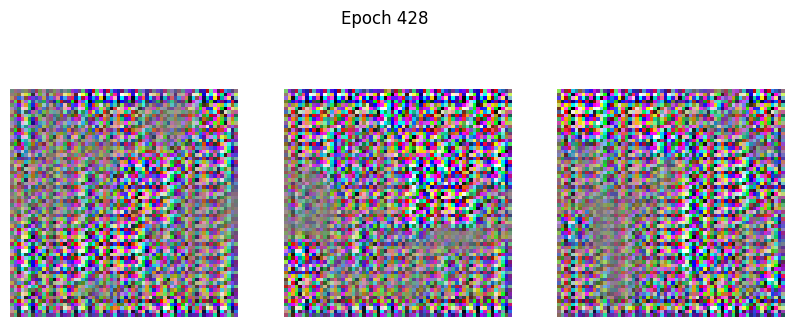

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step - d_loss: 0.2814 - g_loss: 5.0075
Epoch 429/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.2176 - g_loss: 4.6881

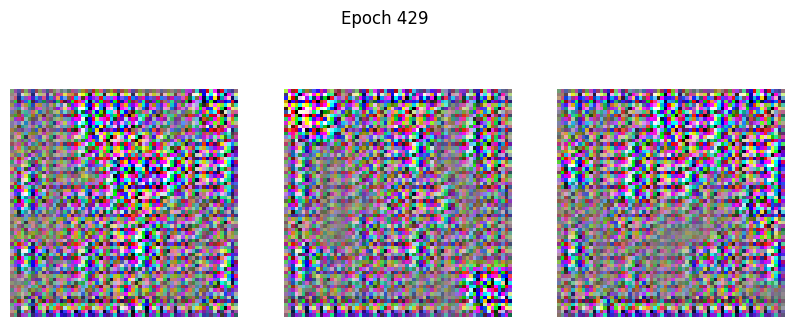

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step - d_loss: 0.2183 - g_loss: 4.7513
Epoch 430/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1603 - g_loss: 5.2920 

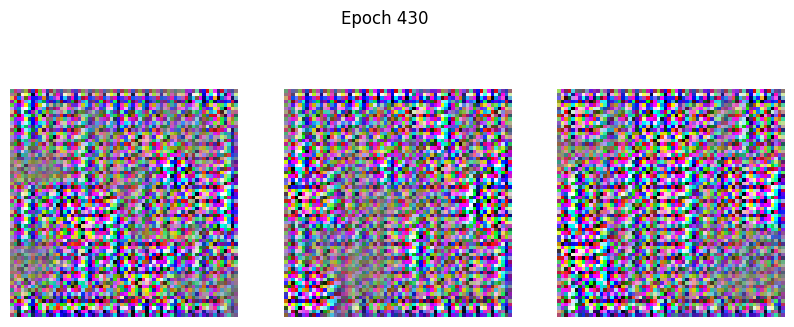

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 217ms/step - d_loss: 0.1586 - g_loss: 5.3851
Epoch 431/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.2126 - g_loss: 4.6516 

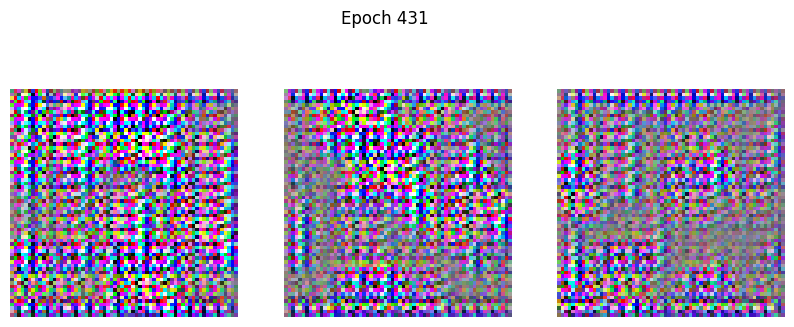

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - d_loss: 0.2199 - g_loss: 5.0620
Epoch 432/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.2058 - g_loss: 4.8737 

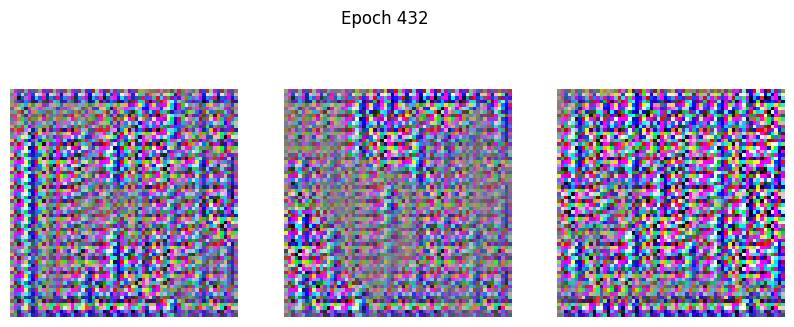

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - d_loss: 0.1882 - g_loss: 4.7153
Epoch 433/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1208 - g_loss: 6.3260

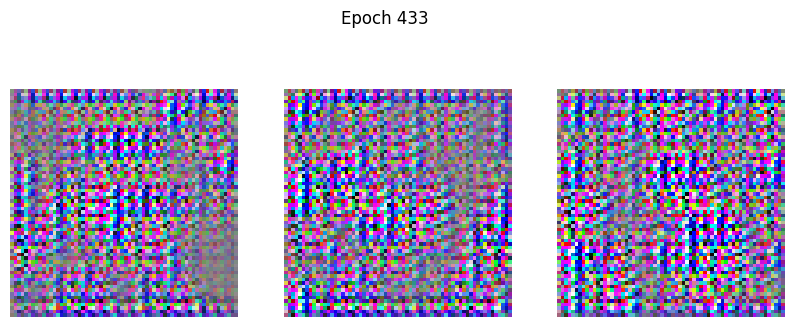

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step - d_loss: 0.1145 - g_loss: 6.2809
Epoch 434/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0735 - g_loss: 4.4293

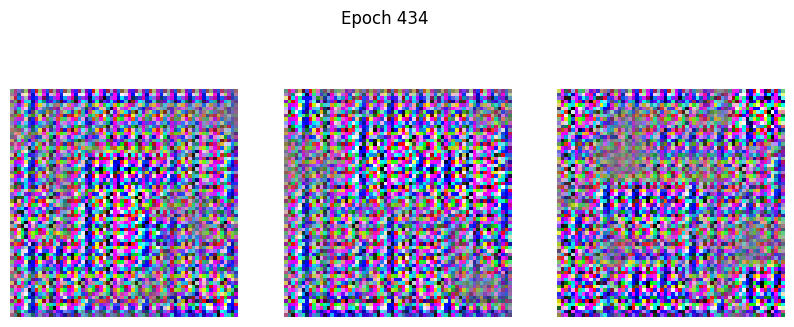

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 239ms/step - d_loss: 0.0786 - g_loss: 4.5490
Epoch 435/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.0801 - g_loss: 5.0140

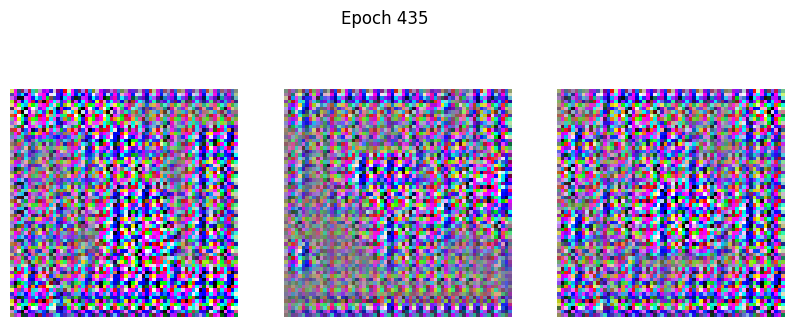

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0832 - g_loss: 4.8980
Epoch 436/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1431 - g_loss: 5.9131 

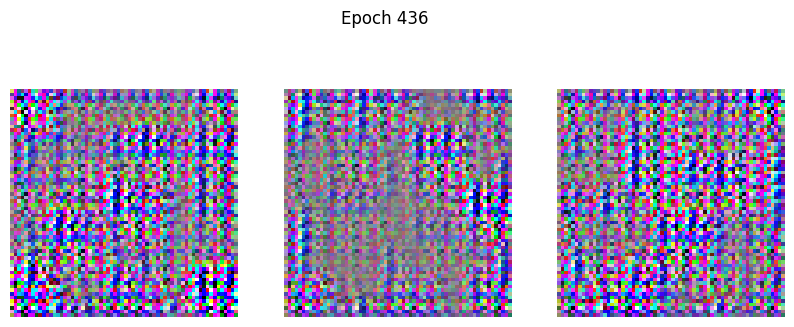

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1377 - g_loss: 5.8211
Epoch 437/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1591 - g_loss: 4.7400 

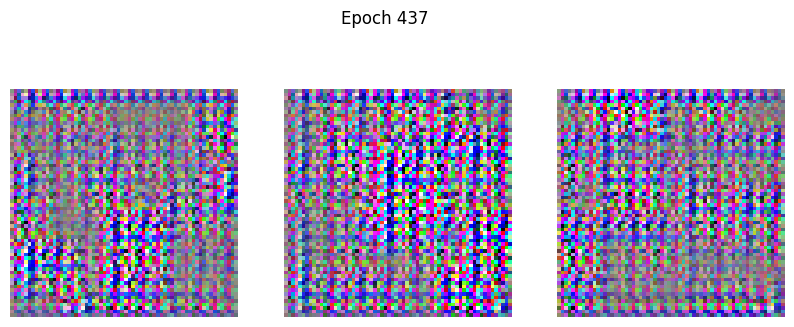

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1658 - g_loss: 5.1408
Epoch 438/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1984 - g_loss: 4.9046

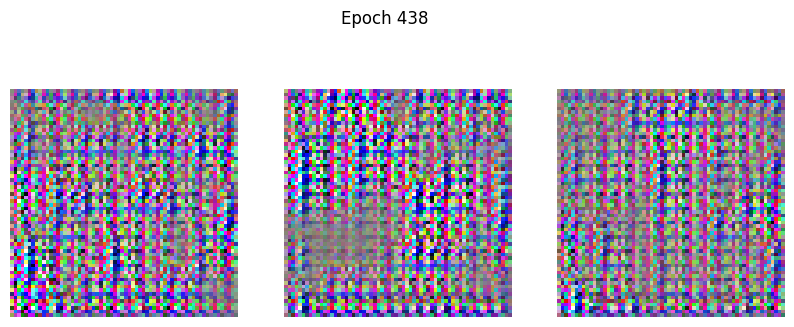

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step - d_loss: 0.1961 - g_loss: 4.8889
Epoch 439/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.1588 - g_loss: 6.0460

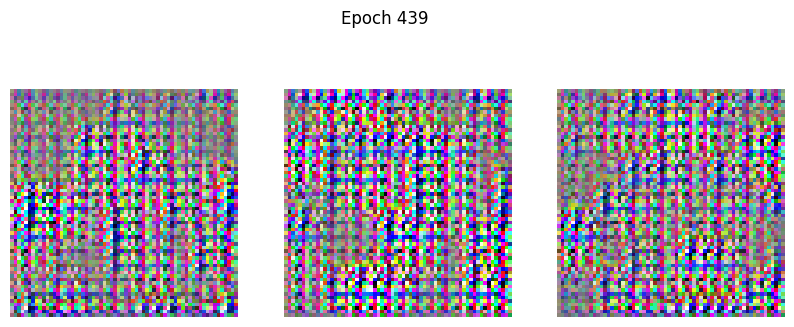

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 229ms/step - d_loss: 0.1658 - g_loss: 5.7638
Epoch 440/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.3713 - g_loss: 8.6228

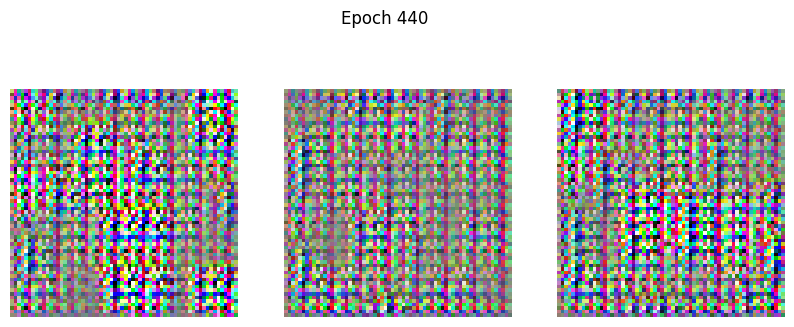

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.3796 - g_loss: 8.1387
Epoch 441/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1757 - g_loss: 6.9815 

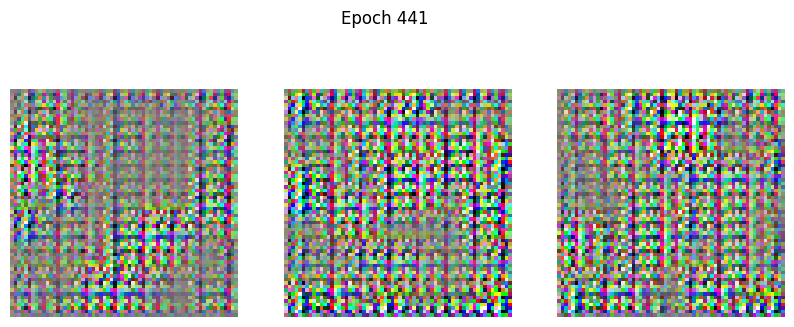

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1603 - g_loss: 6.9315
Epoch 442/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1108 - g_loss: 5.6032 

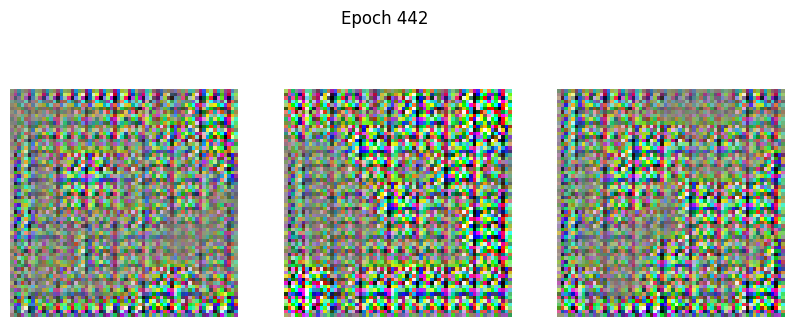

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1223 - g_loss: 5.9515
Epoch 443/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.3196 - g_loss: 5.8273 

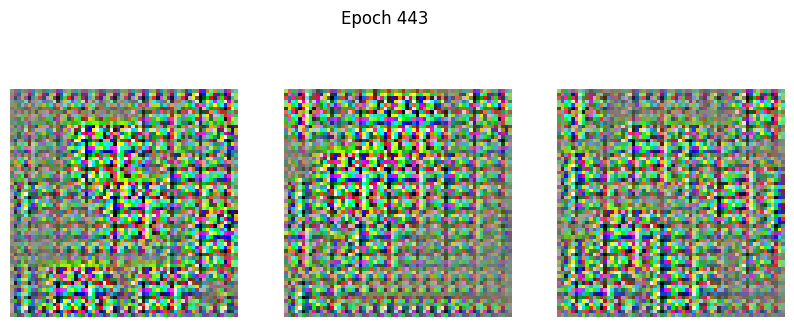

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.3278 - g_loss: 6.5258
Epoch 444/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.3685 - g_loss: 6.0157 

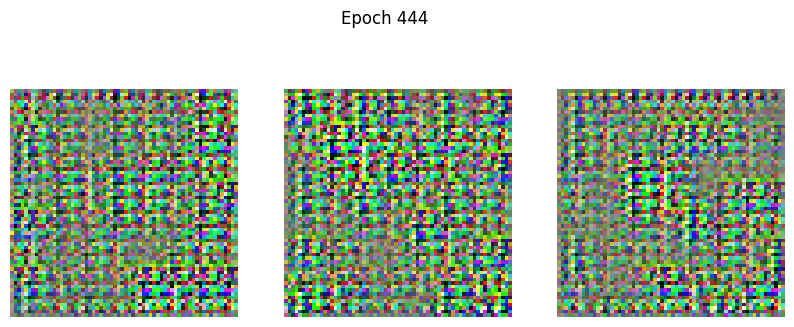

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - d_loss: 0.3428 - g_loss: 5.9759
Epoch 445/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1511 - g_loss: 8.4993 

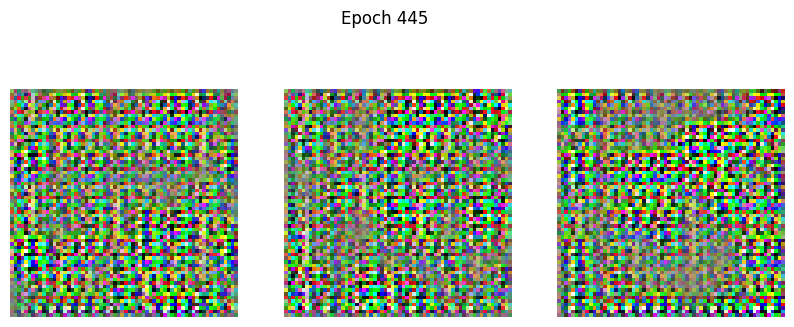

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step - d_loss: 0.1462 - g_loss: 8.2813
Epoch 446/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1807 - g_loss: 6.0723

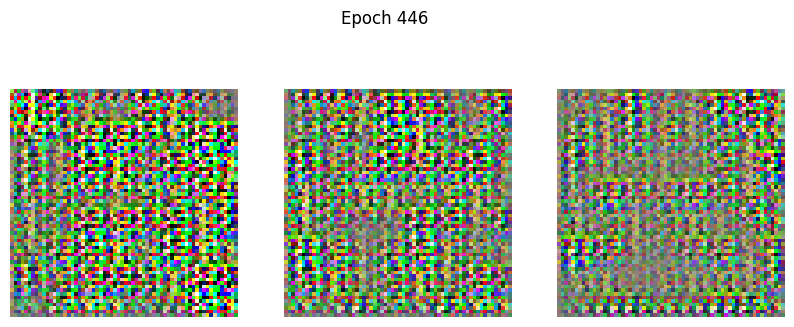

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - d_loss: 0.1953 - g_loss: 6.3194
Epoch 447/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.2091 - g_loss: 5.8098

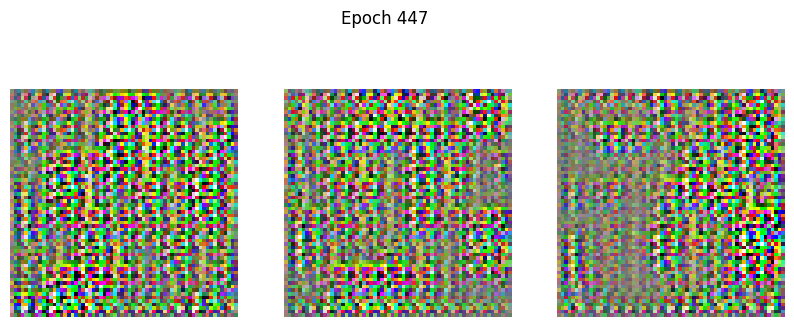

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.2153 - g_loss: 6.1468
Epoch 448/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1640 - g_loss: 5.6457 

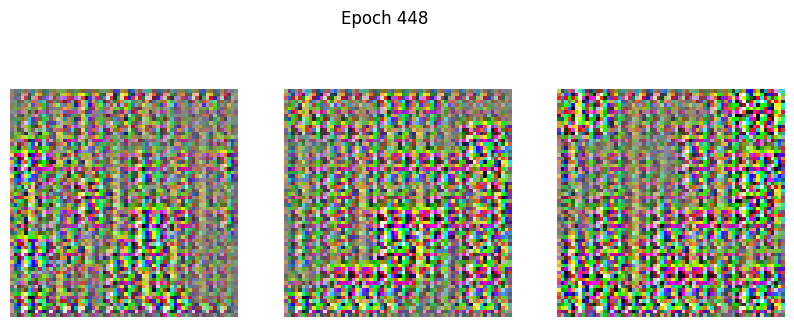

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1534 - g_loss: 5.6199
Epoch 449/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0828 - g_loss: 6.7342

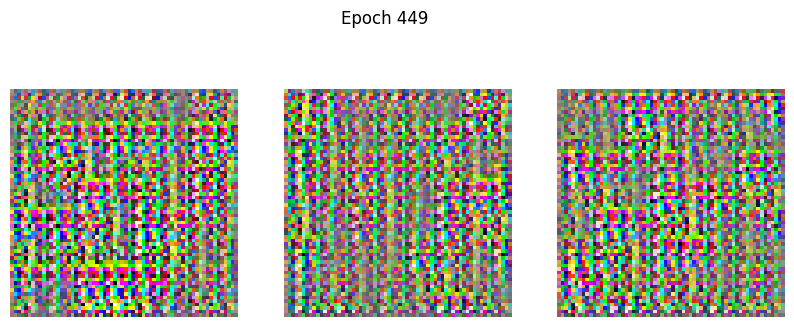

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0829 - g_loss: 6.6064
Epoch 450/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1072 - g_loss: 6.8437 

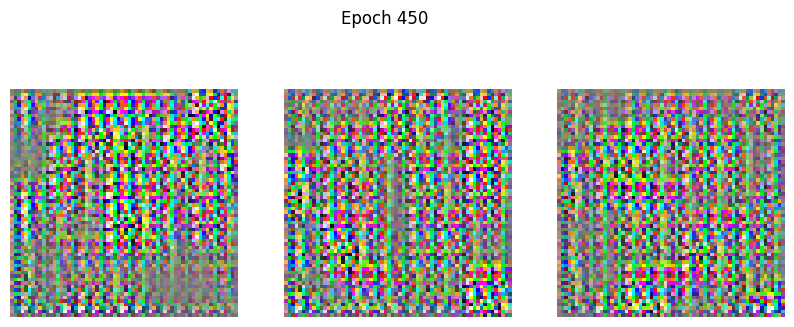

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - d_loss: 0.1021 - g_loss: 6.7852
Epoch 451/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1342 - g_loss: 7.1681 

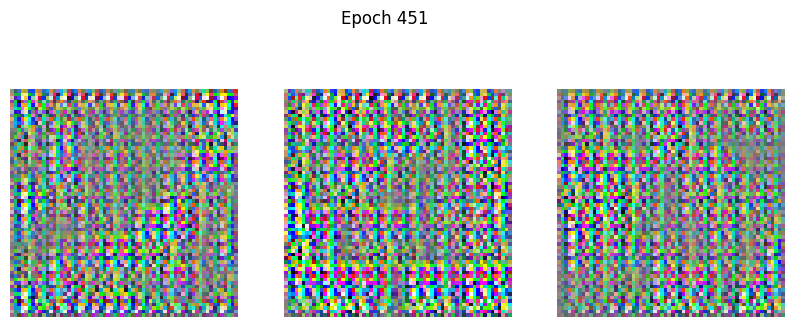

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1320 - g_loss: 7.3255
Epoch 452/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1413 - g_loss: 6.8637

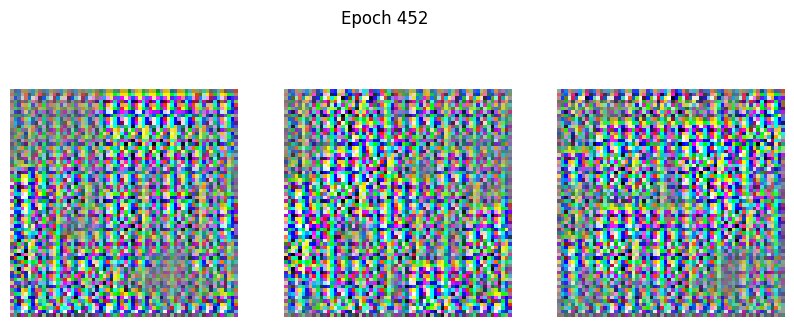

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1533 - g_loss: 7.3610
Epoch 453/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1326 - g_loss: 7.0768

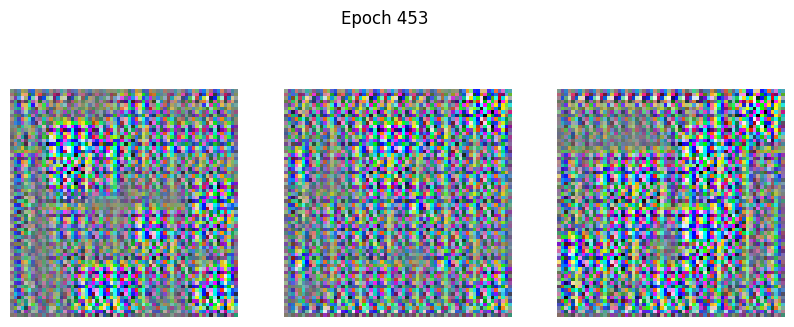

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.1303 - g_loss: 6.6965
Epoch 454/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.5751 - g_loss: 17.3840

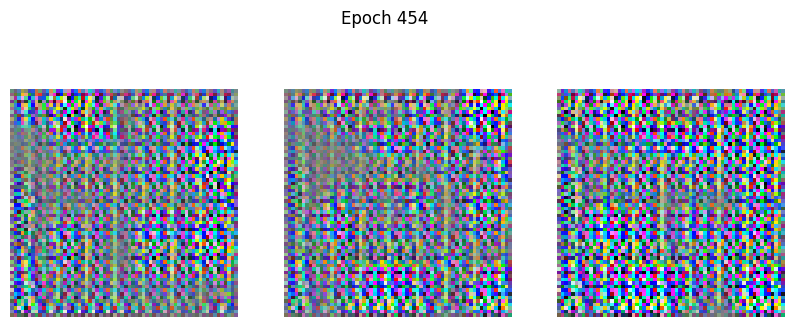

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.5940 - g_loss: 16.8436
Epoch 455/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - d_loss: 0.0978 - g_loss: 5.8277

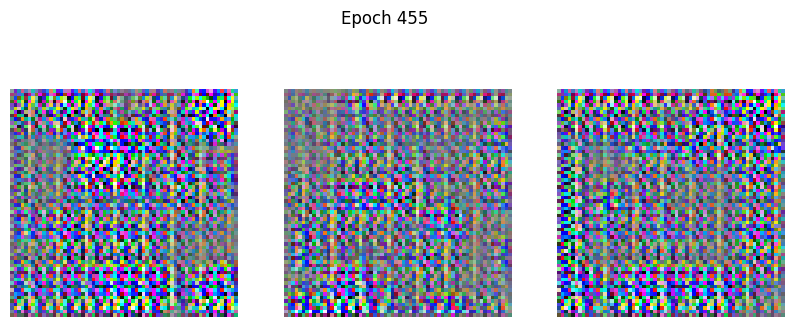

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.1153 - g_loss: 6.0715
Epoch 456/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0399 - g_loss: 6.5925

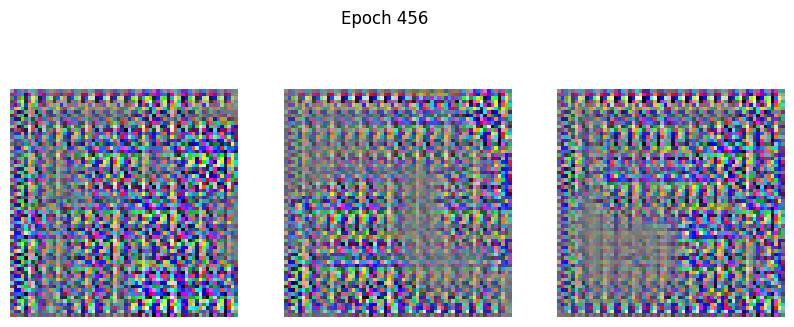

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0422 - g_loss: 6.4049
Epoch 457/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1372 - g_loss: 5.3607 

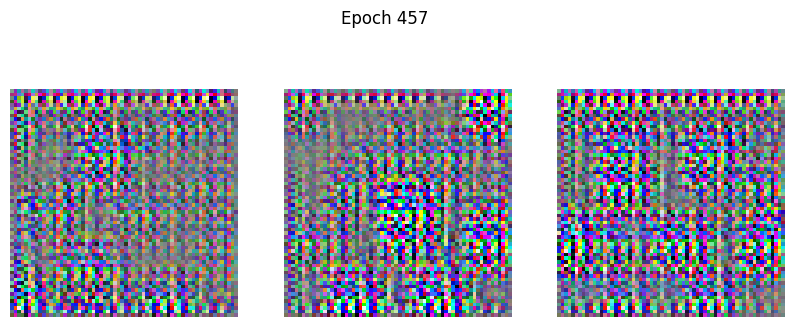

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1351 - g_loss: 5.3691
Epoch 458/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1863 - g_loss: 4.2981 

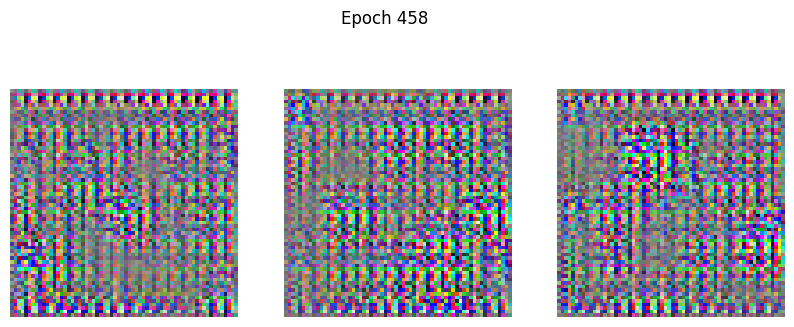

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.1867 - g_loss: 4.3700
Epoch 459/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1923 - g_loss: 4.7480 

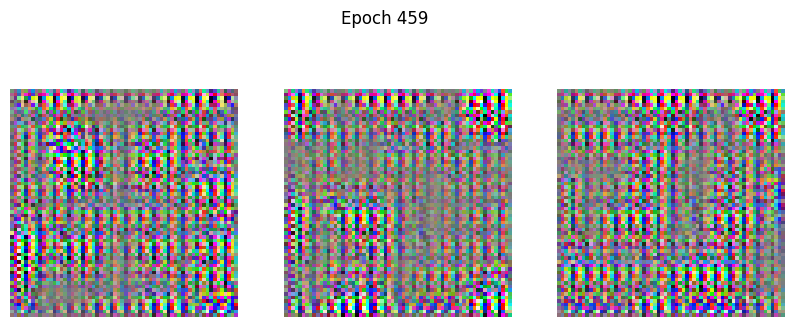

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 177ms/step - d_loss: 0.1868 - g_loss: 4.7569
Epoch 460/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1489 - g_loss: 4.2337 

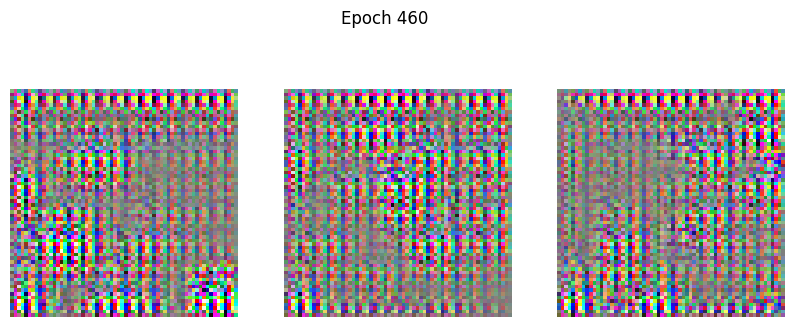

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1440 - g_loss: 4.2610
Epoch 461/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0961 - g_loss: 4.6369 

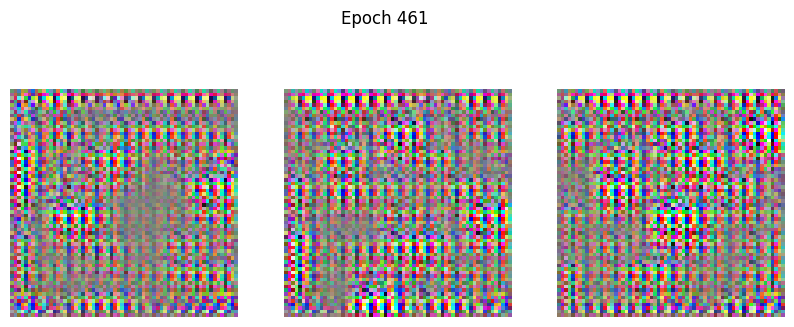

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.0931 - g_loss: 4.6116
Epoch 462/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.0652 - g_loss: 4.4066

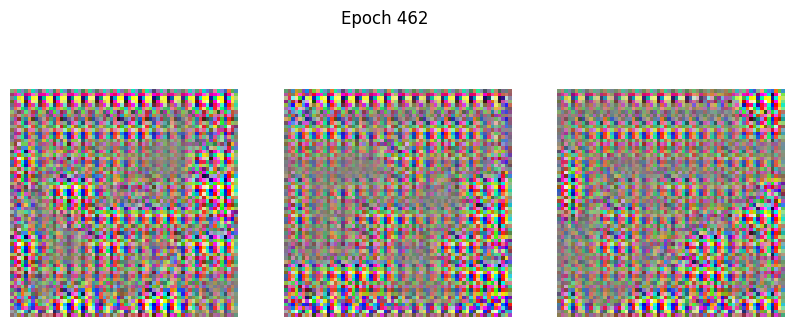

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0665 - g_loss: 4.3900
Epoch 463/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0668 - g_loss: 4.3686

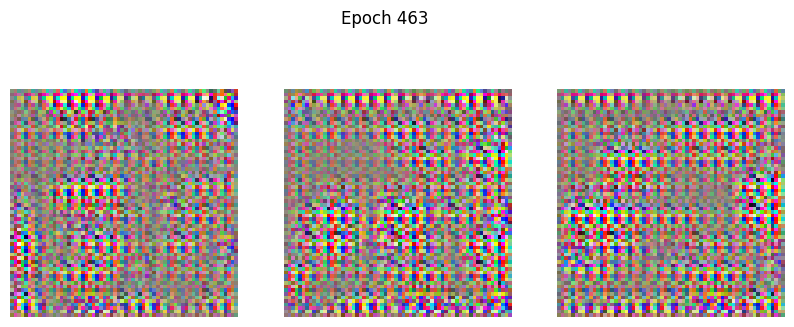

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0686 - g_loss: 4.3918
Epoch 464/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0697 - g_loss: 4.4653 

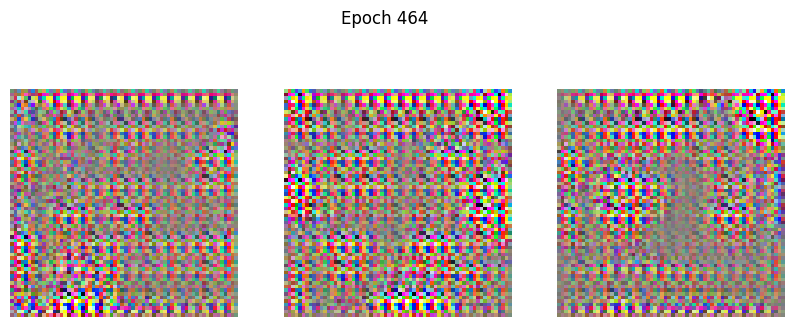

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.0670 - g_loss: 4.4619
Epoch 465/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - d_loss: 0.0636 - g_loss: 4.5399

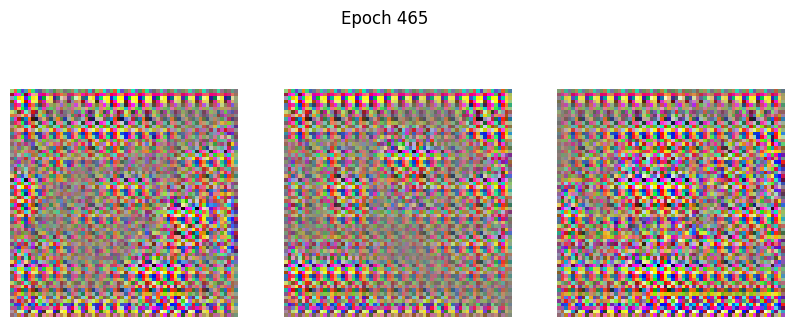

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step - d_loss: 0.0647 - g_loss: 4.5100
Epoch 466/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - d_loss: 0.0824 - g_loss: 4.7367 

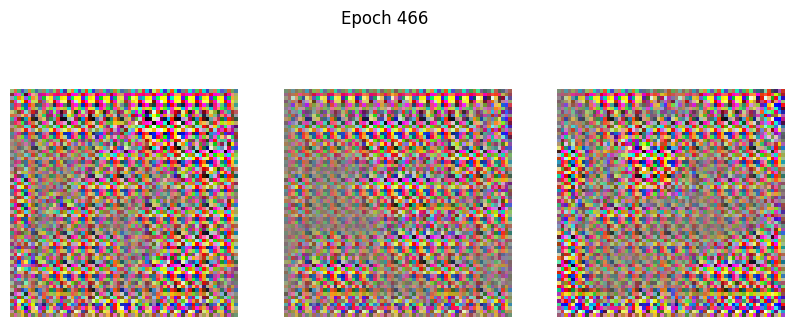

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.0816 - g_loss: 4.7661
Epoch 467/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0867 - g_loss: 4.8667 

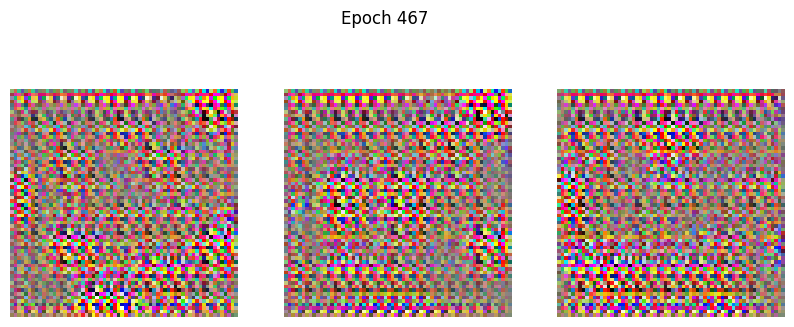

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step - d_loss: 0.0862 - g_loss: 4.8640
Epoch 468/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.0953 - g_loss: 4.9471

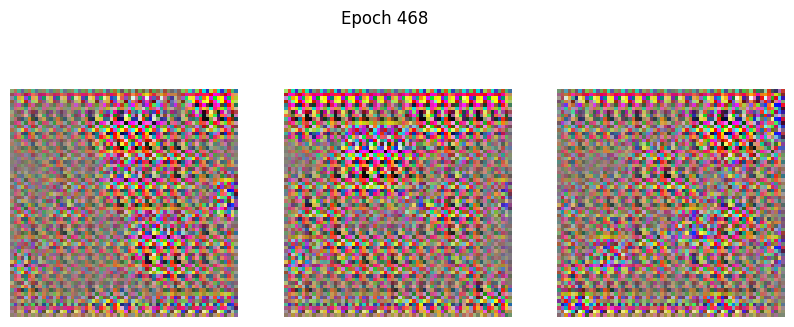

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step - d_loss: 0.0977 - g_loss: 4.8708
Epoch 469/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - d_loss: 0.1075 - g_loss: 4.8073

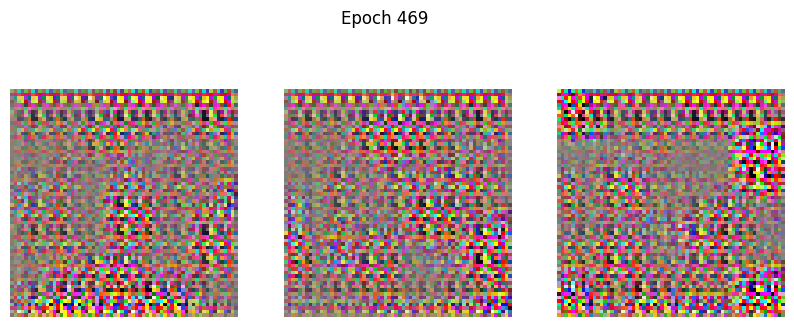

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 292ms/step - d_loss: 0.1085 - g_loss: 4.7800
Epoch 470/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0989 - g_loss: 4.7629

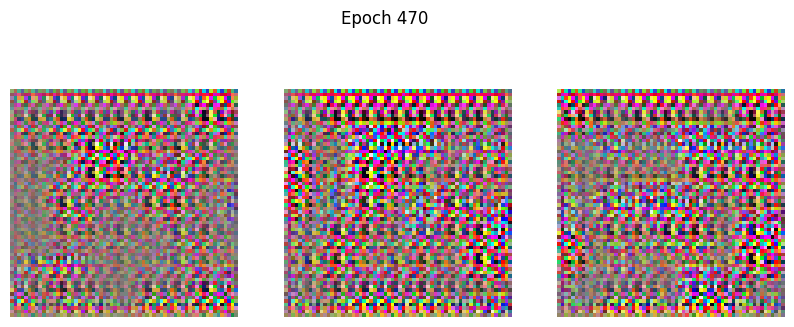

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - d_loss: 0.1002 - g_loss: 4.7167
Epoch 471/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1065 - g_loss: 4.9446 

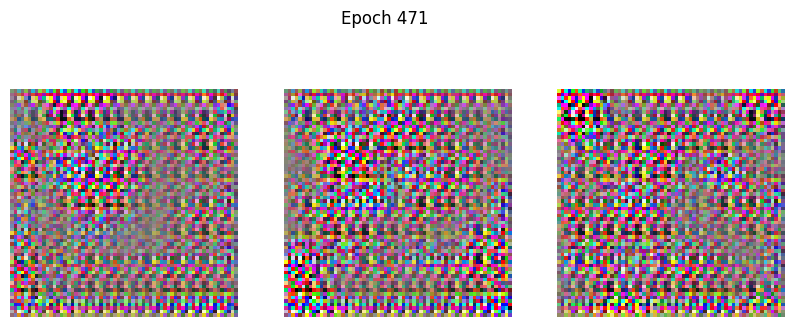

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step - d_loss: 0.1041 - g_loss: 4.9656
Epoch 472/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1439 - g_loss: 5.5243 

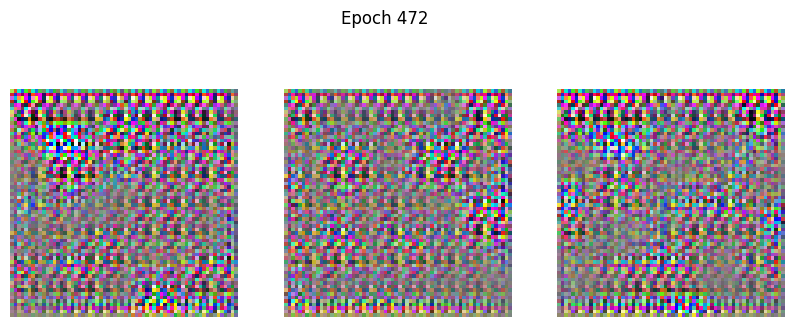

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1423 - g_loss: 5.5533
Epoch 473/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.2557 - g_loss: 5.9138

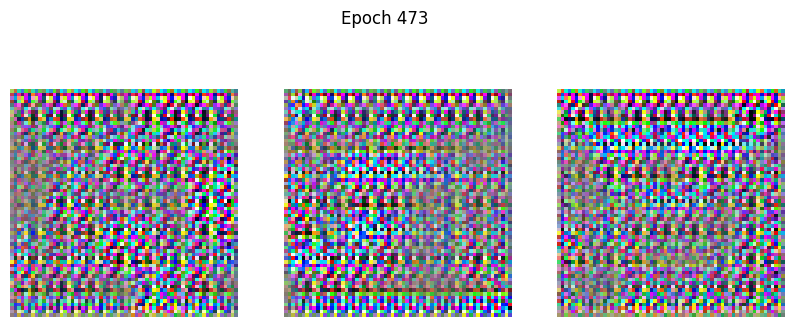

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 288ms/step - d_loss: 0.2658 - g_loss: 5.5132
Epoch 474/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.5102 - g_loss: 10.3391 

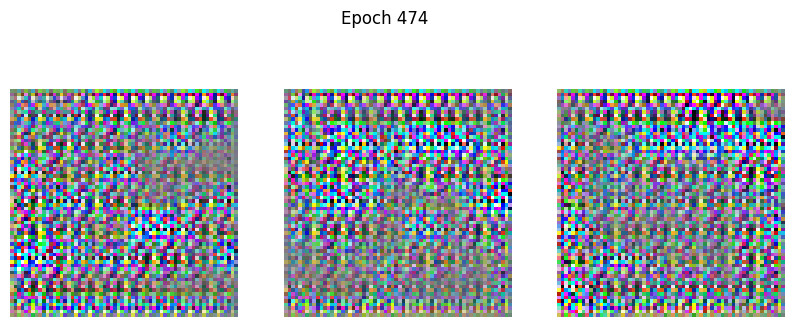

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 208ms/step - d_loss: 0.4817 - g_loss: 10.2414
Epoch 475/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1127 - g_loss: 4.5381 

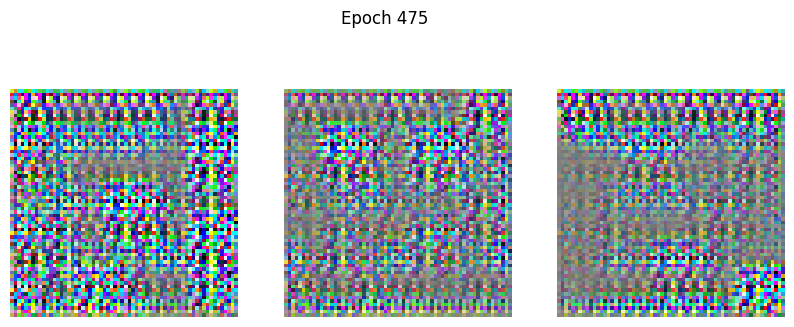

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1030 - g_loss: 4.3752
Epoch 476/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.1578 - g_loss: 6.7294 

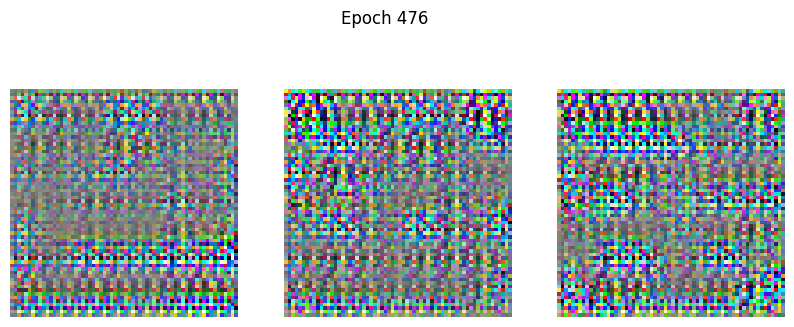

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1447 - g_loss: 6.7295
Epoch 477/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0519 - g_loss: 4.3169 

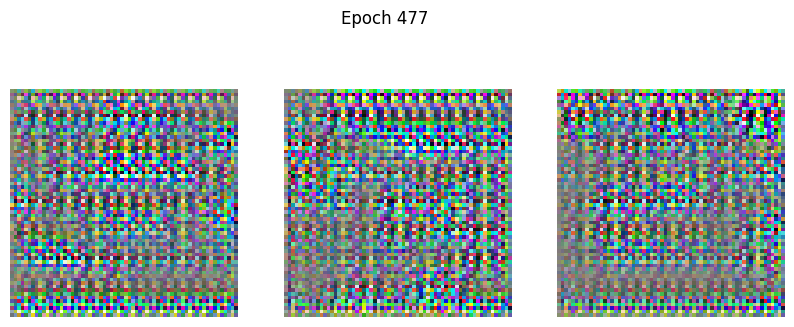

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0517 - g_loss: 4.1998
Epoch 478/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1121 - g_loss: 4.8193 

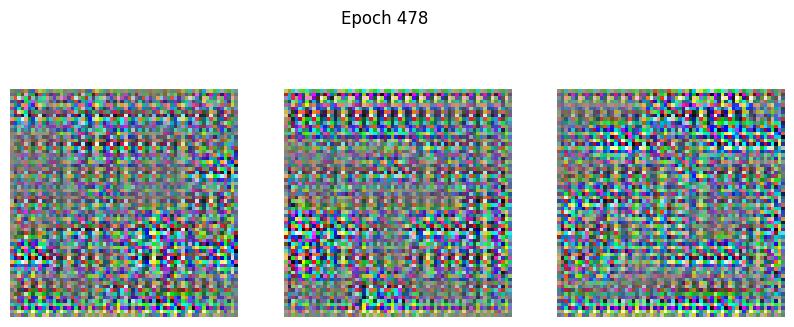

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1059 - g_loss: 4.8285
Epoch 479/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1147 - g_loss: 4.2428 

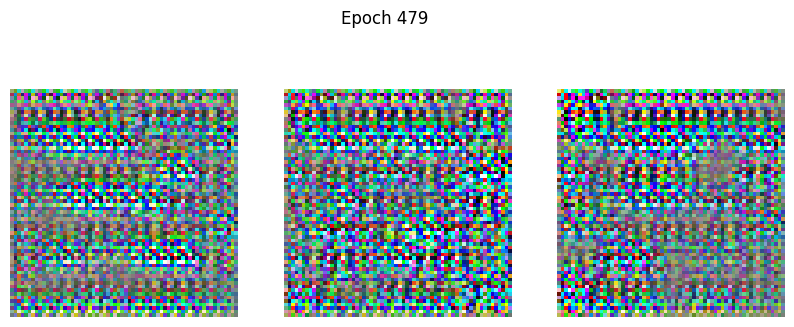

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1165 - g_loss: 4.3974
Epoch 480/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.0989 - g_loss: 4.8436

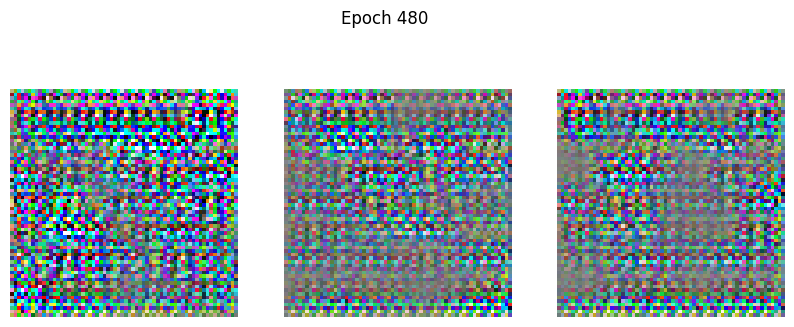

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.1028 - g_loss: 4.7742
Epoch 481/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1383 - g_loss: 6.1810 

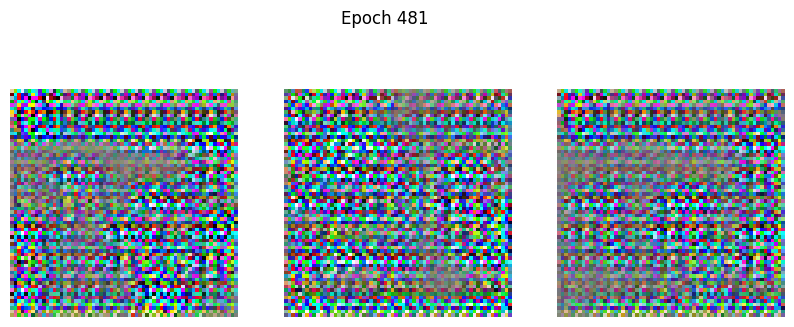

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1316 - g_loss: 6.1132
Epoch 482/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - d_loss: 0.0931 - g_loss: 5.1560

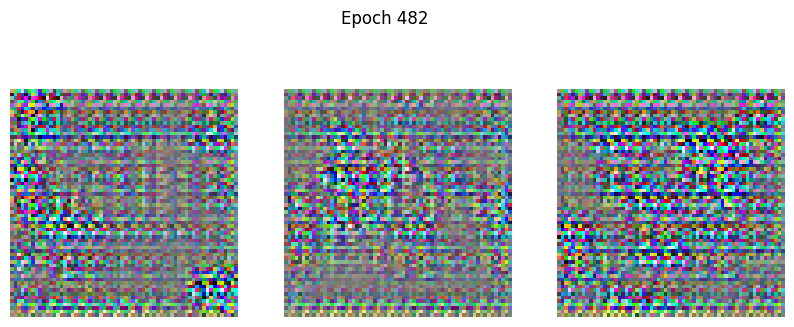

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - d_loss: 0.0965 - g_loss: 5.2566   
Epoch 483/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1019 - g_loss: 5.9011 

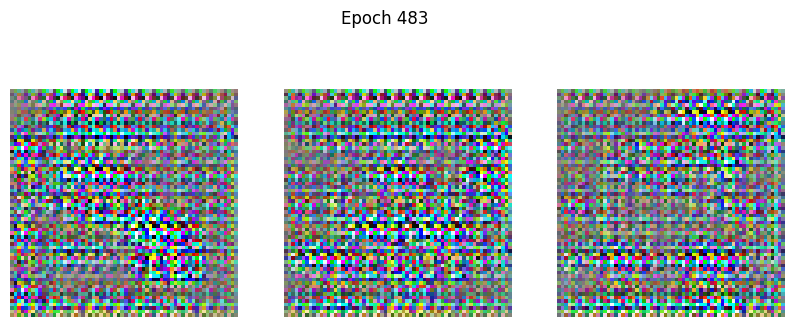

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1037 - g_loss: 6.0551
Epoch 484/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1542 - g_loss: 6.4365 

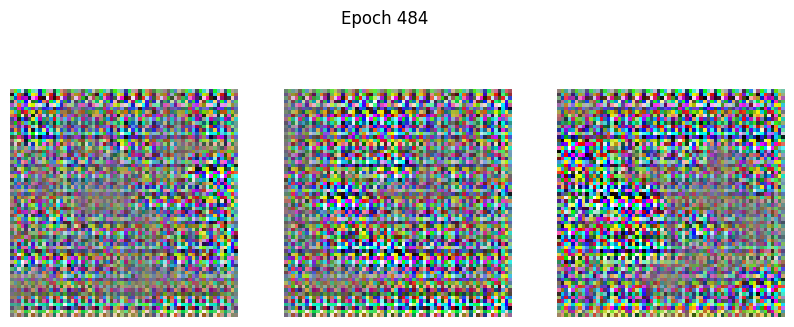

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - d_loss: 0.1606 - g_loss: 6.6869
Epoch 485/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.2064 - g_loss: 5.9772

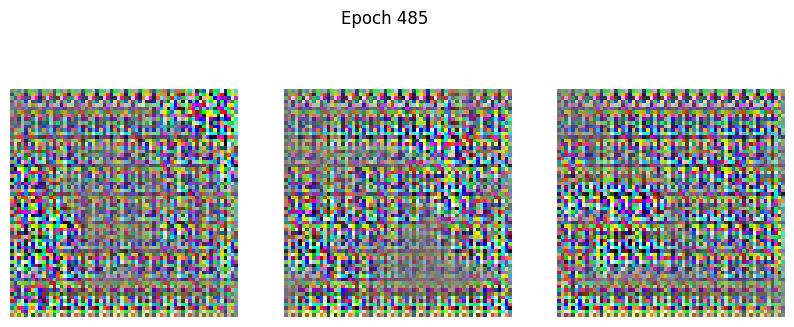

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 228ms/step - d_loss: 0.2173 - g_loss: 6.1505
Epoch 486/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.2101 - g_loss: 5.7416 

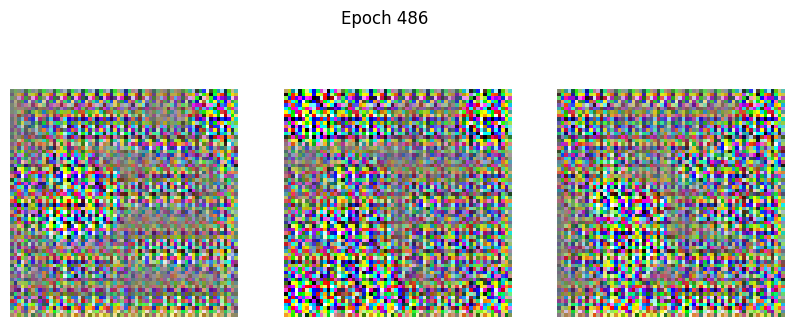

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.2077 - g_loss: 5.9538
Epoch 487/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - d_loss: 0.1230 - g_loss: 5.6471

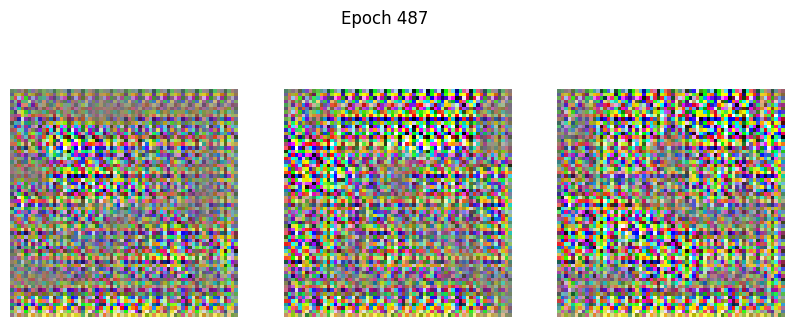

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1267 - g_loss: 5.5153
Epoch 488/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.2147 - g_loss: 8.0697

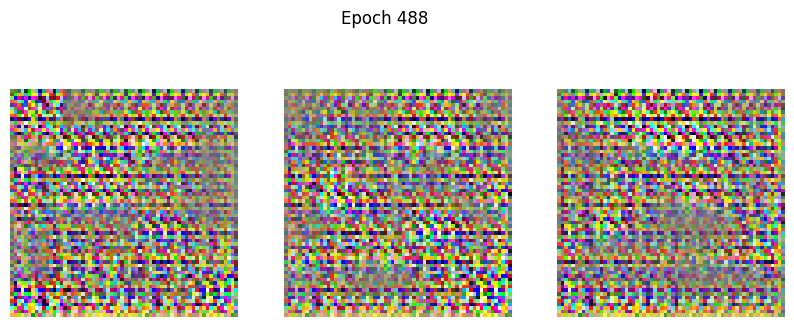

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.2178 - g_loss: 7.7204
Epoch 489/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1631 - g_loss: 7.4239

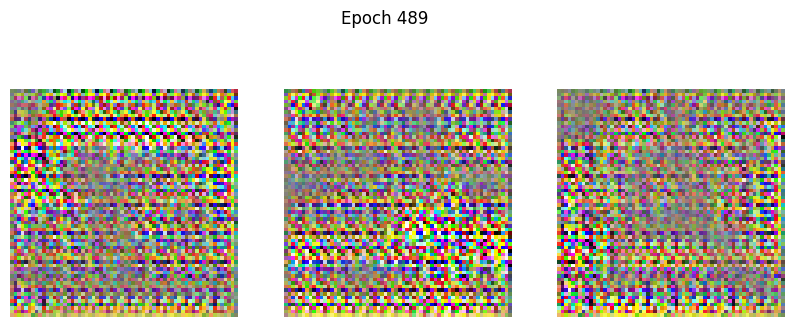

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.1566 - g_loss: 7.2484
Epoch 490/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - d_loss: 0.1211 - g_loss: 5.3074 

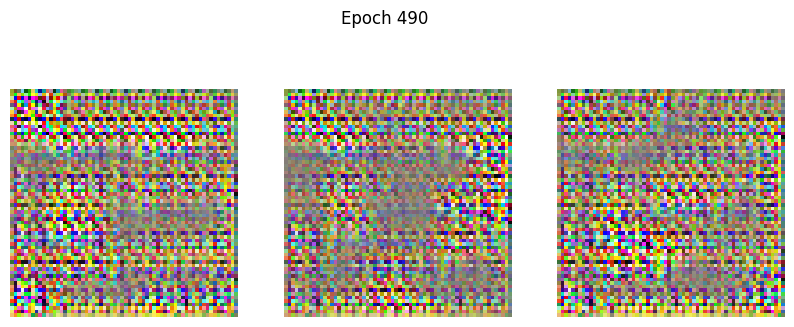

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.1254 - g_loss: 5.5364
Epoch 491/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1270 - g_loss: 4.7433

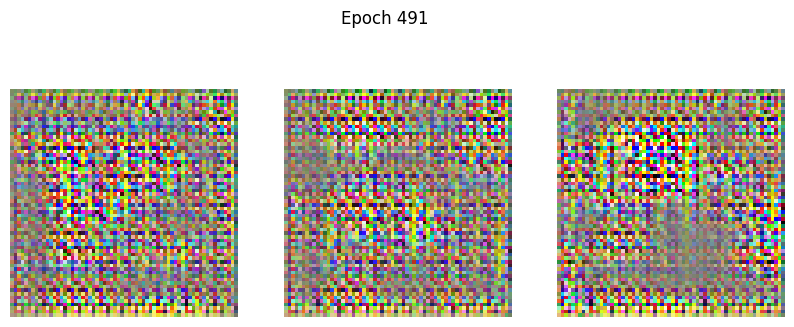

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1294 - g_loss: 4.6016
Epoch 492/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1870 - g_loss: 6.3162

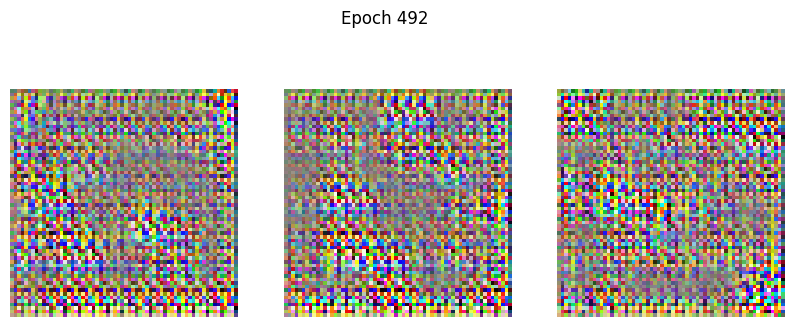

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1852 - g_loss: 6.1346
Epoch 493/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1147 - g_loss: 5.0946

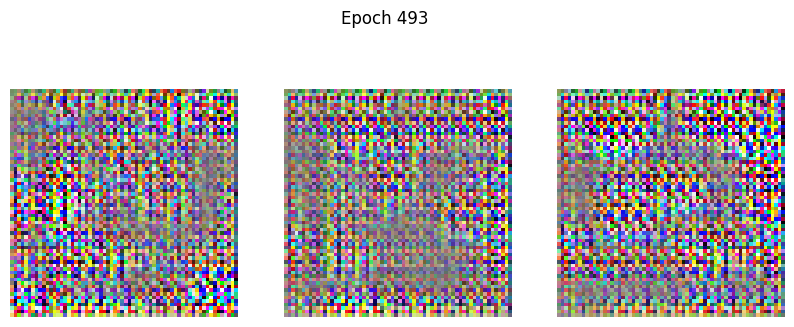

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1171 - g_loss: 5.2087
Epoch 494/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1377 - g_loss: 5.0852 

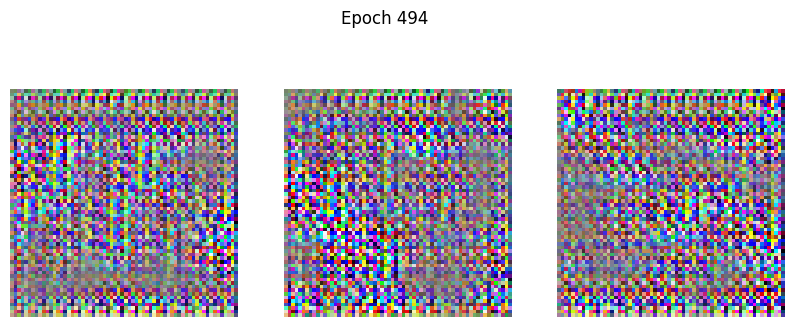

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.1404 - g_loss: 5.2849
Epoch 495/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 0.1476 - g_loss: 4.7926

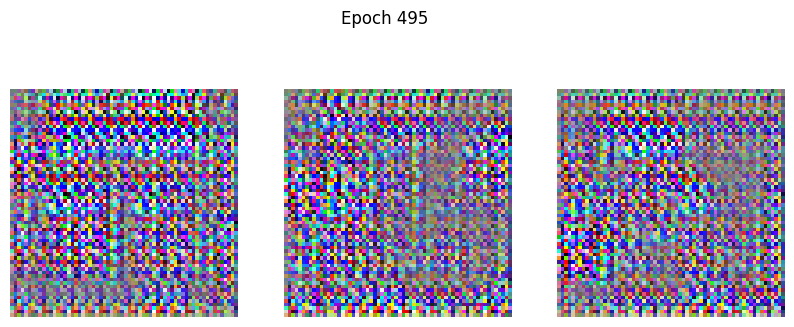

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - d_loss: 0.1559 - g_loss: 4.7761
Epoch 496/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.1712 - g_loss: 5.4587

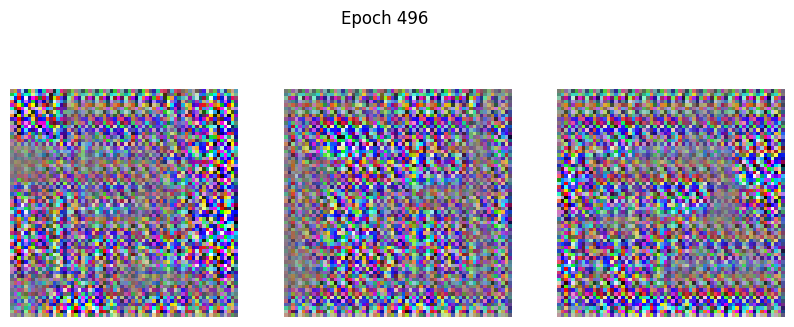

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - d_loss: 0.1773 - g_loss: 5.2234
Epoch 497/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.2205 - g_loss: 6.6645

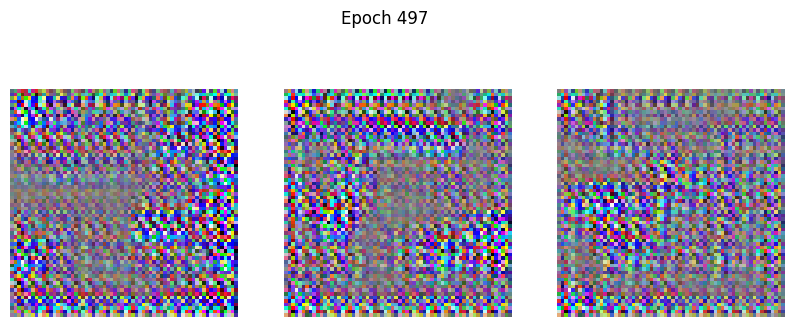

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 227ms/step - d_loss: 0.2149 - g_loss: 6.4881
Epoch 498/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1130 - g_loss: 4.4890 

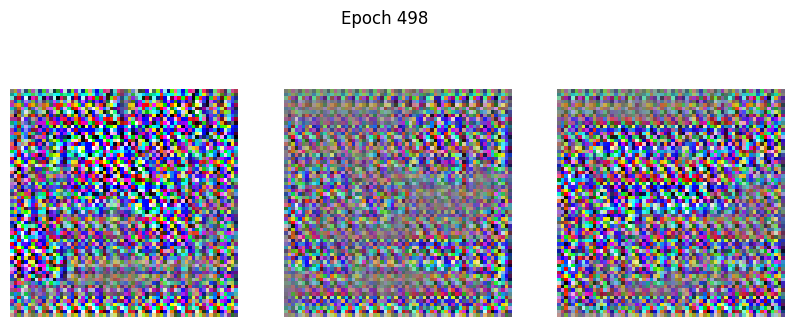

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1192 - g_loss: 4.7748
Epoch 499/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1169 - g_loss: 4.7278 

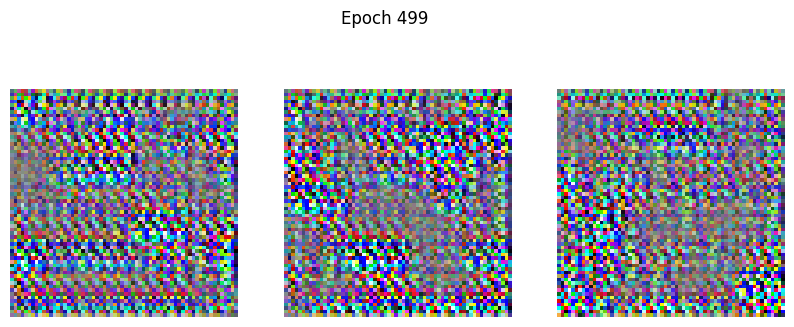

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1132 - g_loss: 4.6569
Epoch 500/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1437 - g_loss: 5.0282 

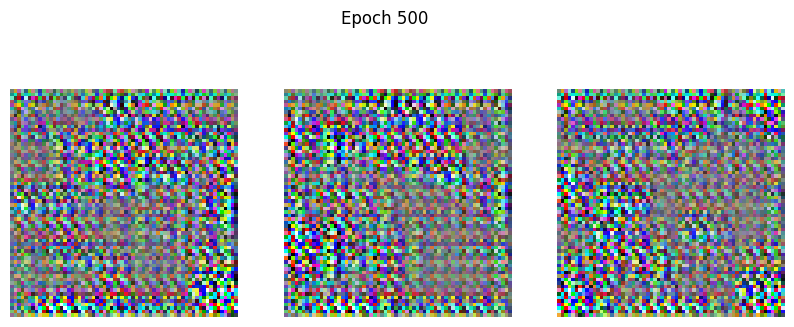

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - d_loss: 0.1417 - g_loss: 5.0823


In [11]:
# Hyperparameters
EPOCHS = 500  # Tambahkan jumlah epoch untuk hasil lebih baik (misal: 100-200)
lr_generator = 0.0002
lr_discriminator = 0.0002

# Inisialisasi DCGAN
dcgan = DCGAN(discriminator=discriminator, generator=generator, latent_dim=latent_dim)

# Compile
dcgan.compile(
    d_optimizer=keras.optimizers.Adam(learning_rate=lr_discriminator, beta_1=0.5),
    g_optimizer=keras.optimizers.Adam(learning_rate=lr_generator, beta_1=0.5),
    loss_fn=keras.losses.BinaryCrossentropy(from_logits=True),
)

# Jalankan Training
print("Mulai Training...")
dcgan.fit(
    train_dataset,
    epochs=EPOCHS,
    callbacks=[GANMonitor(num_img=3, latent_dim=latent_dim)]
)